In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import lcdb
from tqdm import tqdm
from sklearn.exceptions import ConvergenceWarning
from sklearn.utils._testing import ignore_warnings

In [3]:
def evaluate_nonmonotonicity(interval, threshold):
    return threshold <= interval

In [4]:
@ignore_warnings(category=ConvergenceWarning)
@ignore_warnings(category=UserWarning)
@ignore_warnings(category=RuntimeWarning)
def evaluate_learningcurve(learning_curve, limit):
    threshold = 0

    Y_distances = []
    min = np.min(learning_curve)
    max = np.max(learning_curve)
    learning_curve = np.array(learning_curve)

    for i in range(1, len(learning_curve)):
        Y_distances.append(learning_curve[i] - learning_curve[i-1])
        threshold += np.abs(learning_curve[i] - learning_curve[i-1])

    threshold = limit * threshold / len(learning_curve)
    increasing = True

    current_interval = 0
    occurances = 0
    significances = []
    point1 = -1
    point2 = -1
    start = 0
    check = True
    non_monotone = False

    if Y_distances[0] < 0:
        increasing = False
        current_interval += np.abs(Y_distances[0])

    if increasing:
        check = False
    count_start = False
    count_end = False

    for i in range(1, len(Y_distances)):
        if increasing == (Y_distances[i] < 0):
            increasing = not increasing
            if evaluate_nonmonotonicity(current_interval, threshold) and increasing and Y_distances[i-1] < 0:
                if point2 == -1:
                    point1 = start
                    point2 = i
                if check:
                    count_start = True
                if i == (len(Y_distances) - 1):
                    count_end = True
                occurances += 1
                significances.append(current_interval/(max - min))
                non_monotone = True
            check = False
            current_interval = np.abs(Y_distances[i])
            start = i
        elif i == len(Y_distances) - 1 and evaluate_nonmonotonicity(current_interval, threshold) and Y_distances[i] < 0:
            count_end = True
            occurances += 1
            significances.append(current_interval/(max - min))
            non_monotone = True
        else:
            current_interval += np.abs(Y_distances[i])

    return non_monotone, point1, point2, count_start, count_end

In [5]:
def plot_learningcurve(anchors, scores, starting_point, ending_point, flag):
    plt.figure(figsize=(10, 4))
    plt.plot(anchors, scores)
    if flag:
        plt.scatter(anchors[starting_point], scores[starting_point],  color="red")
        plt.scatter(anchors[ending_point], scores[ending_point],  color="green")
        plt.plot(anchors[starting_point:ending_point+1], scores[starting_point:ending_point+1])
    plt.title("Plot of learning curve")
    plt.xlabel("Number of training instances")
    plt.ylabel("Accuracy")
    plt.show()

0it [00:00, ?it/s]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_6;non-monotonic:False


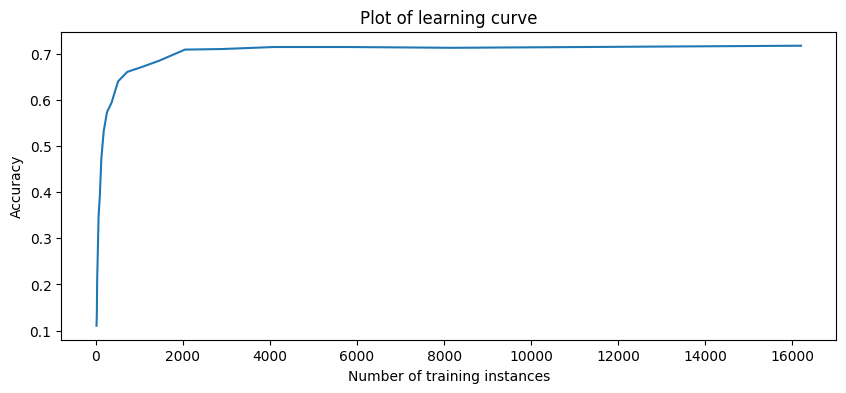

1it [00:03,  3.34s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_11;non-monotonic:False


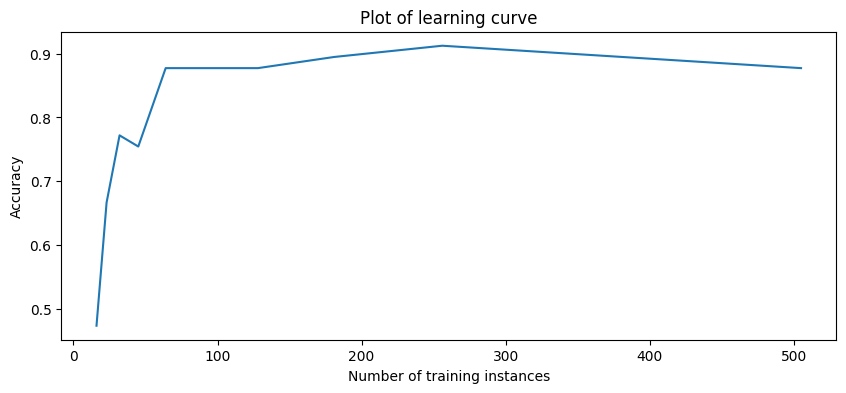

2it [00:05,  2.94s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_12;non-monotonic:True


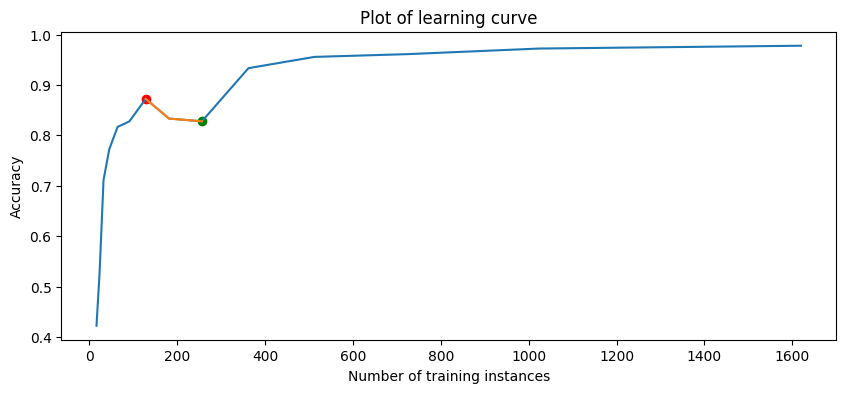

3it [00:08,  2.72s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_14;non-monotonic:True


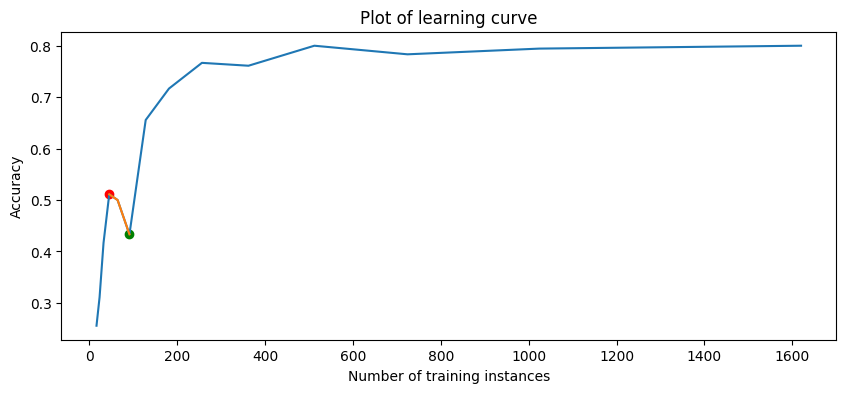

4it [00:10,  2.55s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_16;non-monotonic:False


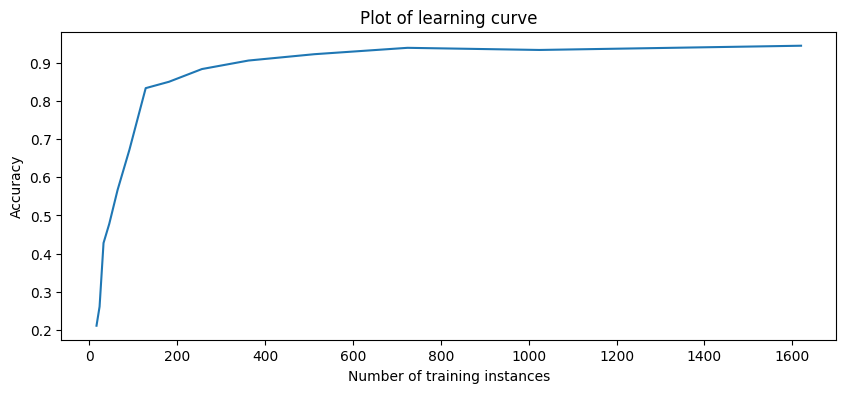

5it [00:13,  2.46s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_18;non-monotonic:True


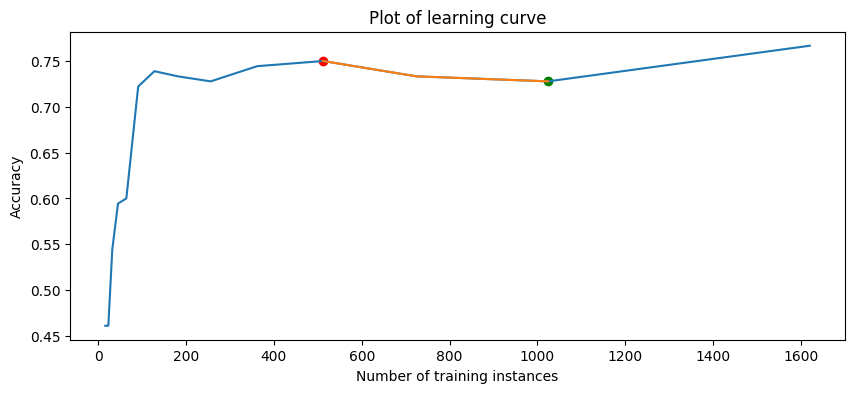

6it [00:15,  2.39s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_21;non-monotonic:False


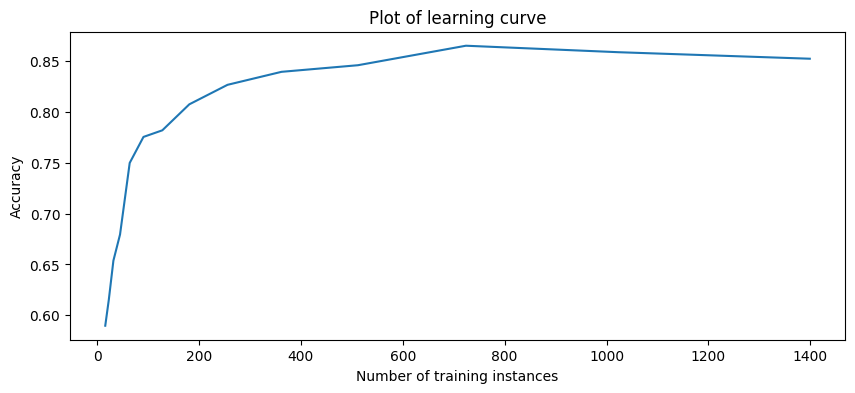

7it [00:17,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_22;non-monotonic:True


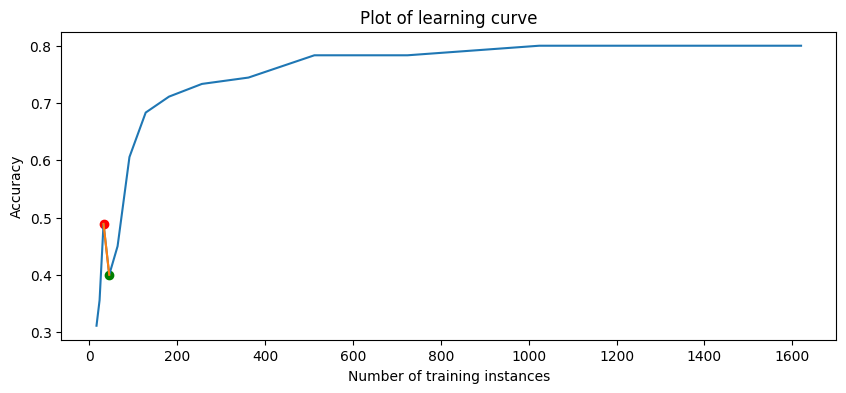

8it [00:19,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_23;non-monotonic:True


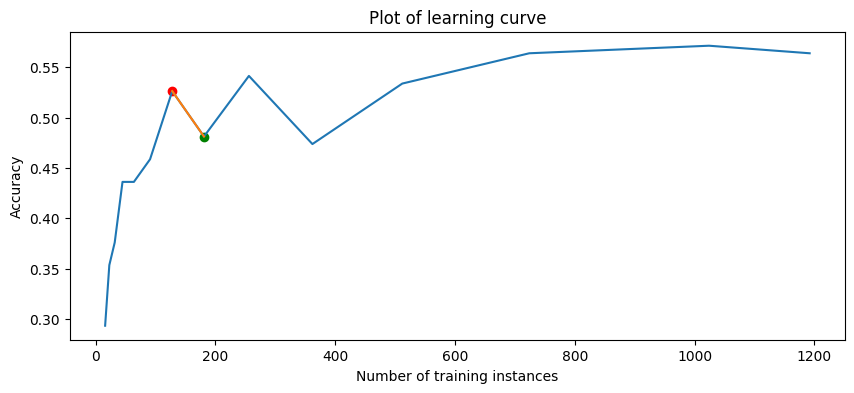

9it [00:21,  2.28s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_26;non-monotonic:False


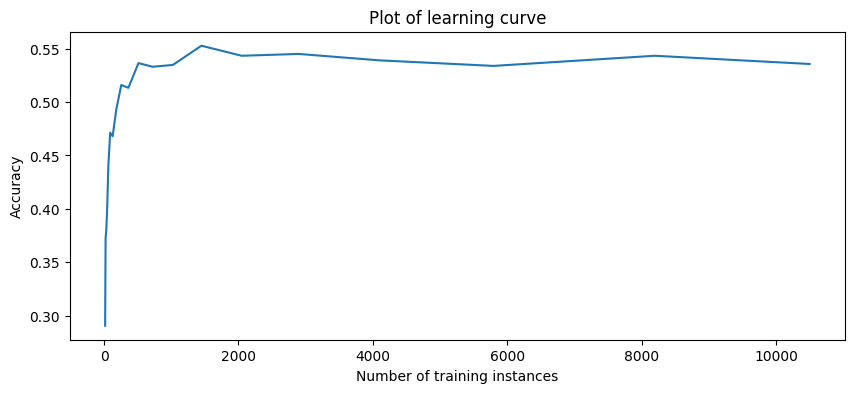

10it [00:24,  2.26s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_28;non-monotonic:True


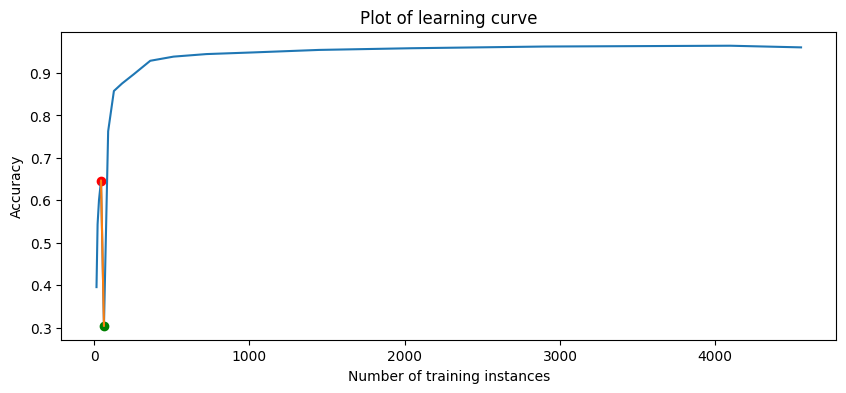

11it [00:26,  2.25s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_30;non-monotonic:True


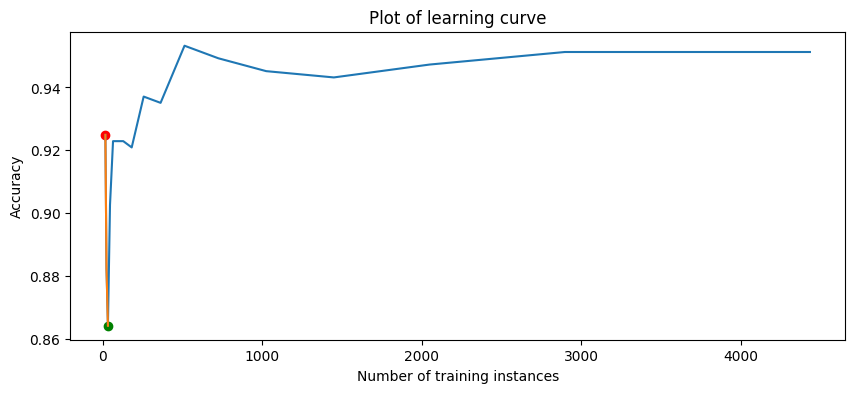

12it [00:28,  2.25s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_32;non-monotonic:False


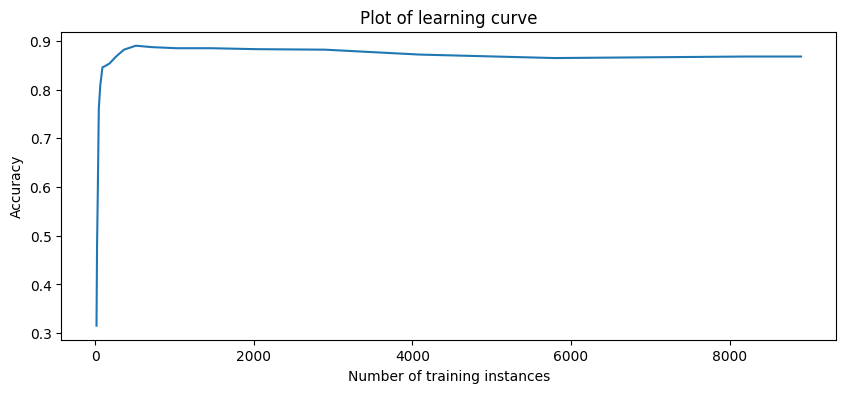

13it [00:31,  2.29s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_36;non-monotonic:False


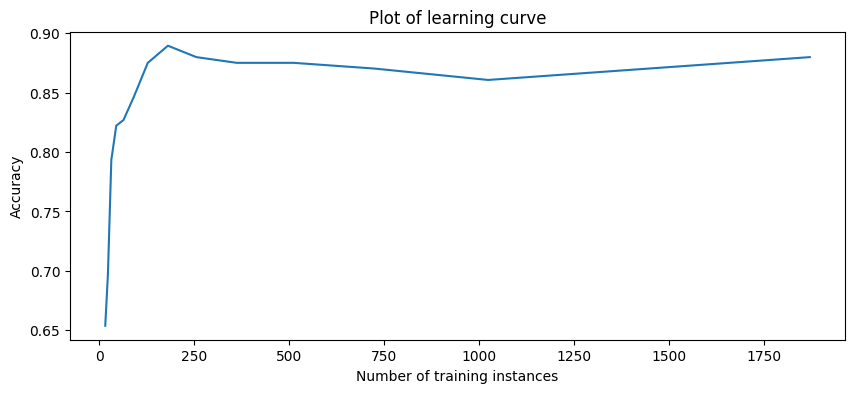

14it [00:33,  2.27s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_44;non-monotonic:True


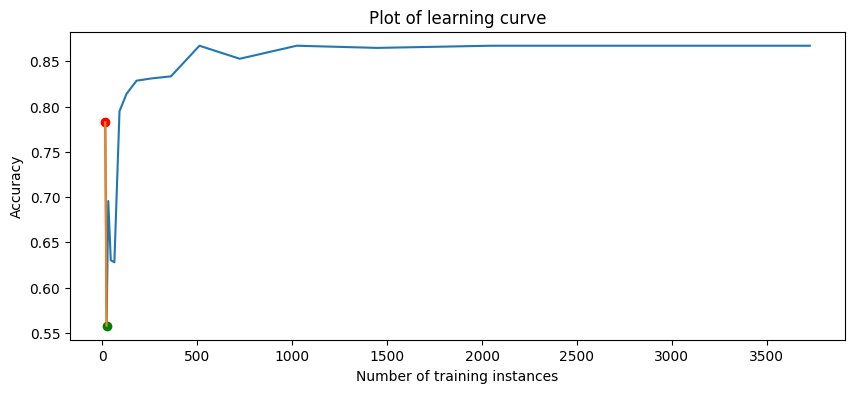

15it [00:35,  2.26s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_54;non-monotonic:True


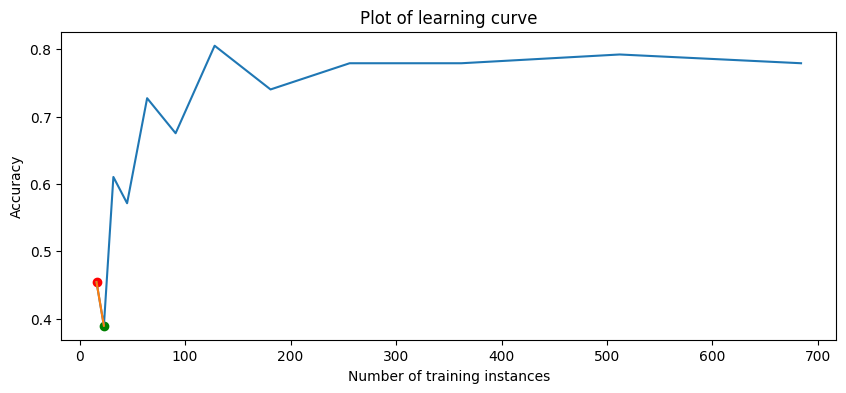

16it [00:37,  2.24s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_55;non-monotonic:True


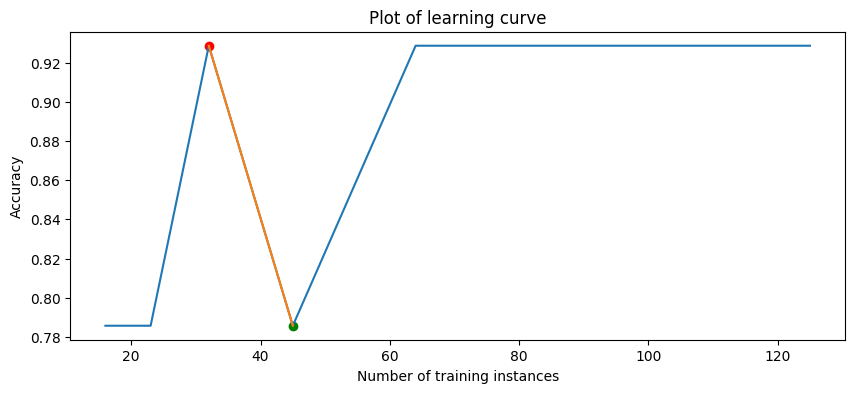

17it [00:39,  2.25s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_60;non-monotonic:True


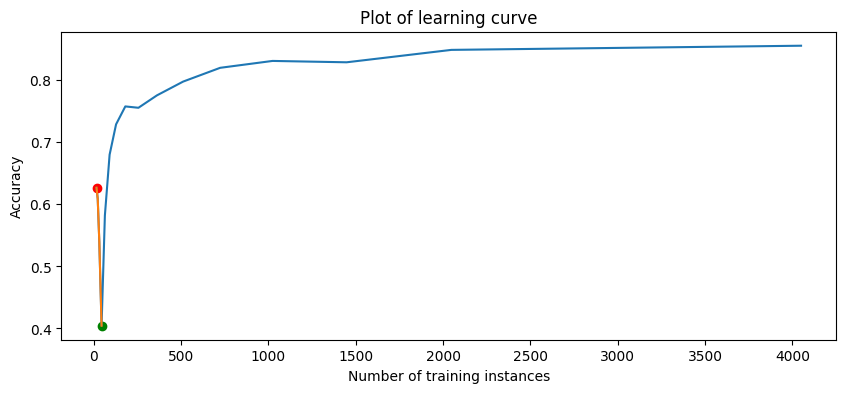

18it [00:42,  2.23s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_61;non-monotonic:False


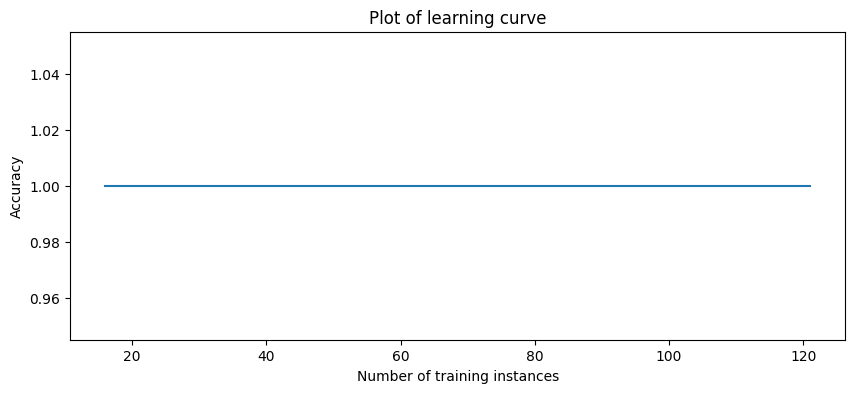

19it [00:44,  2.23s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_181;non-monotonic:True


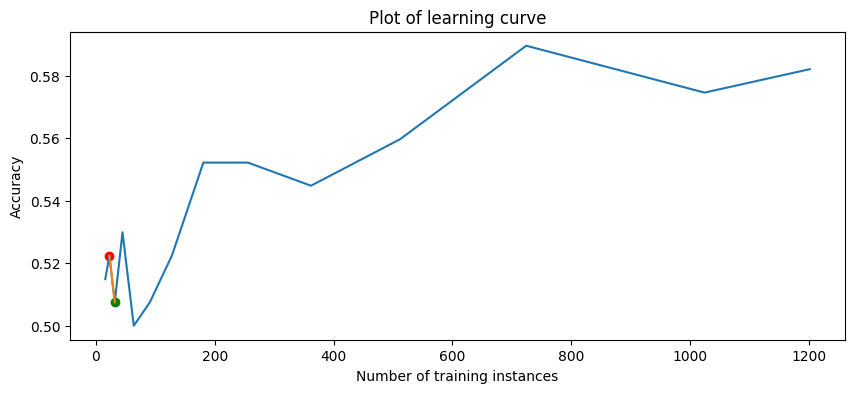

20it [00:46,  2.26s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_182;non-monotonic:True


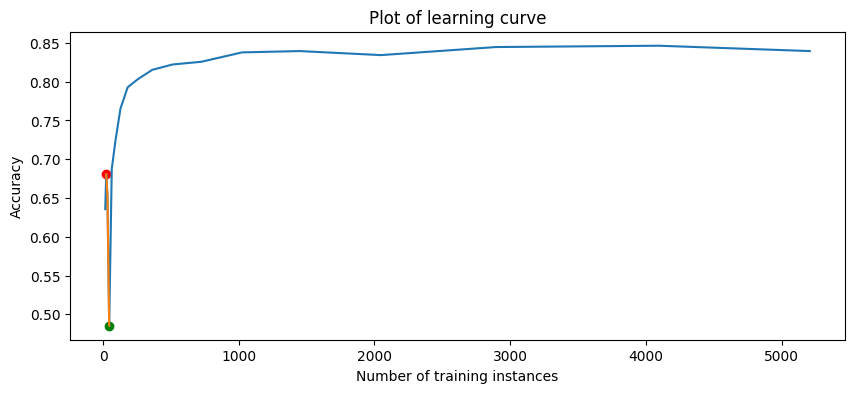

21it [00:48,  2.25s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_185;non-monotonic:True


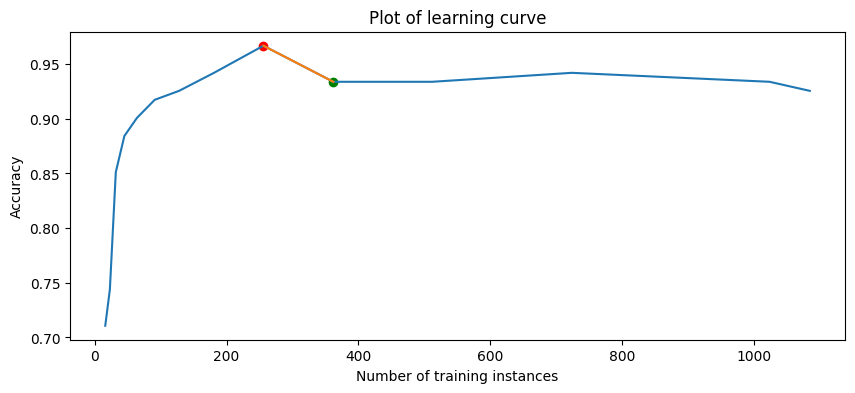

22it [00:51,  2.22s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_201;non-monotonic:True


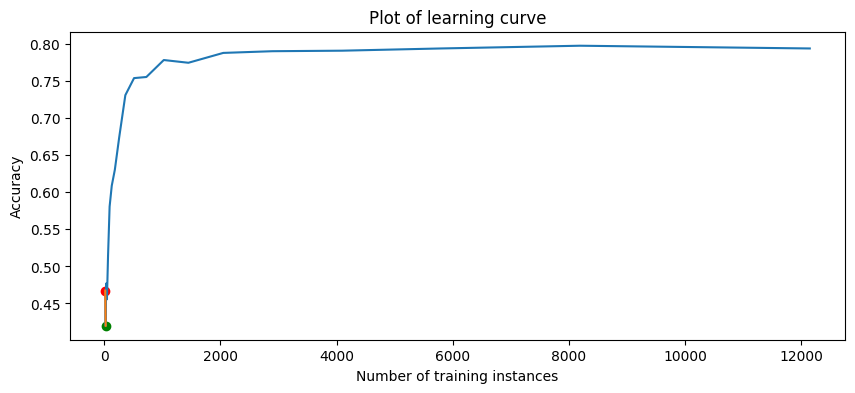

23it [00:53,  2.23s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_273;non-monotonic:True


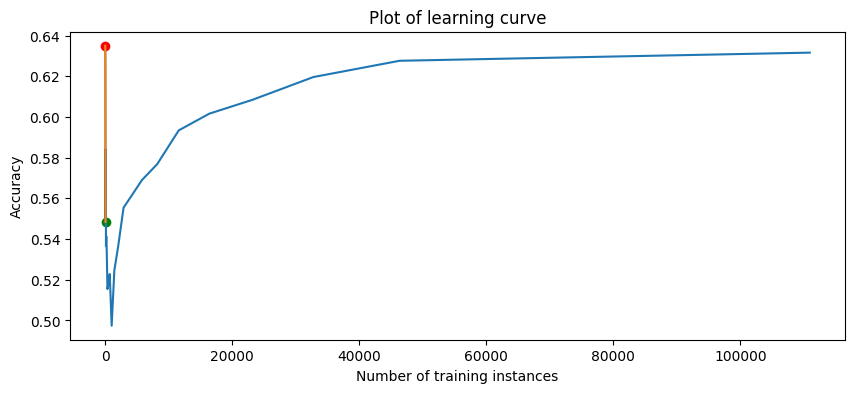

24it [00:55,  2.29s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_293;non-monotonic:True


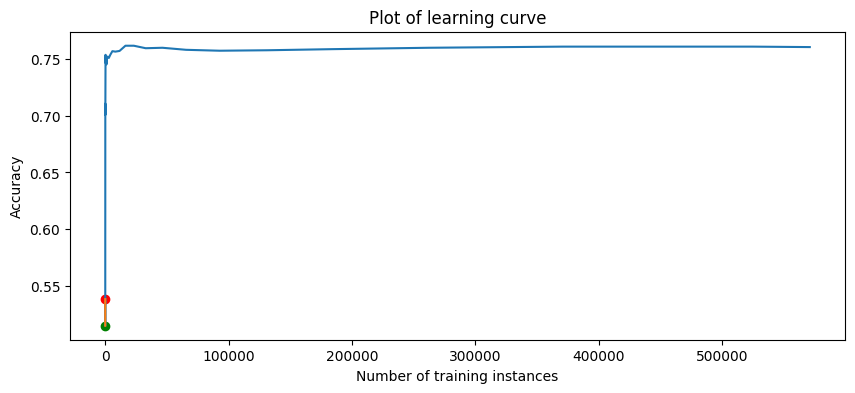

25it [00:58,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_299;non-monotonic:True


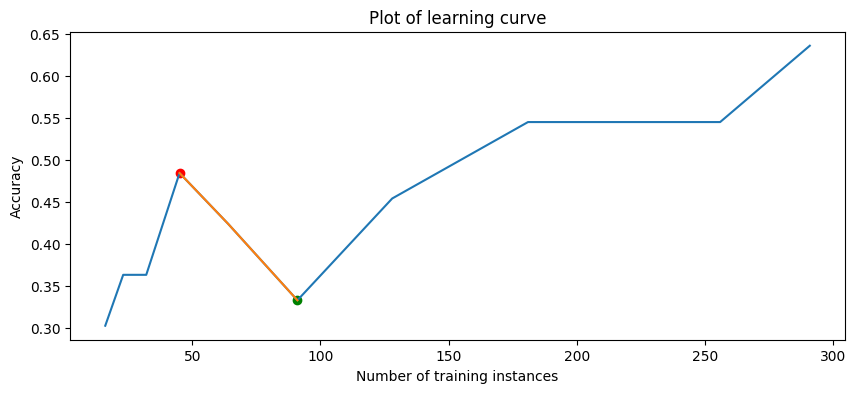

26it [01:00,  2.34s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_300;non-monotonic:True


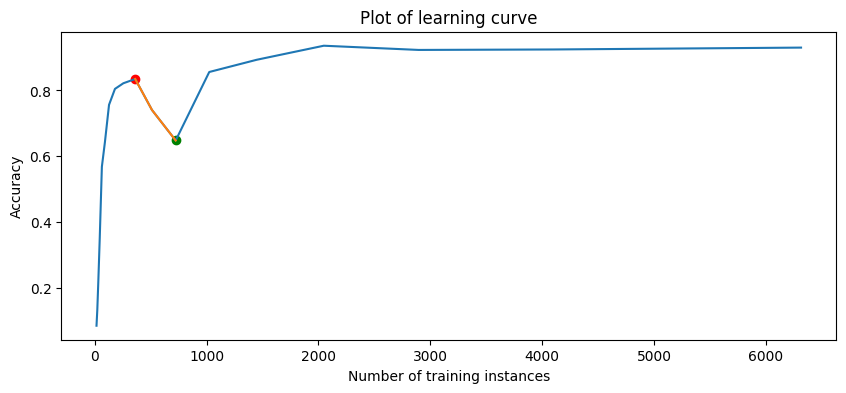

27it [01:02,  2.34s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_346;non-monotonic:True


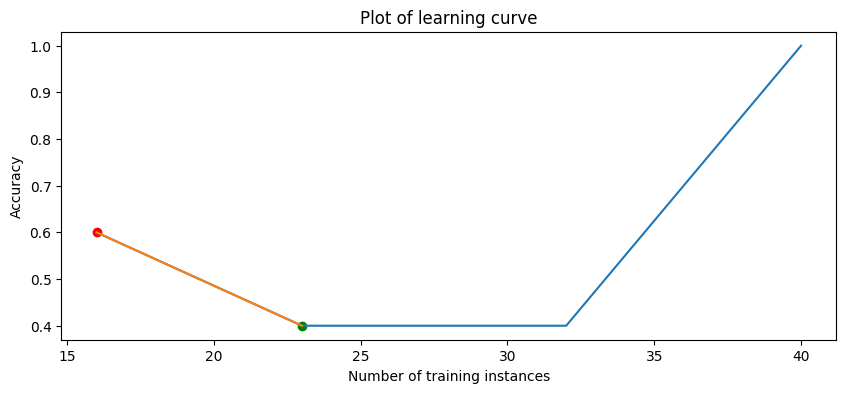

28it [01:05,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_351;non-monotonic:True


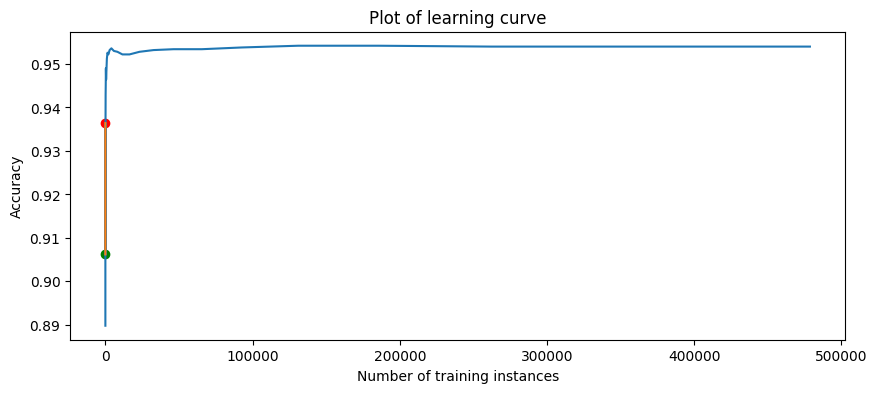

29it [01:07,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_354;non-monotonic:True


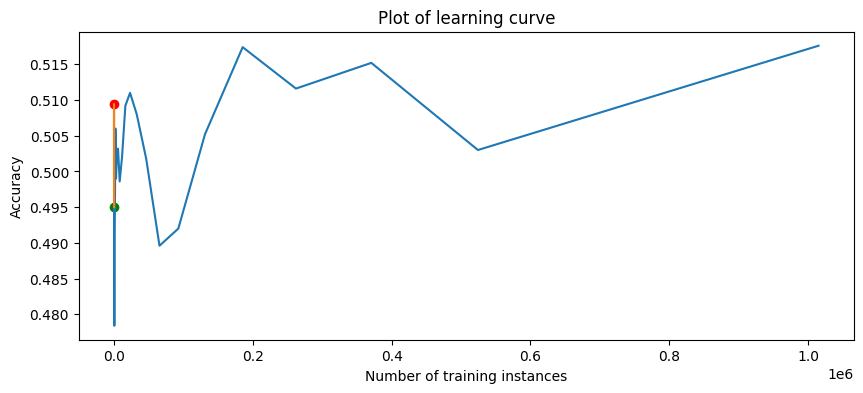

30it [01:09,  2.36s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_357;non-monotonic:True


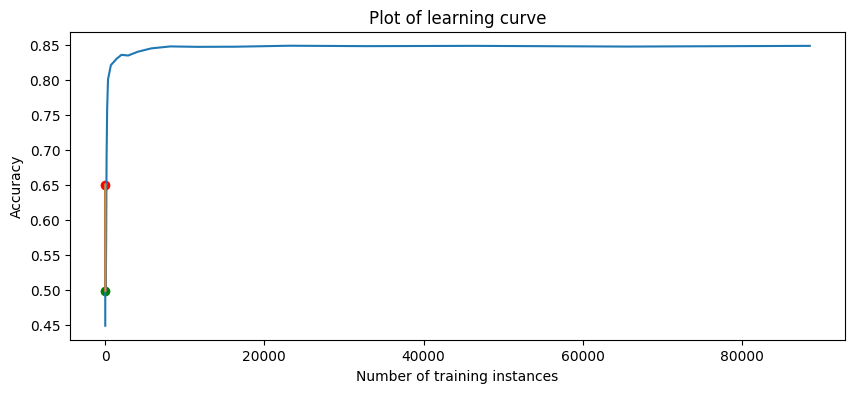

31it [01:12,  2.38s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_380;non-monotonic:False


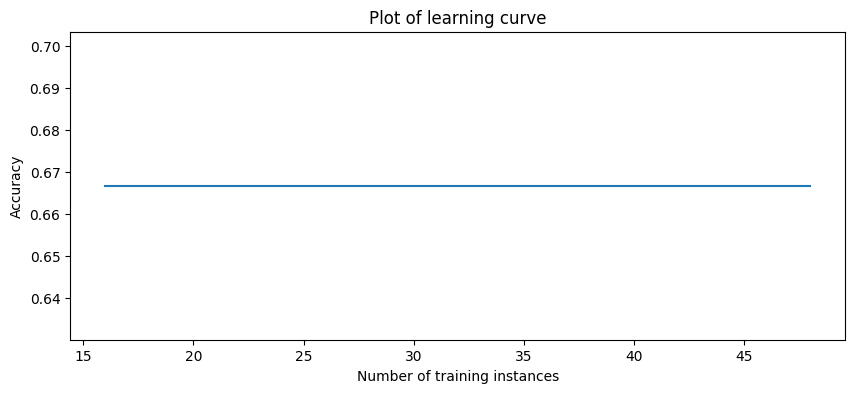

32it [01:14,  2.37s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_389;non-monotonic:True


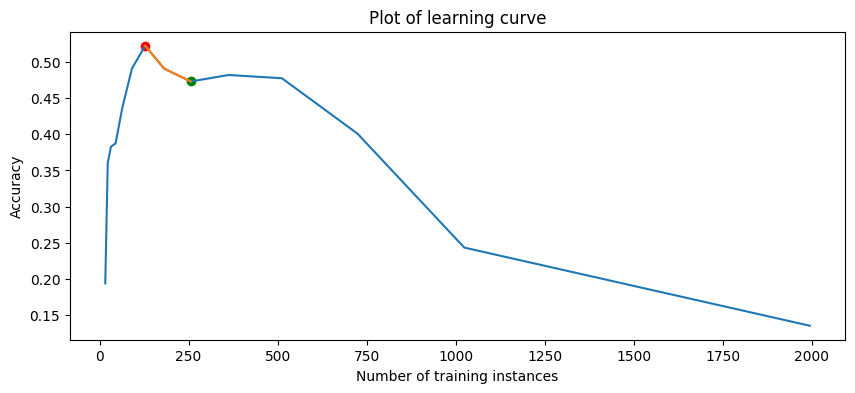

33it [01:17,  2.42s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_390;non-monotonic:True


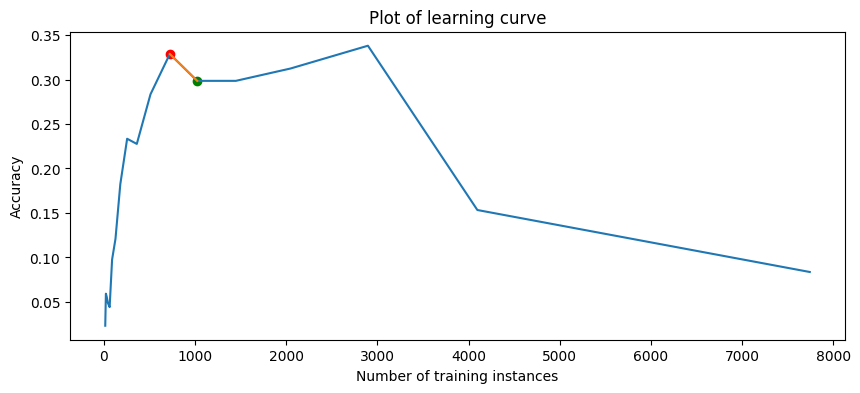

34it [01:19,  2.41s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_391;non-monotonic:True


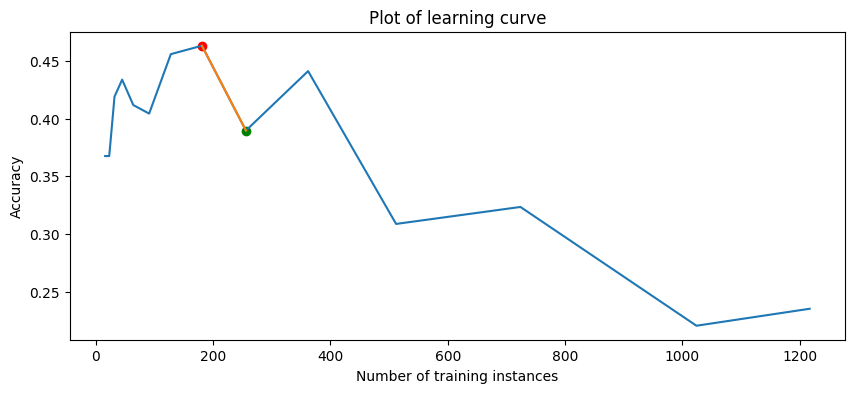

35it [01:21,  2.40s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_392;non-monotonic:False


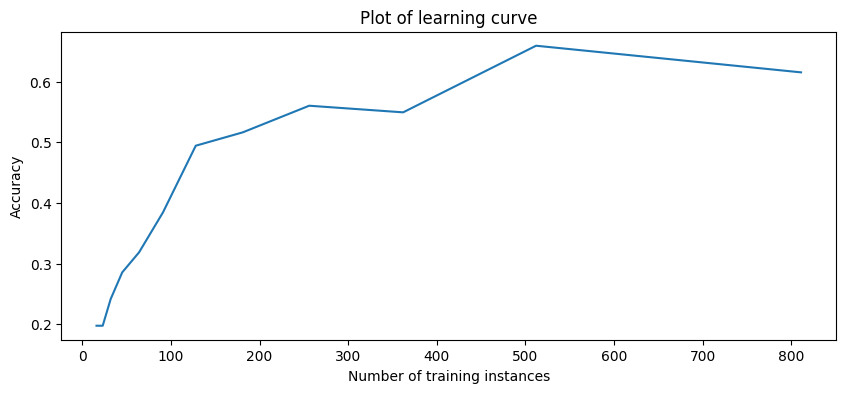

36it [01:24,  2.39s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_393;non-monotonic:True


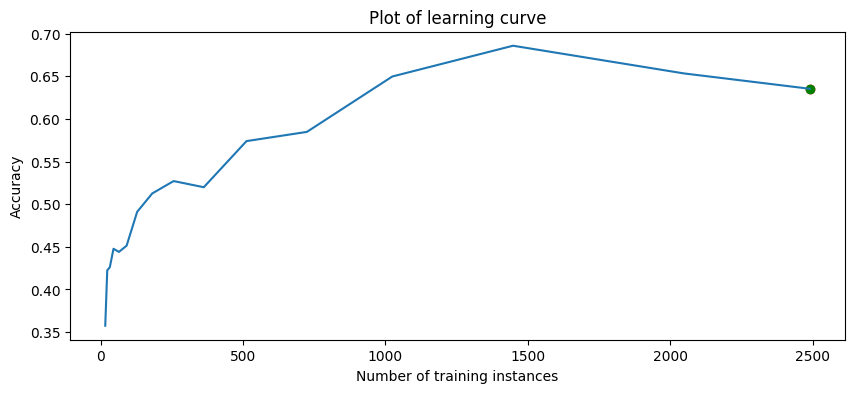

37it [01:26,  2.41s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_395;non-monotonic:True


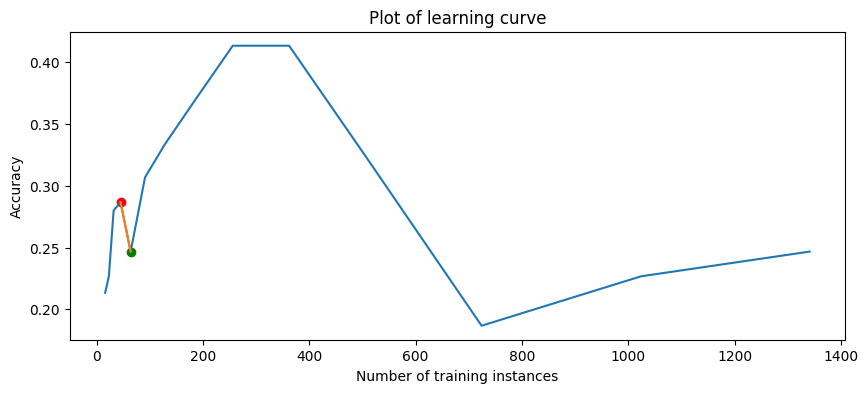

38it [01:29,  2.57s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_396;non-monotonic:True


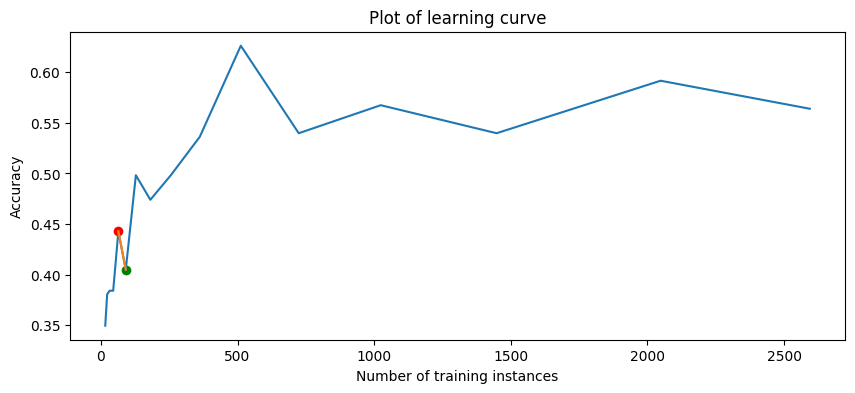

39it [01:32,  2.73s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_398;non-monotonic:True


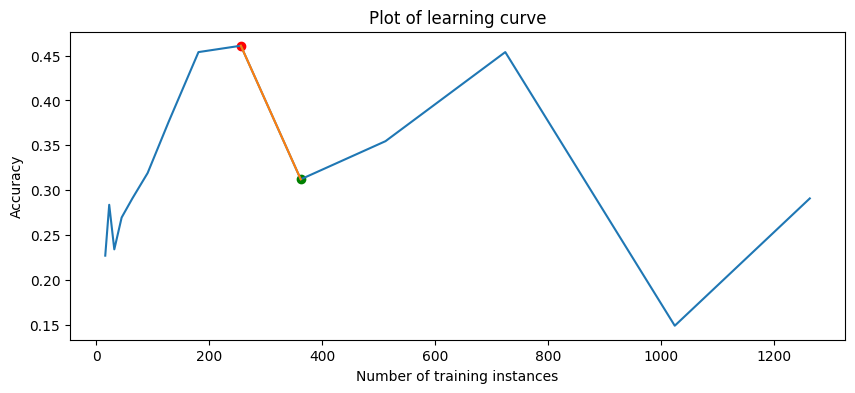

40it [01:35,  2.79s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_399;non-monotonic:True


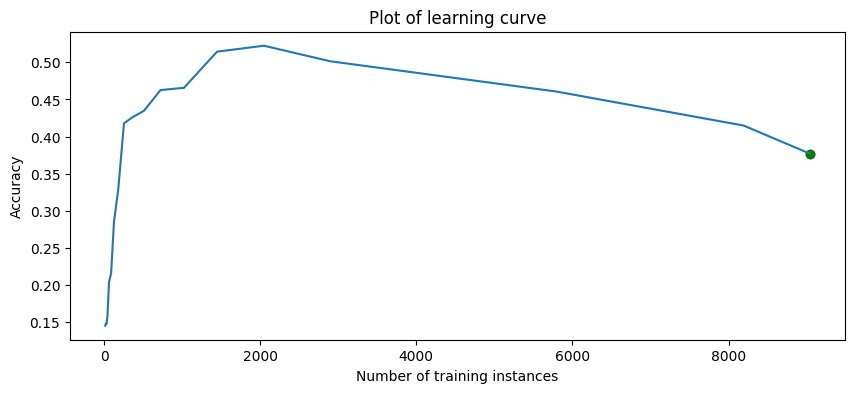

41it [01:38,  2.86s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_401;non-monotonic:False


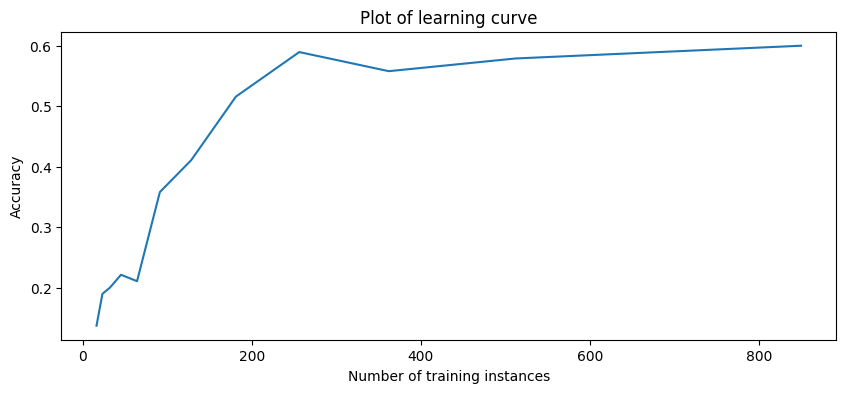

42it [01:41,  2.87s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_446;non-monotonic:False


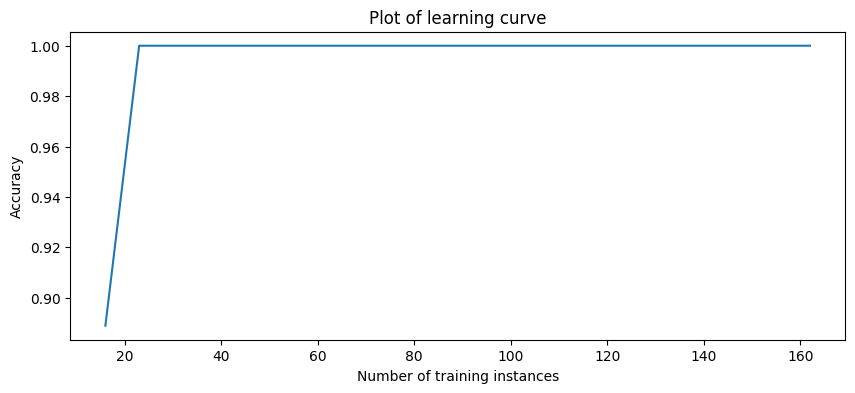

43it [01:44,  2.93s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_554;non-monotonic:True


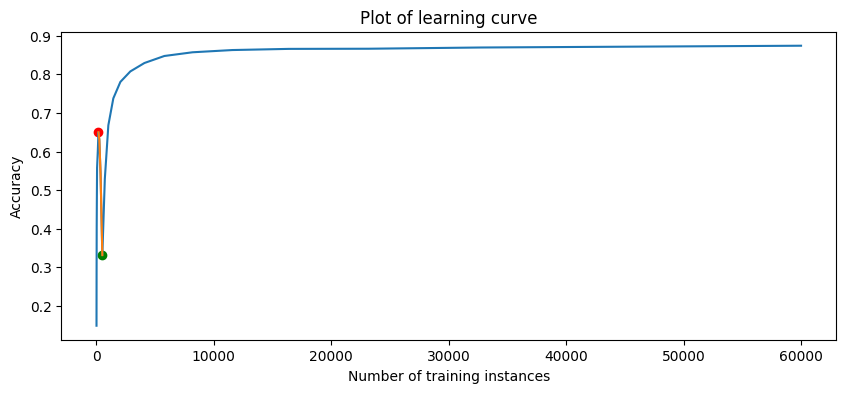

44it [01:47,  2.85s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_679;non-monotonic:True


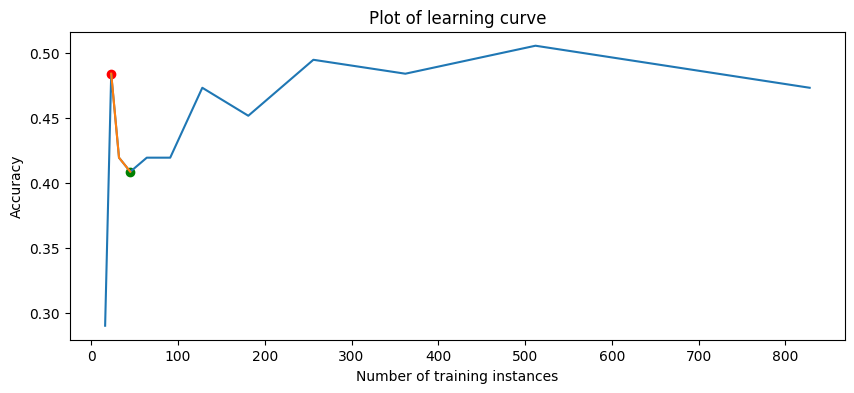

45it [01:49,  2.69s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_715;non-monotonic:True


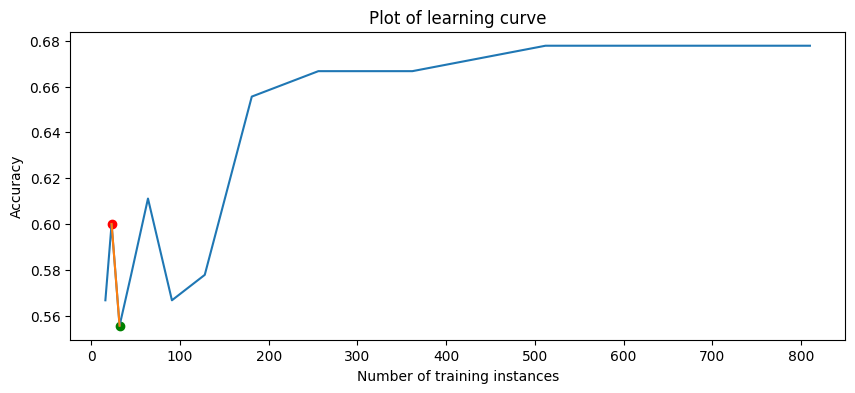

46it [01:52,  2.61s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_718;non-monotonic:True


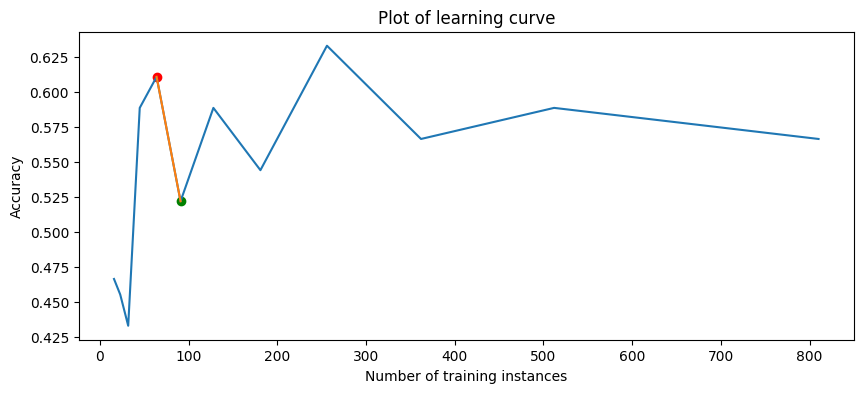

47it [01:54,  2.56s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_720;non-monotonic:True


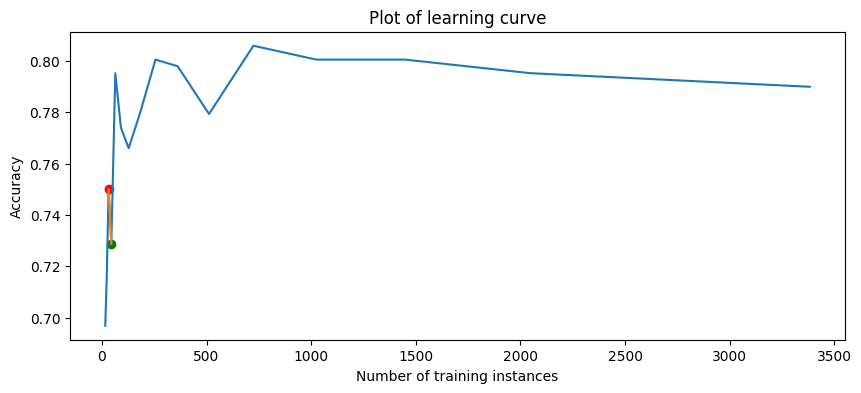

48it [01:57,  2.55s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_722;non-monotonic:False


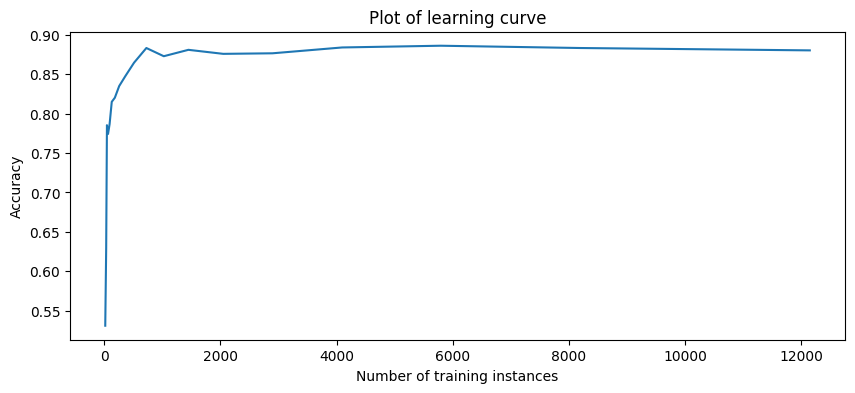

49it [01:59,  2.51s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_723;non-monotonic:True


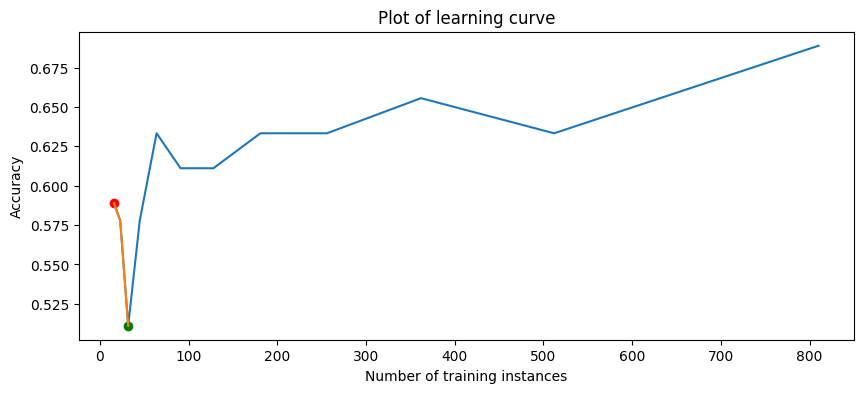

50it [02:01,  2.47s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_727;non-monotonic:True


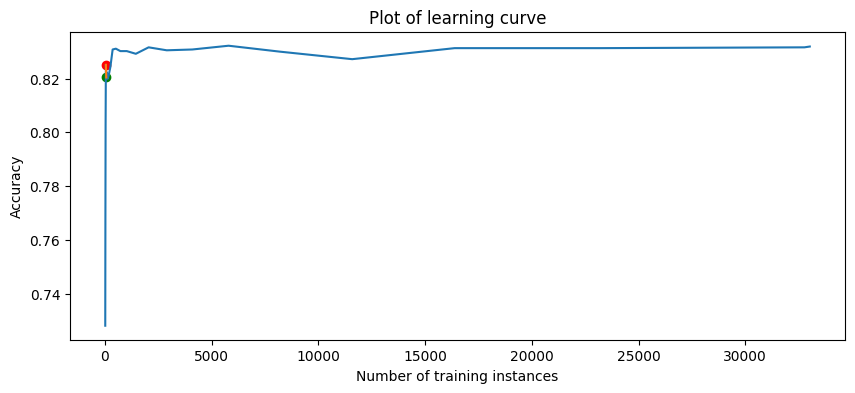

51it [02:04,  2.43s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_728;non-monotonic:True


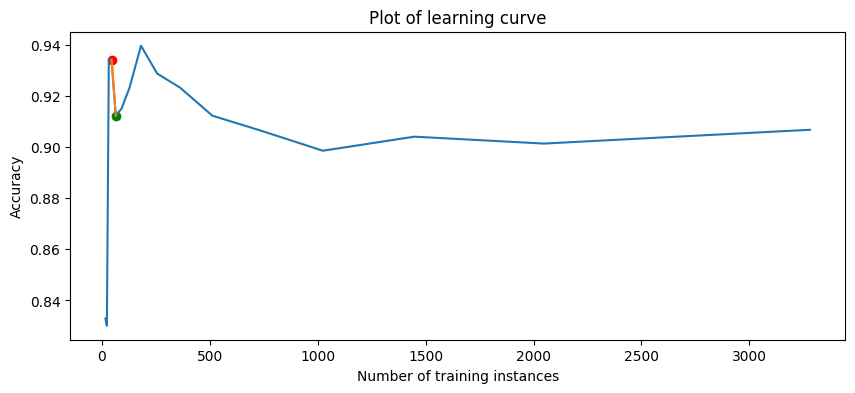

52it [02:06,  2.43s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_734;non-monotonic:True


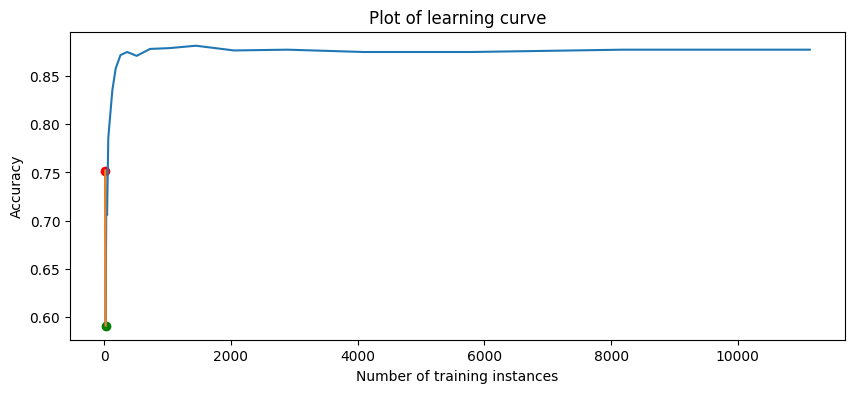

53it [02:09,  2.42s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_735;non-monotonic:True


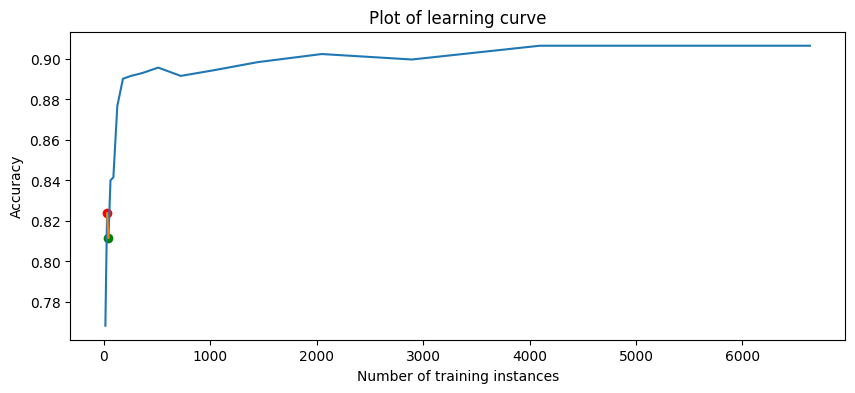

54it [02:13,  3.07s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_737;non-monotonic:True


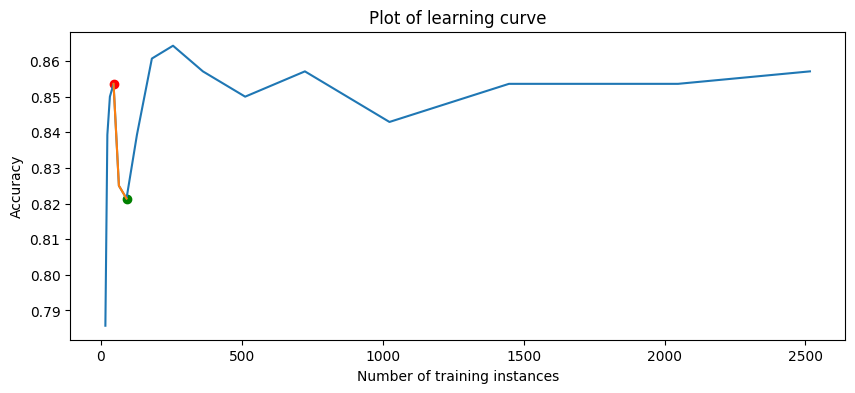

55it [02:16,  3.14s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_740;non-monotonic:True


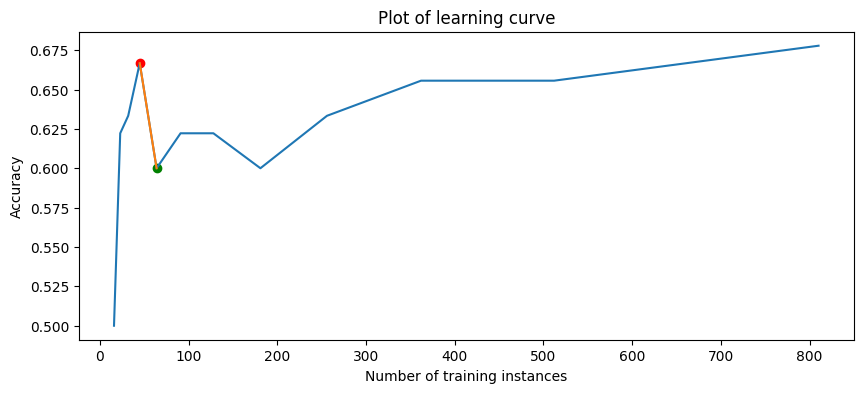

56it [02:19,  3.02s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_741;non-monotonic:True


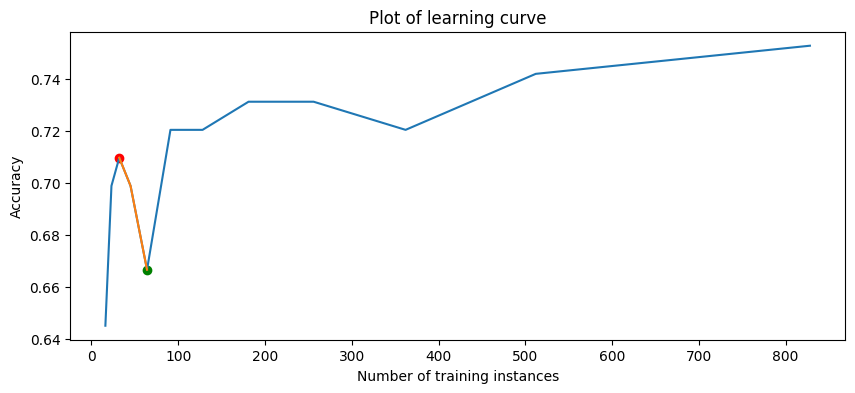

57it [02:22,  2.85s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_743;non-monotonic:True


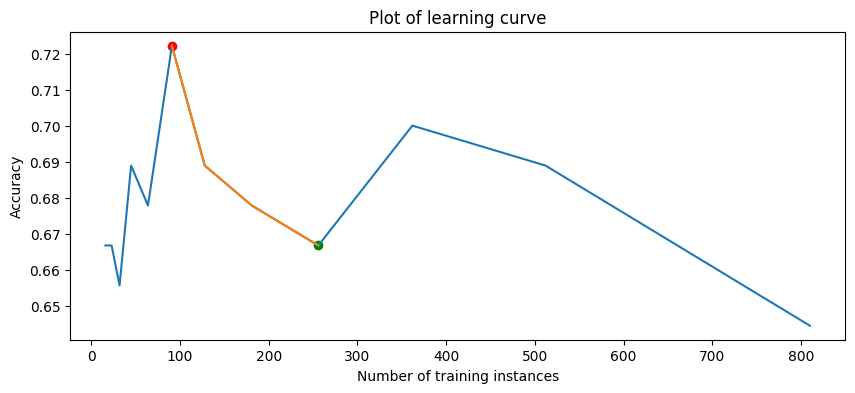

58it [02:24,  2.73s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_751;non-monotonic:True


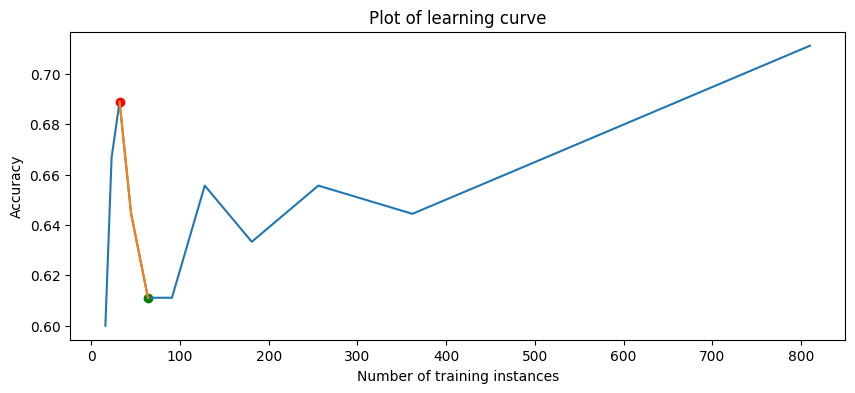

59it [02:27,  2.67s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_752;non-monotonic:True


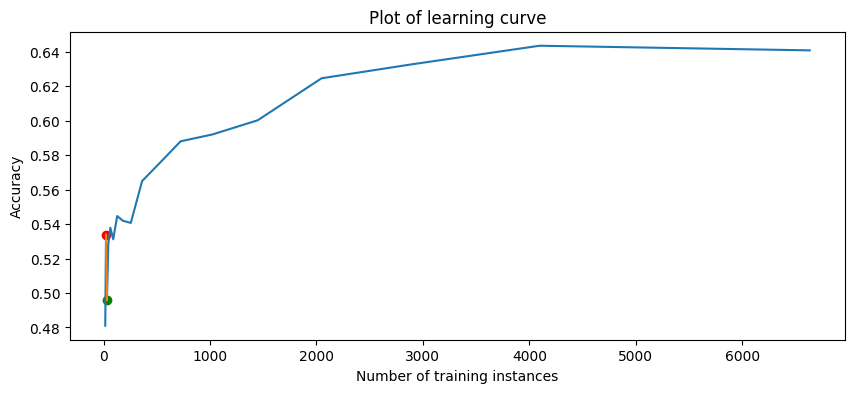

60it [02:29,  2.61s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_761;non-monotonic:True


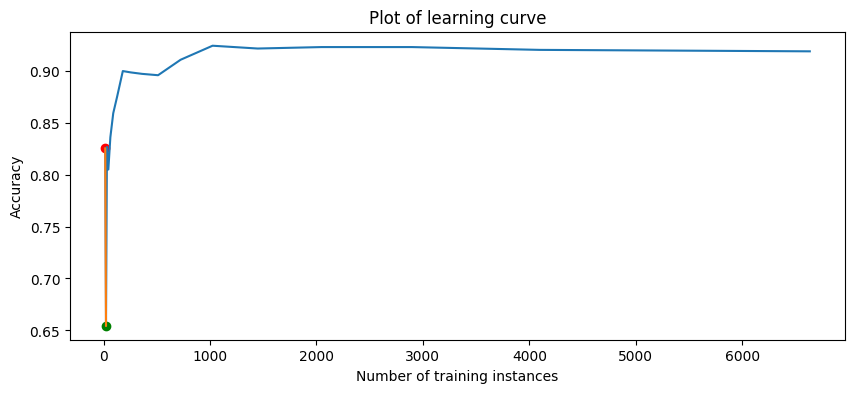

61it [02:32,  2.56s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_772;non-monotonic:True


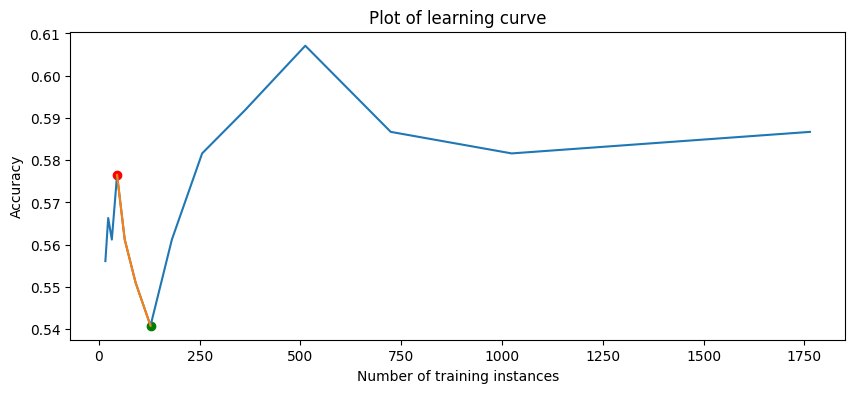

62it [02:34,  2.66s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_797;non-monotonic:True


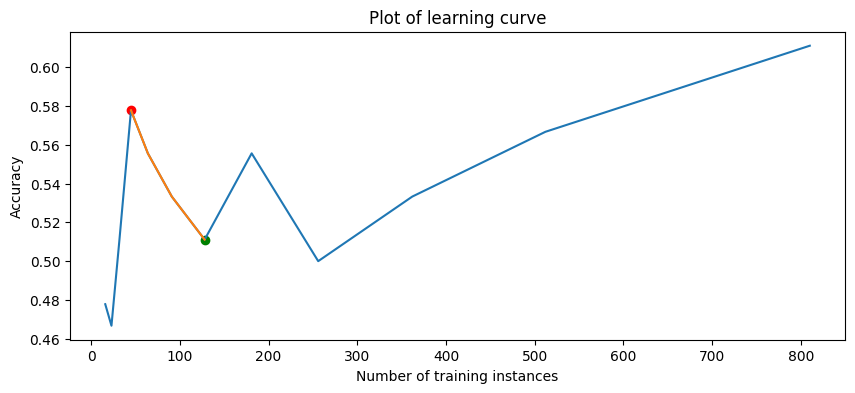

63it [02:37,  2.77s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_799;non-monotonic:True


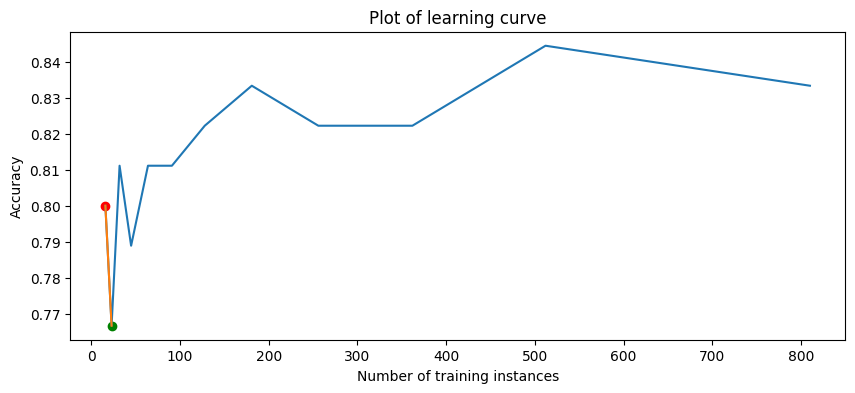

64it [02:40,  2.66s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_803;non-monotonic:True


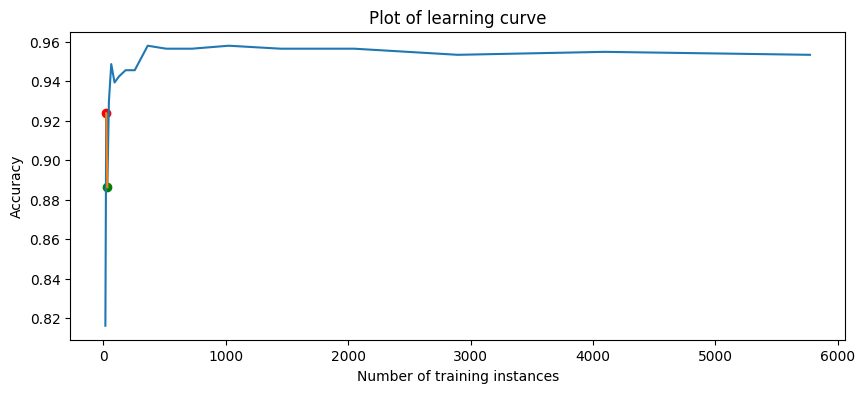

65it [02:42,  2.64s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_806;non-monotonic:True


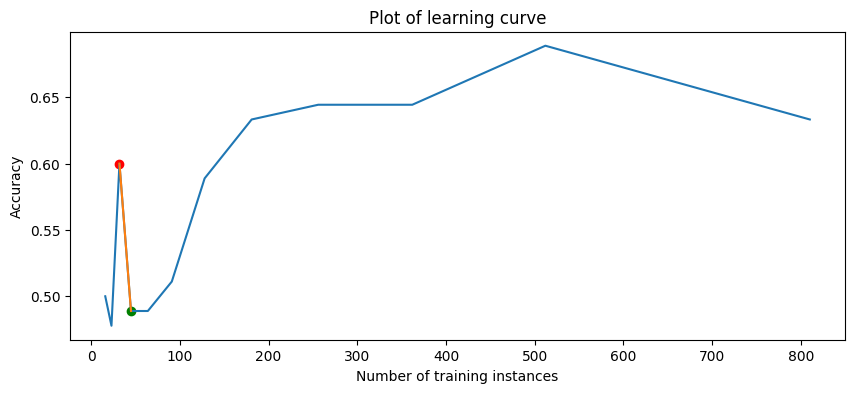

66it [02:45,  2.60s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_807;non-monotonic:True


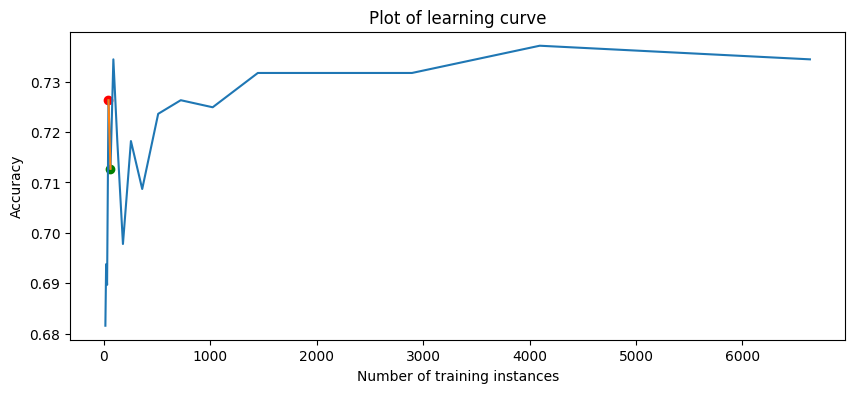

67it [02:47,  2.57s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_813;non-monotonic:True


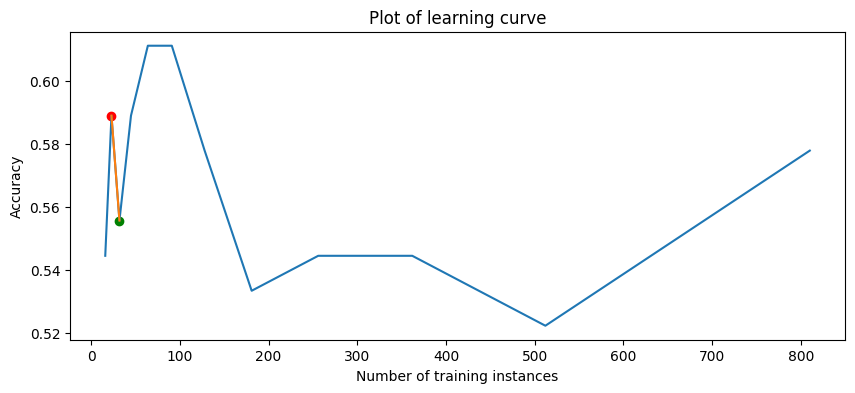

68it [02:50,  2.71s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_816;non-monotonic:True


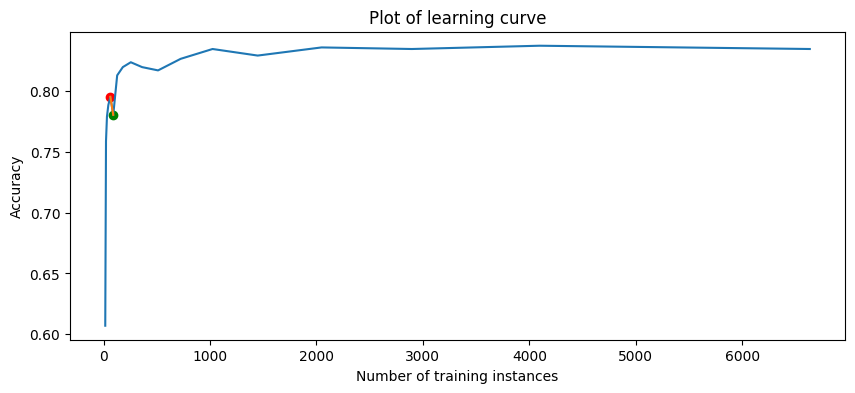

69it [02:53,  2.75s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_819;non-monotonic:False


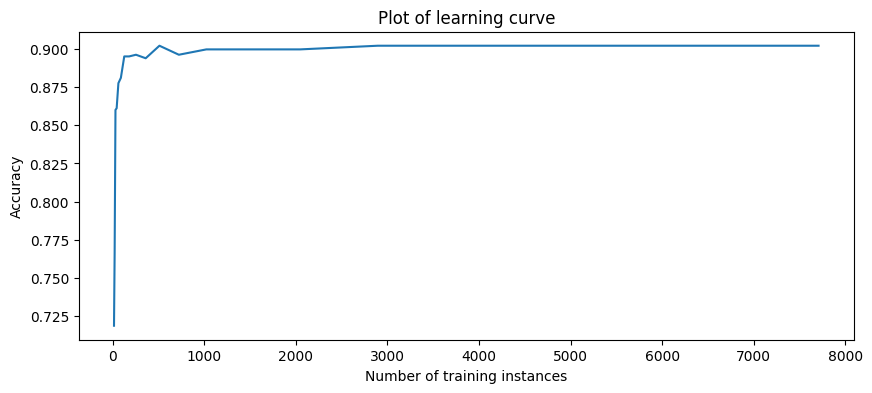

70it [02:57,  2.91s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_821;non-monotonic:True


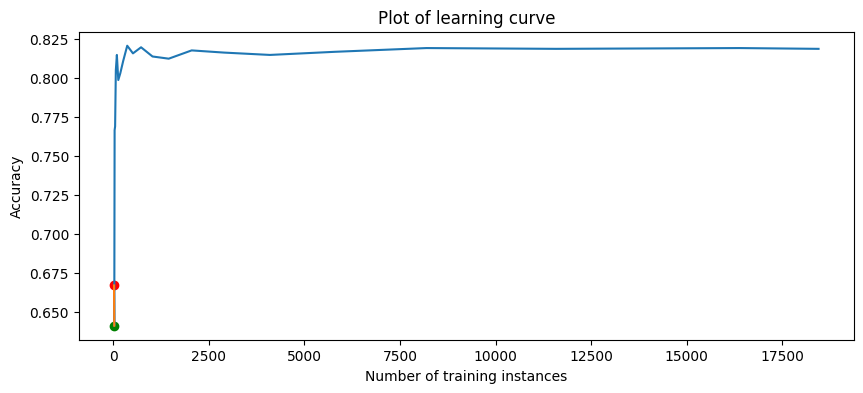

71it [02:59,  2.77s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_822;non-monotonic:True


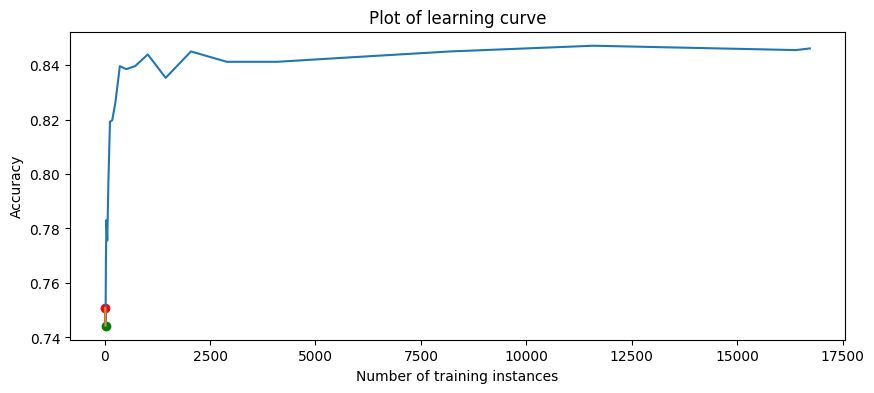

72it [03:02,  2.79s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_823;non-monotonic:False


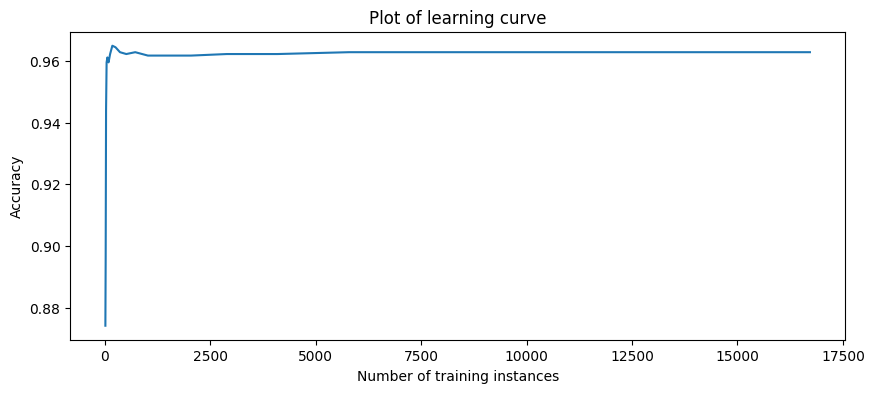

73it [03:04,  2.70s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_833;non-monotonic:True


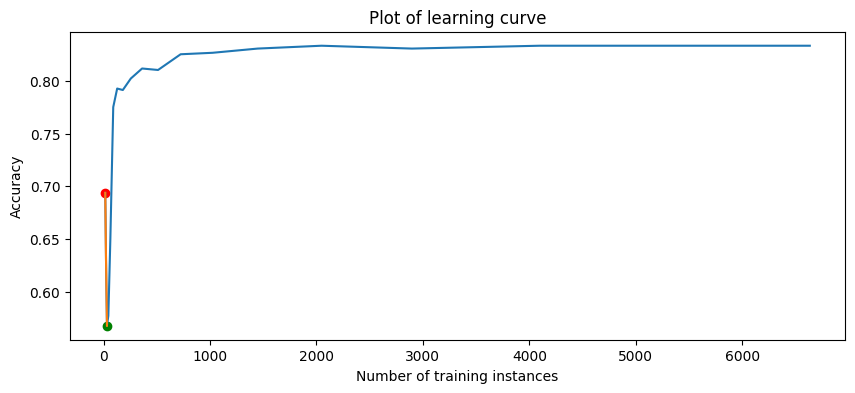

74it [03:07,  2.58s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_837;non-monotonic:True


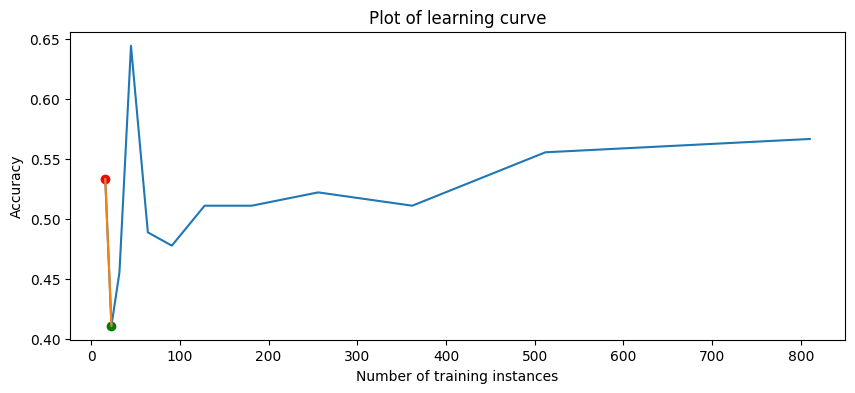

75it [03:09,  2.52s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_843;non-monotonic:True


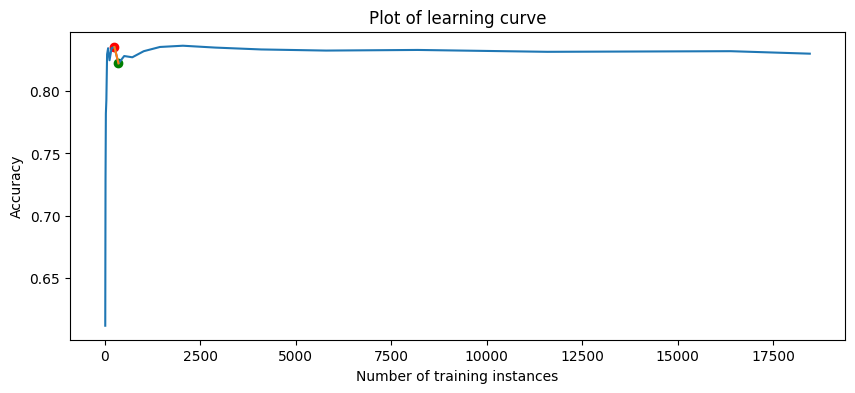

76it [03:11,  2.49s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_845;non-monotonic:True


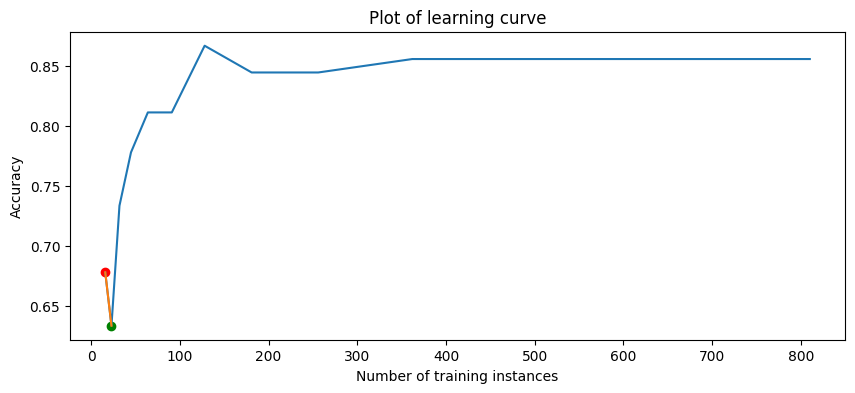

77it [03:14,  2.64s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_846;non-monotonic:True


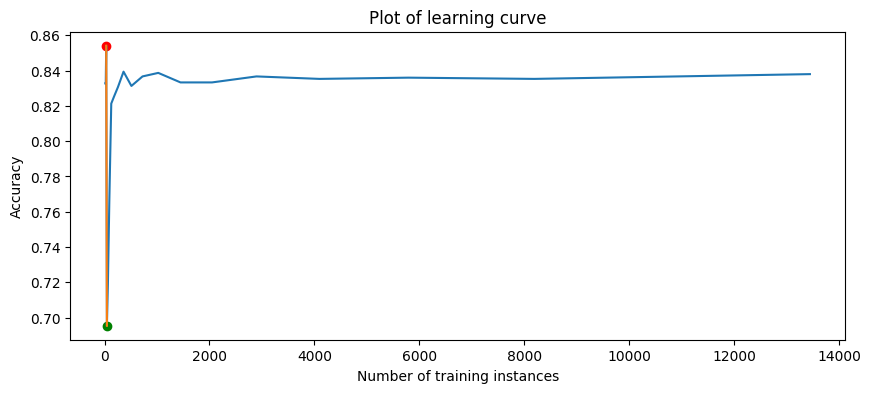

78it [03:17,  2.59s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_847;non-monotonic:False


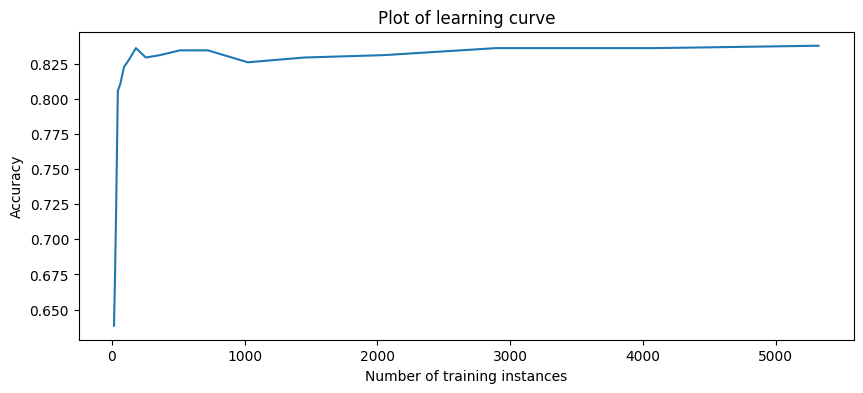

79it [03:19,  2.52s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_849;non-monotonic:True


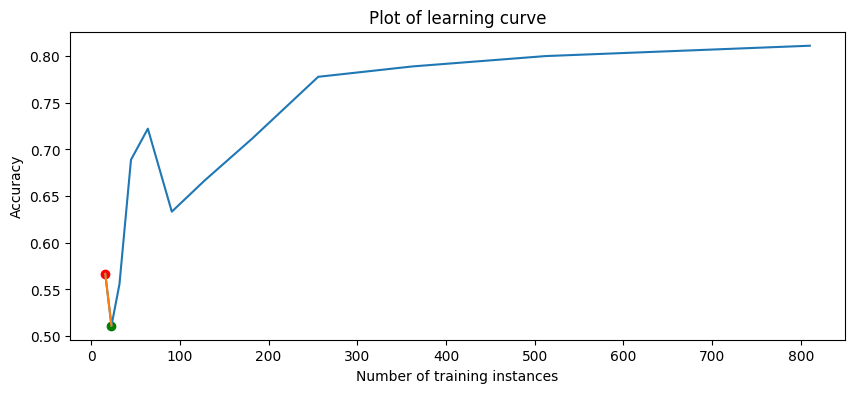

80it [03:22,  2.48s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_866;non-monotonic:True


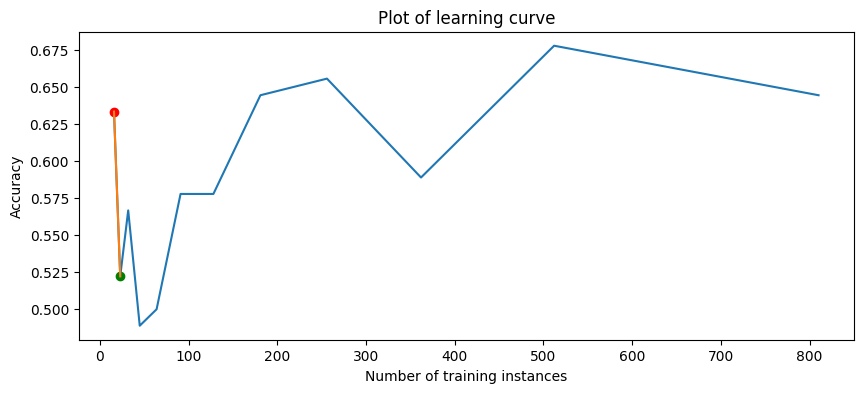

81it [03:24,  2.43s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_871;non-monotonic:True


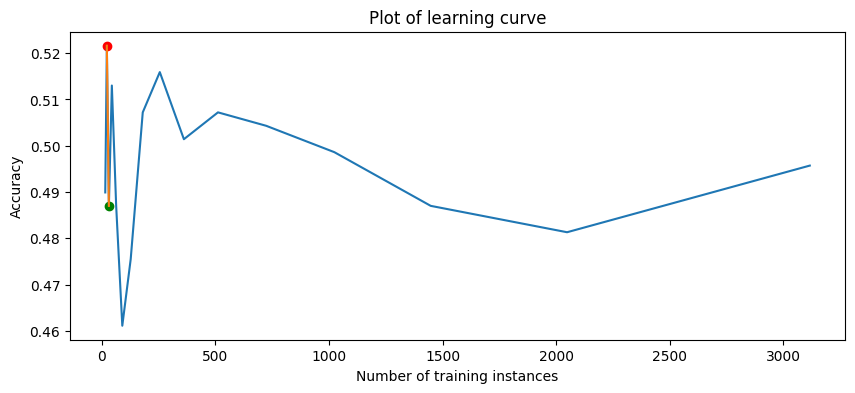

82it [03:26,  2.41s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_881;non-monotonic:True


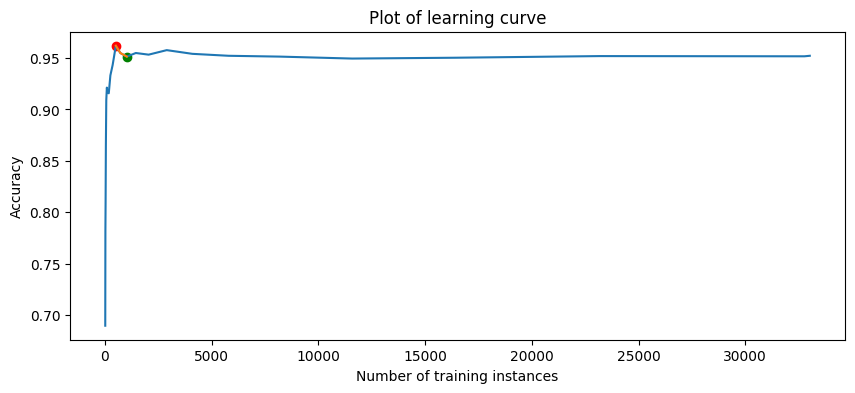

83it [03:29,  2.39s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_897;non-monotonic:True


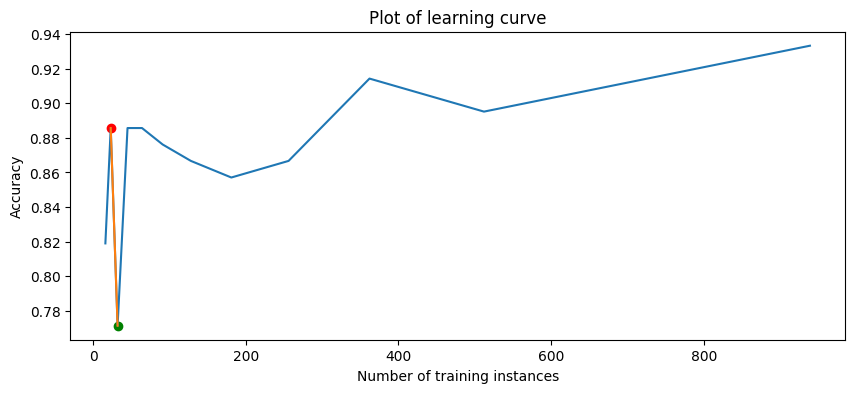

84it [03:31,  2.36s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_901;non-monotonic:True


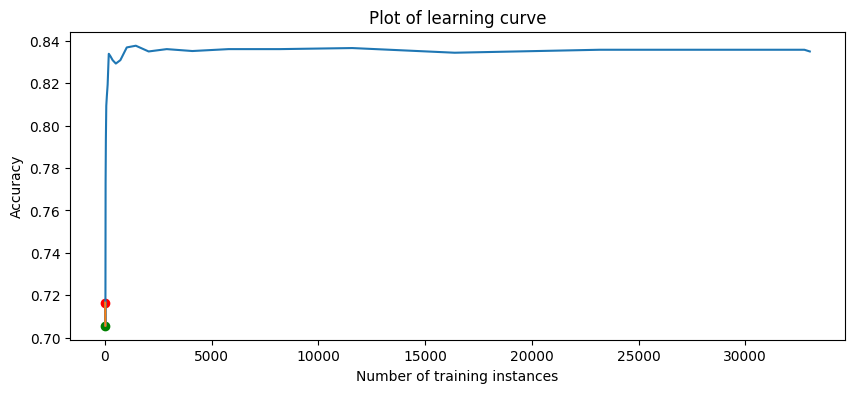

85it [03:33,  2.36s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_903;non-monotonic:True


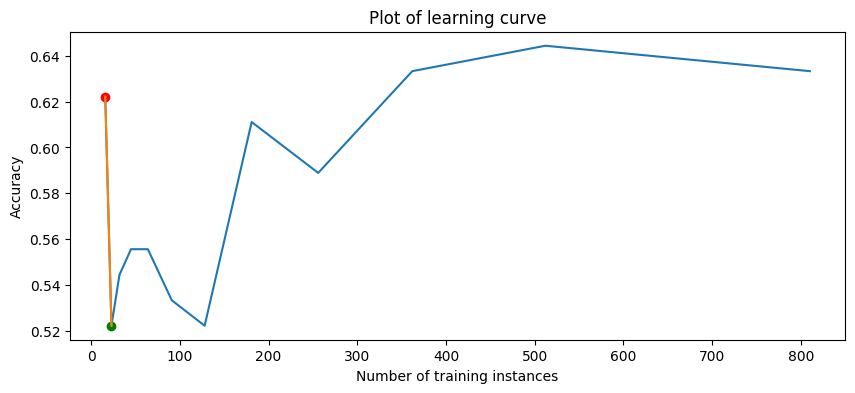

86it [03:36,  2.34s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_904;non-monotonic:True


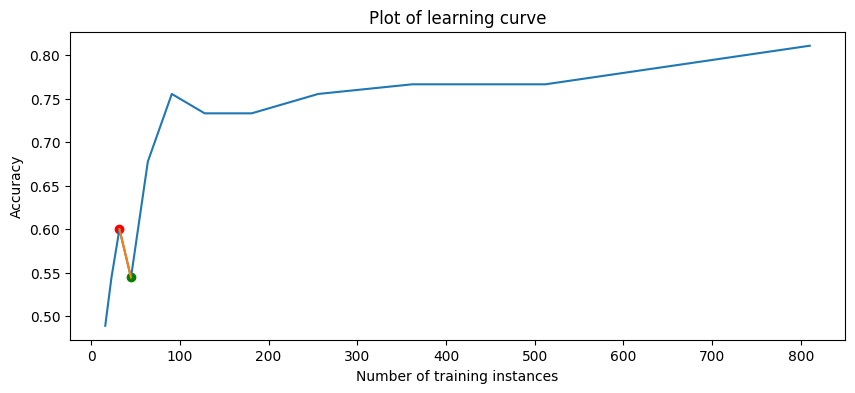

87it [03:38,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_910;non-monotonic:True


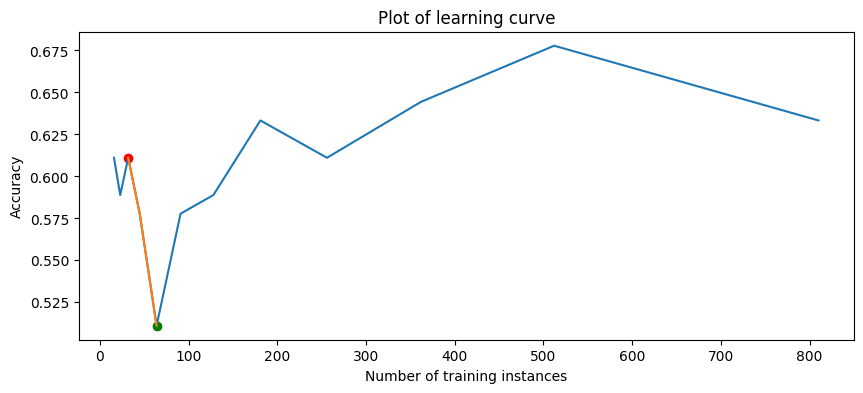

88it [03:40,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_912;non-monotonic:True


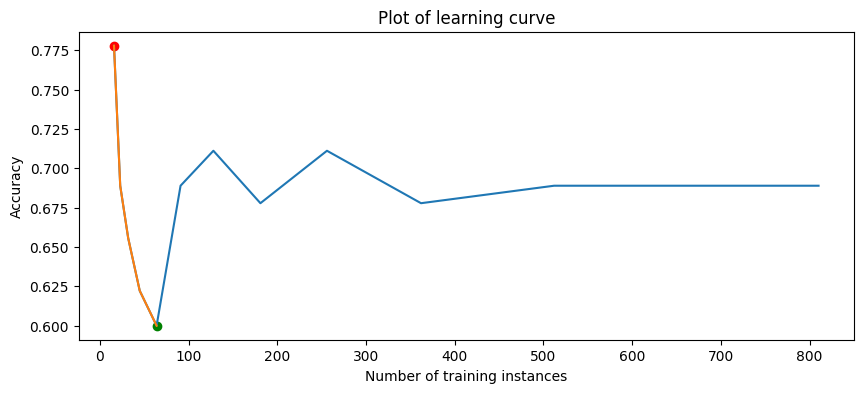

89it [03:43,  2.38s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_913;non-monotonic:True


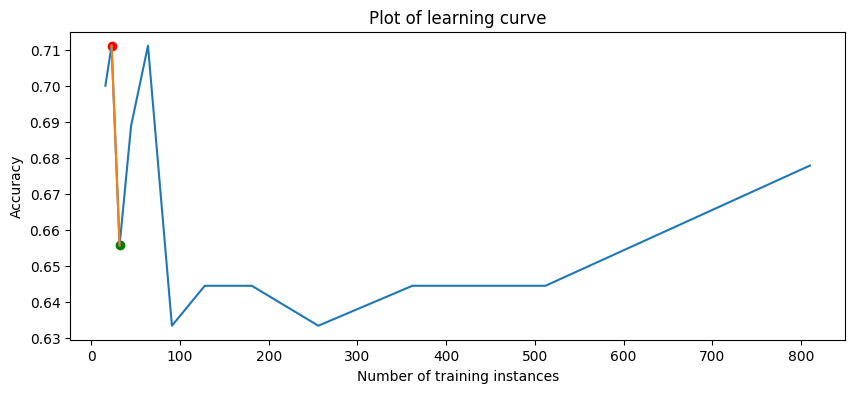

90it [03:46,  2.52s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_914;non-monotonic:True


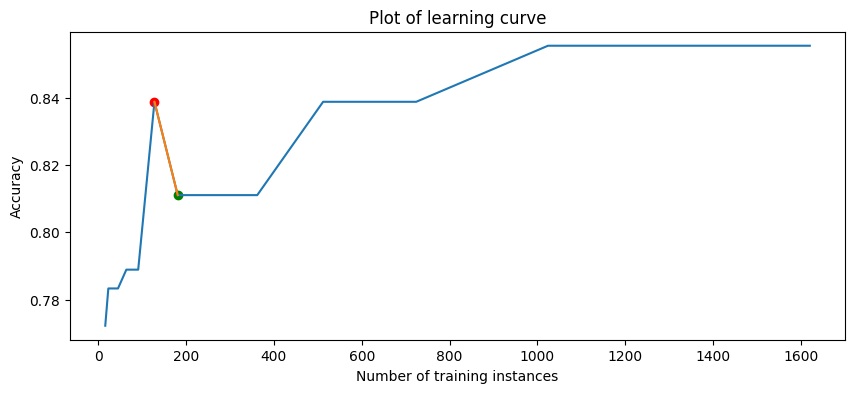

91it [03:48,  2.52s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_917;non-monotonic:True


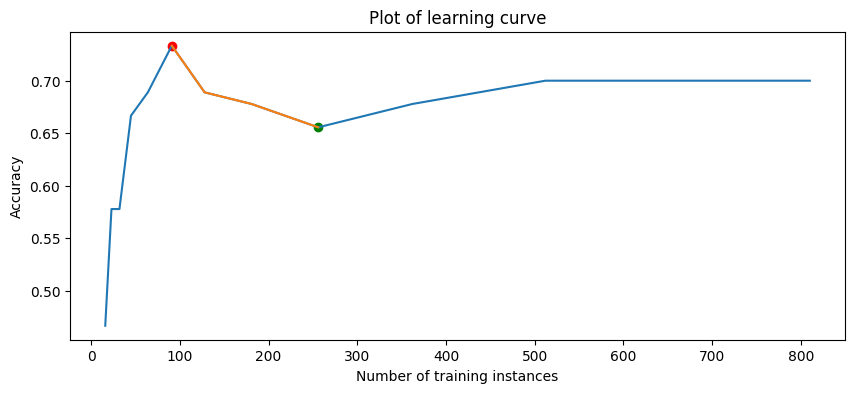

92it [03:51,  2.56s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_923;non-monotonic:True


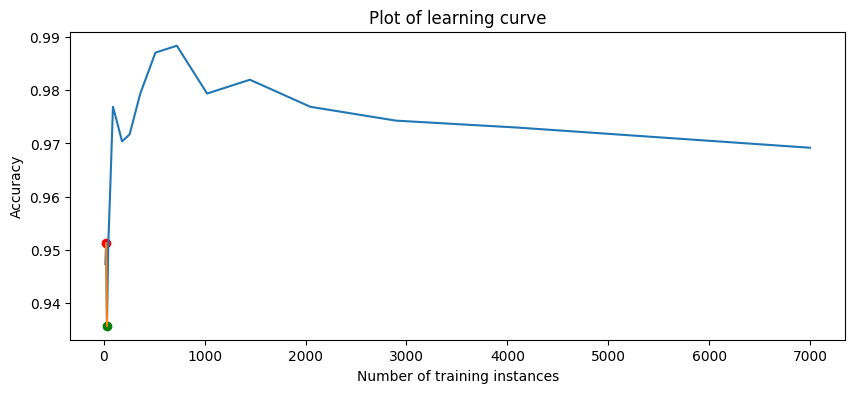

93it [03:53,  2.47s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_930;non-monotonic:True


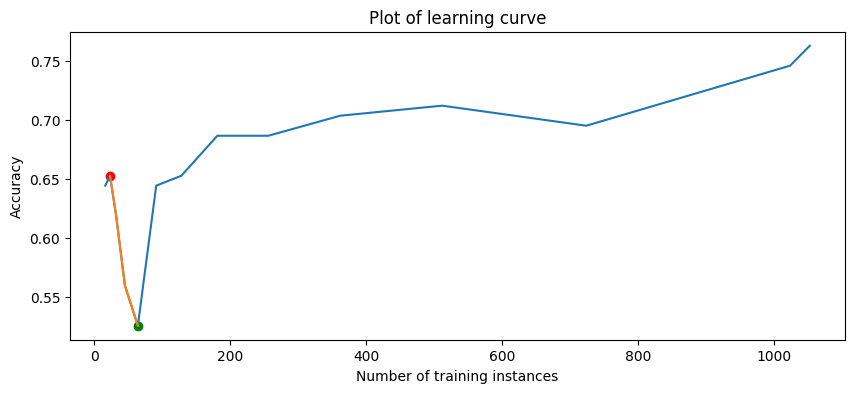

94it [03:56,  2.52s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_934;non-monotonic:True


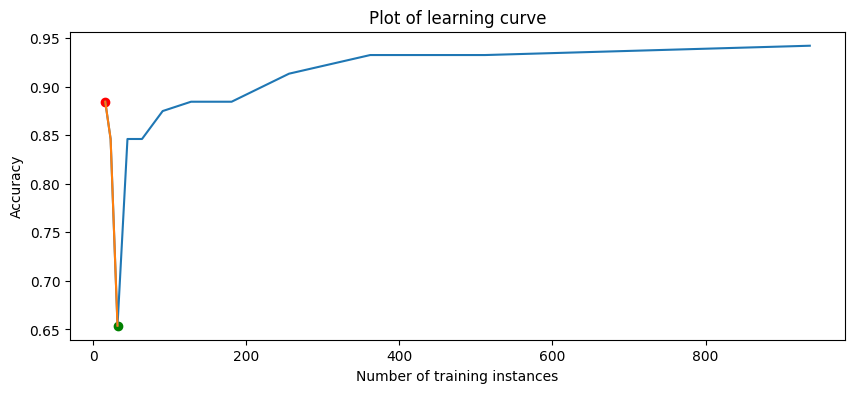

95it [03:58,  2.53s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_958;non-monotonic:False


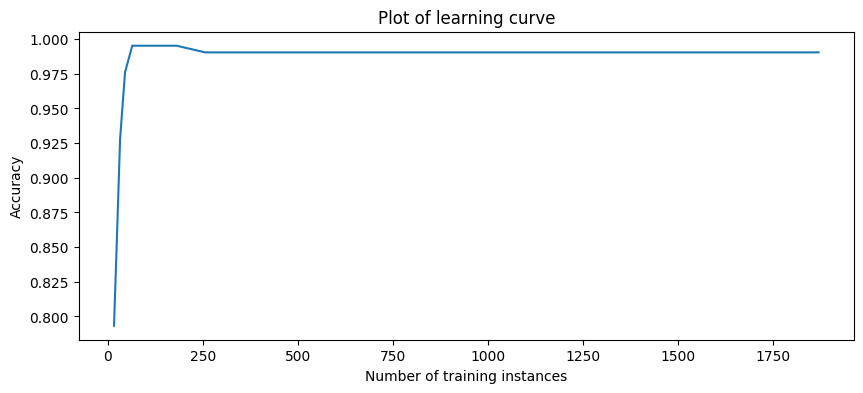

96it [04:01,  2.49s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_959;non-monotonic:True


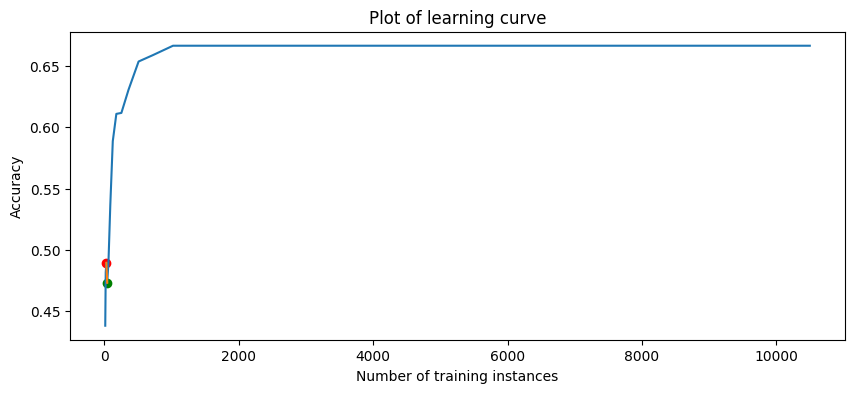

97it [04:03,  2.45s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_966;non-monotonic:True


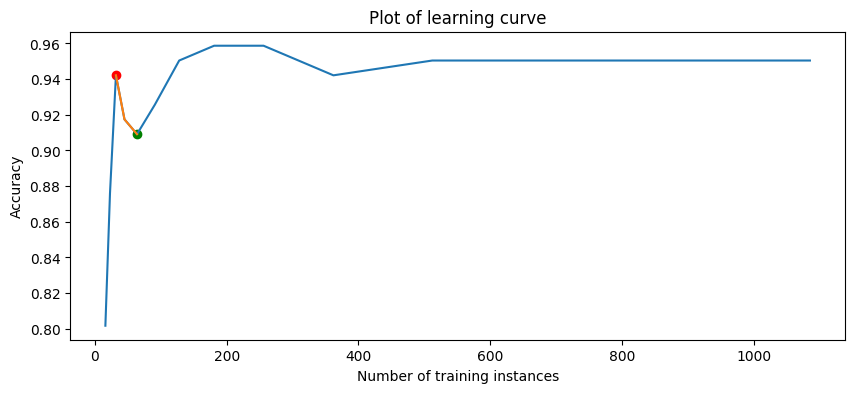

98it [04:06,  2.48s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_976;non-monotonic:False


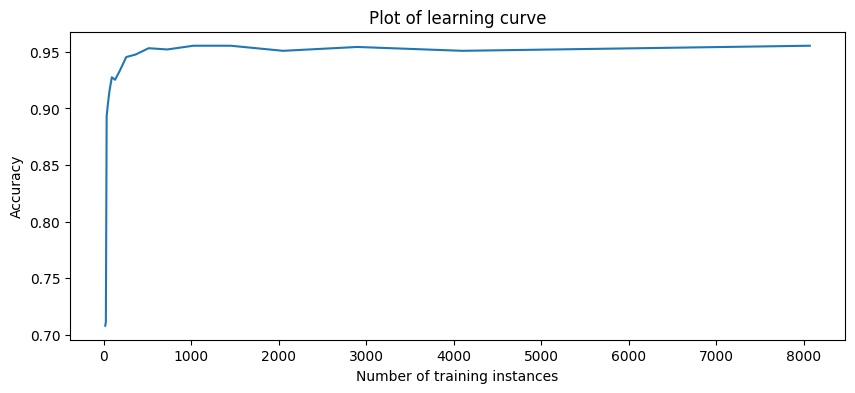

99it [04:08,  2.43s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_979;non-monotonic:True


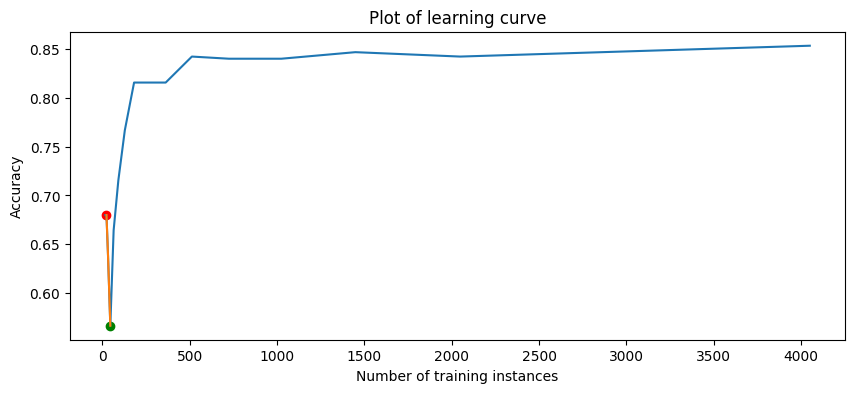

100it [04:10,  2.42s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_980;non-monotonic:True


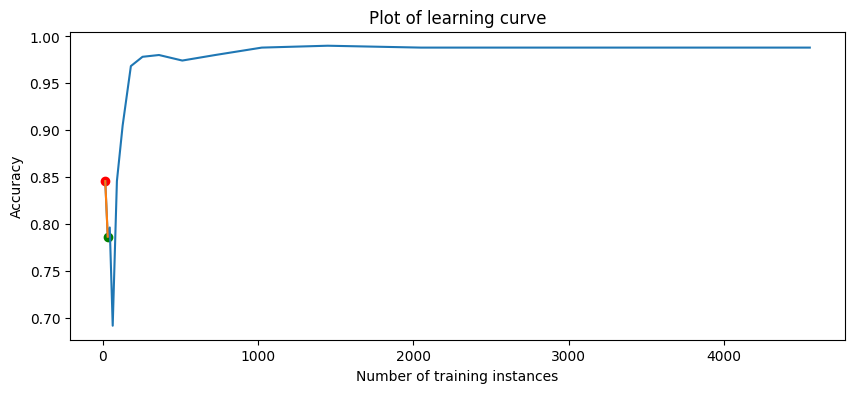

101it [04:13,  2.41s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_991;non-monotonic:True


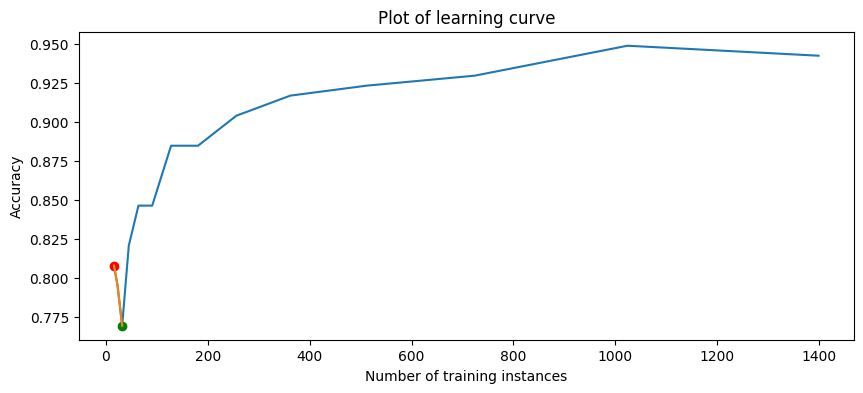

102it [04:15,  2.40s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1041;non-monotonic:True


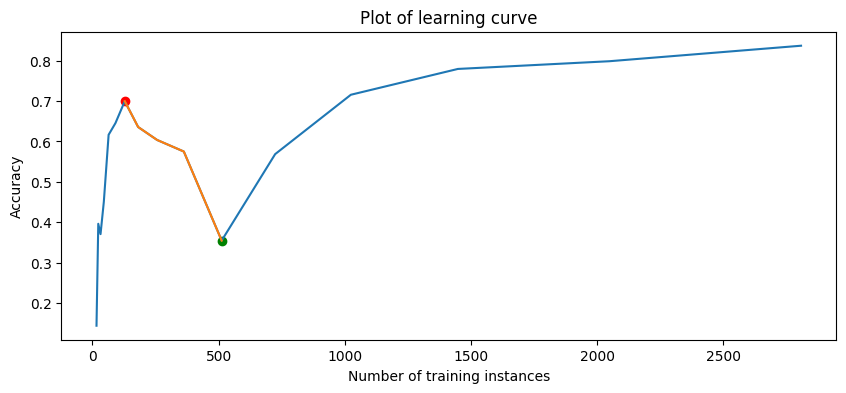

103it [04:17,  2.38s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1042;non-monotonic:True


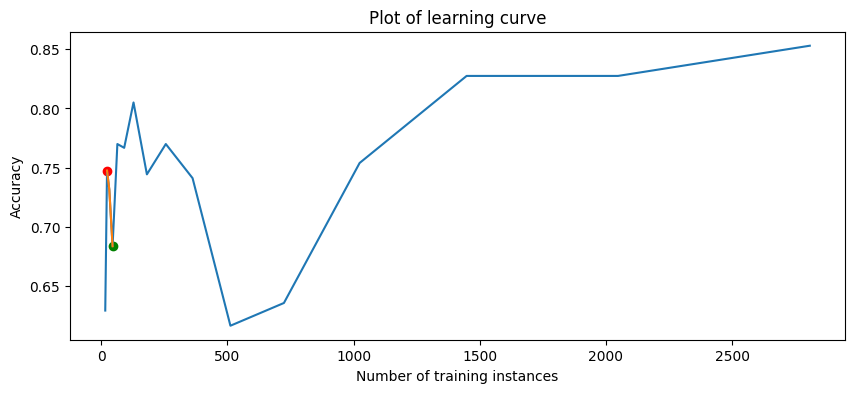

104it [04:20,  2.36s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1053;non-monotonic:True


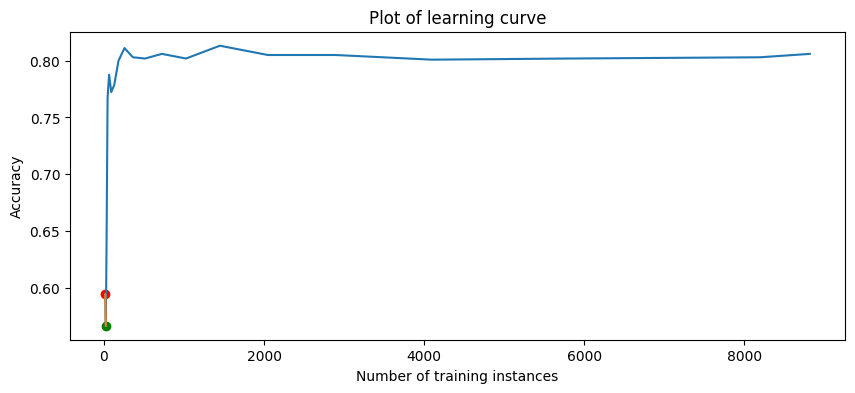

105it [04:22,  2.35s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1067;non-monotonic:True


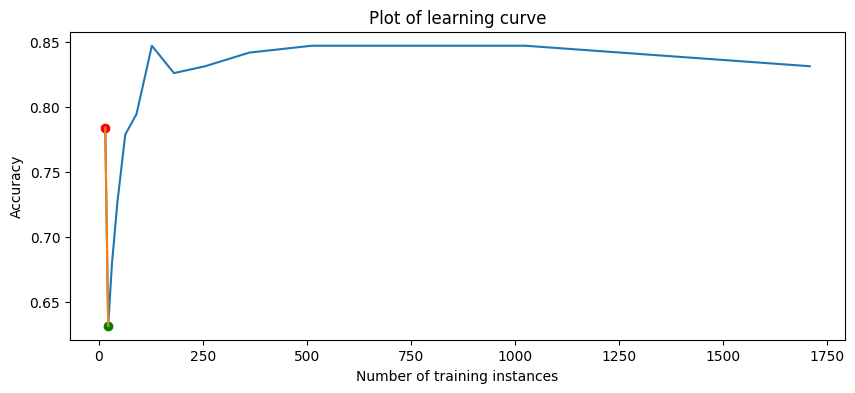

106it [04:24,  2.34s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1083;non-monotonic:False


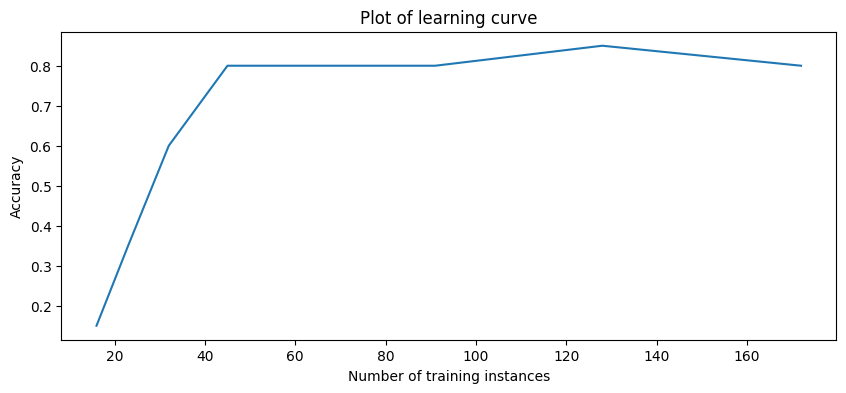

107it [04:27,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1084;non-monotonic:False


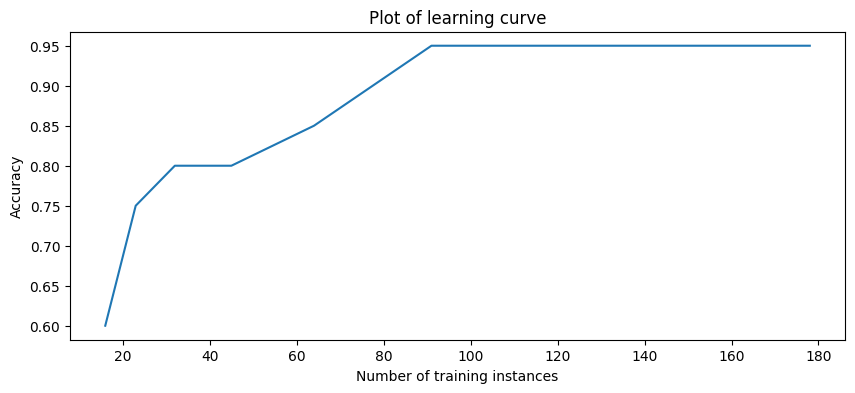

108it [04:29,  2.36s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1085;non-monotonic:True


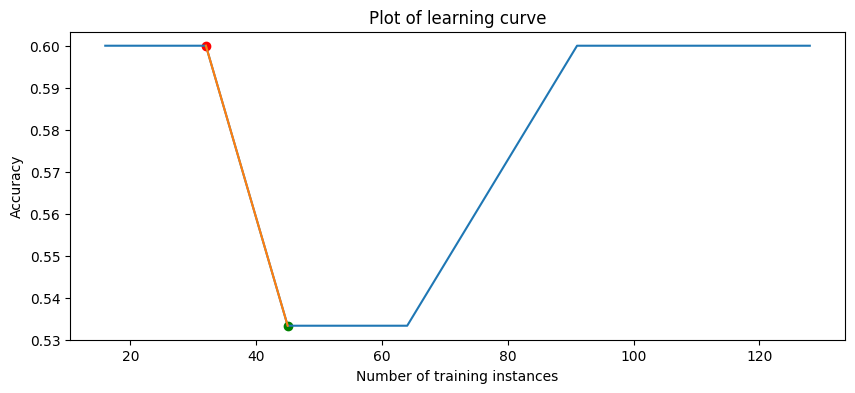

109it [04:32,  2.48s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1086;non-monotonic:False


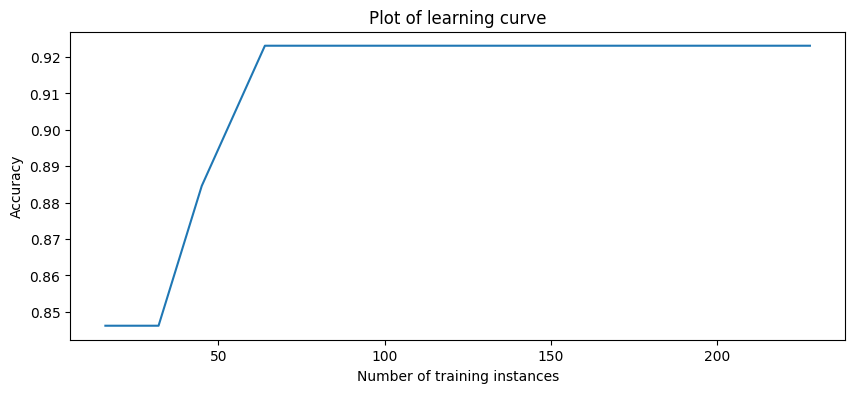

110it [04:34,  2.52s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1087;non-monotonic:False


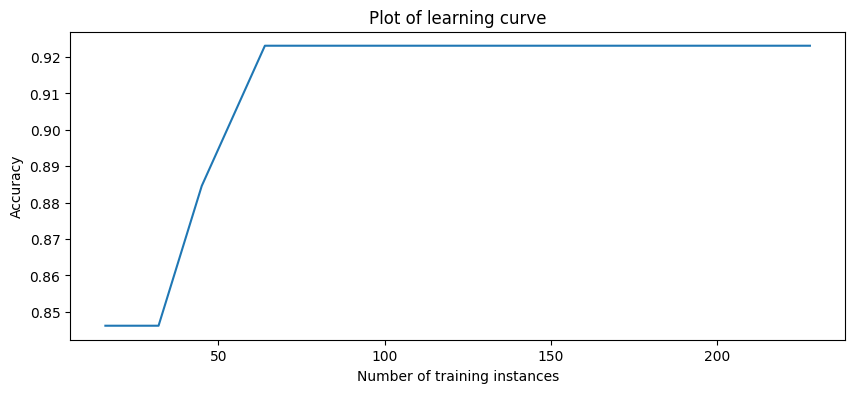

111it [04:37,  2.61s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1088;non-monotonic:False


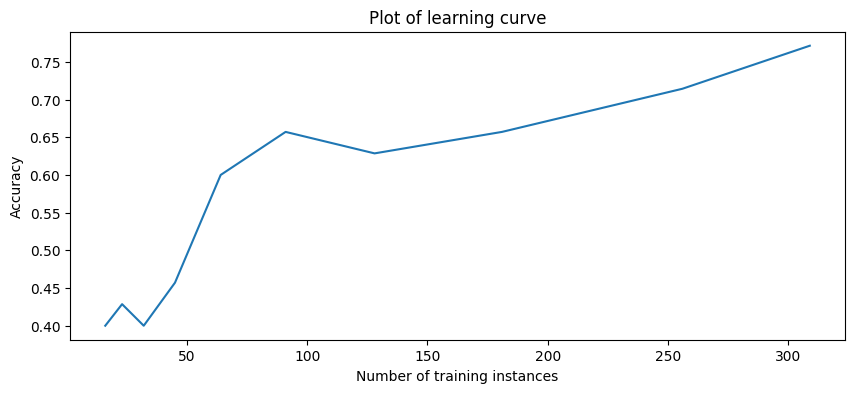

112it [04:40,  2.62s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1120;non-monotonic:True


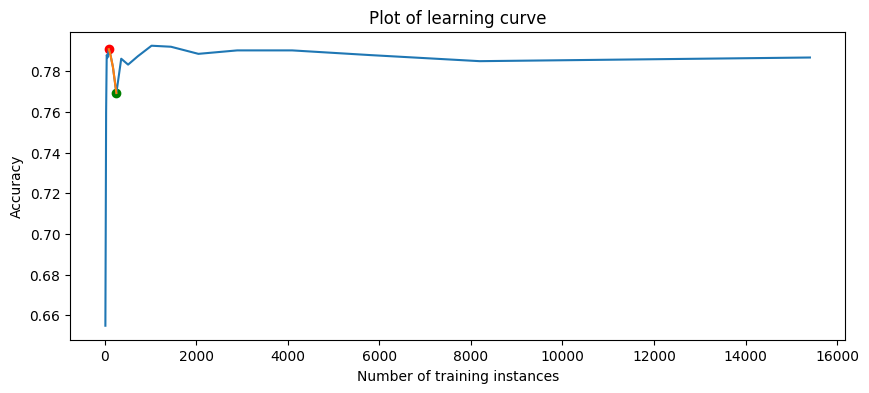

113it [04:42,  2.57s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1128;non-monotonic:True


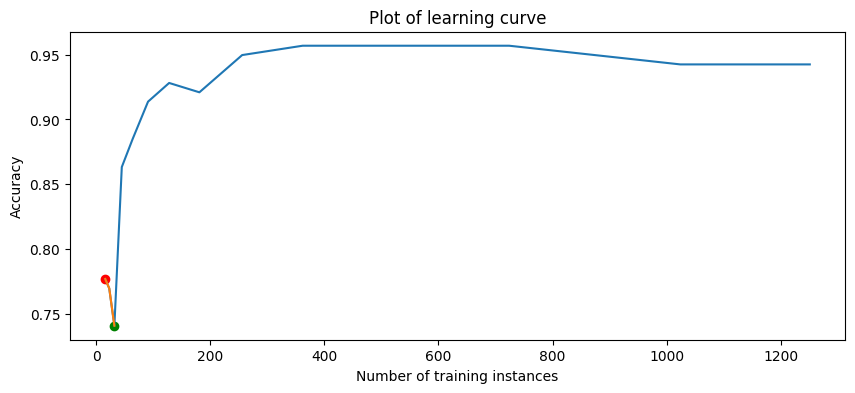

114it [04:45,  2.51s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1130;non-monotonic:True


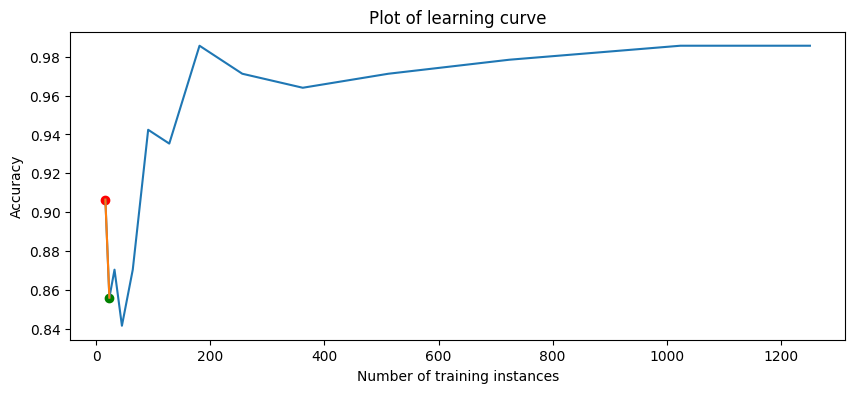

115it [04:47,  2.44s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1134;non-monotonic:True


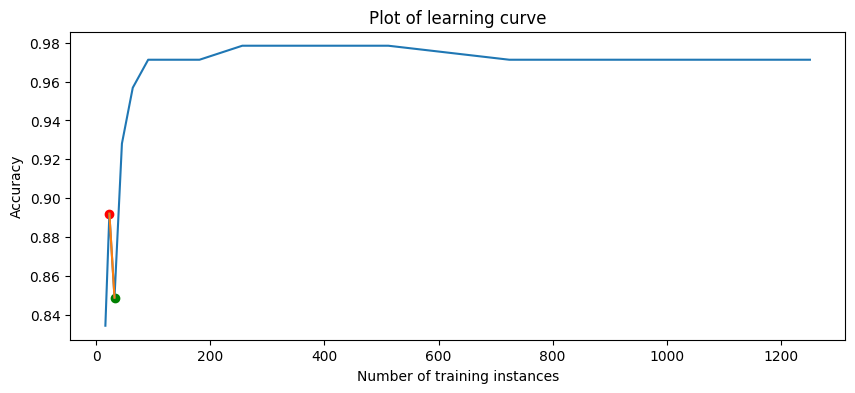

116it [04:49,  2.41s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1161;non-monotonic:True


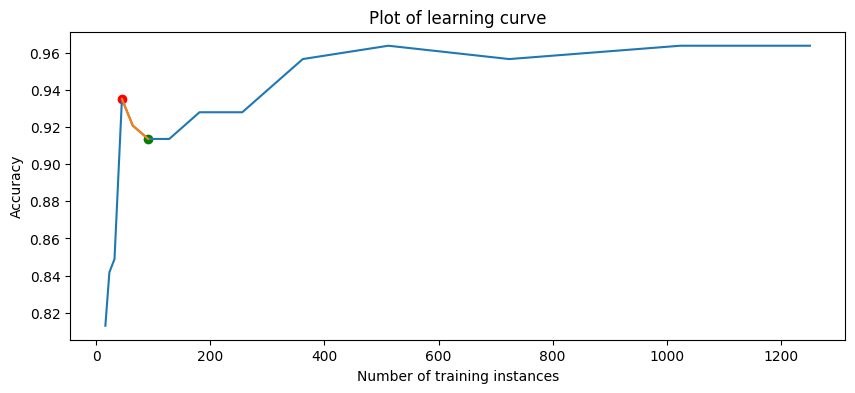

117it [04:52,  2.39s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1233;non-monotonic:True


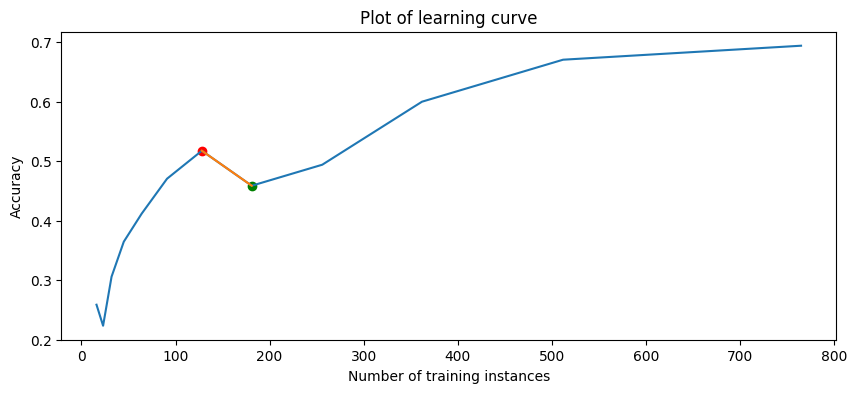

118it [04:54,  2.36s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1235;non-monotonic:True


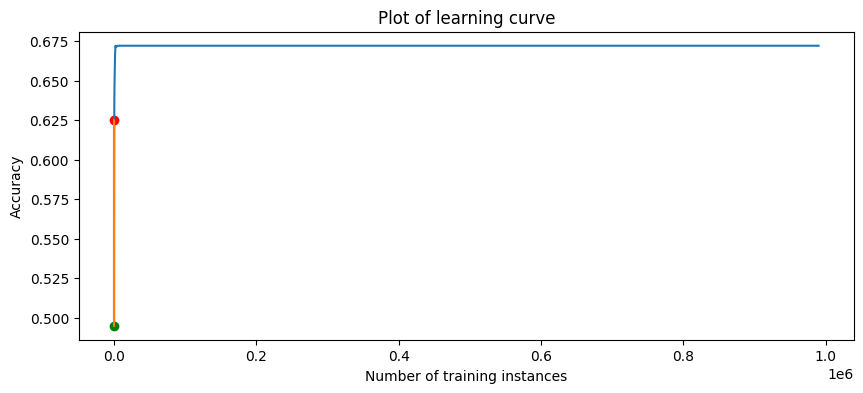

119it [04:56,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1236;non-monotonic:False


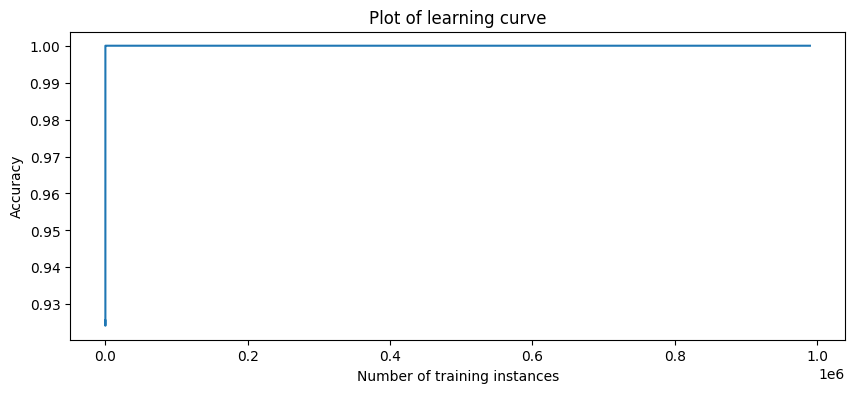

120it [04:58,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1448;non-monotonic:True


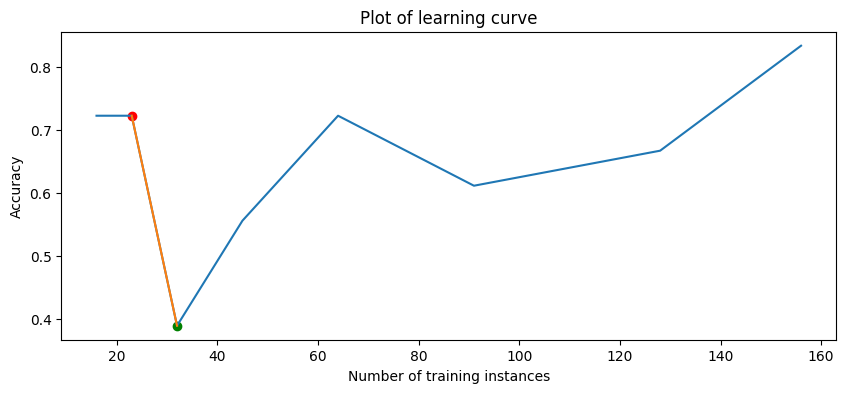

121it [05:01,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1450;non-monotonic:True


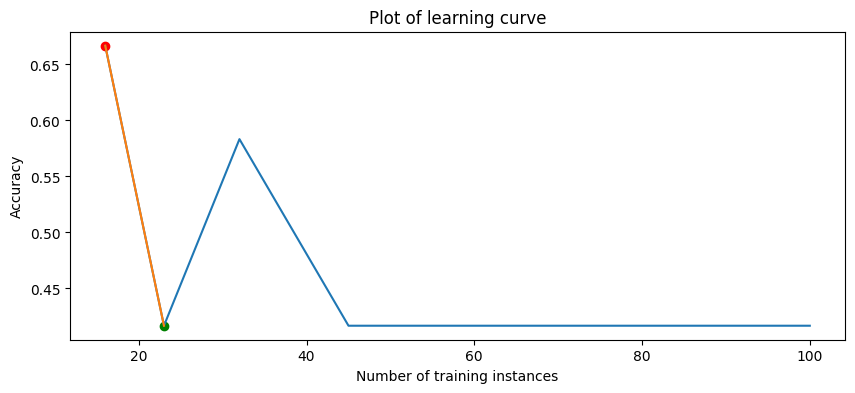

122it [05:03,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1457;non-monotonic:True


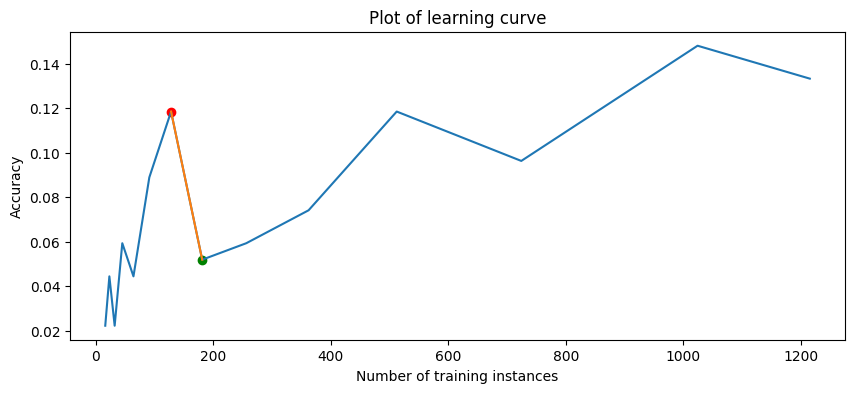

123it [05:05,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1465;non-monotonic:False


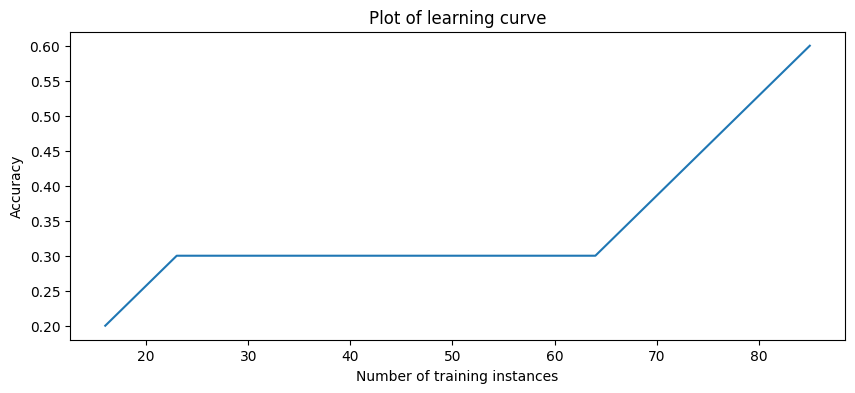

124it [05:08,  2.29s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1468;non-monotonic:True


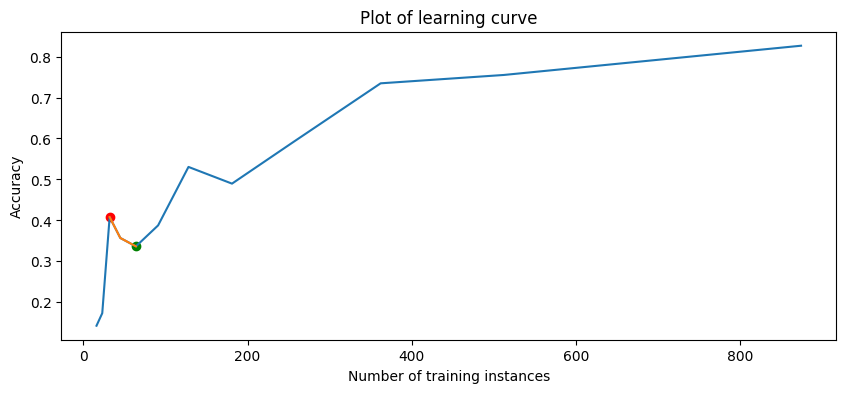

125it [05:10,  2.35s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1475;non-monotonic:True


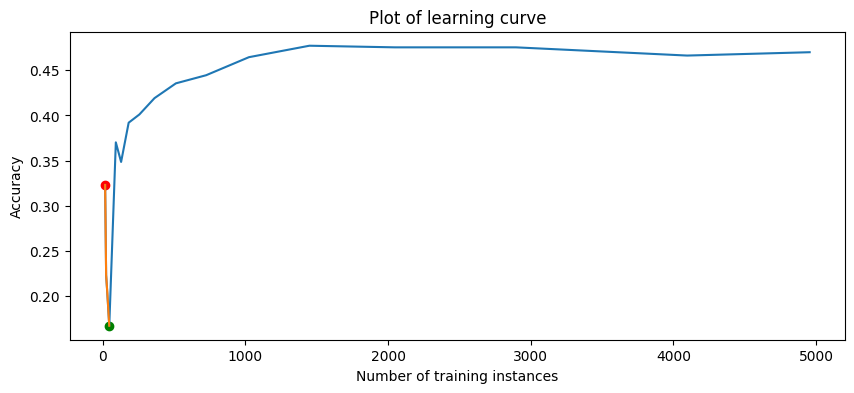

126it [05:12,  2.35s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1477;non-monotonic:True


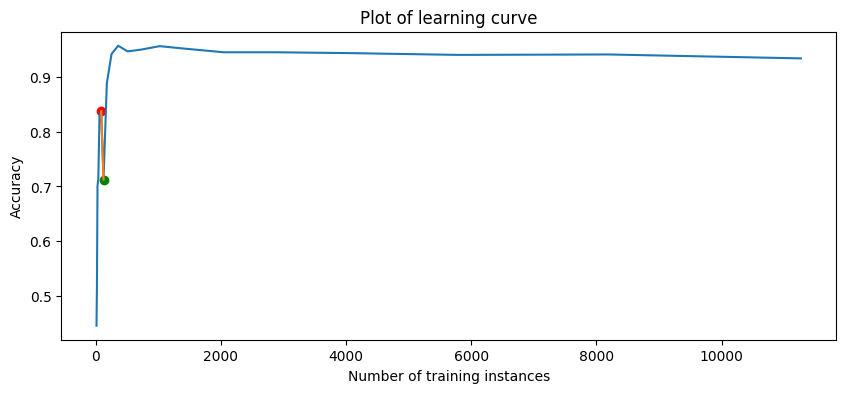

127it [05:15,  2.34s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1479;non-monotonic:True


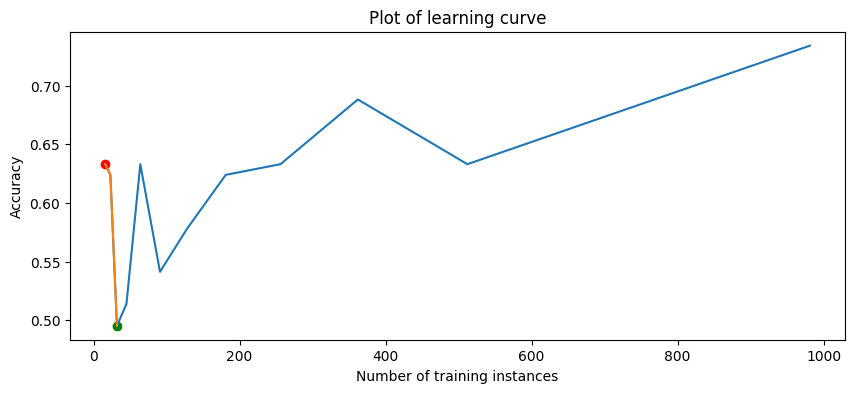

128it [05:17,  2.35s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1483;non-monotonic:True


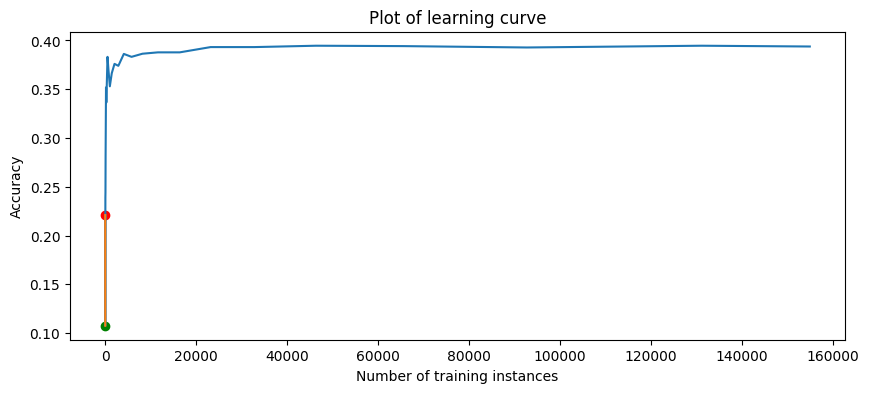

129it [05:20,  2.35s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1485;non-monotonic:True


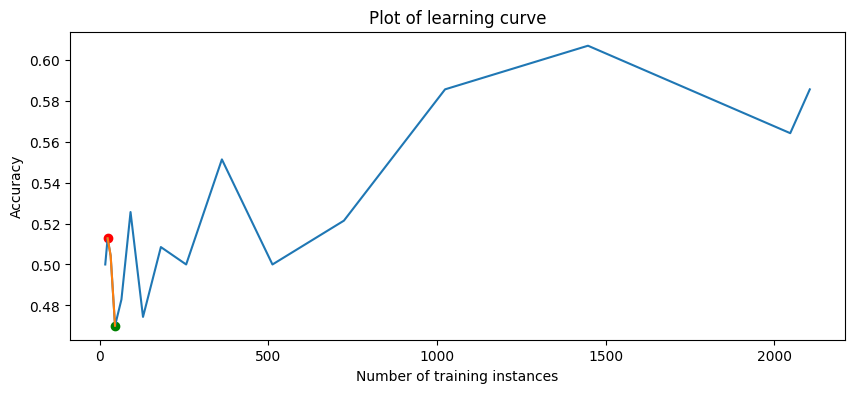

130it [05:22,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1488;non-monotonic:True


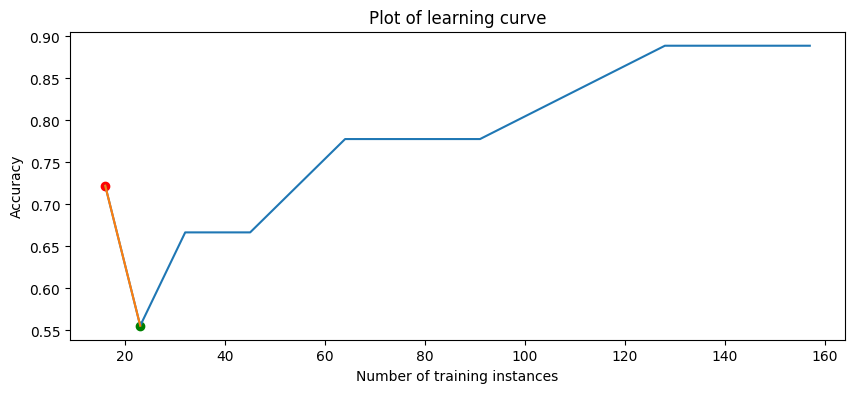

131it [05:24,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1489;non-monotonic:True


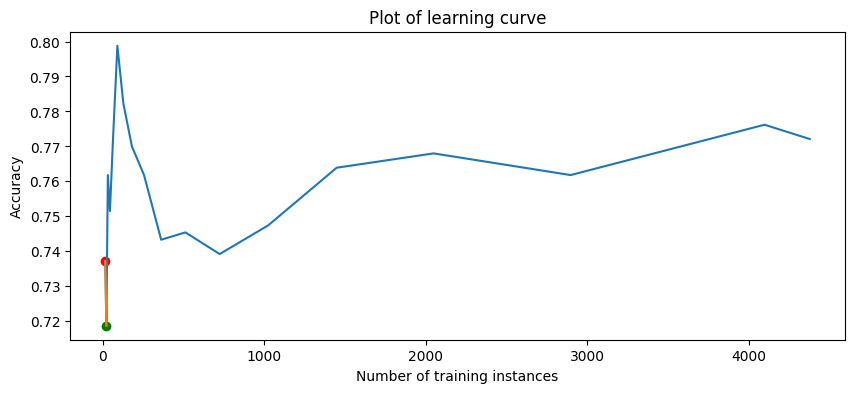

132it [05:26,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1494;non-monotonic:True


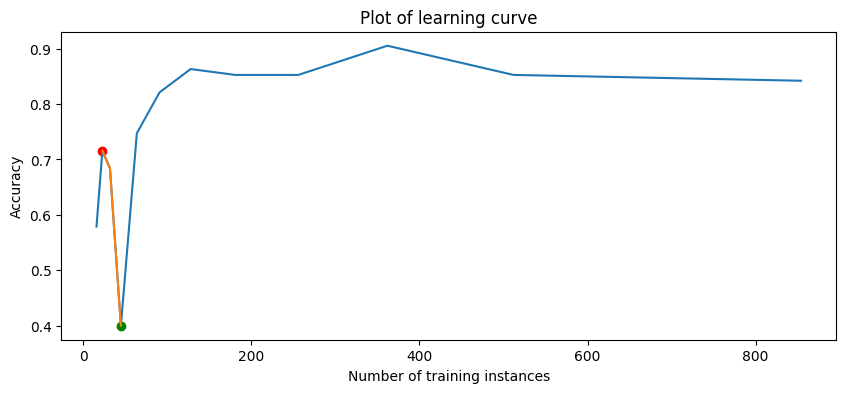

133it [05:29,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1499;non-monotonic:False


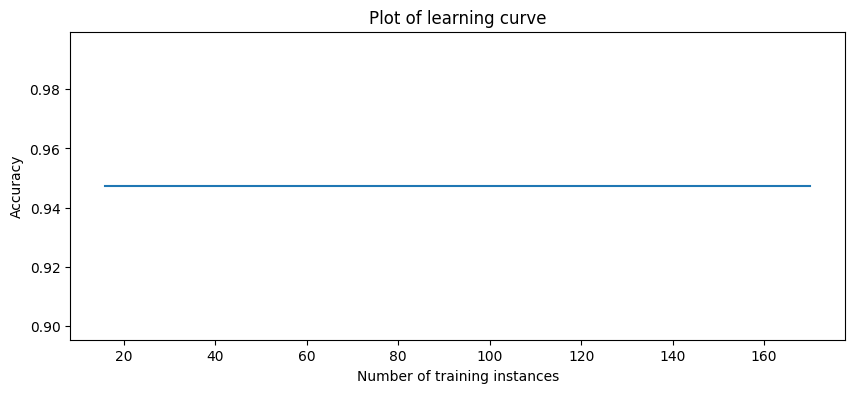

134it [05:31,  2.28s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1503;non-monotonic:True


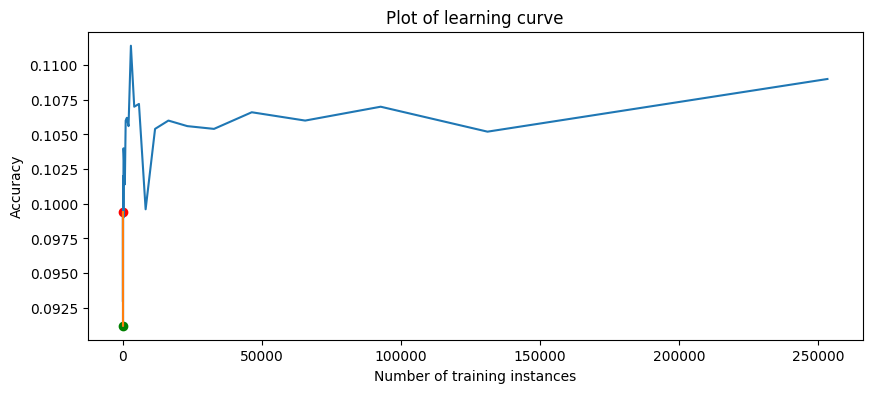

135it [05:33,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1509;non-monotonic:True


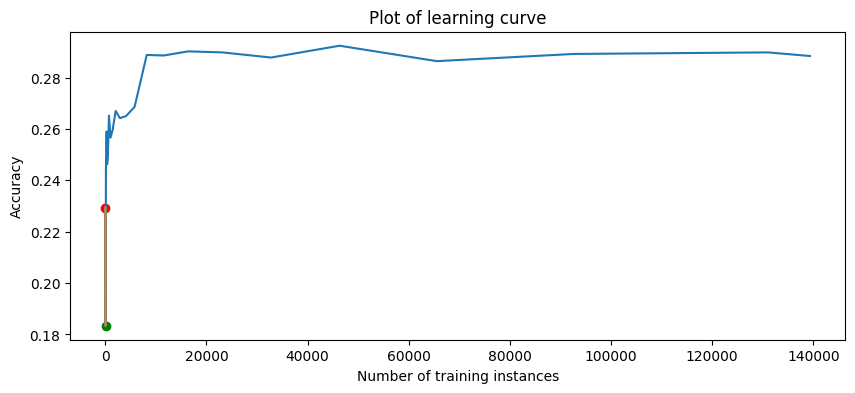

136it [05:36,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1515;non-monotonic:False


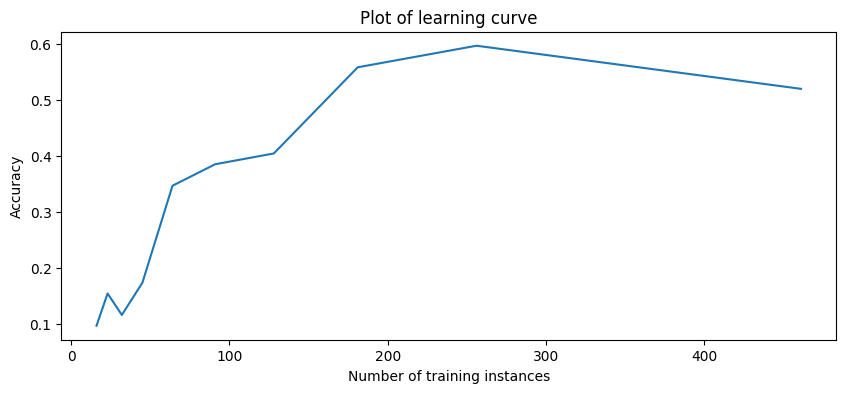

137it [05:38,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1566;non-monotonic:True


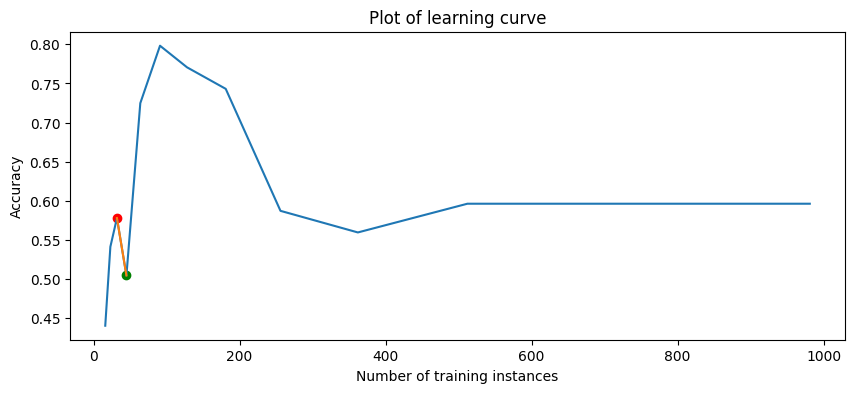

138it [05:40,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_1567;non-monotonic:True


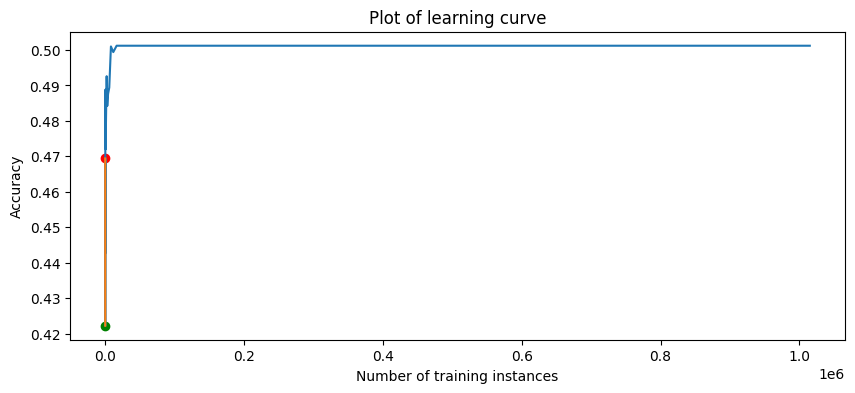

139it [05:43,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_4134;non-monotonic:True


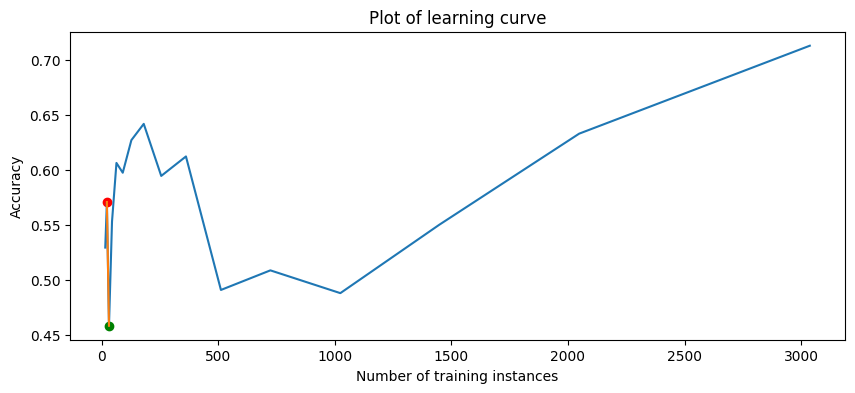

140it [05:45,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_4538;non-monotonic:True


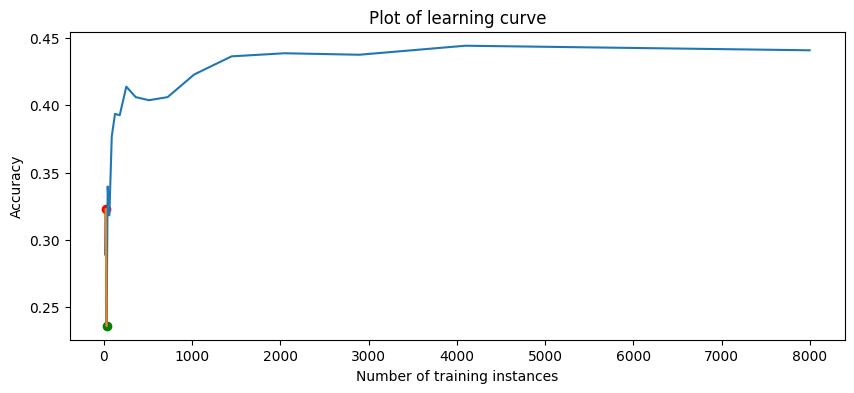

141it [05:47,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_23512;non-monotonic:True


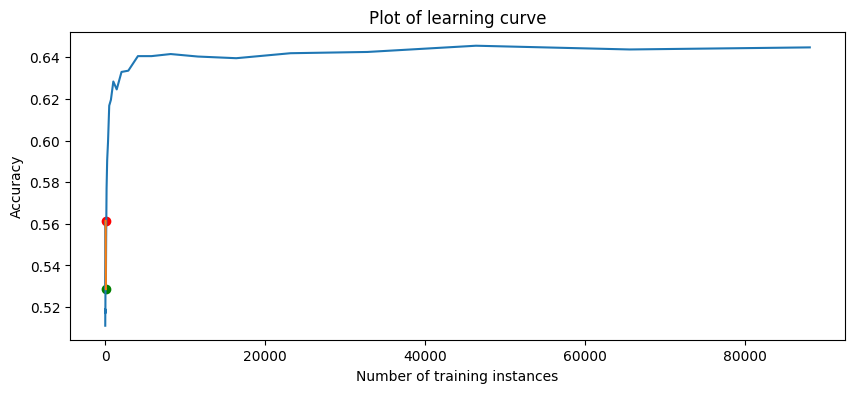

142it [05:50,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_23517;non-monotonic:True


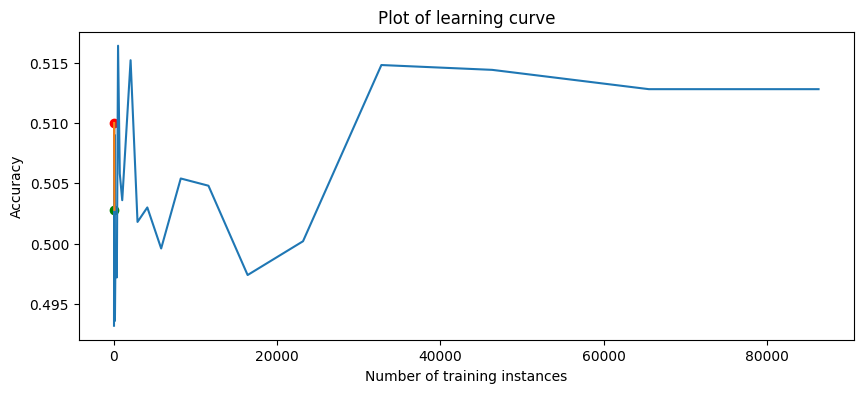

143it [05:52,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_40498;non-monotonic:True


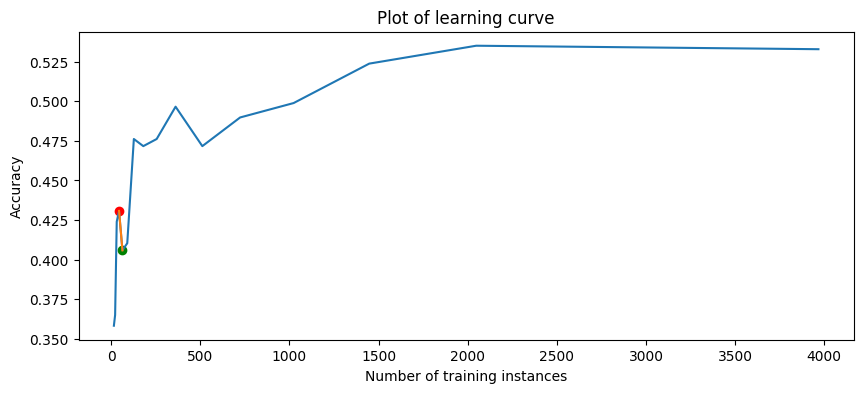

144it [05:54,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_40685;non-monotonic:True


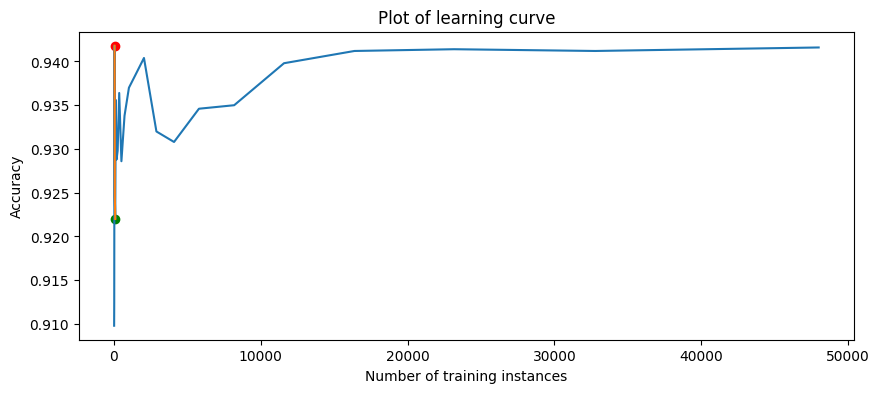

145it [05:57,  2.37s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_40971;non-monotonic:True


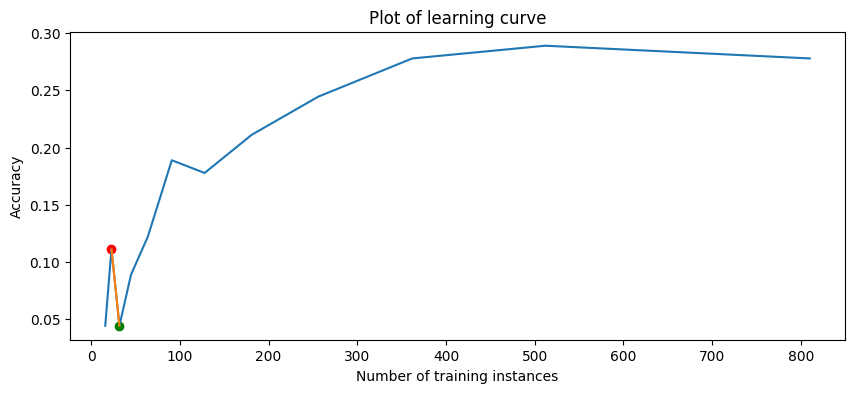

146it [05:59,  2.36s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_40975;non-monotonic:False


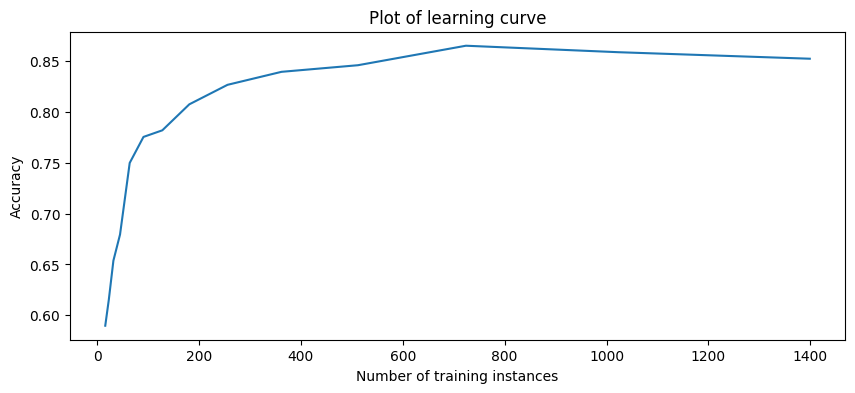

147it [06:01,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_40981;non-monotonic:False


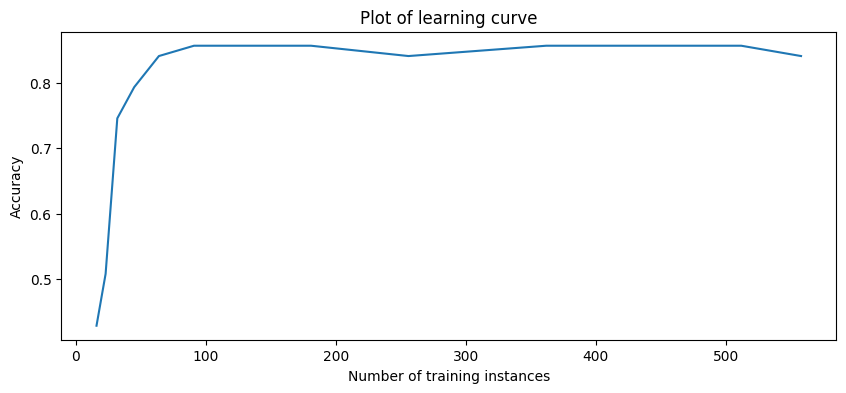

148it [06:04,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_40982;non-monotonic:True


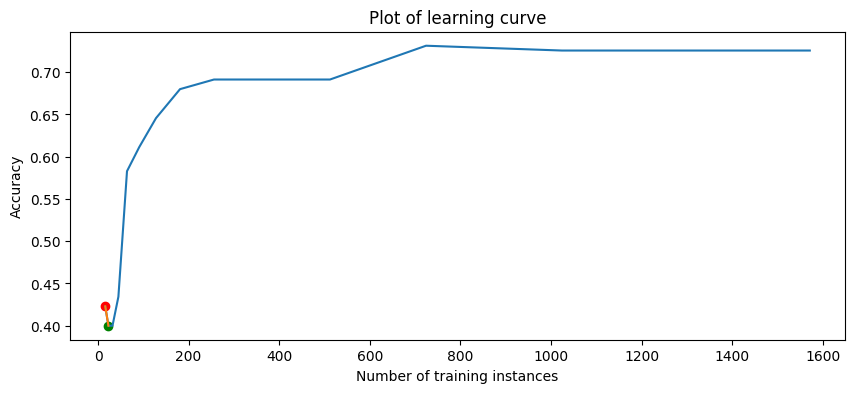

149it [06:06,  2.43s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_40984;non-monotonic:True


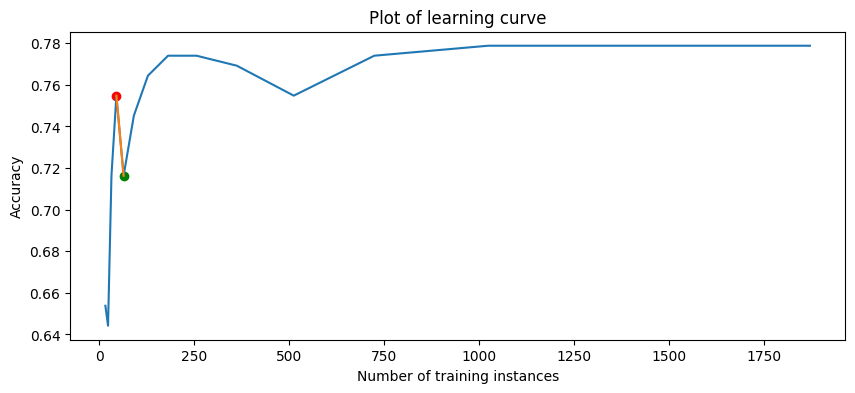

150it [06:09,  2.40s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_40996;non-monotonic:True


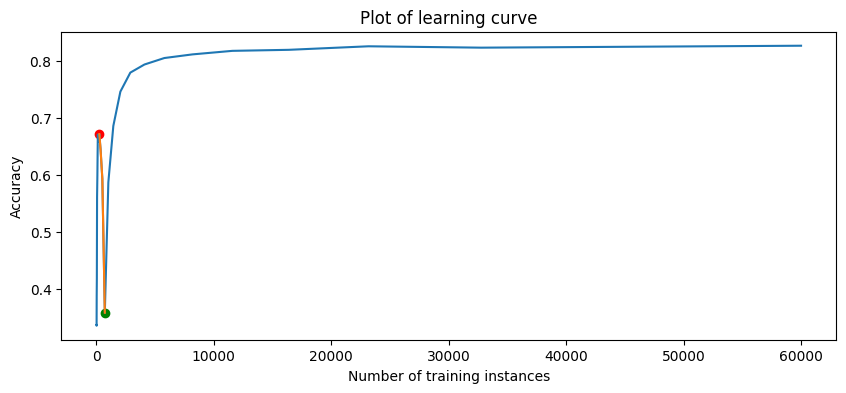

151it [06:11,  2.37s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41027;non-monotonic:True


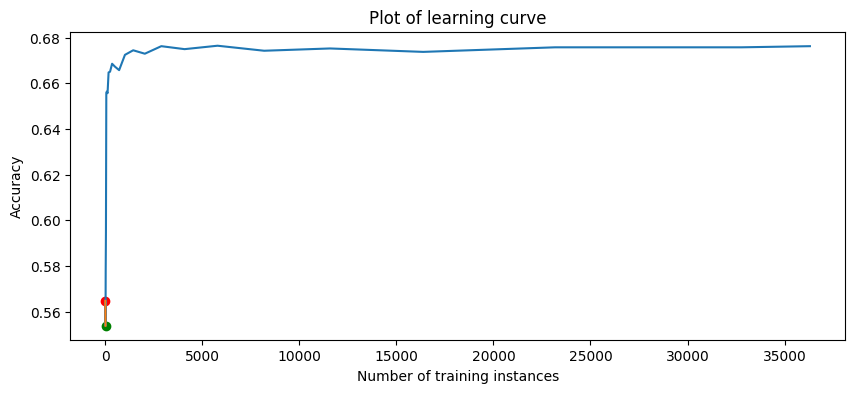

152it [06:13,  2.37s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41142;non-monotonic:True


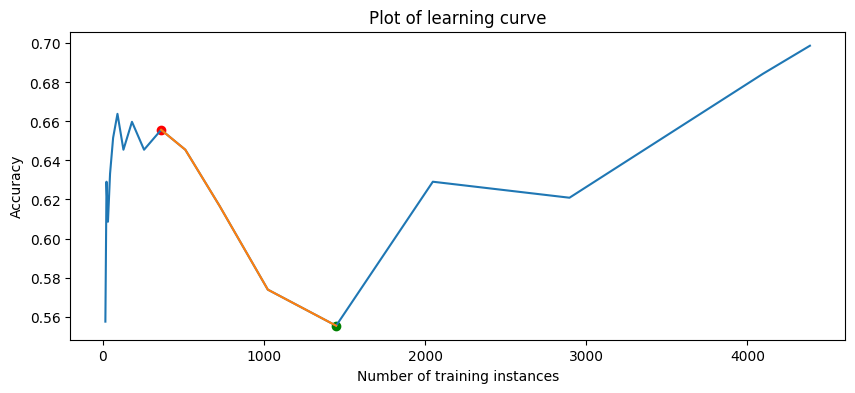

153it [06:16,  2.36s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41144;non-monotonic:True


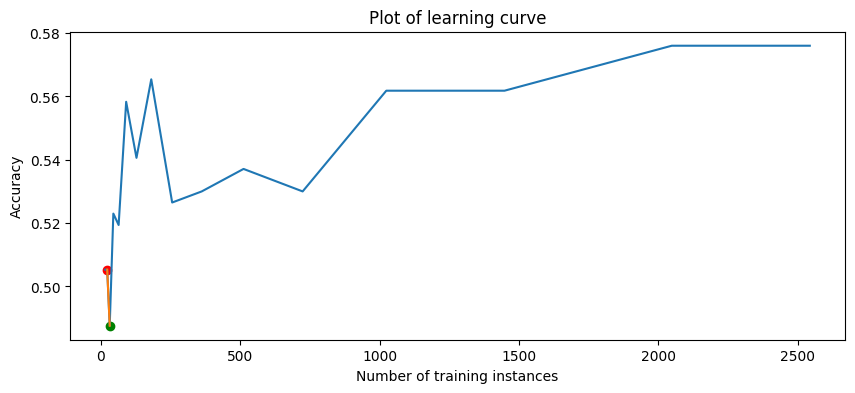

154it [06:18,  2.34s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41145;non-monotonic:True


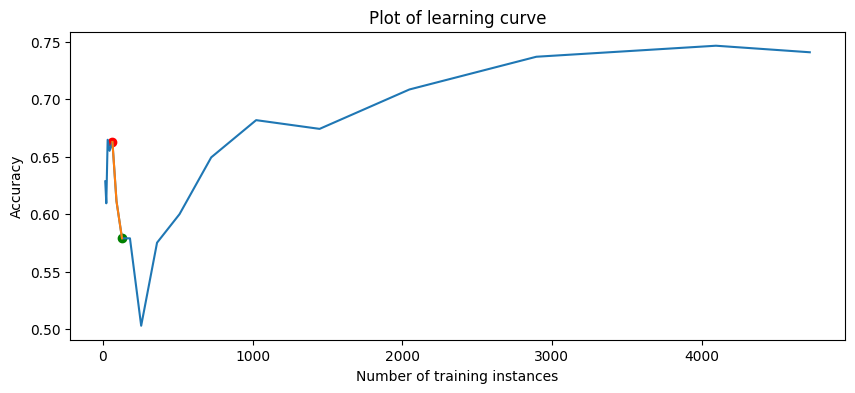

155it [06:20,  2.35s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41146;non-monotonic:True


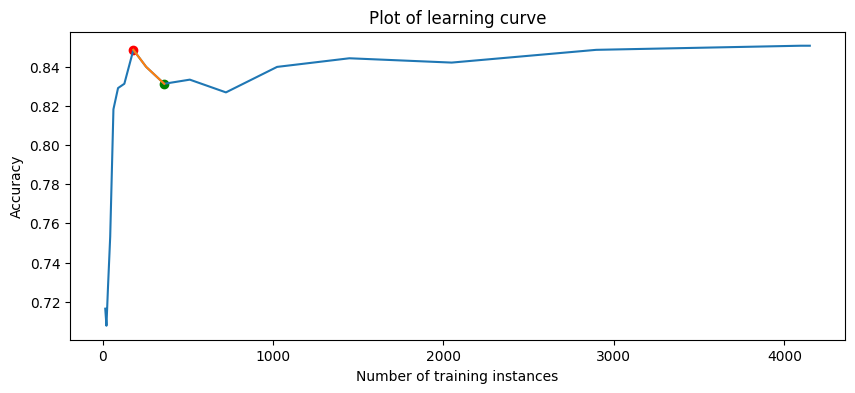

156it [06:23,  2.34s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41150;non-monotonic:True


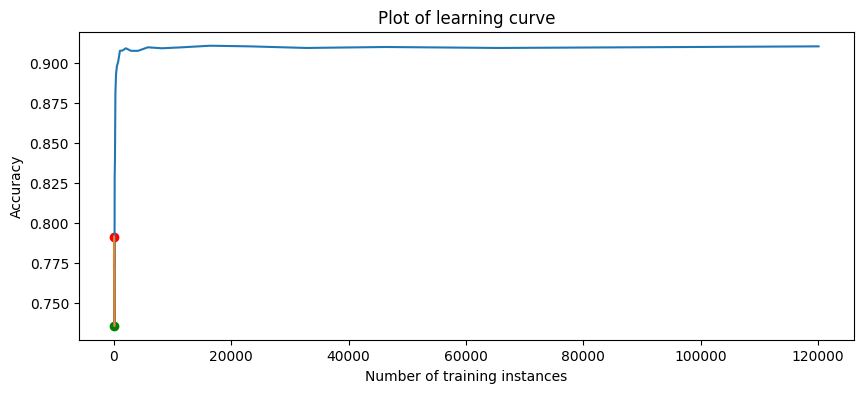

157it [06:25,  2.33s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41156;non-monotonic:True


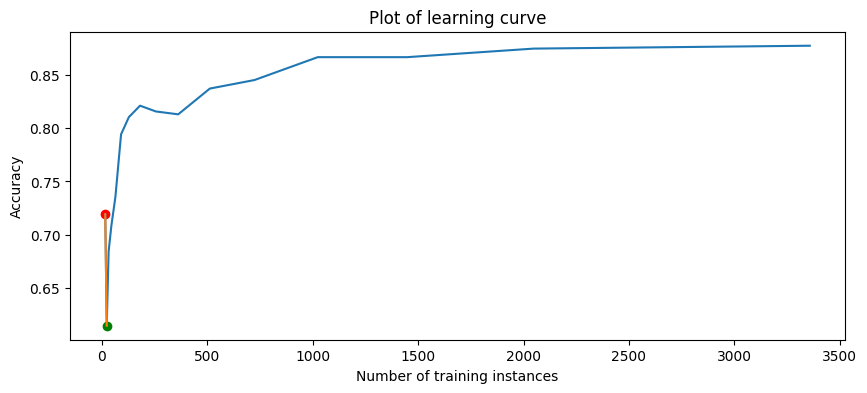

158it [06:27,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41157;non-monotonic:True


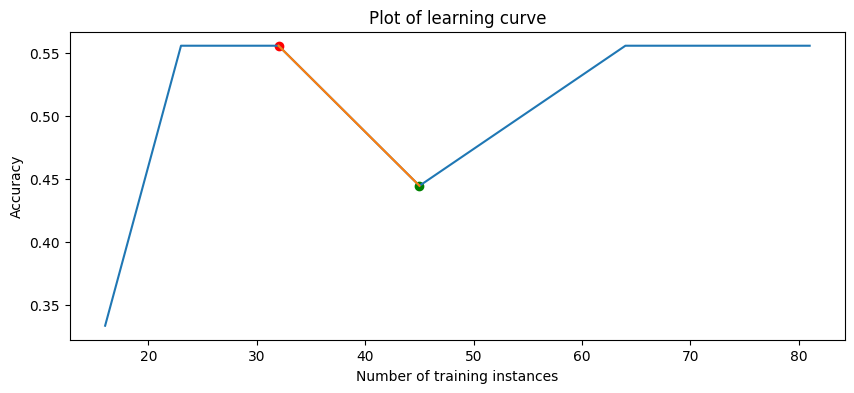

159it [06:29,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41158;non-monotonic:True


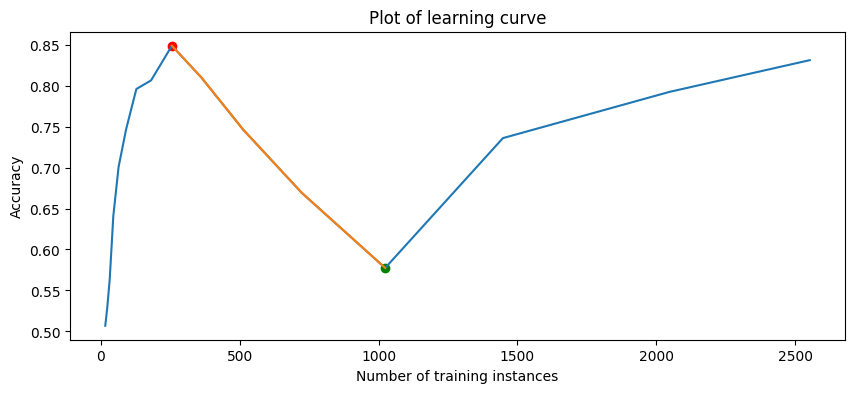

160it [06:32,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41159;non-monotonic:True


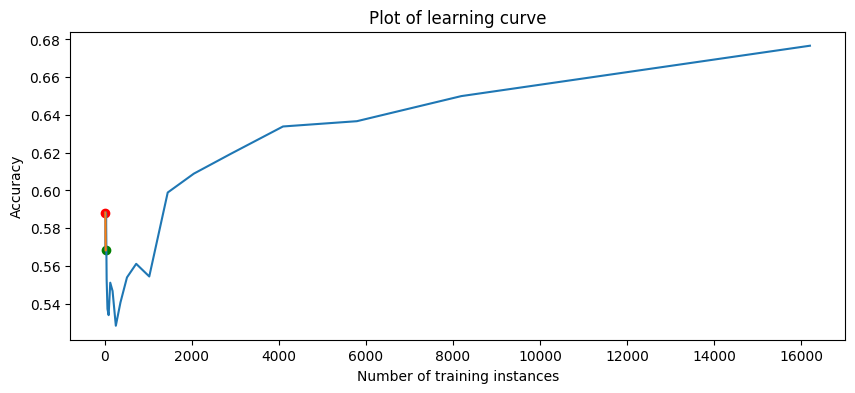

161it [06:34,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41161;non-monotonic:True


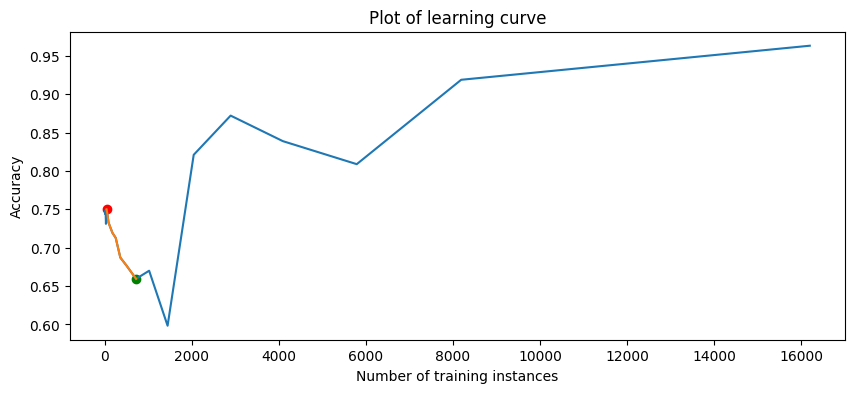

162it [06:36,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41163;non-monotonic:True


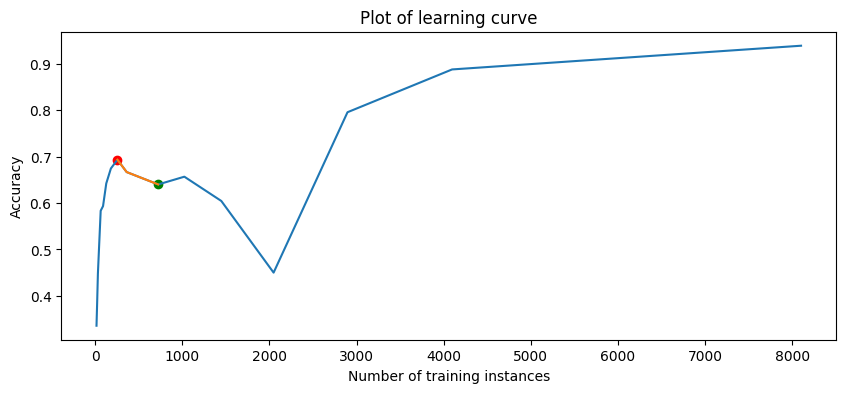

163it [06:39,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41164;non-monotonic:True


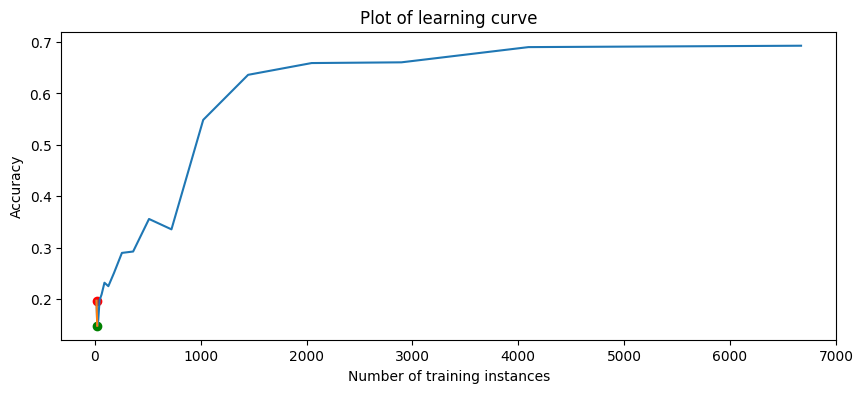

164it [06:41,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41165;non-monotonic:True


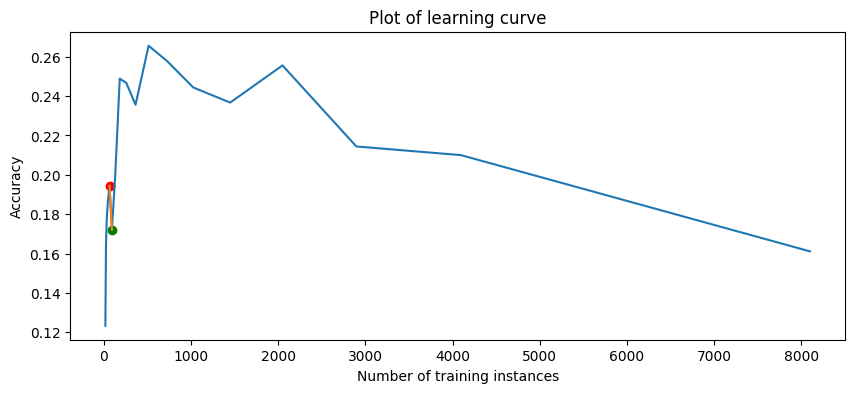

165it [06:43,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41166;non-monotonic:True


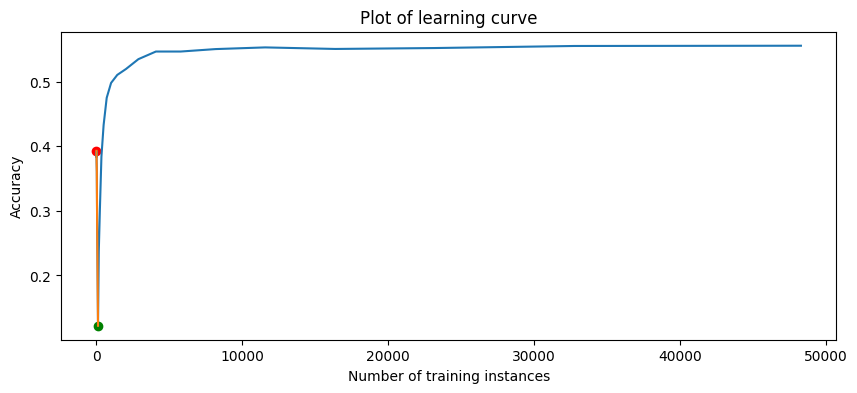

166it [06:46,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41168;non-monotonic:True


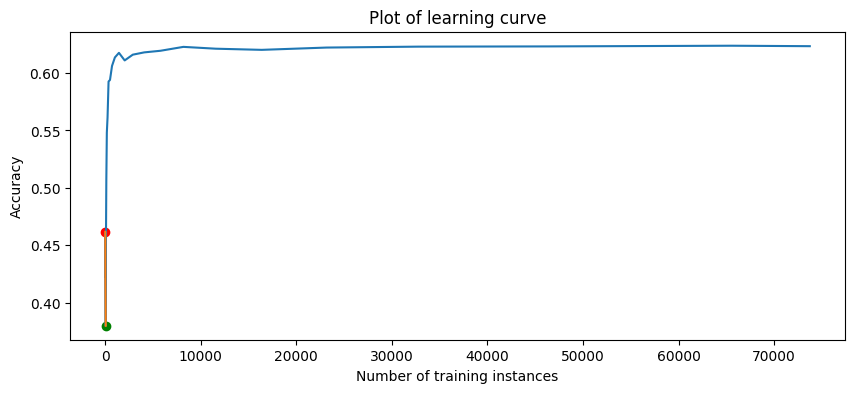

167it [06:48,  2.30s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41228;non-monotonic:True


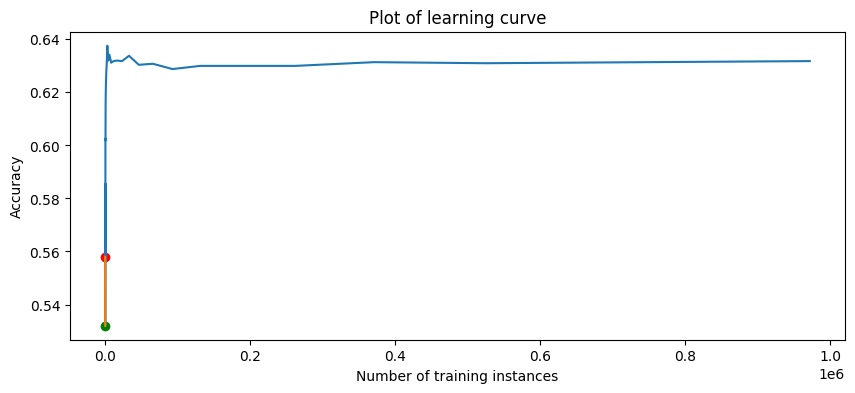

168it [06:50,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_41972;non-monotonic:True


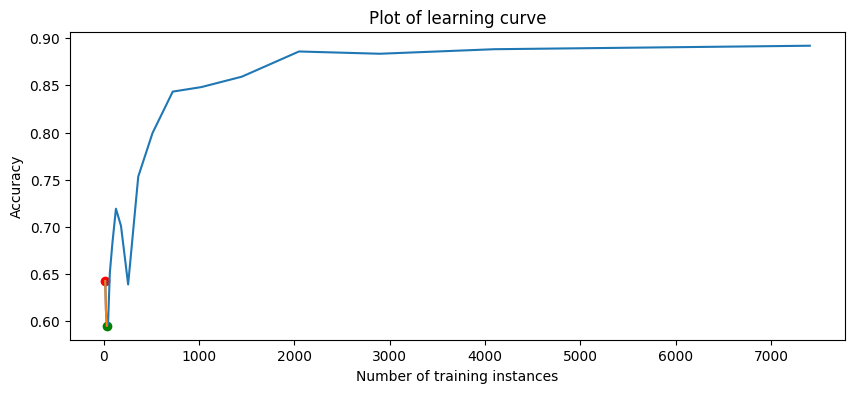

169it [06:53,  2.31s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_42769;non-monotonic:True


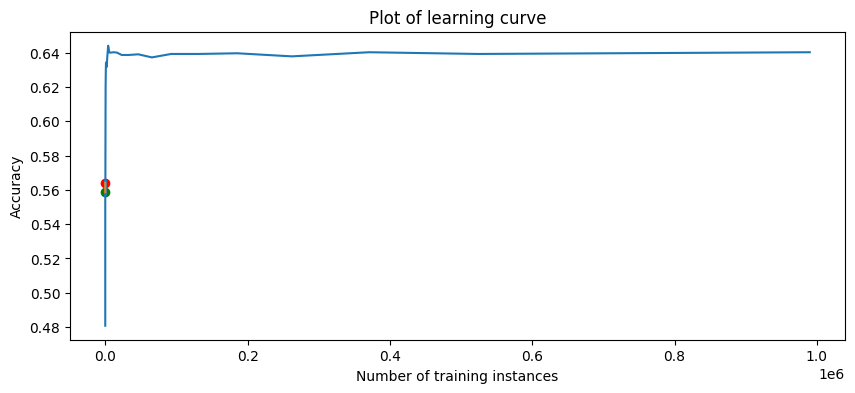

170it [06:55,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_42809;non-monotonic:True


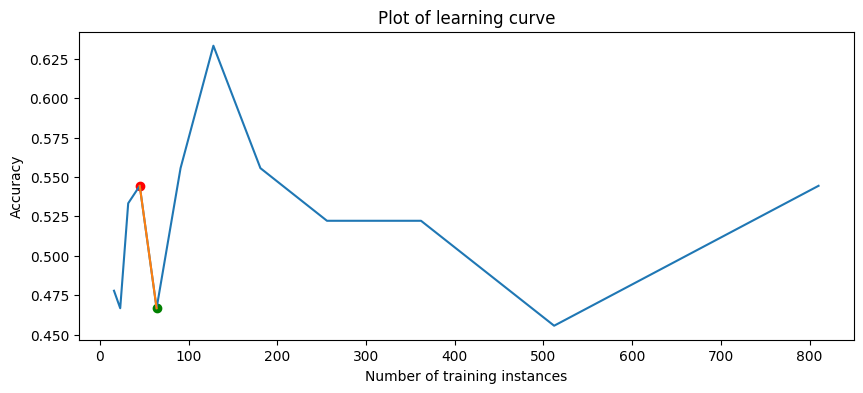

171it [06:57,  2.32s/it]

sklearn.discriminant_analysis.LinearDiscriminantAnalysis_on_42810;non-monotonic:True


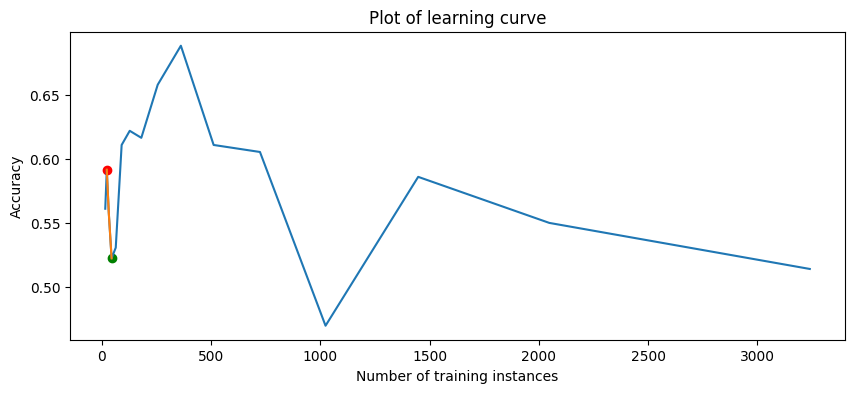

172it [07:00,  2.44s/it]
0it [00:00, ?it/s]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_6;non-monotonic:False


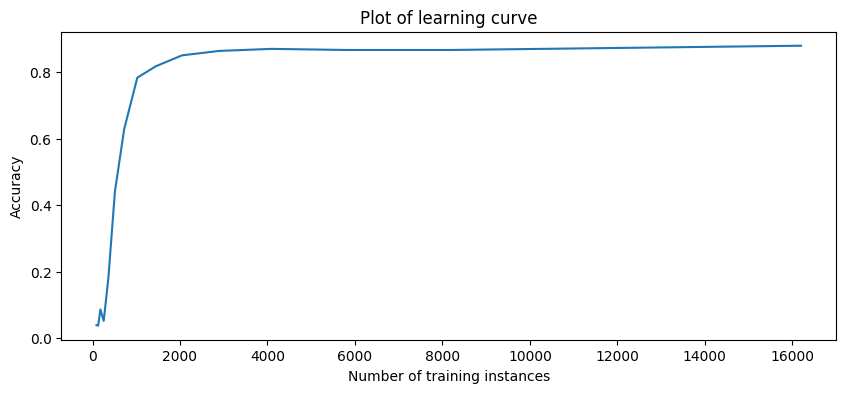

1it [00:02,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_11;non-monotonic:False


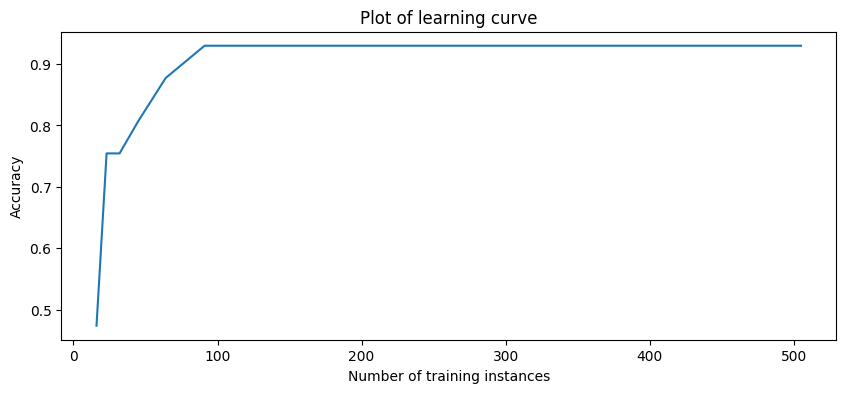

2it [00:04,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_12;non-monotonic:True


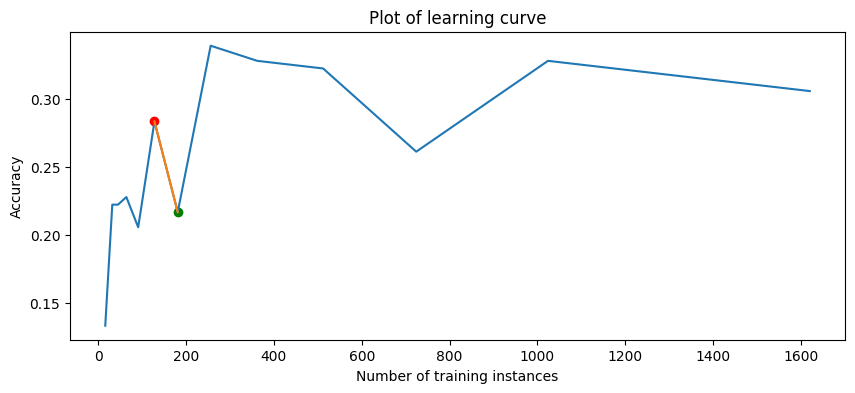

3it [00:06,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_14;non-monotonic:True


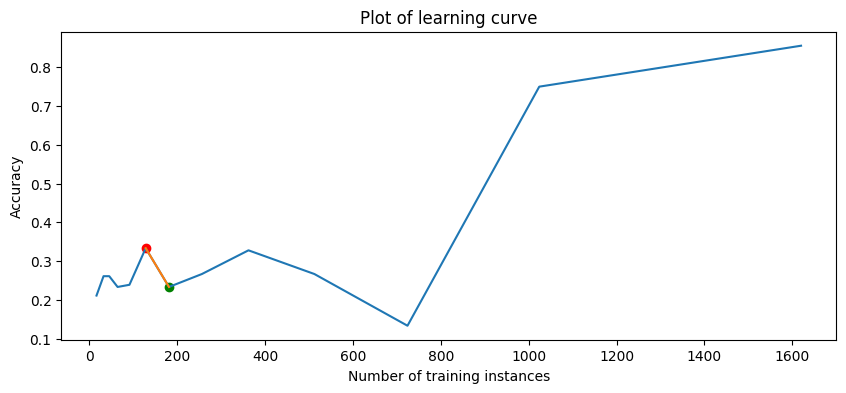

4it [00:09,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_16;non-monotonic:True


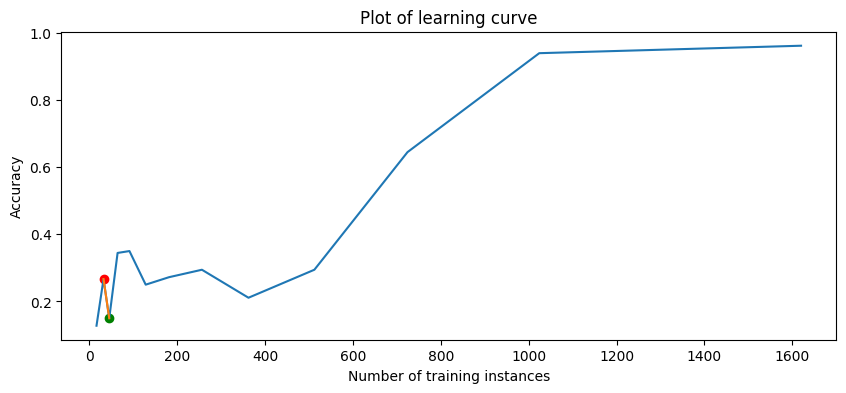

5it [00:11,  2.41s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_18;non-monotonic:True


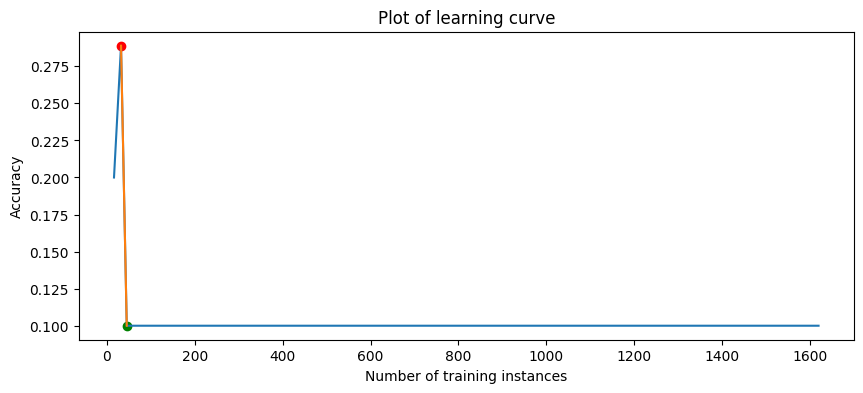

6it [00:14,  2.61s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_21;non-monotonic:True


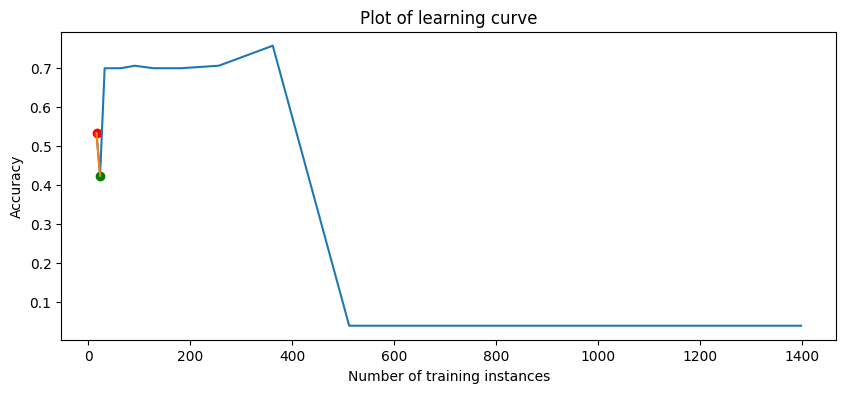

7it [00:18,  2.78s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_22;non-monotonic:True


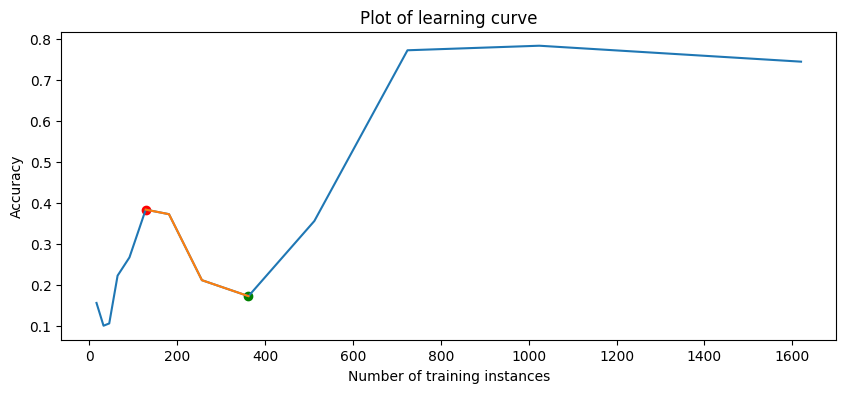

8it [00:20,  2.65s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_23;non-monotonic:True


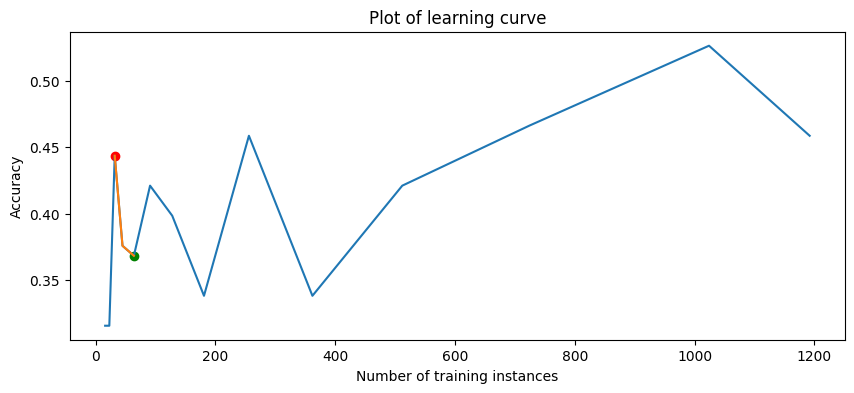

9it [00:22,  2.55s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_26;non-monotonic:True


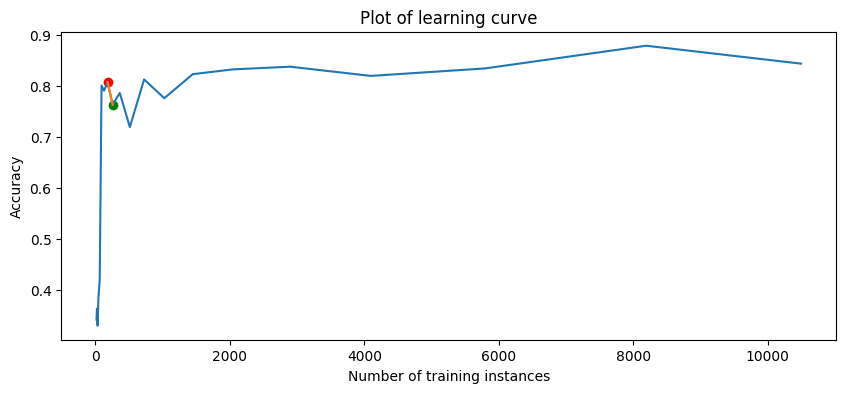

10it [00:24,  2.47s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_28;non-monotonic:True


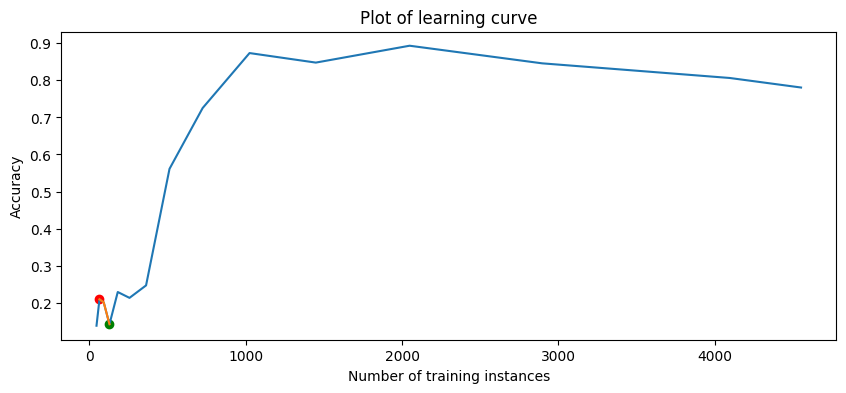

11it [00:27,  2.42s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_30;non-monotonic:True


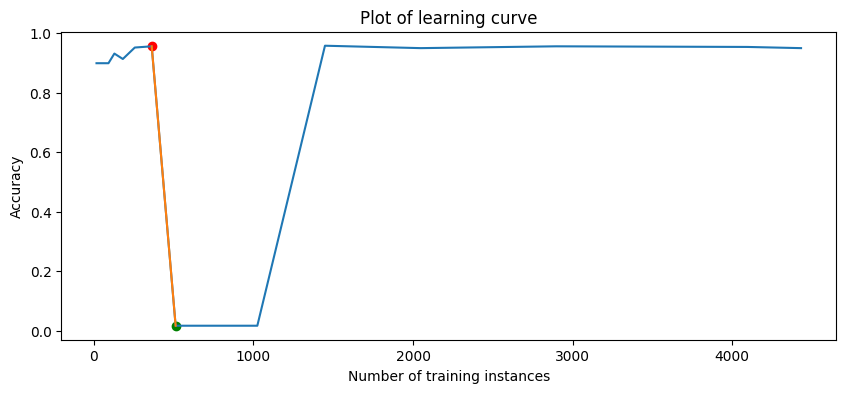

12it [00:29,  2.39s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_32;non-monotonic:True


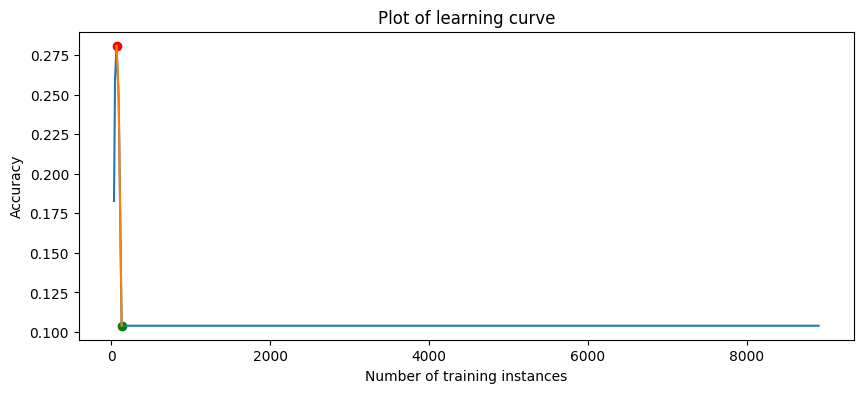

13it [00:31,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_36;non-monotonic:True


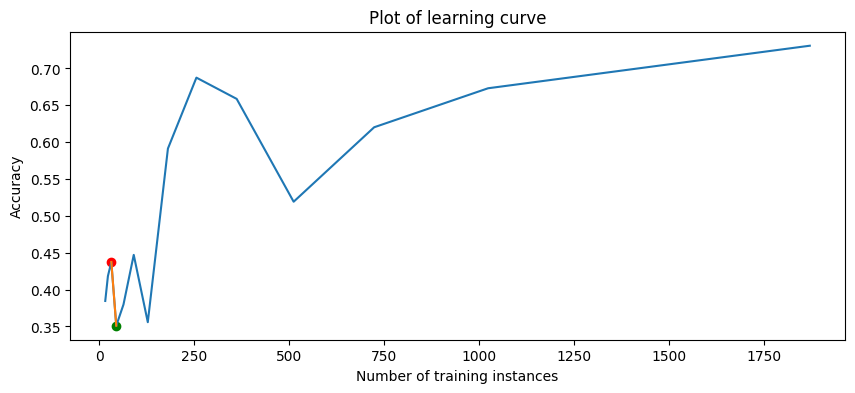

14it [00:34,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_44;non-monotonic:True


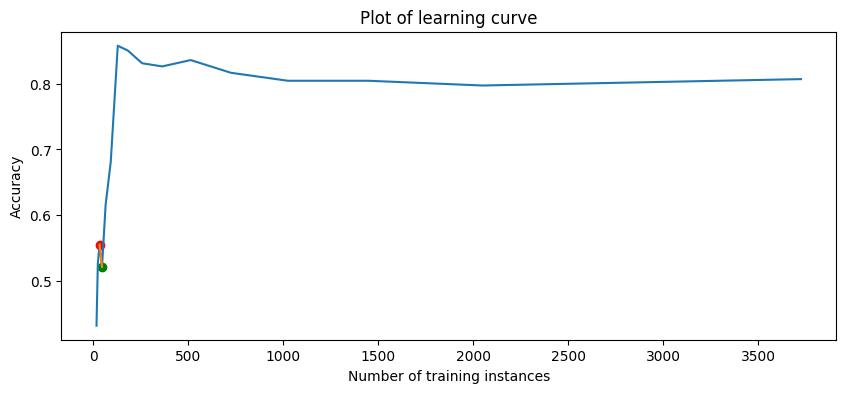

15it [00:36,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_54;non-monotonic:True


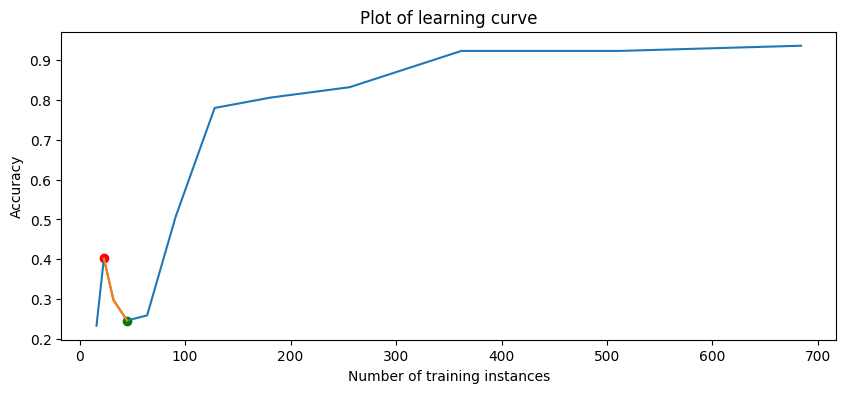

16it [00:38,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_55;non-monotonic:False


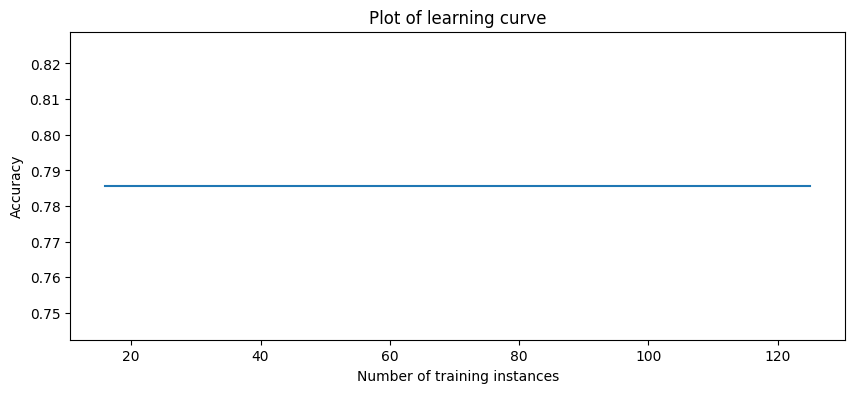

17it [00:41,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_60;non-monotonic:True


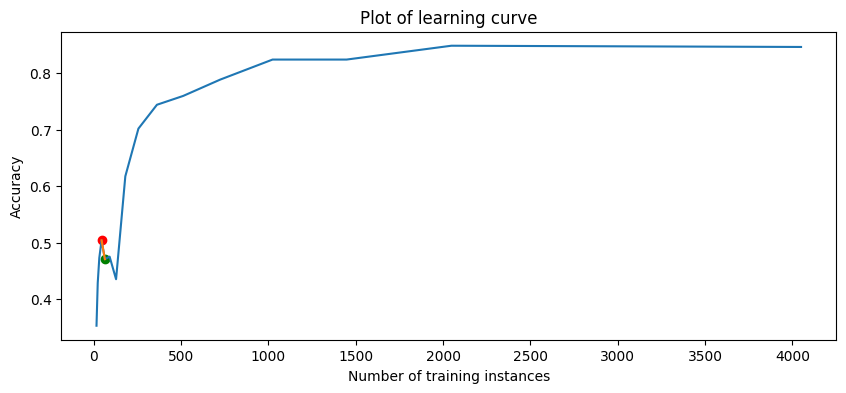

18it [00:43,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_61;non-monotonic:False


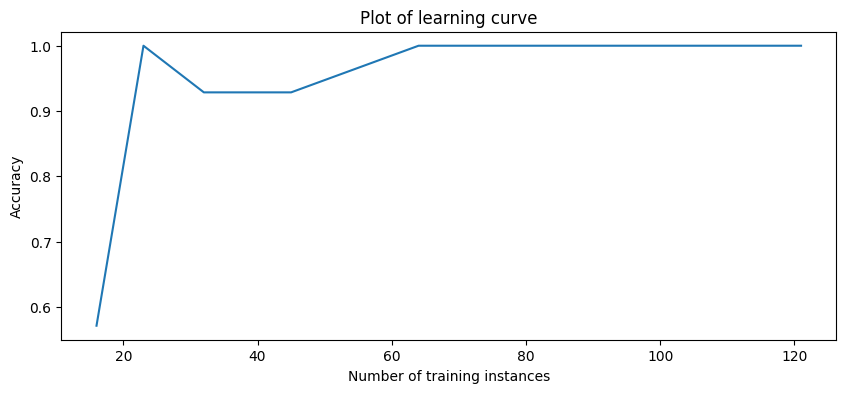

19it [00:45,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_181;non-monotonic:True


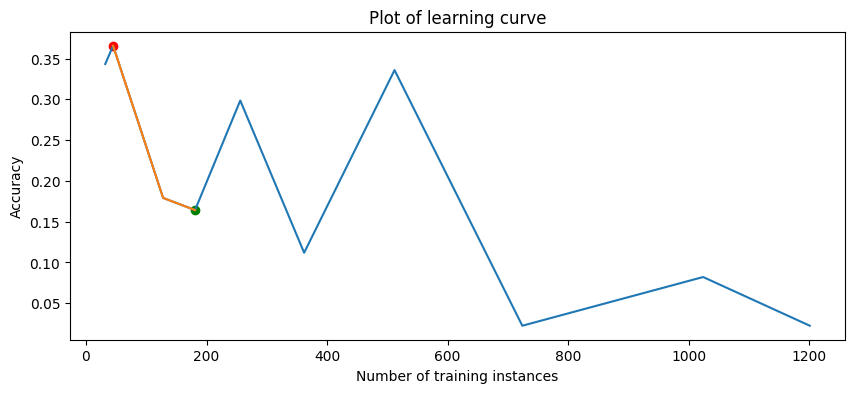

20it [00:47,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_182;non-monotonic:True


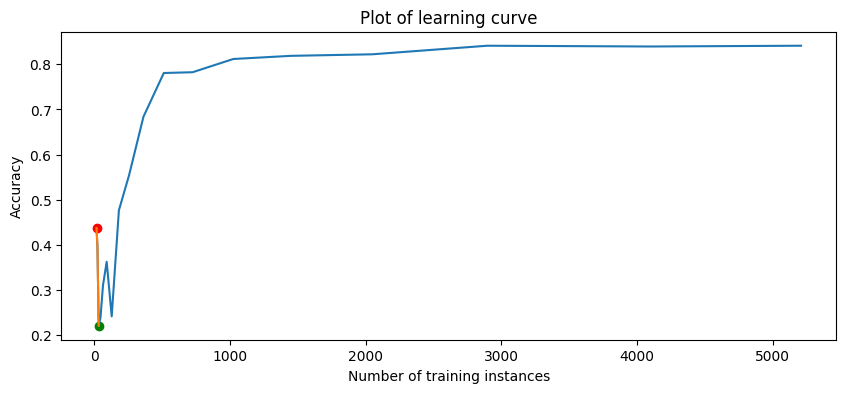

21it [00:50,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_185;non-monotonic:True


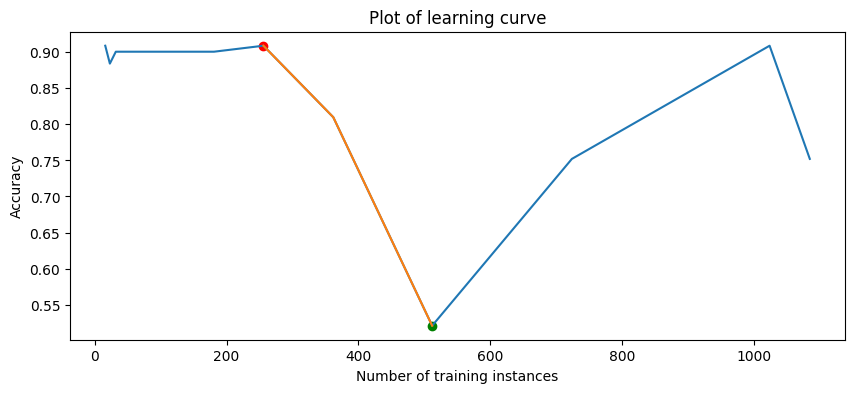

22it [00:52,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_201;non-monotonic:True


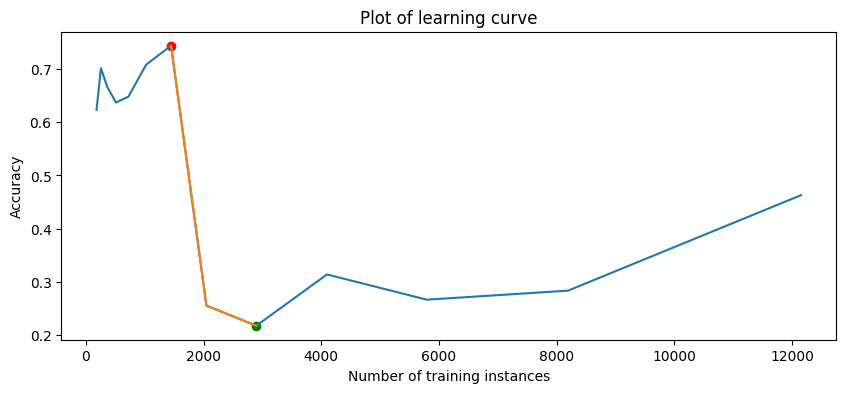

23it [00:54,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_273;non-monotonic:True


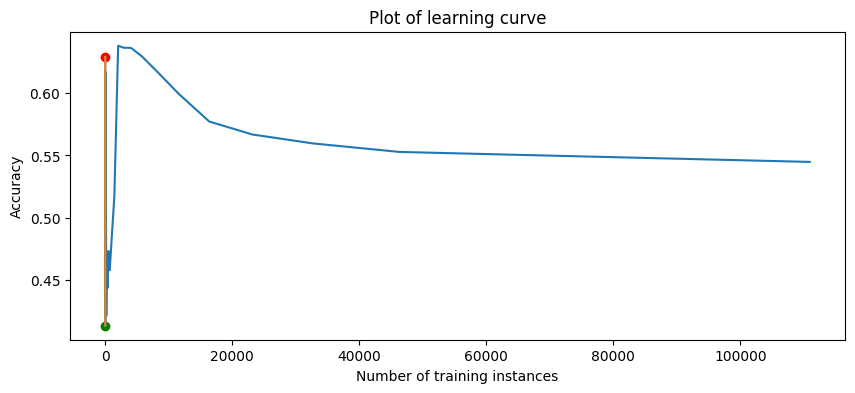

24it [00:57,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_293;non-monotonic:True


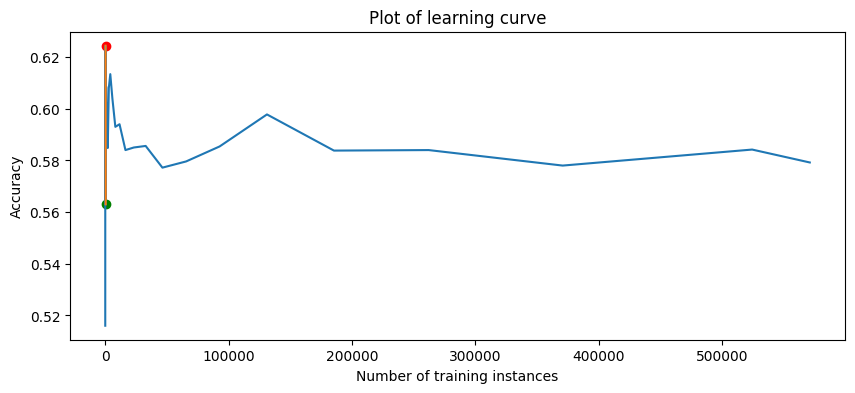

25it [00:59,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_299;non-monotonic:True


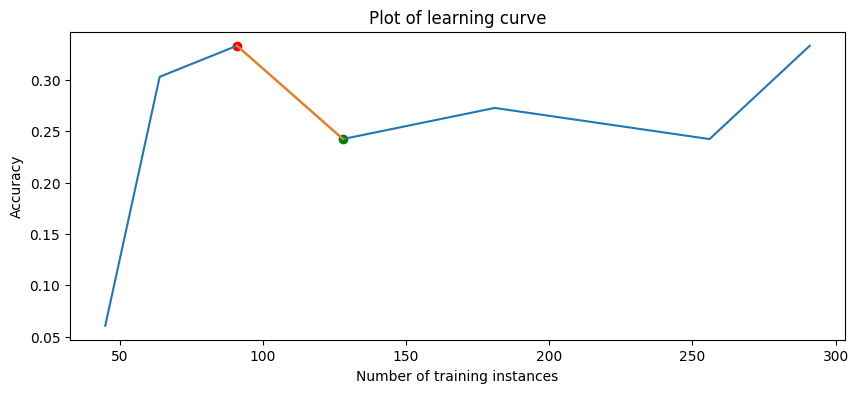

26it [01:02,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_300;non-monotonic:True


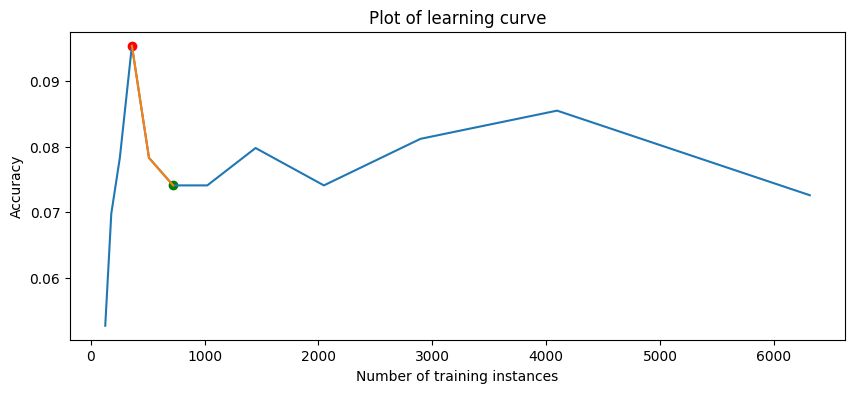

27it [01:04,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_346;non-monotonic:False


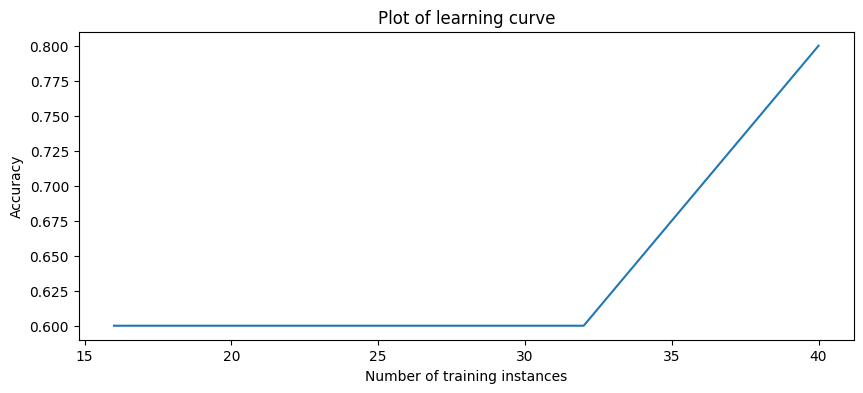

28it [01:06,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_351;non-monotonic:False


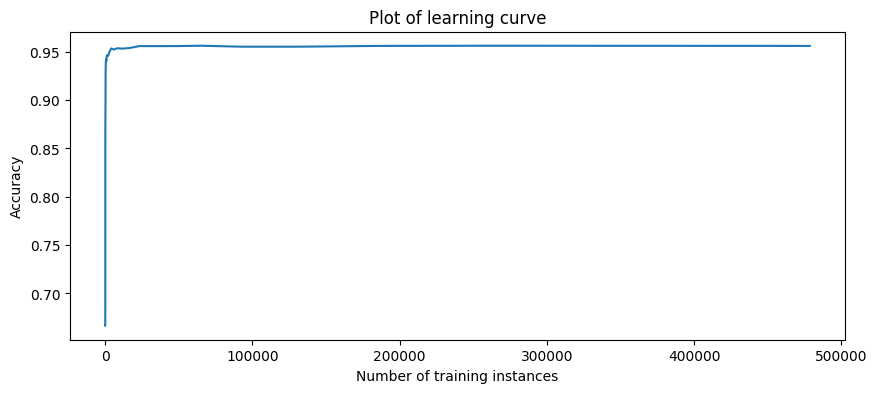

29it [01:08,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_354;non-monotonic:True


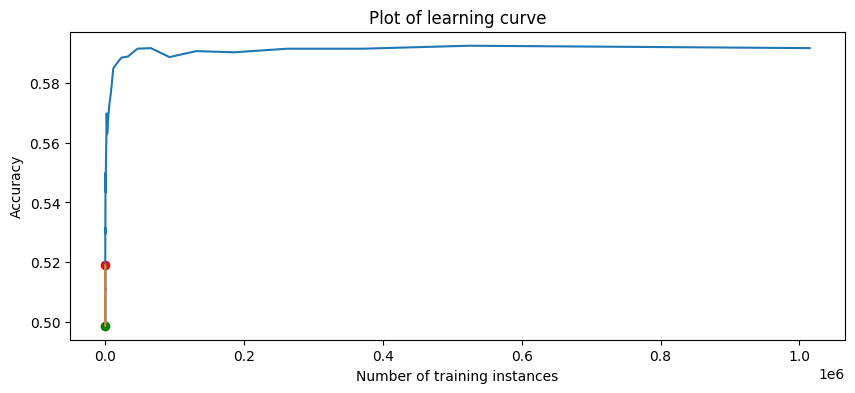

30it [01:11,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_357;non-monotonic:True


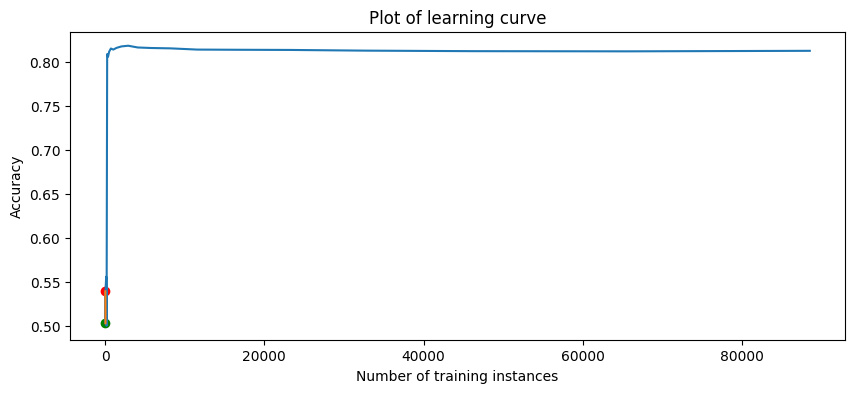

31it [01:14,  2.46s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_380;non-monotonic:True


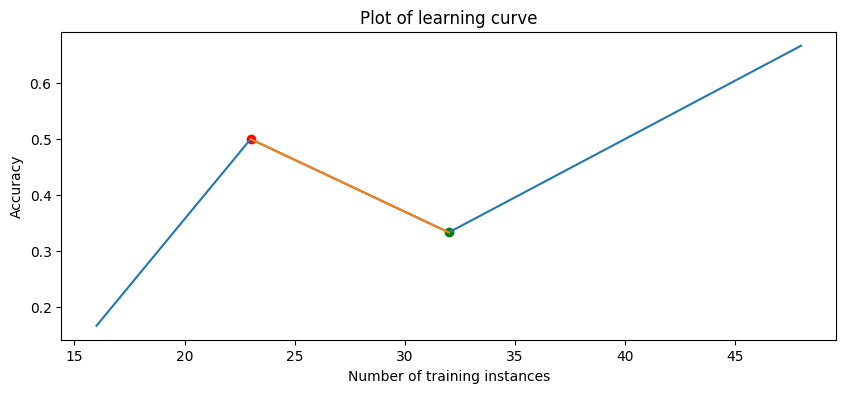

32it [01:16,  2.39s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_389;non-monotonic:True


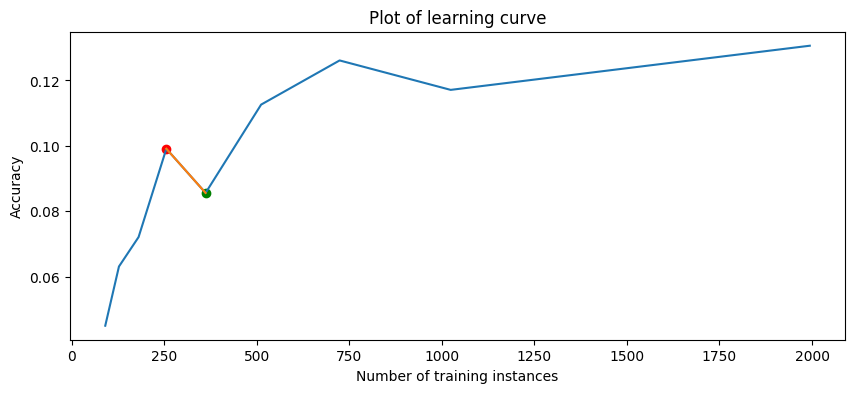

33it [01:18,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_390;non-monotonic:True


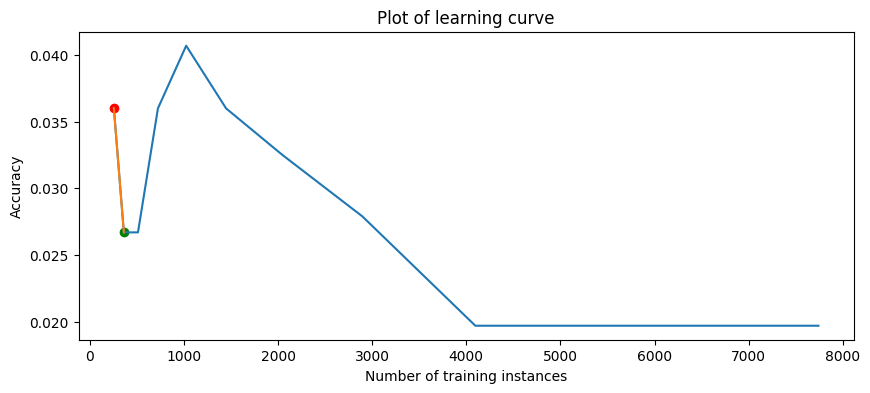

34it [01:20,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_391;non-monotonic:True


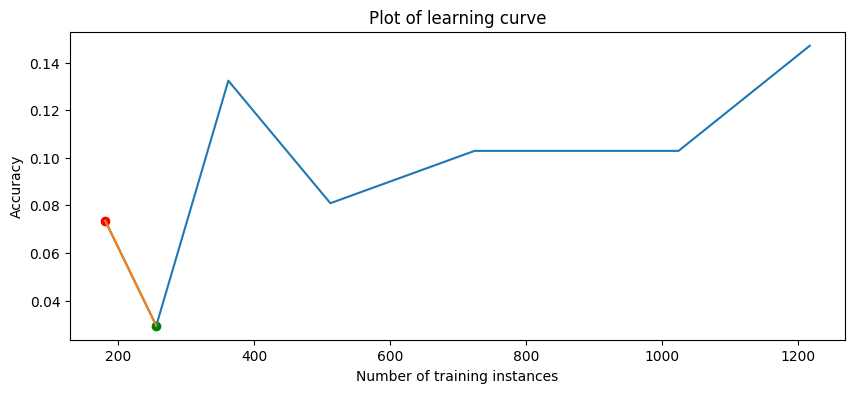

35it [01:23,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_392;non-monotonic:True


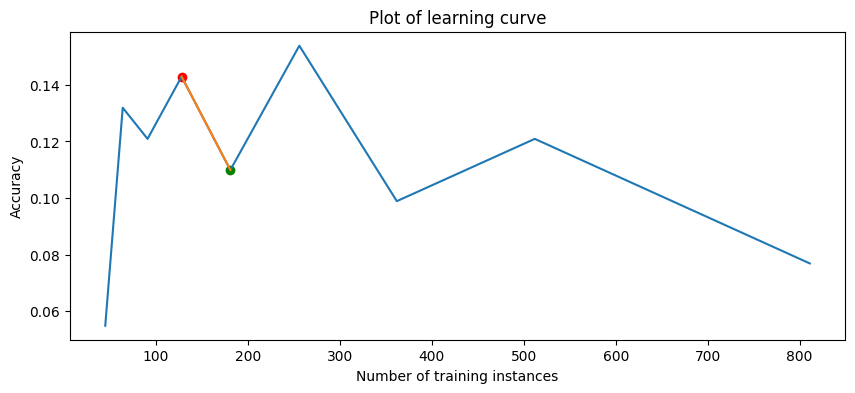

36it [01:25,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_393;non-monotonic:True


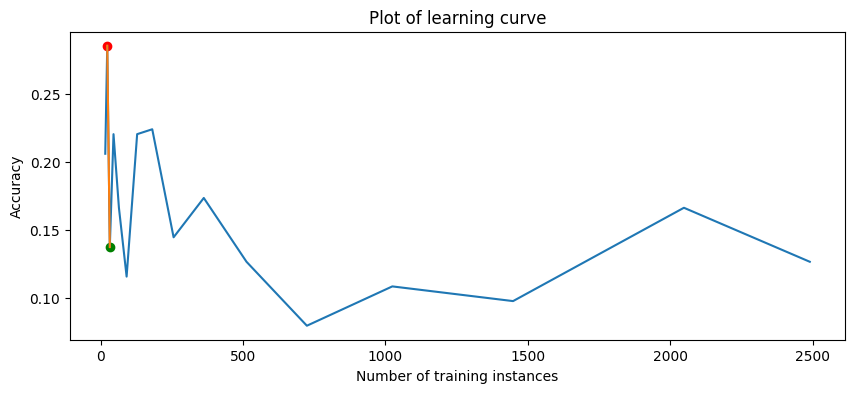

37it [01:27,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_395;non-monotonic:True


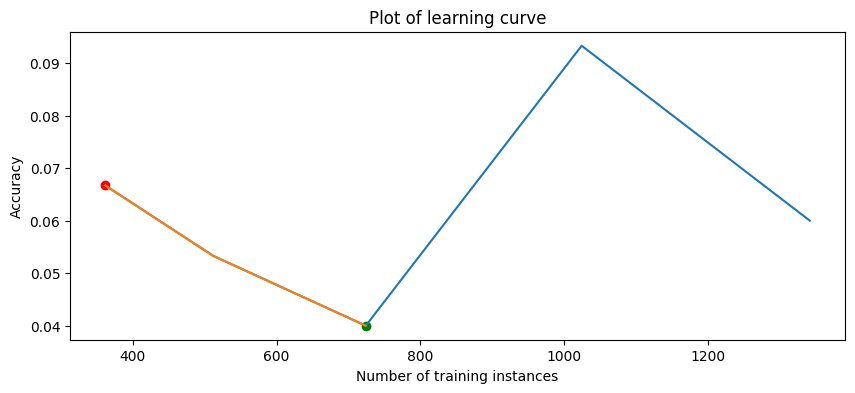

38it [01:30,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_396;non-monotonic:True


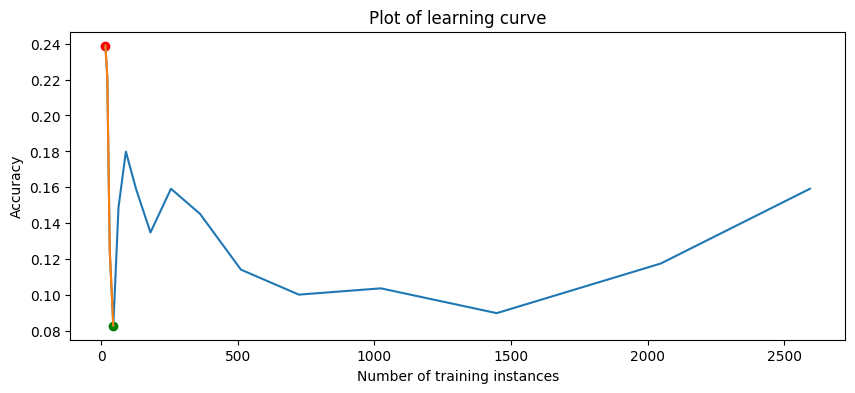

39it [01:32,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_398;non-monotonic:True


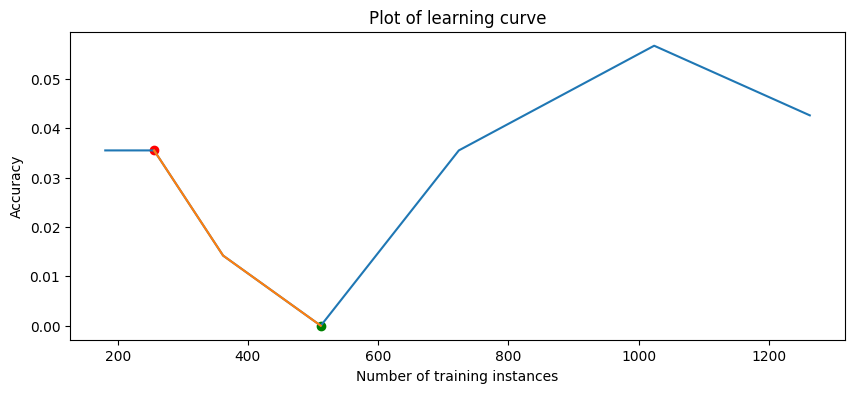

40it [01:34,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_399;non-monotonic:True


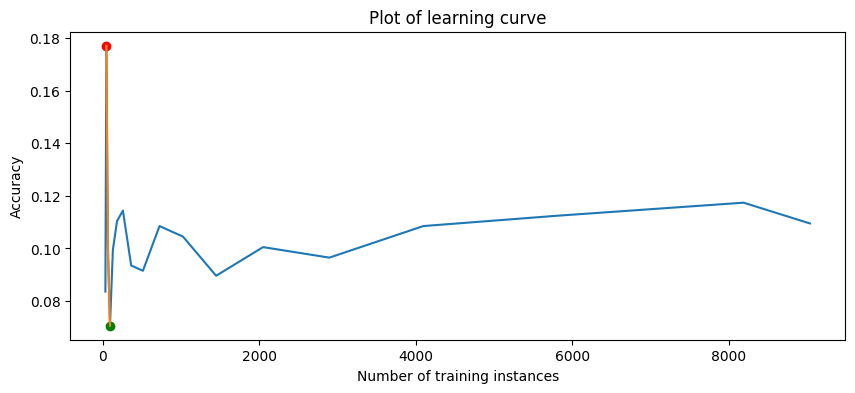

41it [01:37,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_401;non-monotonic:True


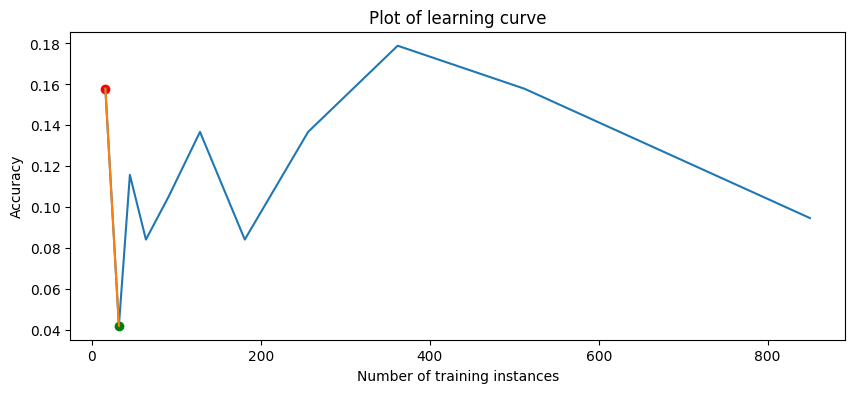

42it [01:39,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_446;non-monotonic:True


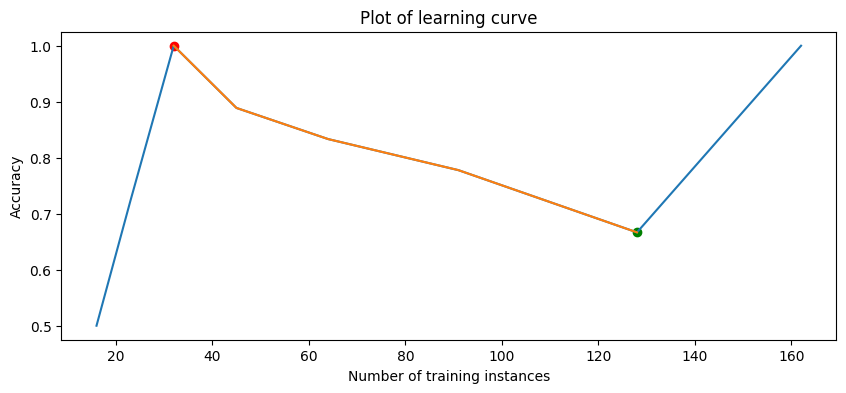

43it [01:41,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_554;non-monotonic:True


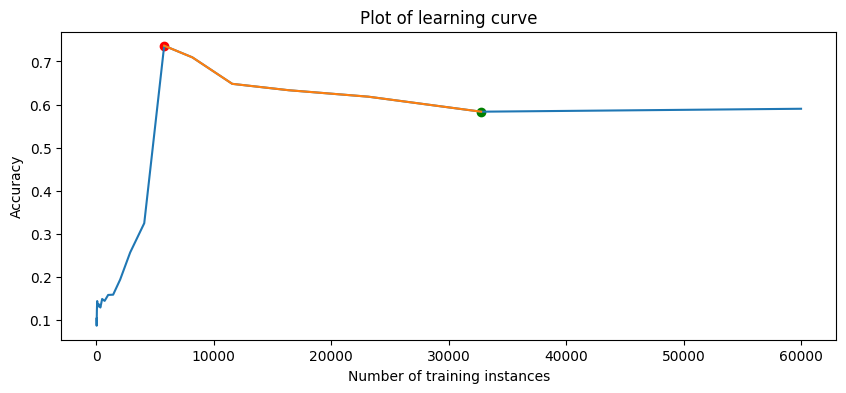

44it [01:44,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_679;non-monotonic:True


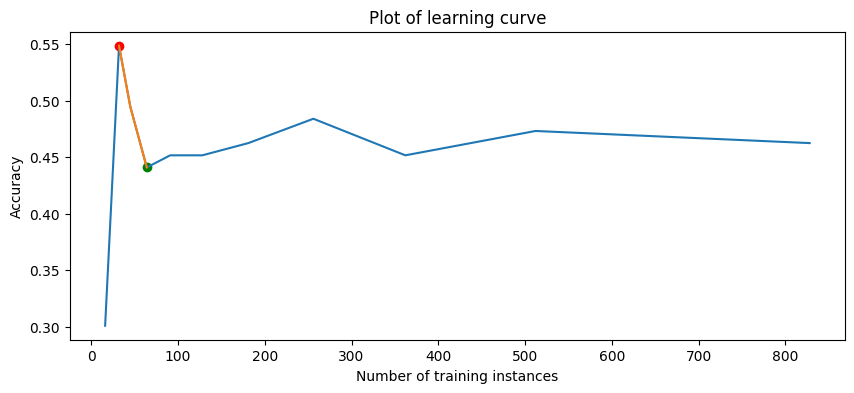

45it [01:46,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_715;non-monotonic:True


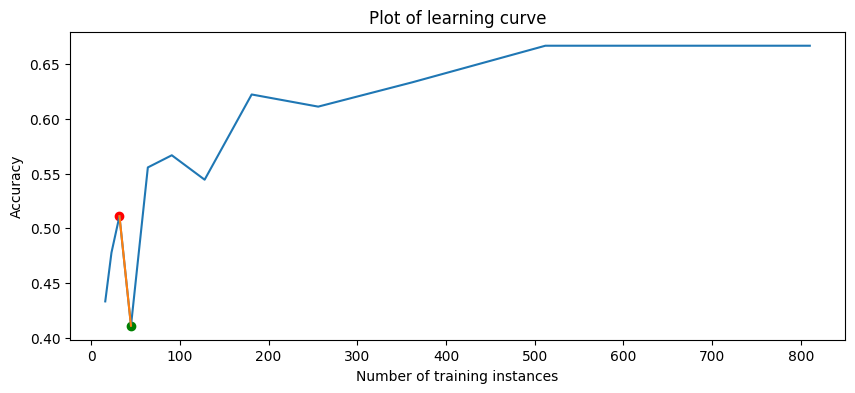

46it [01:48,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_718;non-monotonic:True


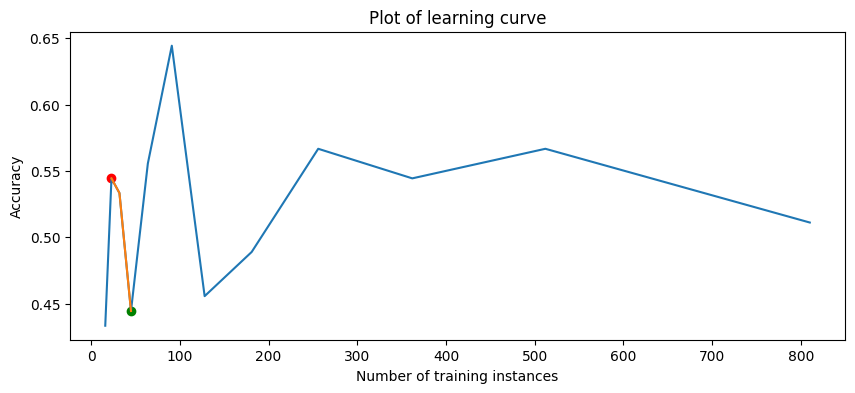

47it [01:51,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_720;non-monotonic:True


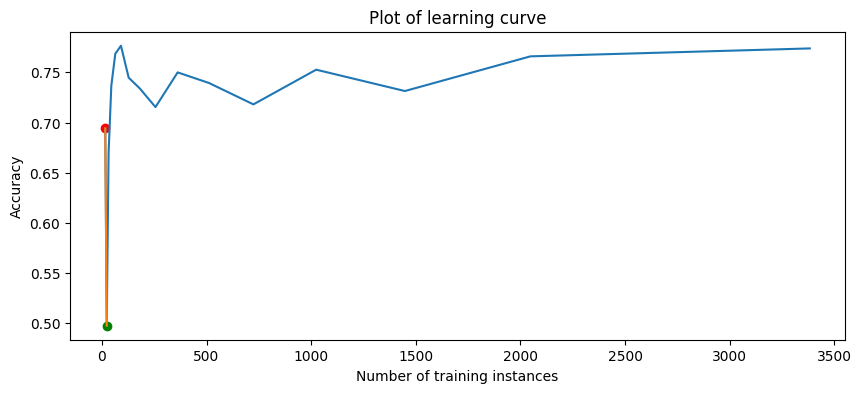

48it [01:53,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_722;non-monotonic:True


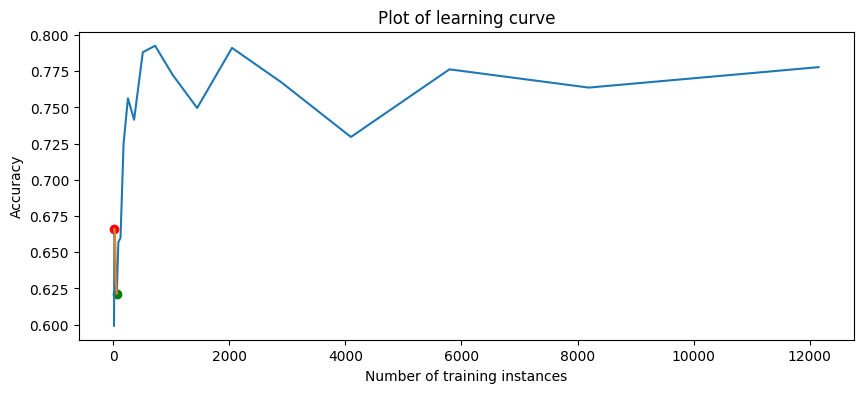

49it [01:55,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_723;non-monotonic:True


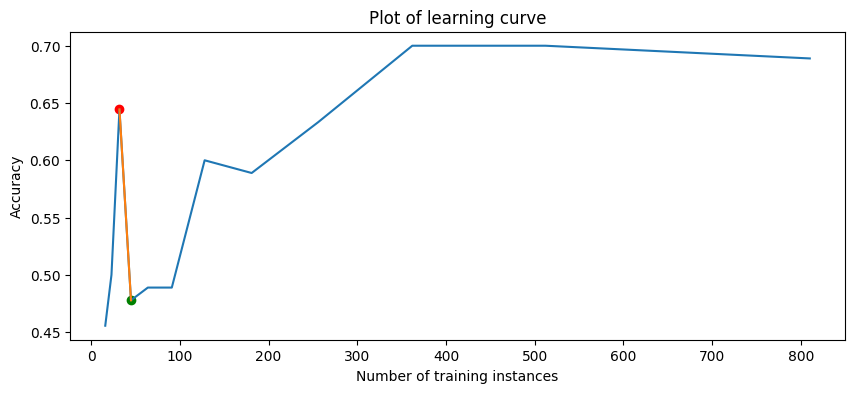

50it [01:58,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_727;non-monotonic:False


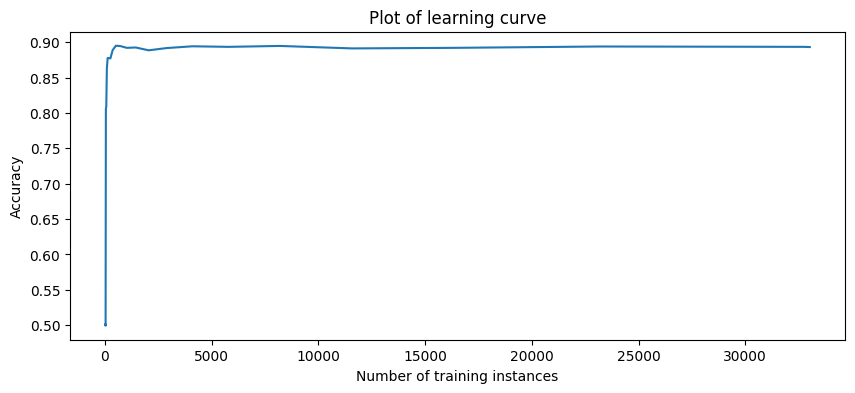

51it [02:00,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_728;non-monotonic:True


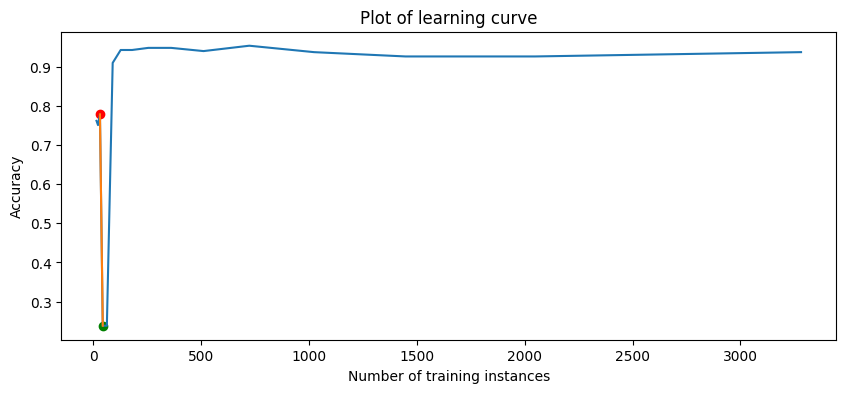

52it [02:02,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_734;non-monotonic:True


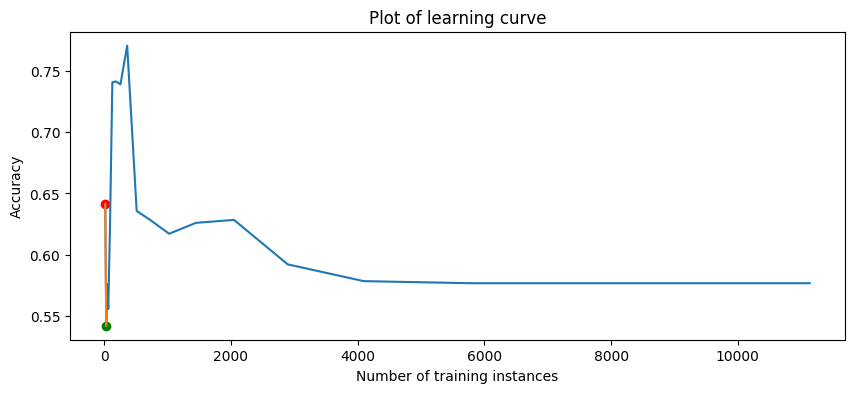

53it [02:05,  2.42s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_735;non-monotonic:True


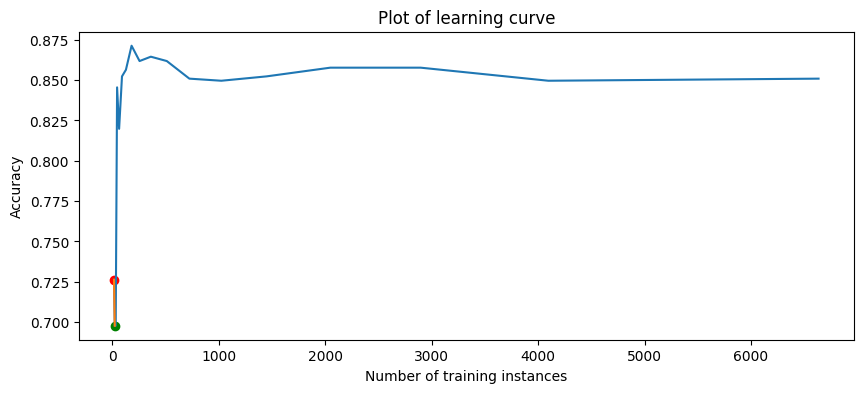

54it [02:07,  2.38s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_737;non-monotonic:True


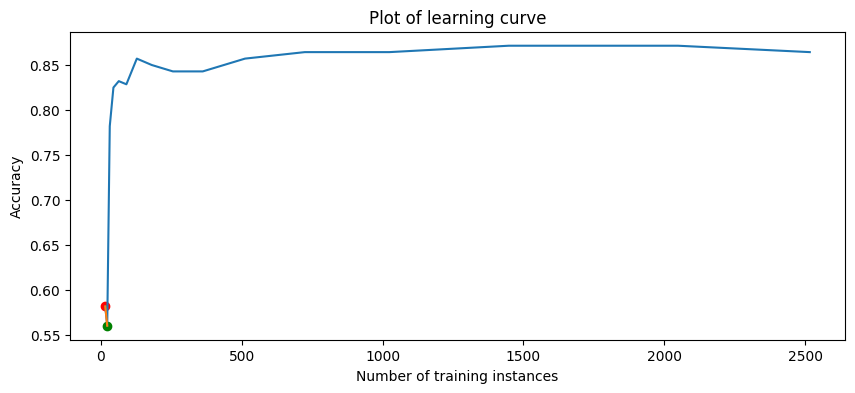

55it [02:10,  2.39s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_740;non-monotonic:True


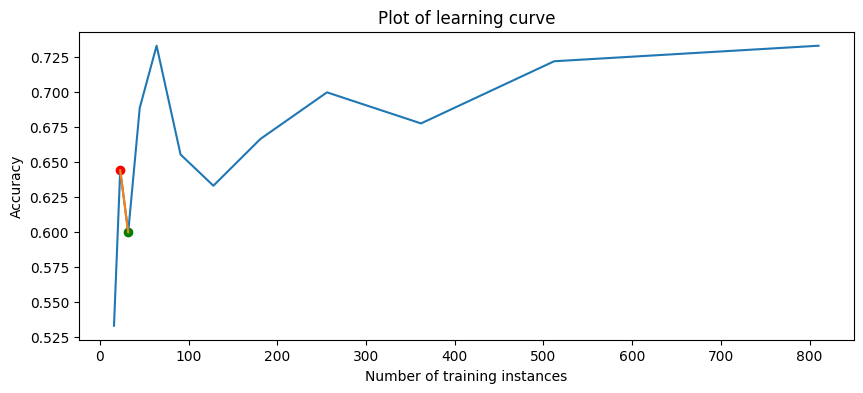

56it [02:12,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_741;non-monotonic:True


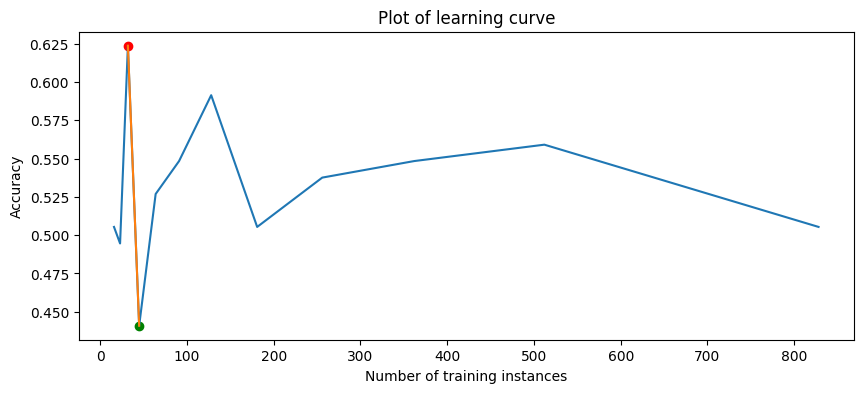

57it [02:14,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_743;non-monotonic:True


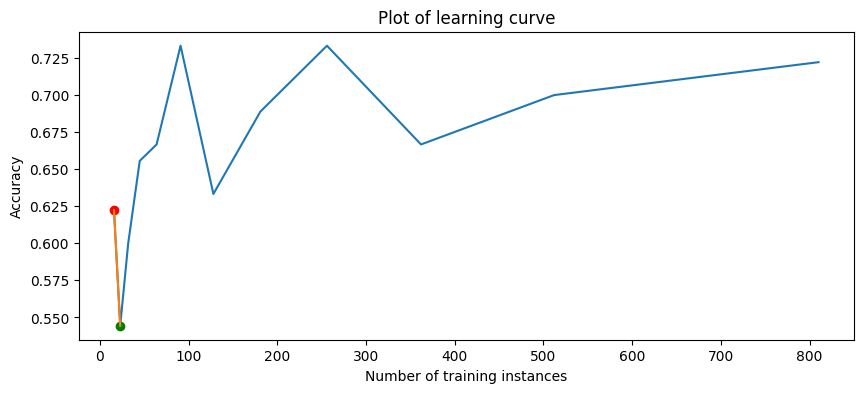

58it [02:17,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_751;non-monotonic:True


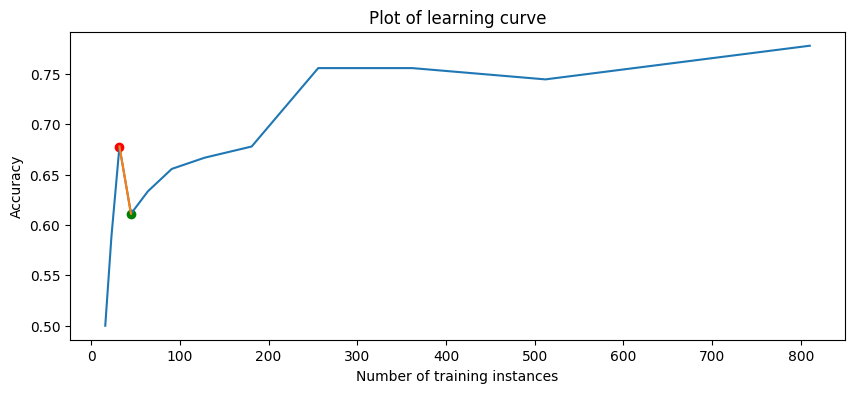

59it [02:19,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_752;non-monotonic:True


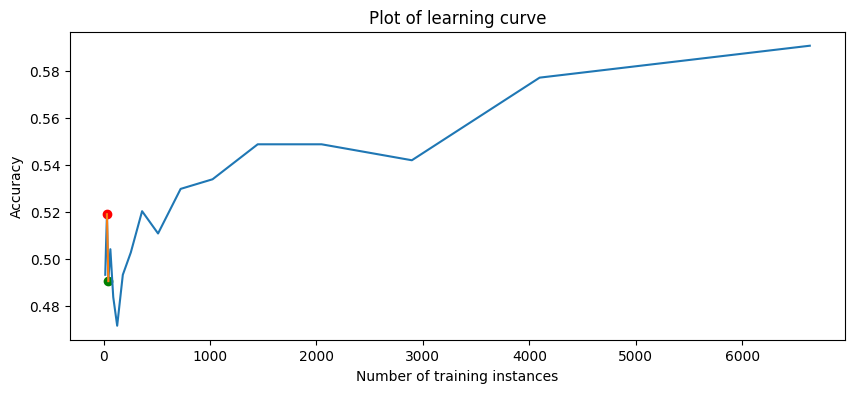

60it [02:21,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_761;non-monotonic:False


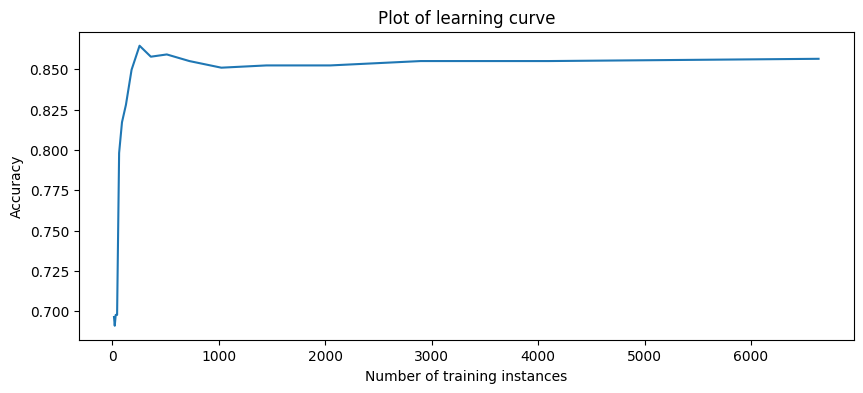

61it [02:24,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_772;non-monotonic:True


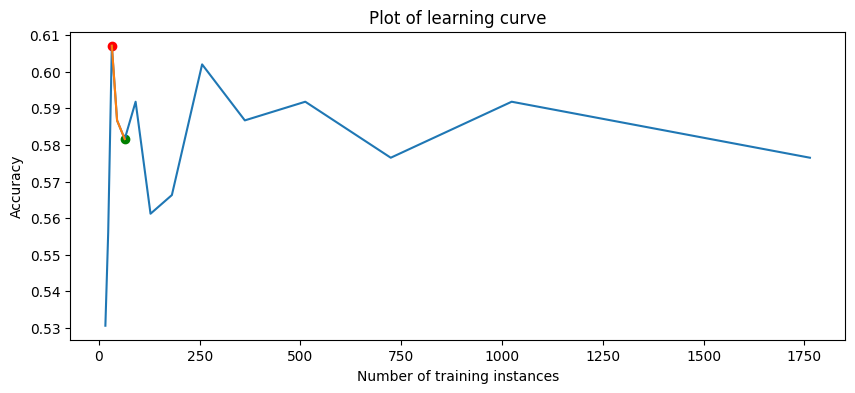

62it [02:26,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_797;non-monotonic:True


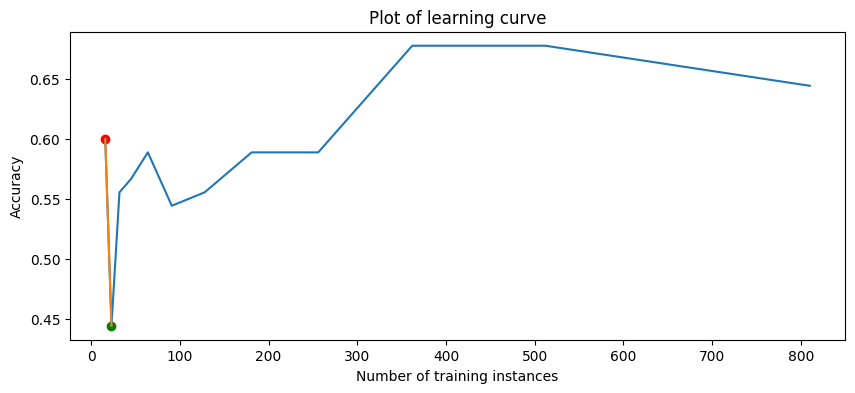

63it [02:28,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_799;non-monotonic:False


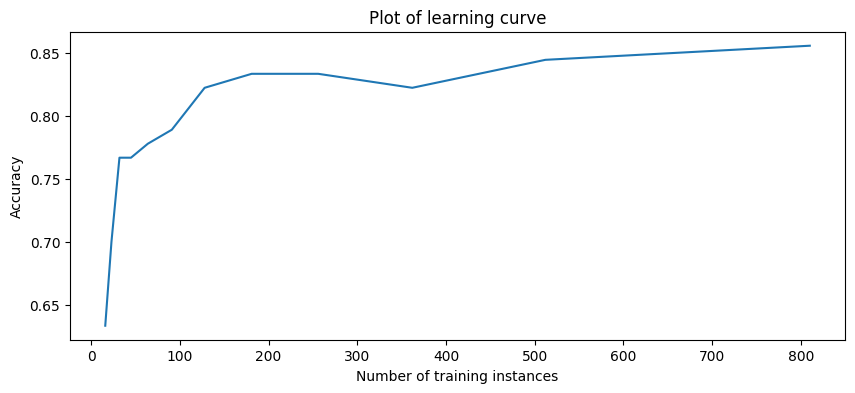

64it [02:30,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_803;non-monotonic:False


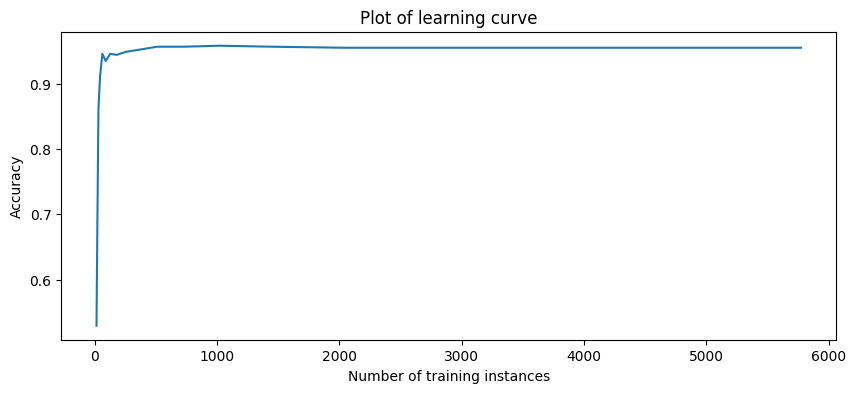

65it [02:33,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_806;non-monotonic:True


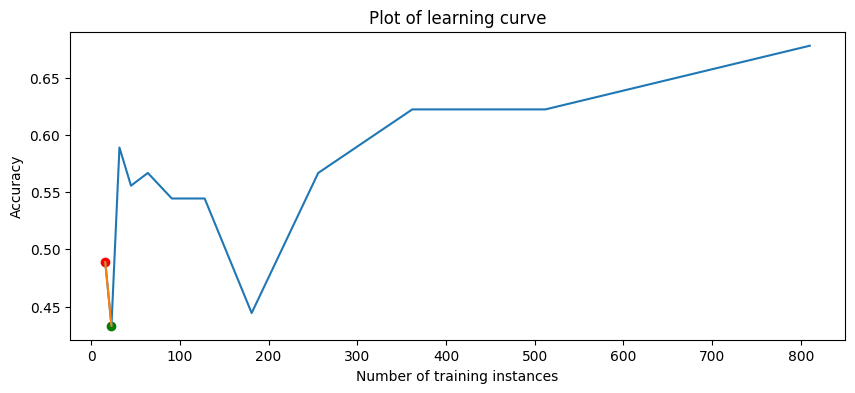

66it [02:35,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_807;non-monotonic:True


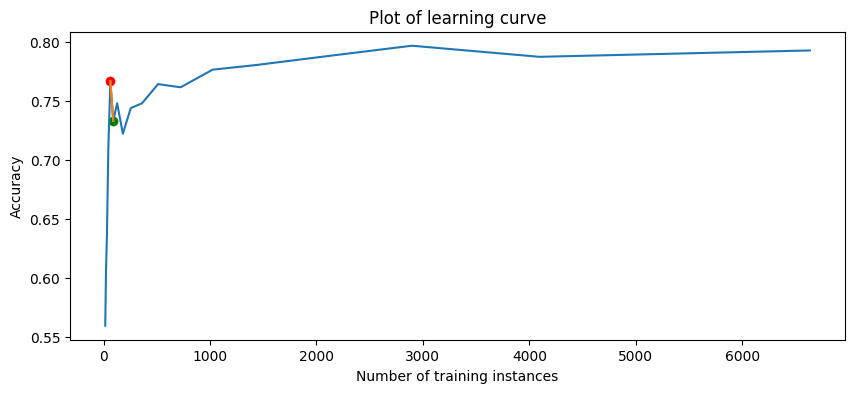

67it [02:37,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_813;non-monotonic:True


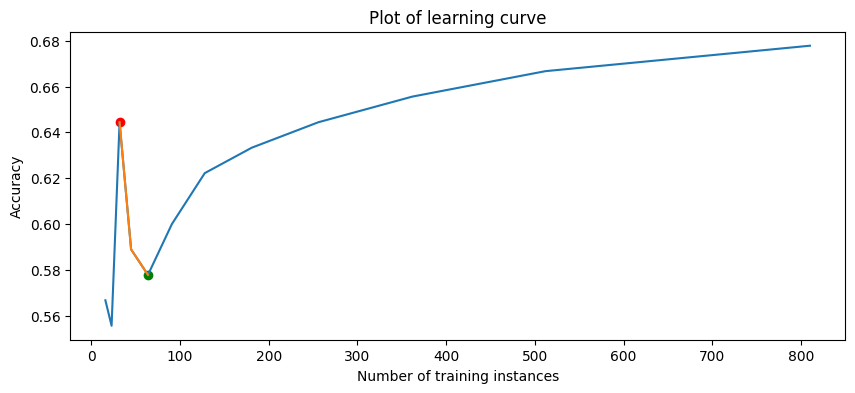

68it [02:40,  2.38s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_816;non-monotonic:False


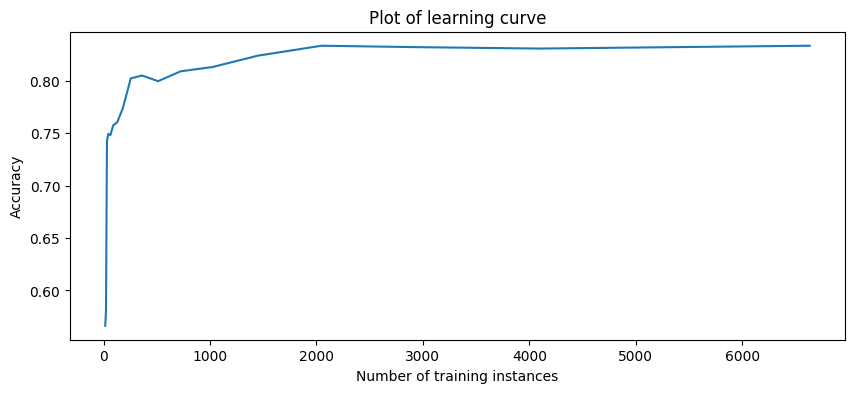

69it [02:42,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_819;non-monotonic:False


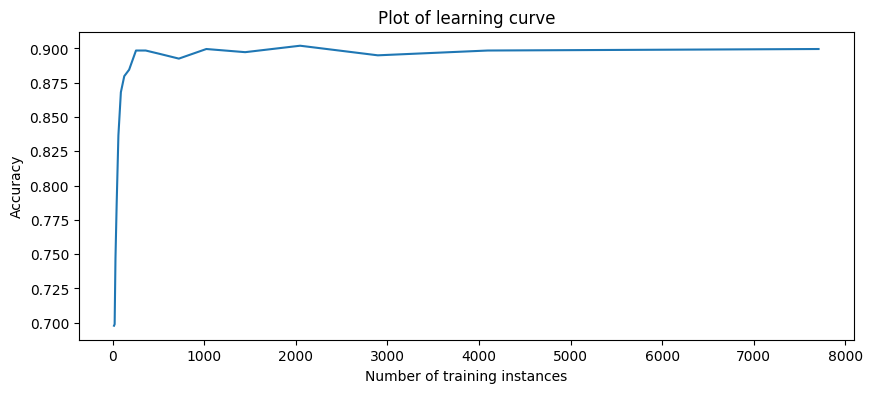

70it [02:45,  2.38s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_821;non-monotonic:True


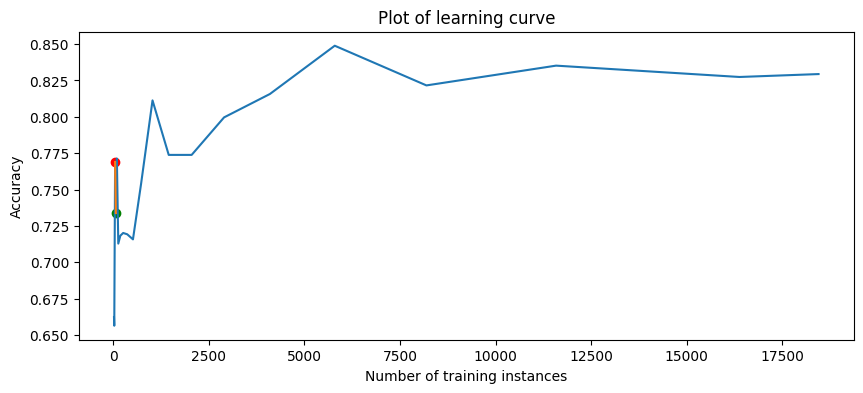

71it [02:47,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_822;non-monotonic:True


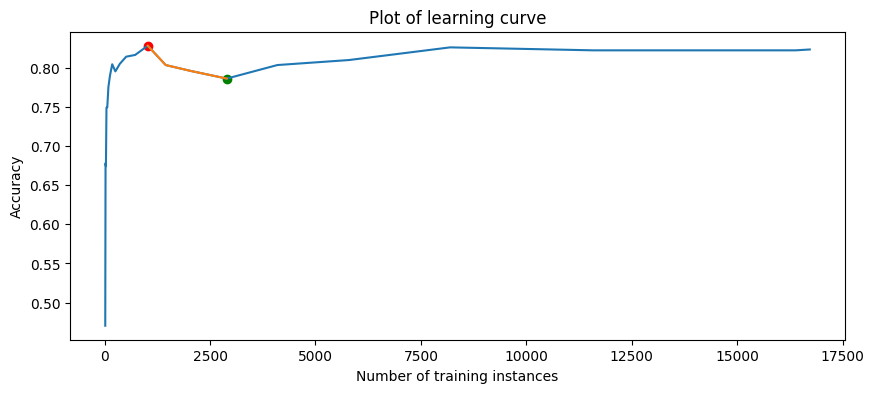

72it [02:49,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_823;non-monotonic:False


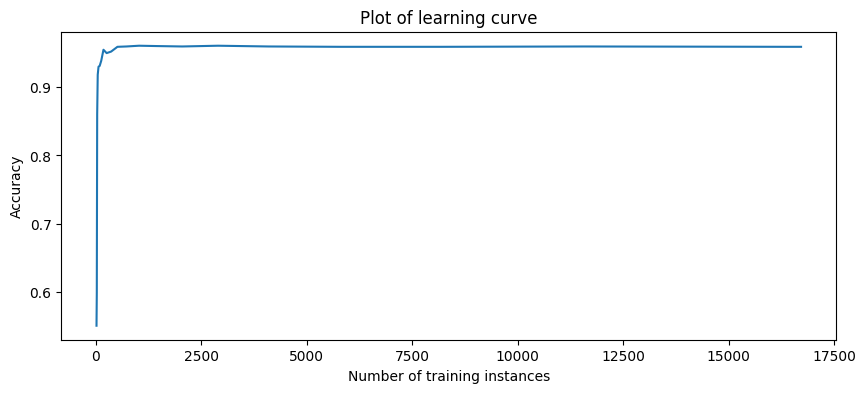

73it [02:52,  2.44s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_833;non-monotonic:False


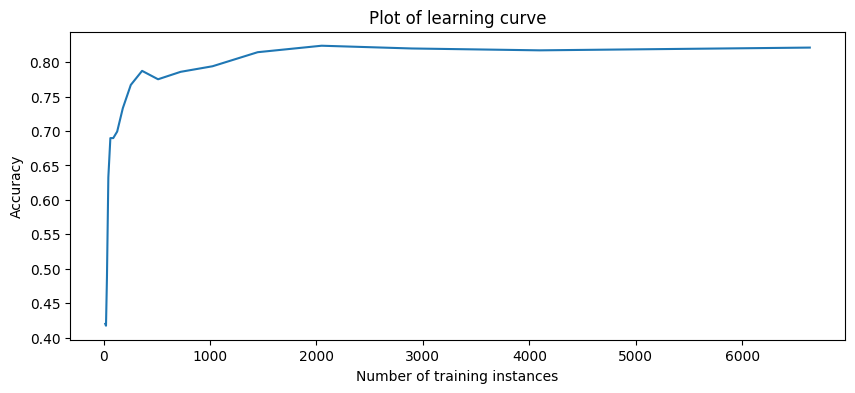

74it [02:54,  2.42s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_837;non-monotonic:True


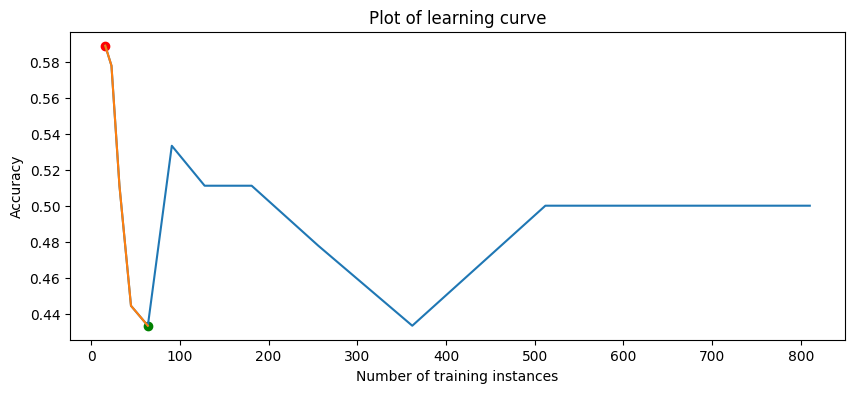

75it [02:57,  2.40s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_843;non-monotonic:True


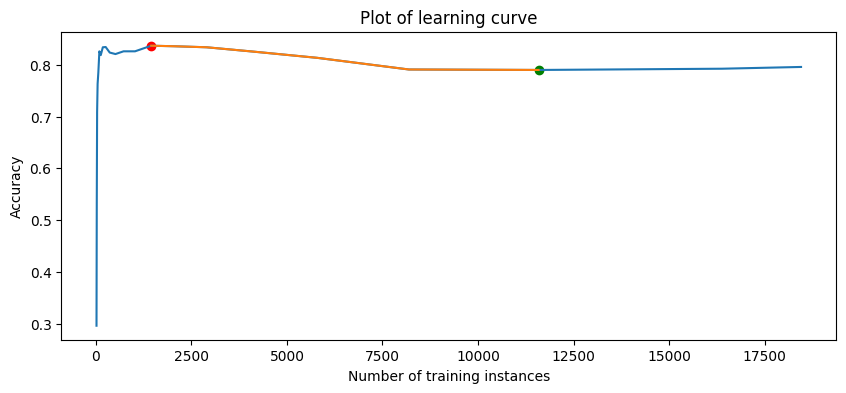

76it [02:59,  2.38s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_845;non-monotonic:False


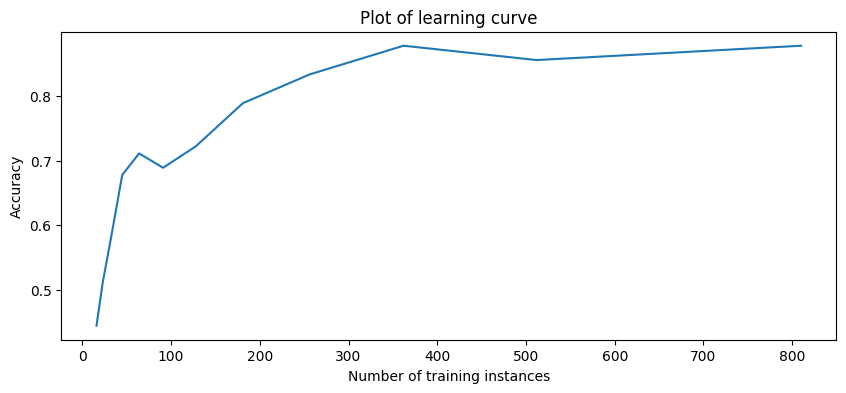

77it [03:01,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_846;non-monotonic:True


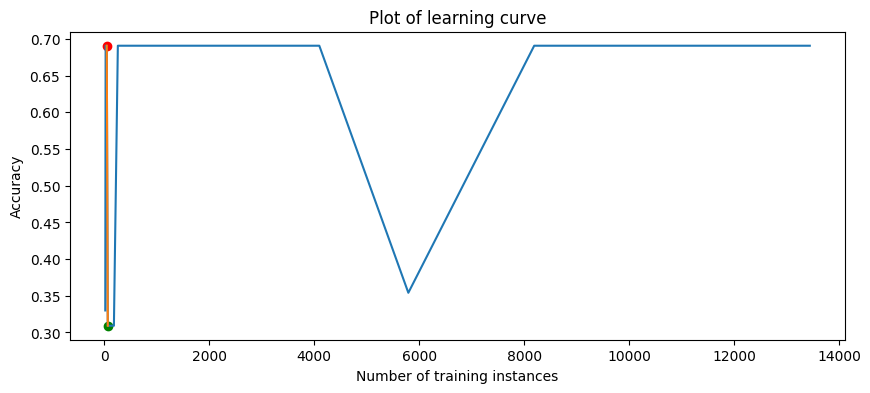

78it [03:04,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_847;non-monotonic:True


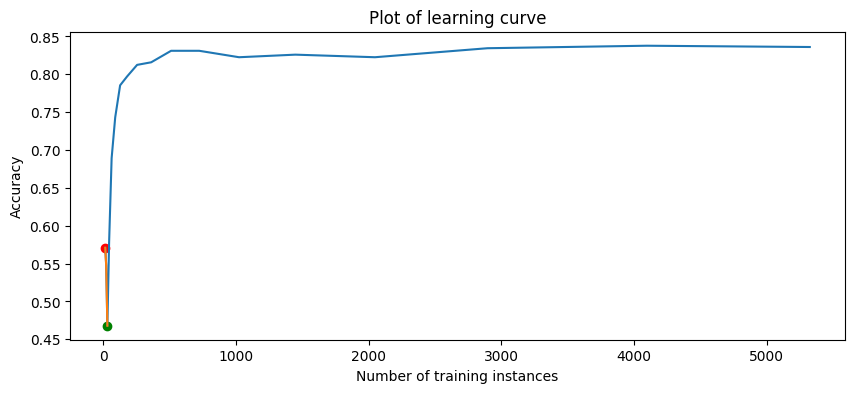

79it [03:06,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_849;non-monotonic:True


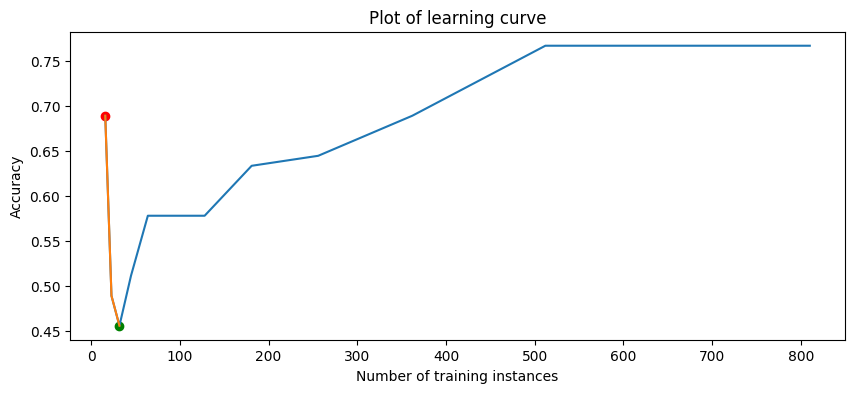

80it [03:09,  2.43s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_866;non-monotonic:True


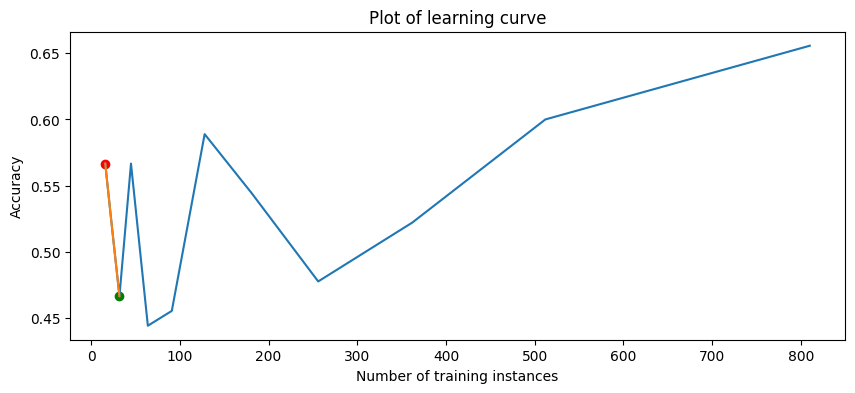

81it [03:11,  2.45s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_871;non-monotonic:True


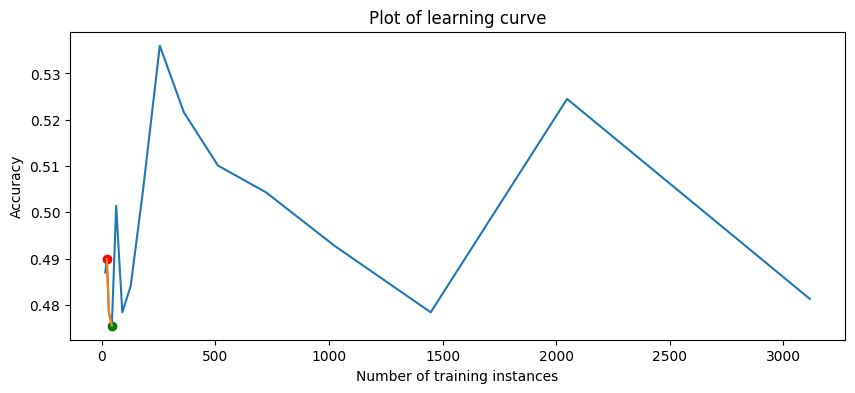

82it [03:13,  2.42s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_881;non-monotonic:True


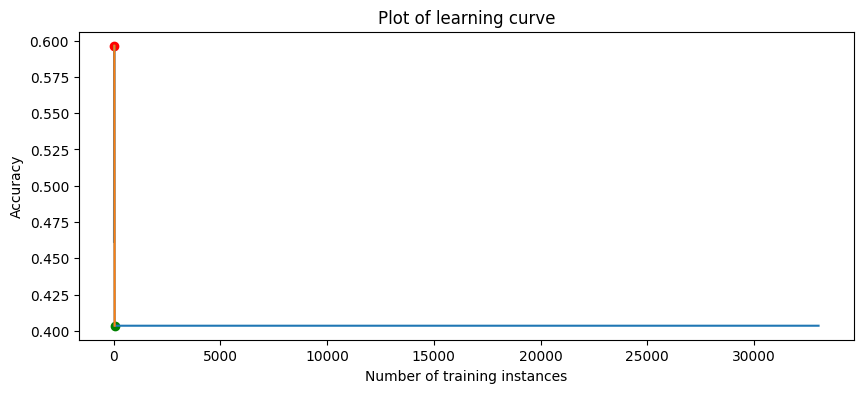

83it [03:16,  2.38s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_897;non-monotonic:True


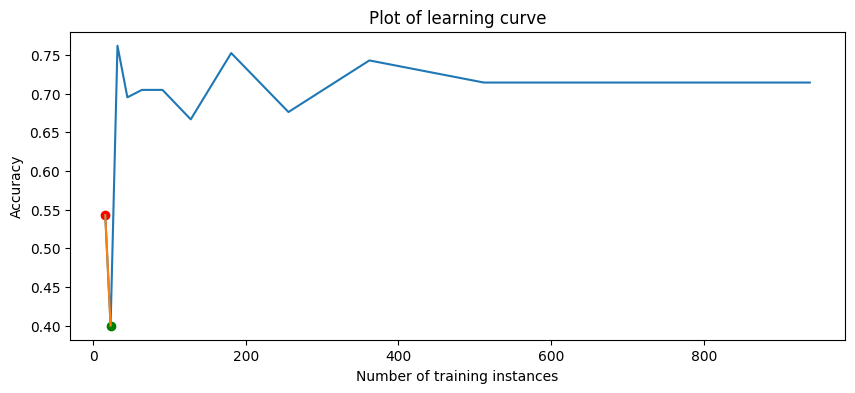

84it [03:18,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_901;non-monotonic:False


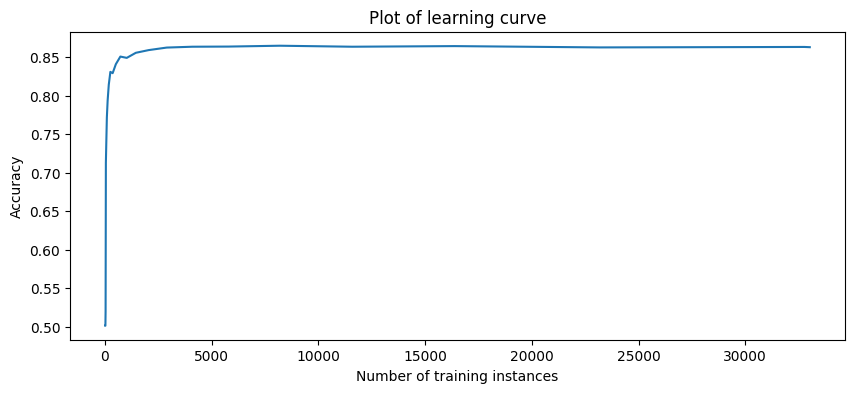

85it [03:20,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_903;non-monotonic:True


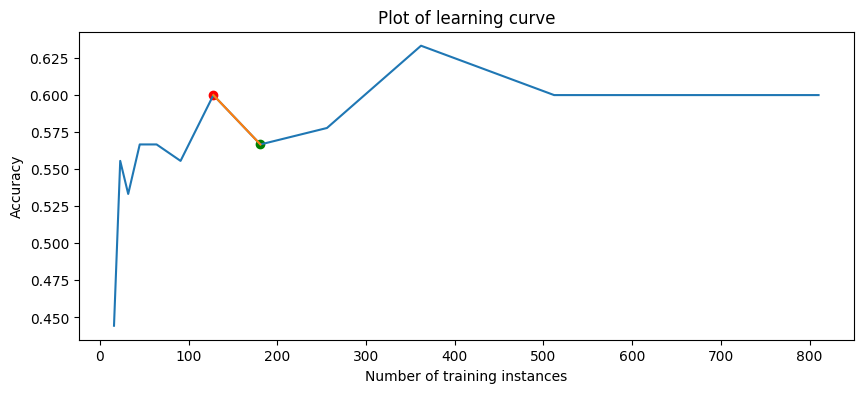

86it [03:23,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_904;non-monotonic:True


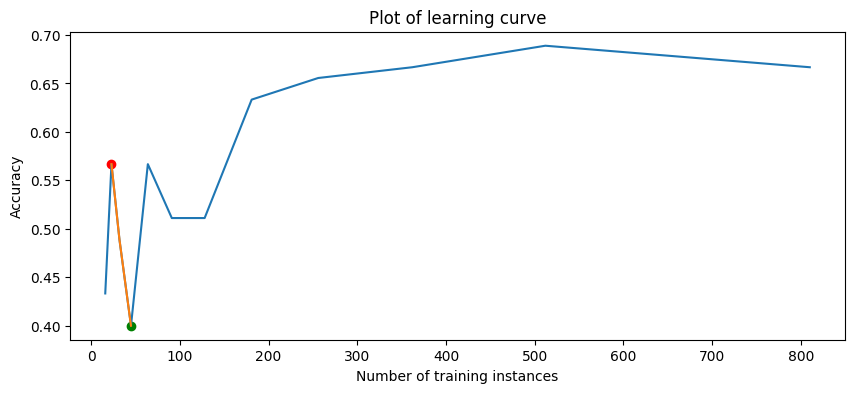

87it [03:25,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_910;non-monotonic:True


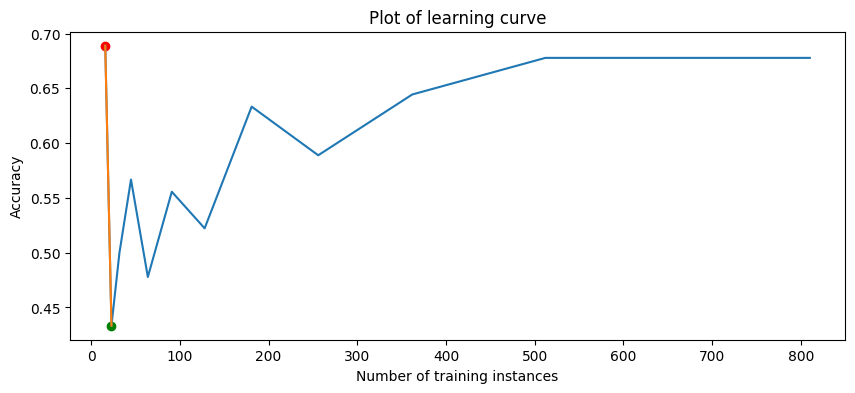

88it [03:28,  2.40s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_912;non-monotonic:True


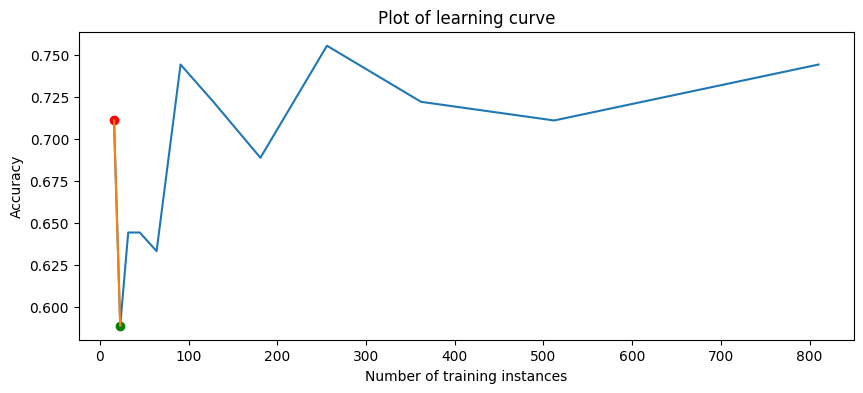

89it [03:30,  2.40s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_913;non-monotonic:True


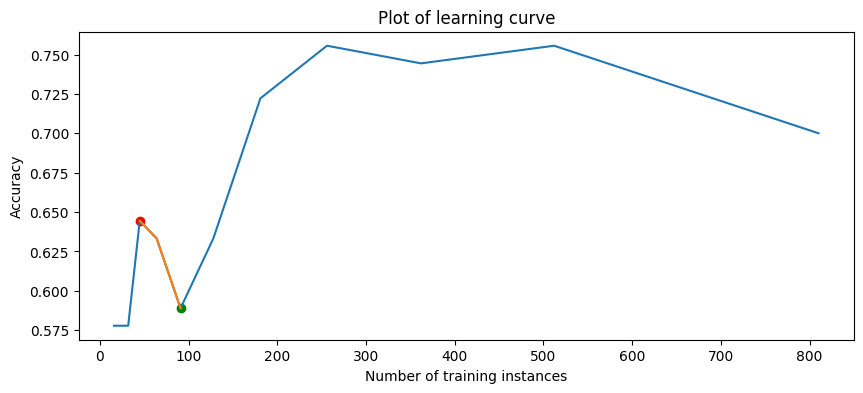

90it [03:33,  2.51s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_914;non-monotonic:True


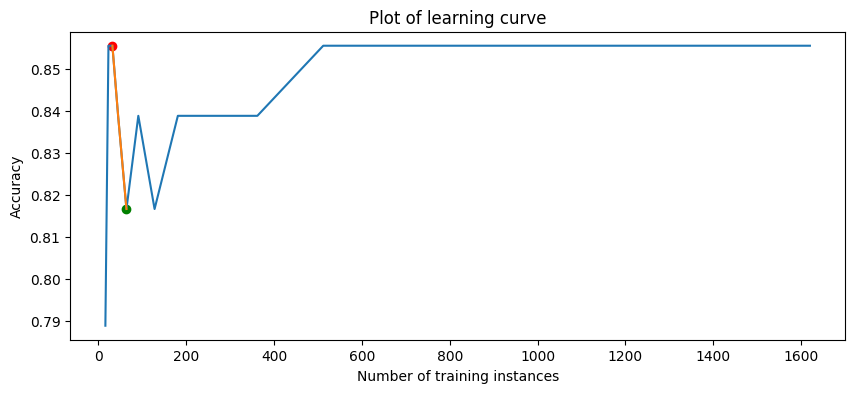

91it [03:35,  2.44s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_917;non-monotonic:True


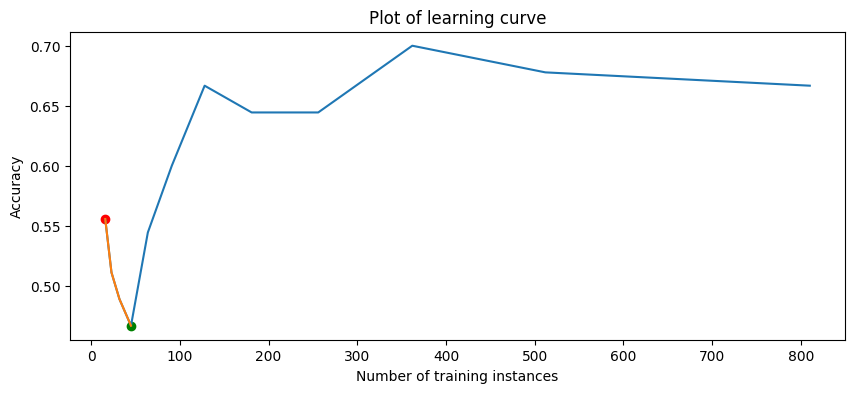

92it [03:37,  2.43s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_923;non-monotonic:False


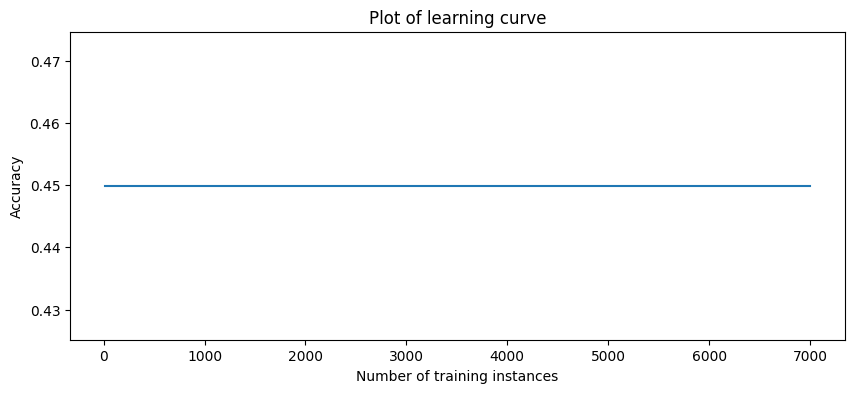

93it [03:40,  2.44s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_930;non-monotonic:True


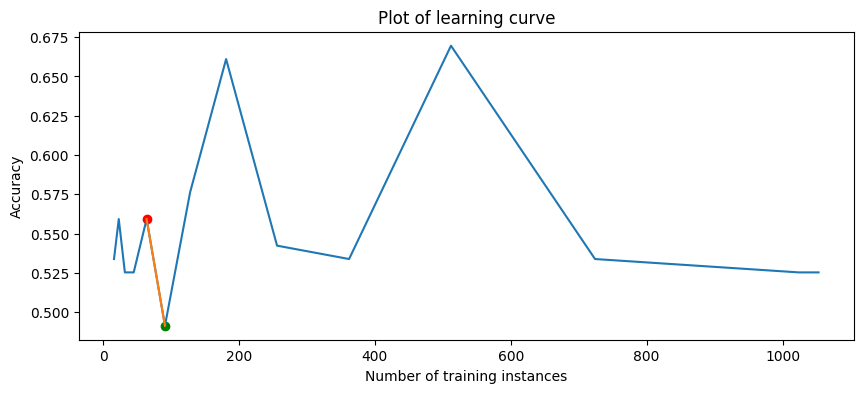

94it [03:42,  2.42s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_934;non-monotonic:True


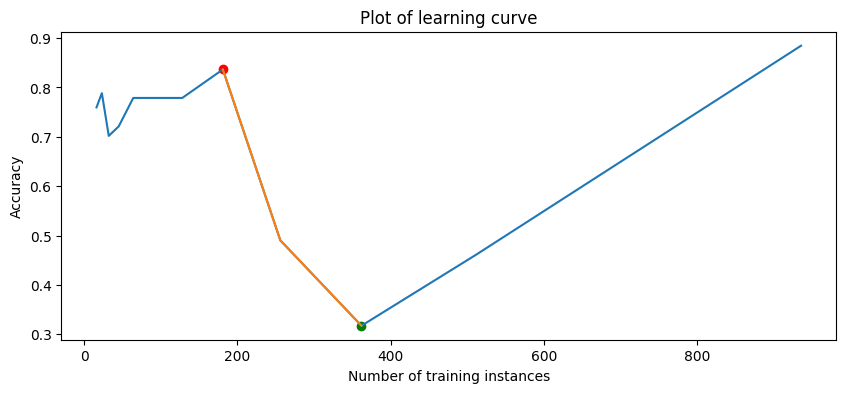

95it [03:45,  2.39s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_958;non-monotonic:True


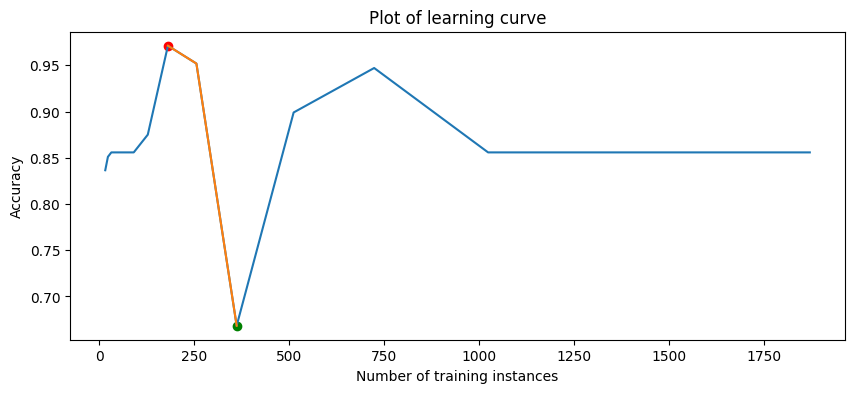

96it [03:47,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_959;non-monotonic:True


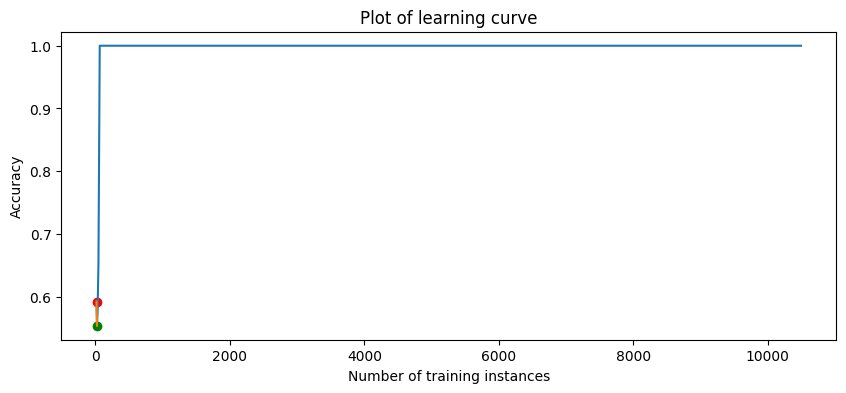

97it [03:49,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_962;non-monotonic:True


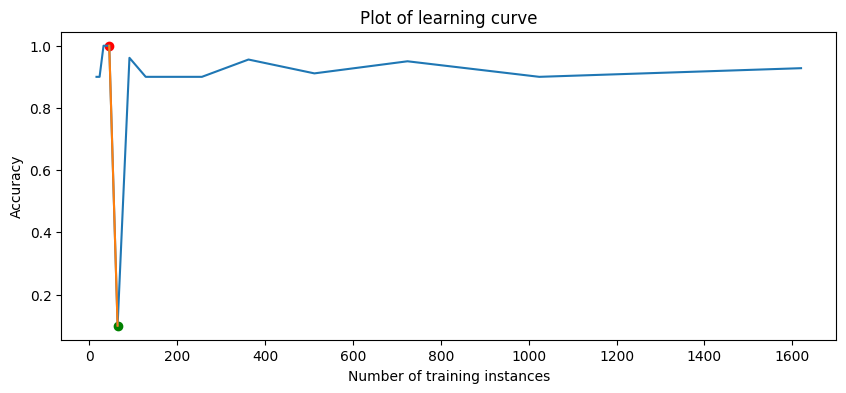

98it [03:52,  2.38s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_966;non-monotonic:True


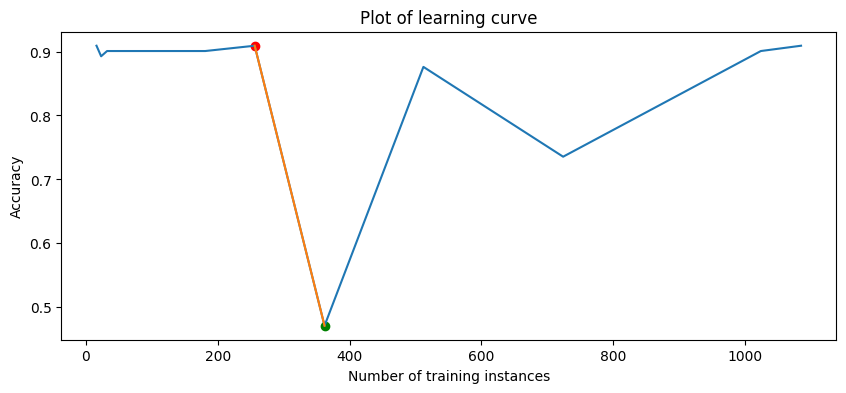

99it [03:54,  2.40s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_971;non-monotonic:True


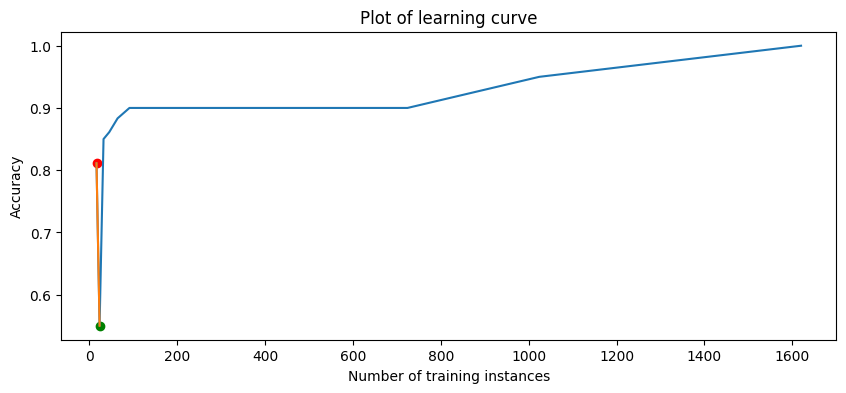

100it [03:56,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_976;non-monotonic:False


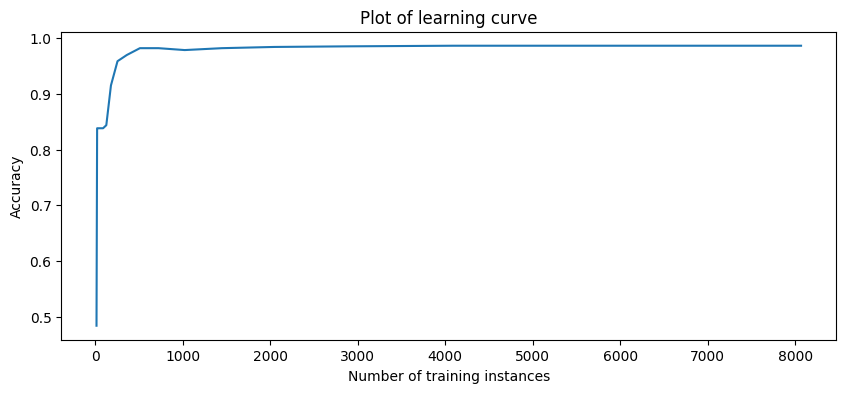

101it [03:59,  2.36s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_977;non-monotonic:True


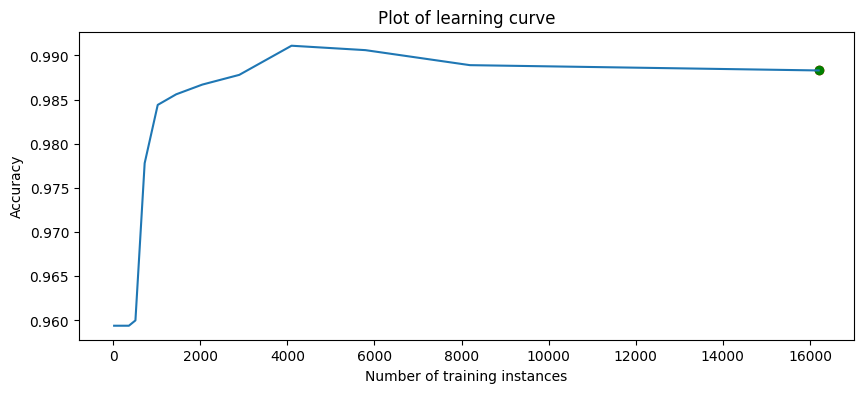

102it [04:01,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_978;non-monotonic:True


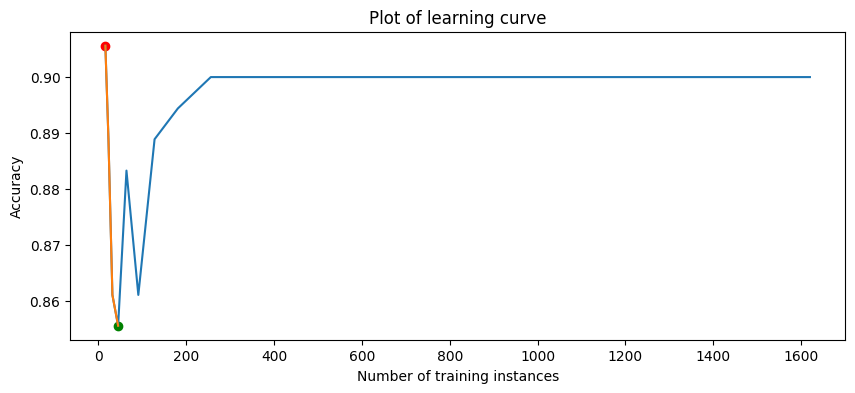

103it [04:03,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_979;non-monotonic:True


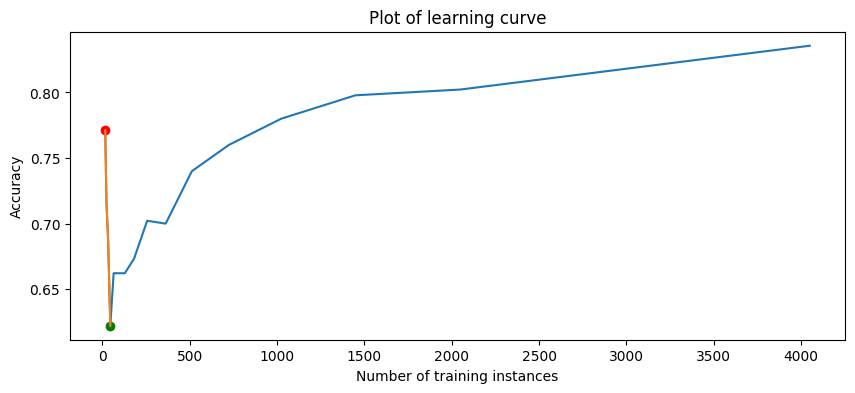

104it [04:06,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_980;non-monotonic:True


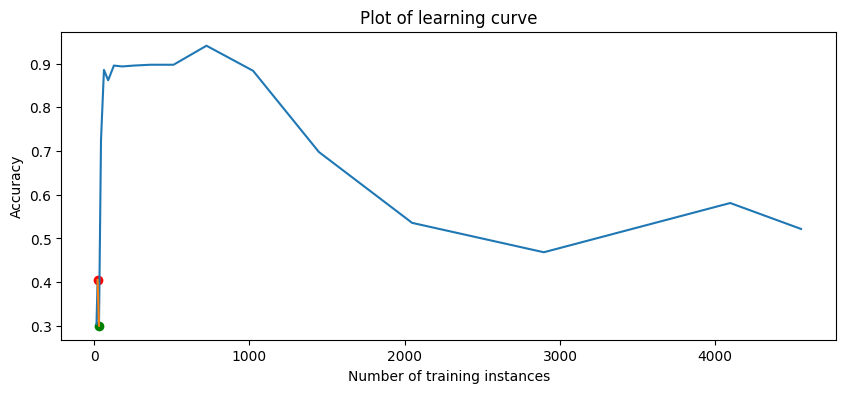

105it [04:08,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_991;non-monotonic:True


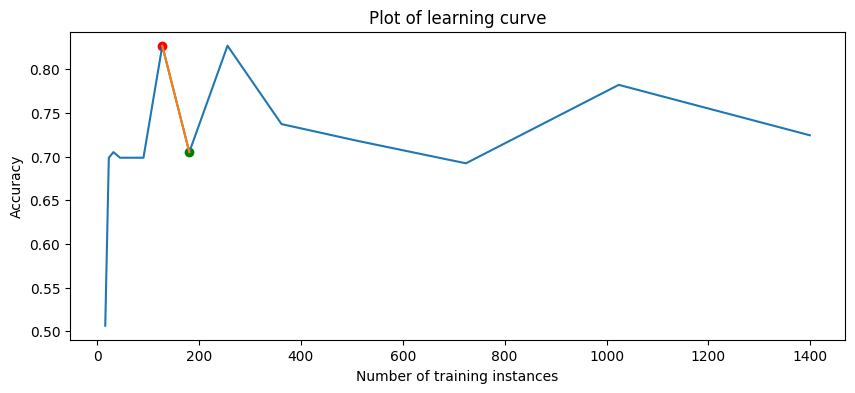

106it [04:11,  2.47s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_995;non-monotonic:True


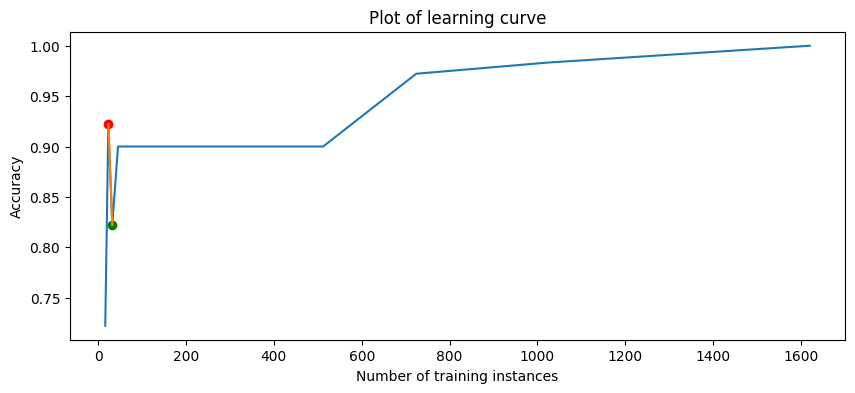

107it [04:13,  2.46s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1019;non-monotonic:False


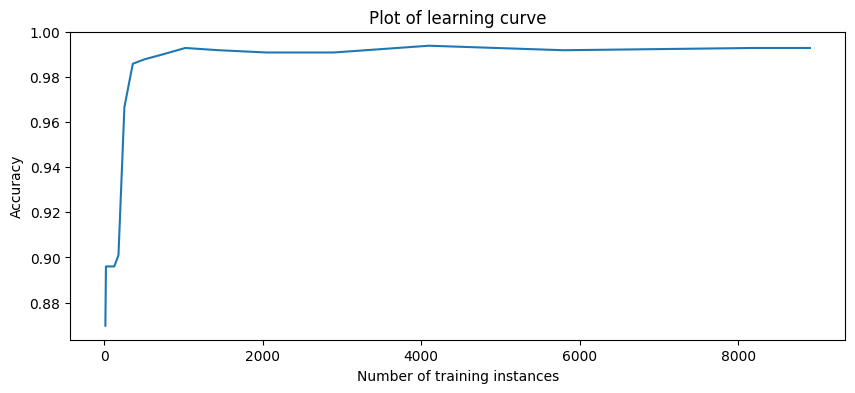

108it [04:16,  2.43s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1020;non-monotonic:True


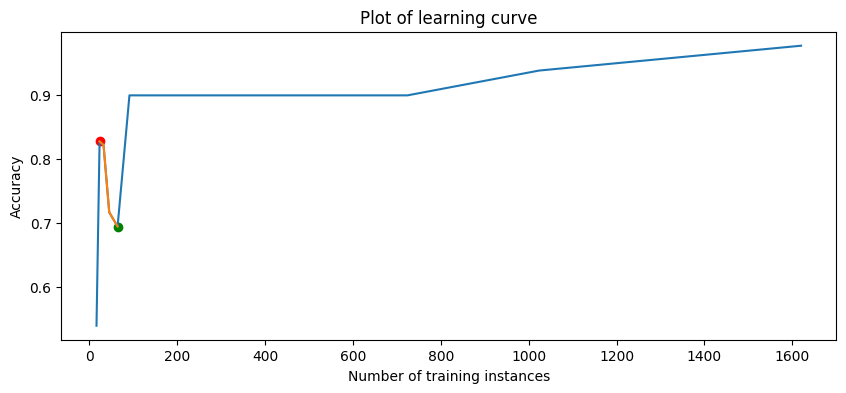

109it [04:18,  2.42s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1021;non-monotonic:True


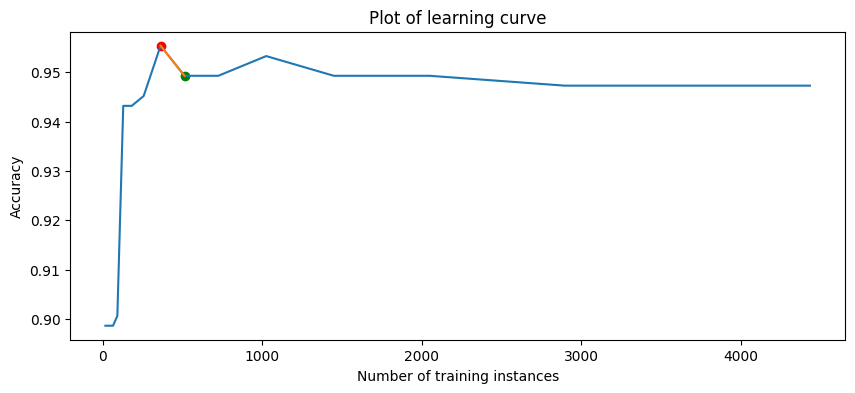

110it [04:21,  2.44s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1036;non-monotonic:True


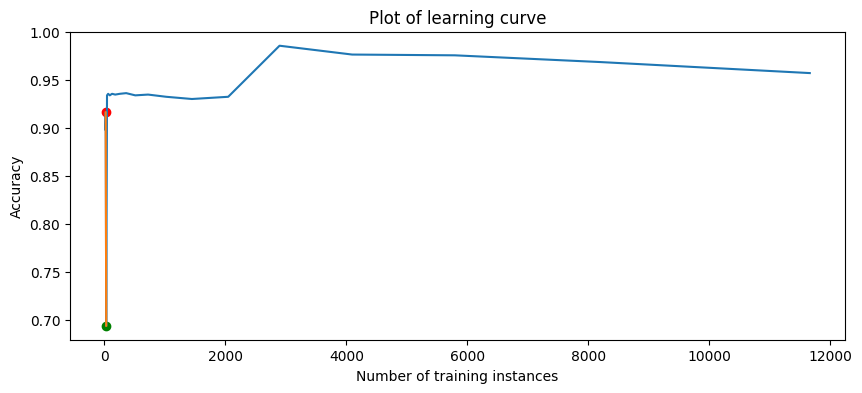

111it [04:23,  2.41s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1040;non-monotonic:True


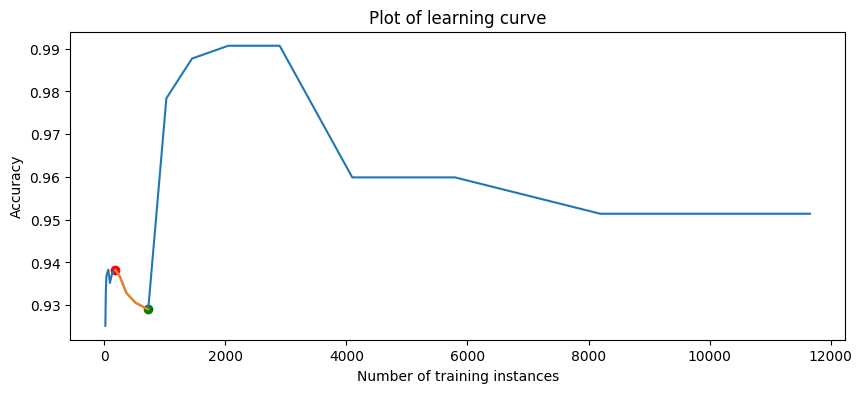

112it [04:25,  2.42s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1041;non-monotonic:True


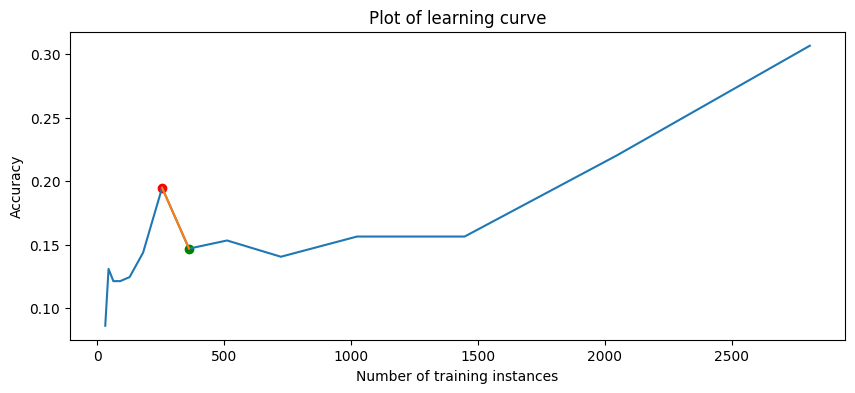

113it [04:28,  2.46s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1042;non-monotonic:True


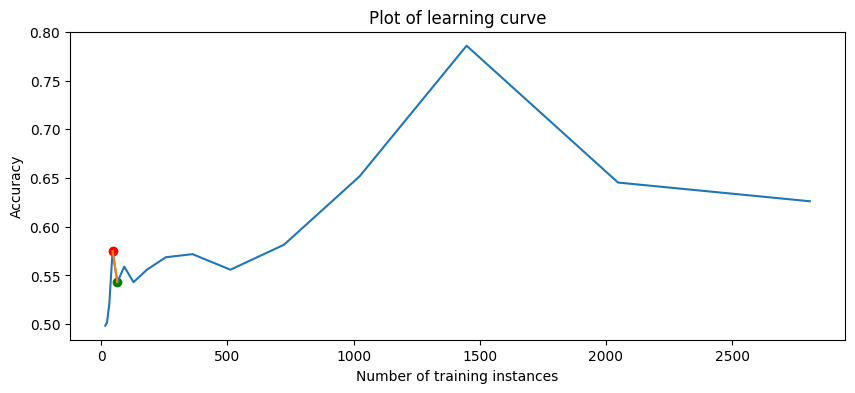

114it [04:32,  2.90s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1049;non-monotonic:True


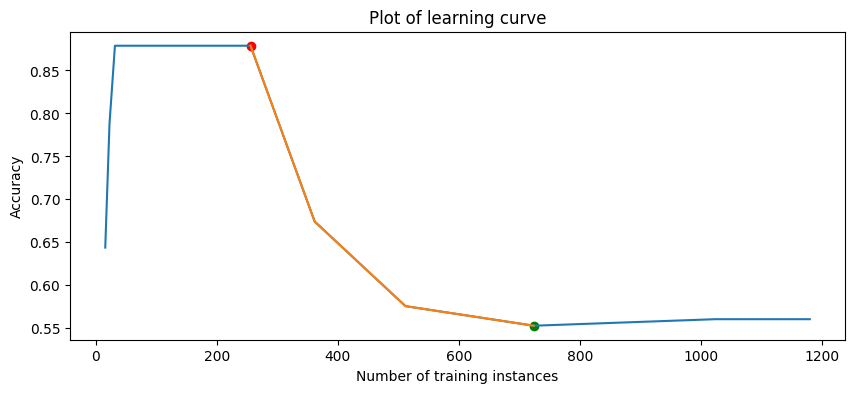

115it [04:35,  2.95s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1050;non-monotonic:True


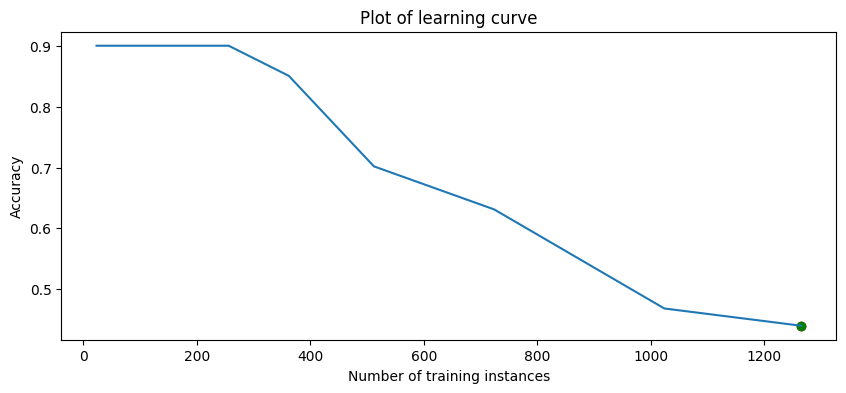

116it [04:38,  2.95s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1053;non-monotonic:True


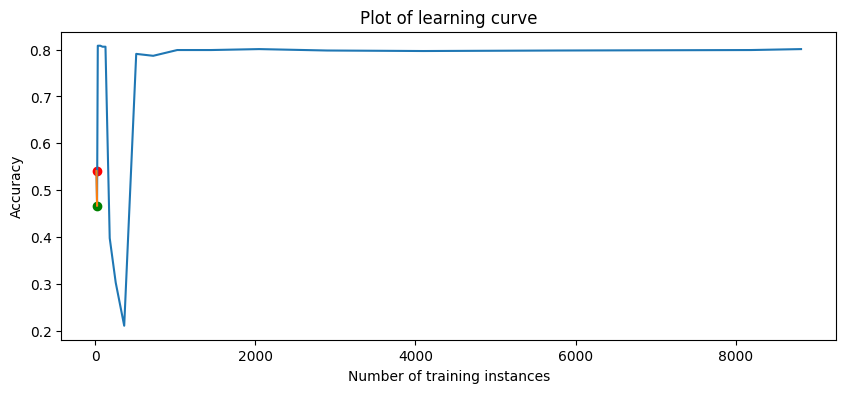

117it [04:41,  3.02s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1056;non-monotonic:False


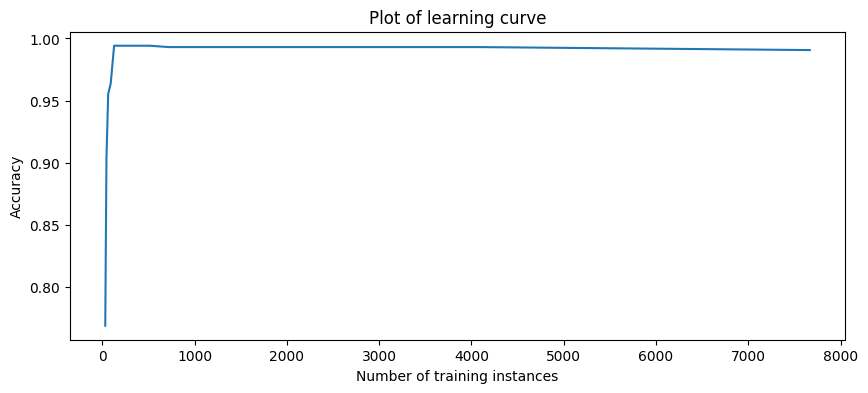

118it [04:44,  3.00s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1067;non-monotonic:True


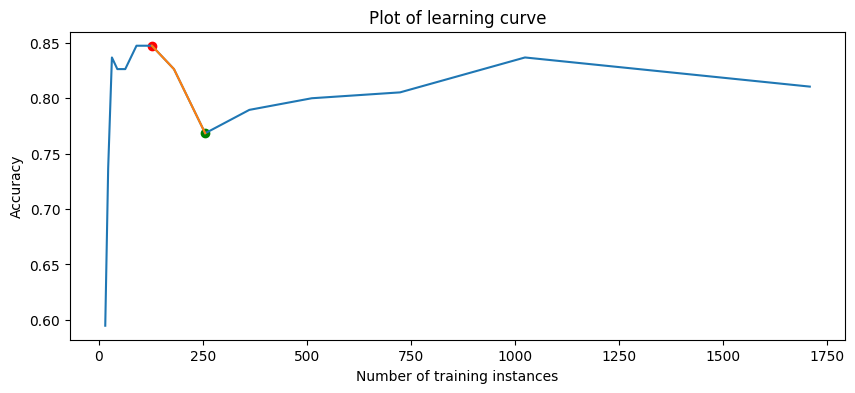

119it [04:47,  2.87s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1068;non-monotonic:True


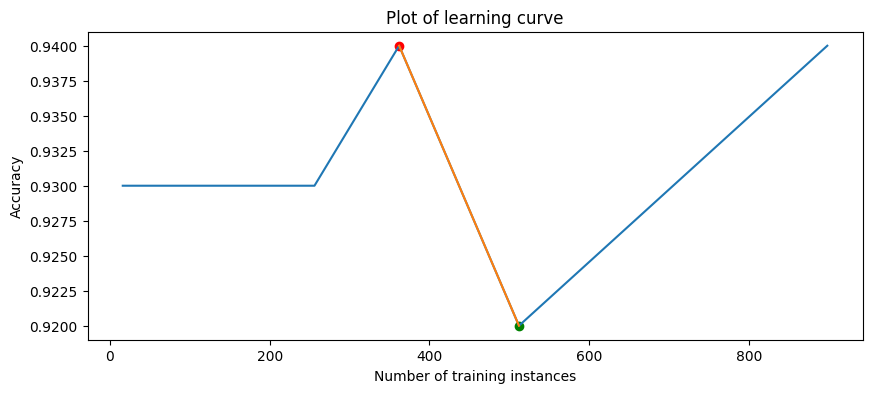

120it [04:49,  2.68s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1069;non-monotonic:False


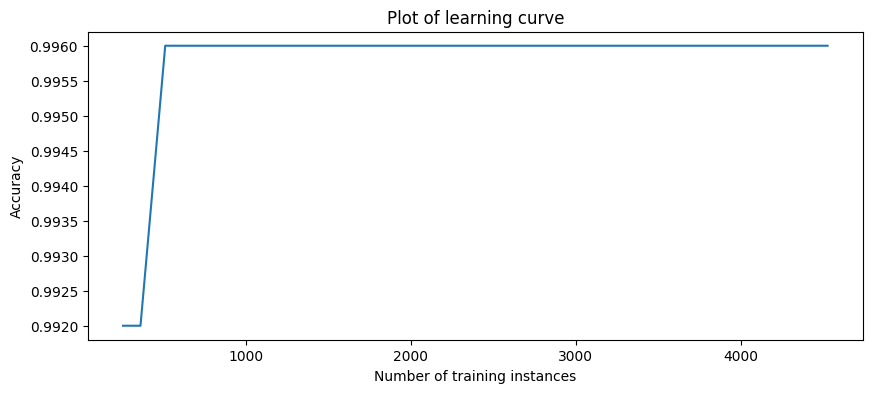

121it [04:51,  2.54s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1083;non-monotonic:True


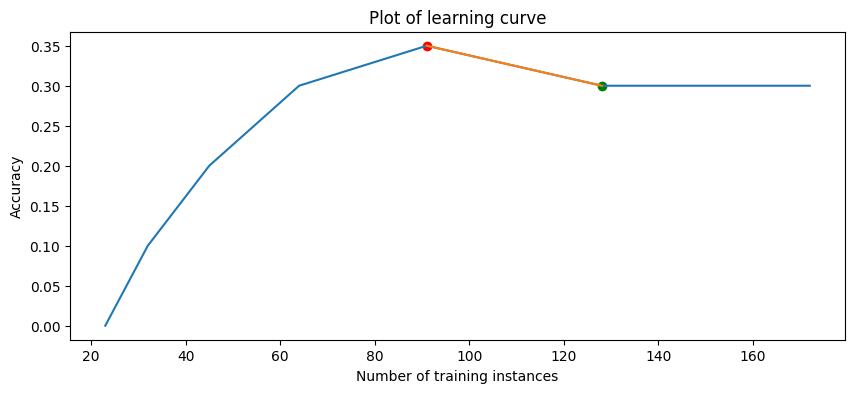

122it [04:53,  2.44s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1084;non-monotonic:True


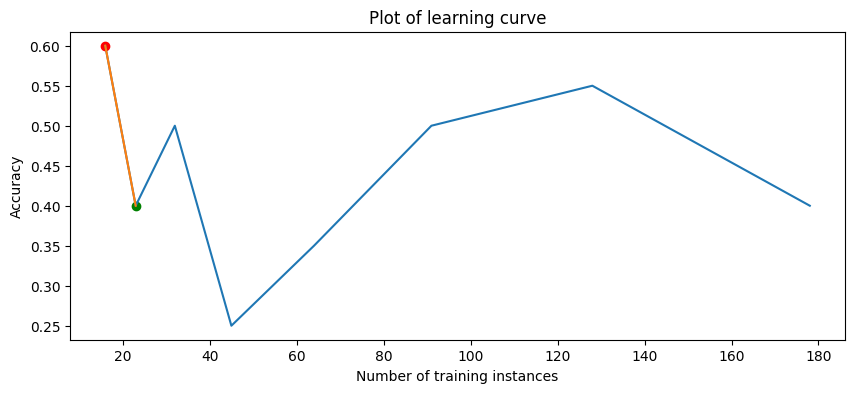

123it [04:55,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1085;non-monotonic:True


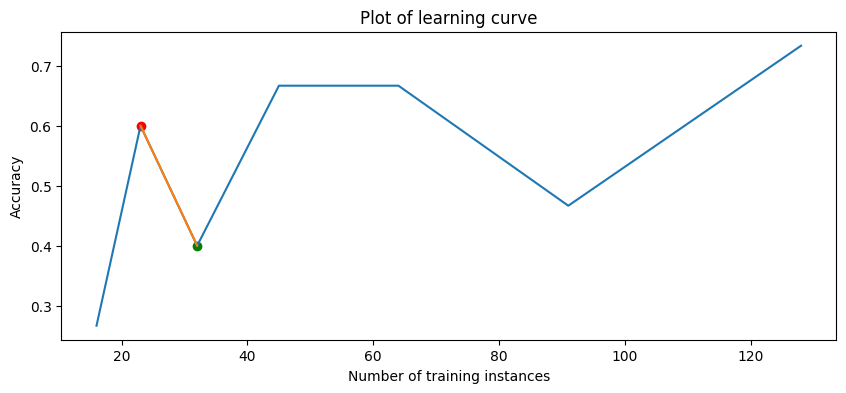

124it [04:58,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1086;non-monotonic:True


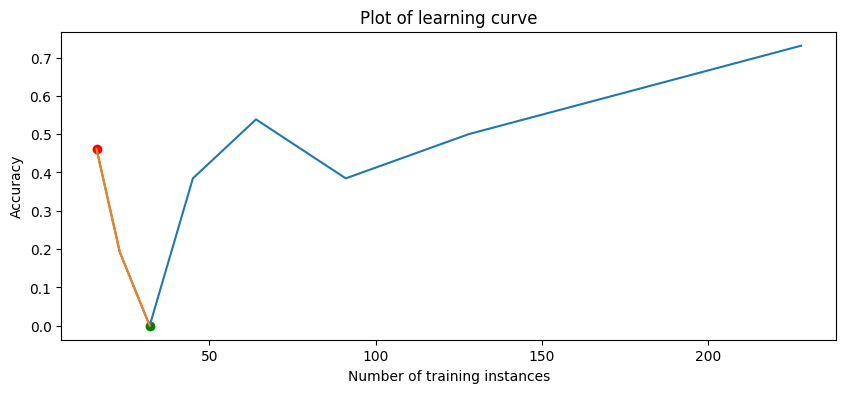

125it [05:00,  2.28s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1087;non-monotonic:True


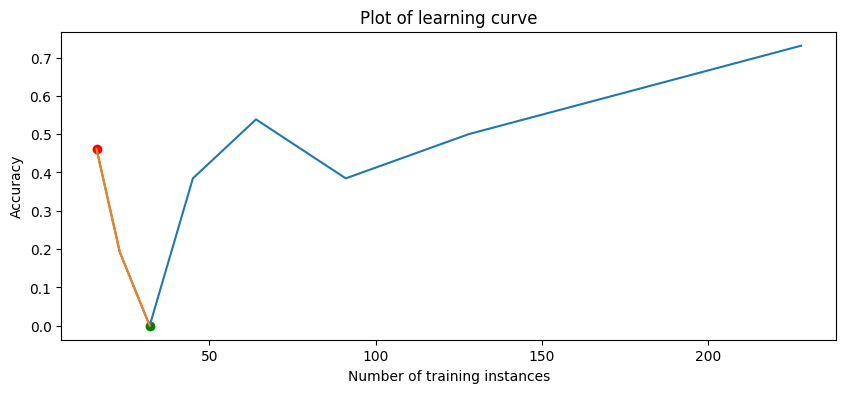

126it [05:02,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1088;non-monotonic:True


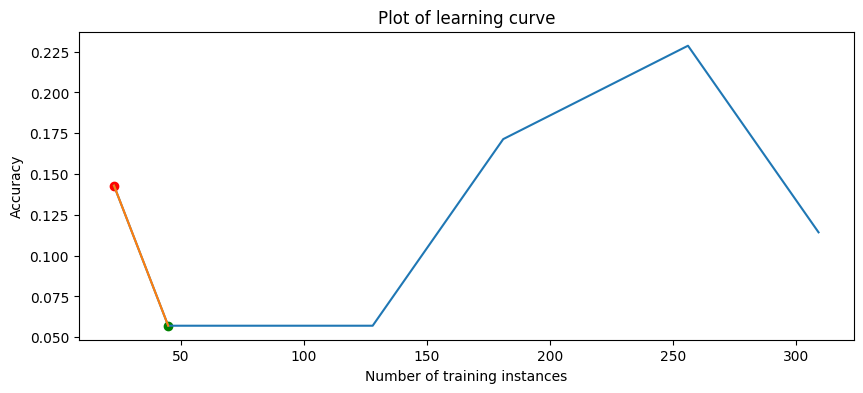

127it [05:04,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1116;non-monotonic:True


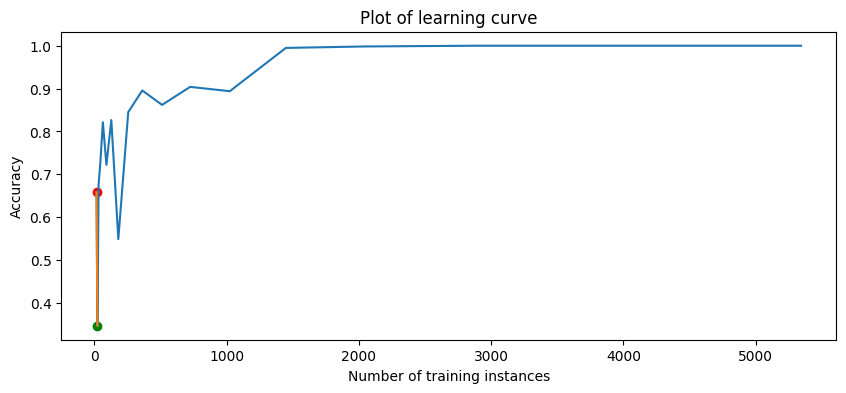

128it [05:06,  2.24s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1120;non-monotonic:True


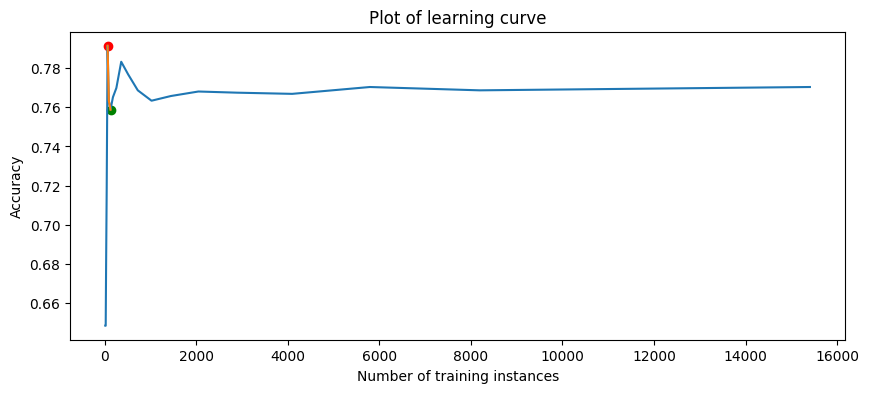

129it [05:09,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1128;non-monotonic:True


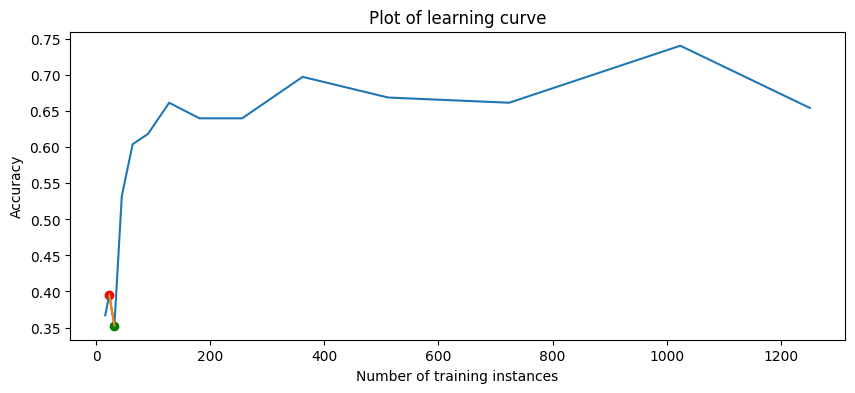

130it [05:11,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1130;non-monotonic:True


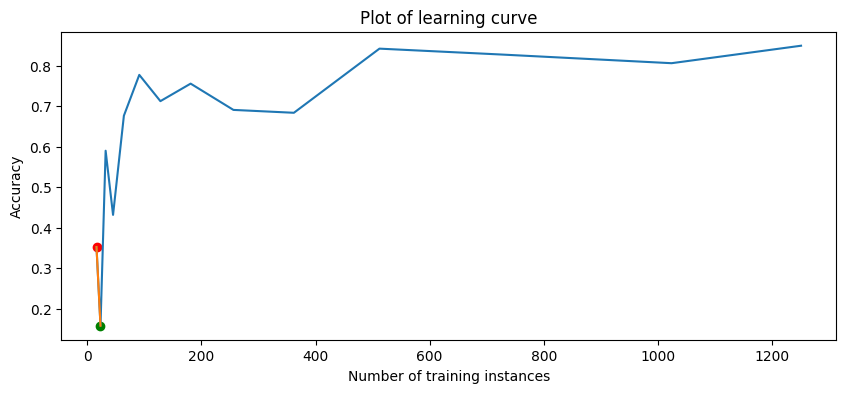

131it [05:13,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1134;non-monotonic:True


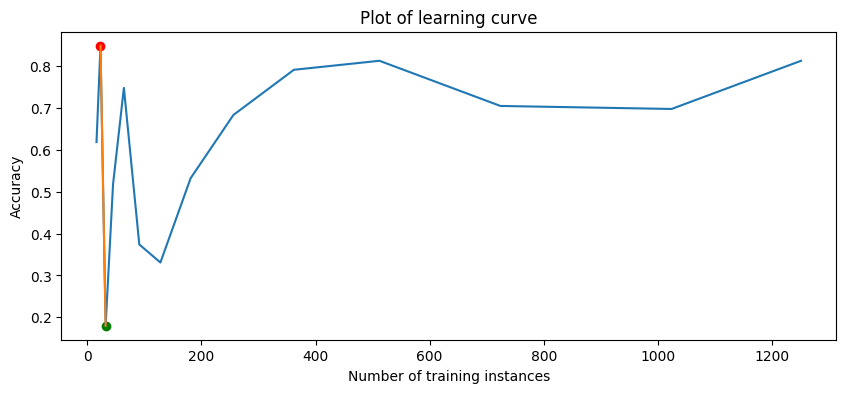

132it [05:16,  2.40s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1138;non-monotonic:True


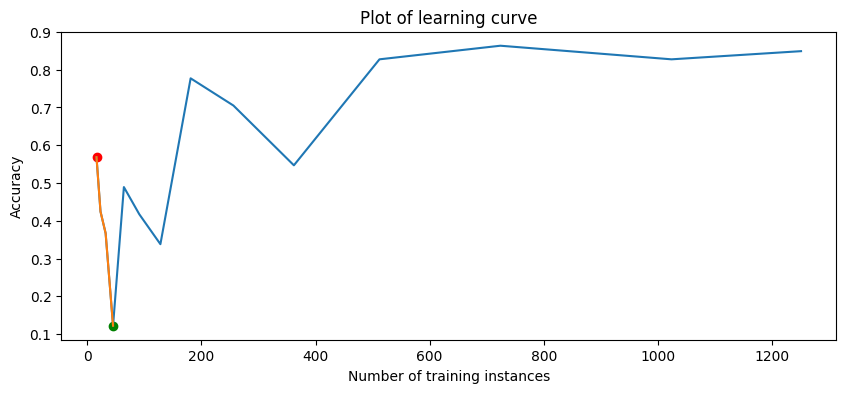

133it [05:18,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1139;non-monotonic:True


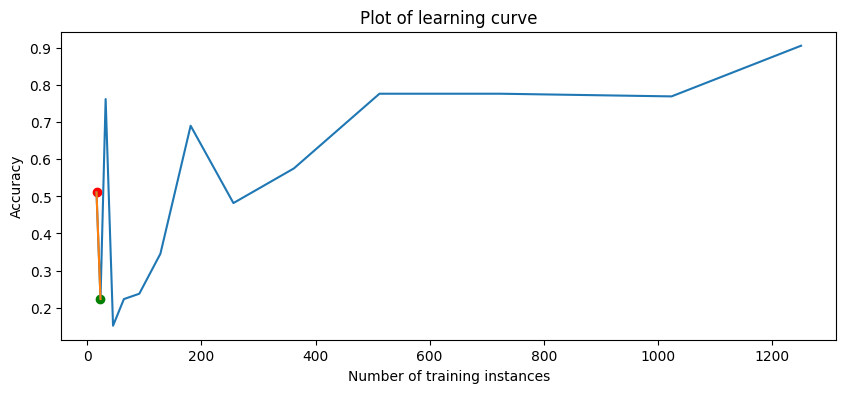

134it [05:21,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1142;non-monotonic:True


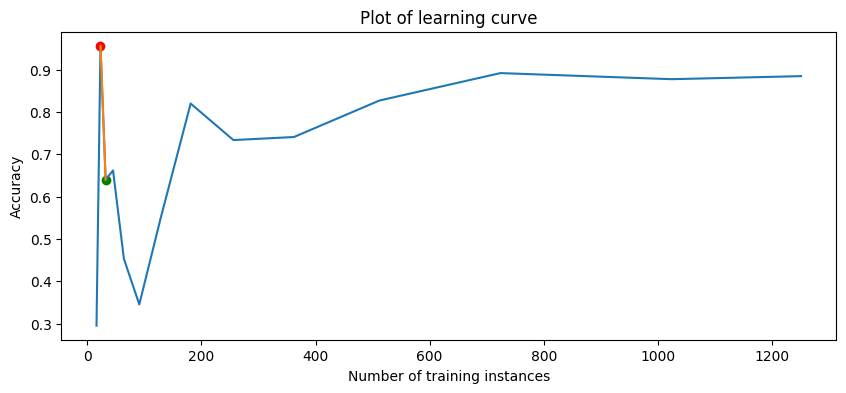

135it [05:23,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1146;non-monotonic:True


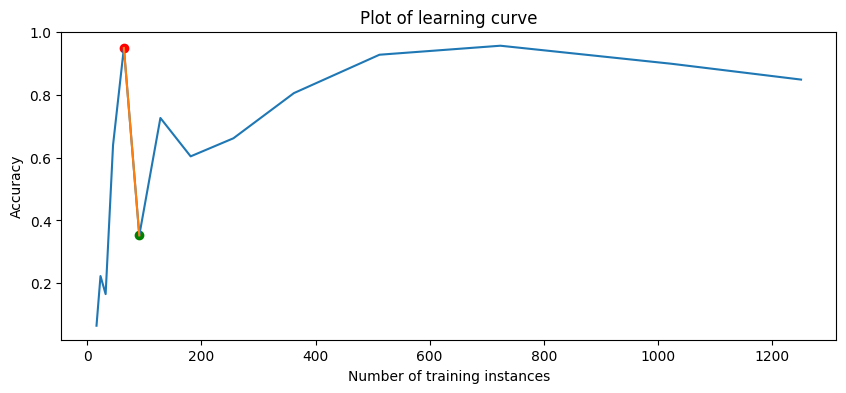

136it [05:25,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1161;non-monotonic:True


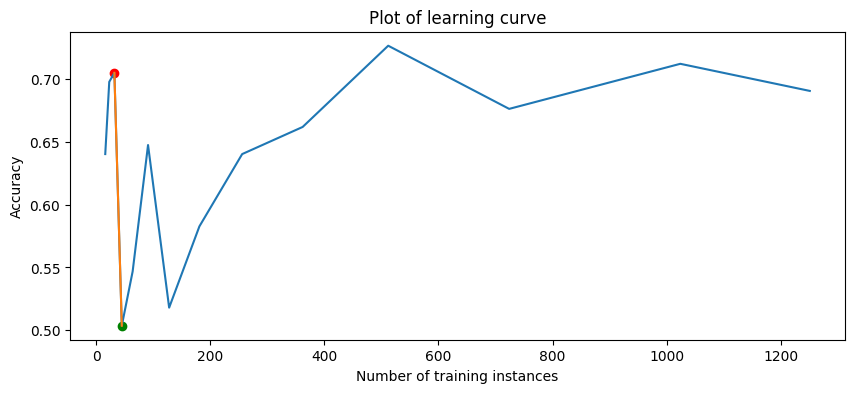

137it [05:28,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1166;non-monotonic:True


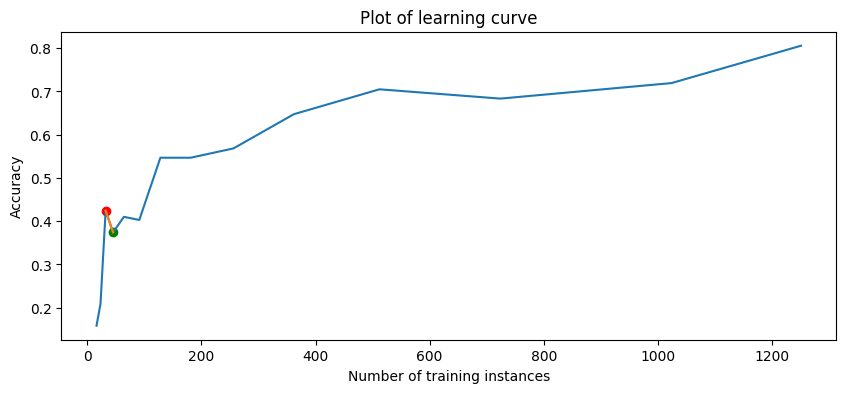

138it [05:30,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1216;non-monotonic:True


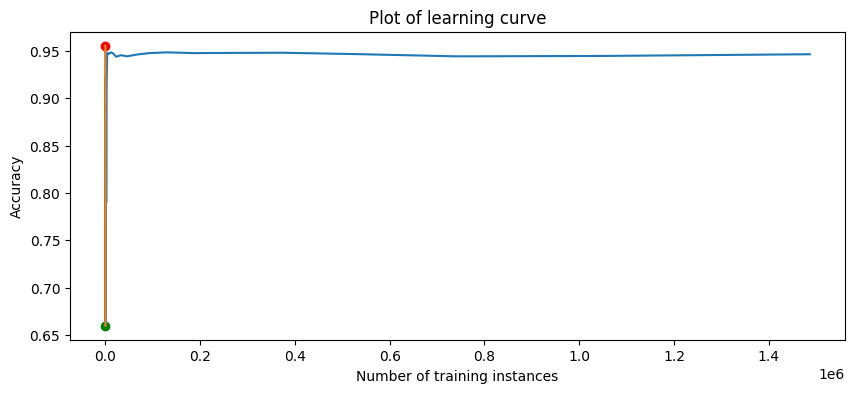

139it [05:32,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1233;non-monotonic:True


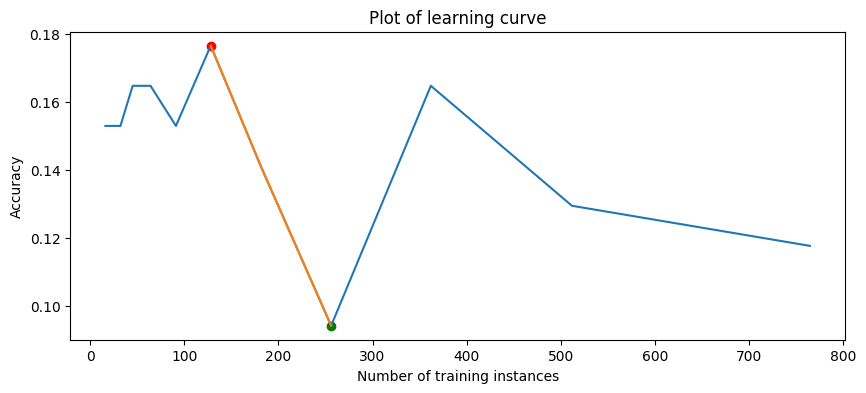

140it [05:34,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1235;non-monotonic:True


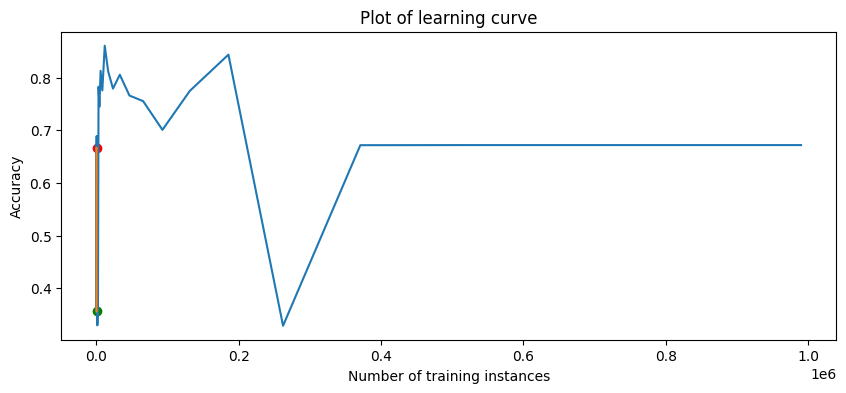

141it [05:37,  2.28s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1236;non-monotonic:True


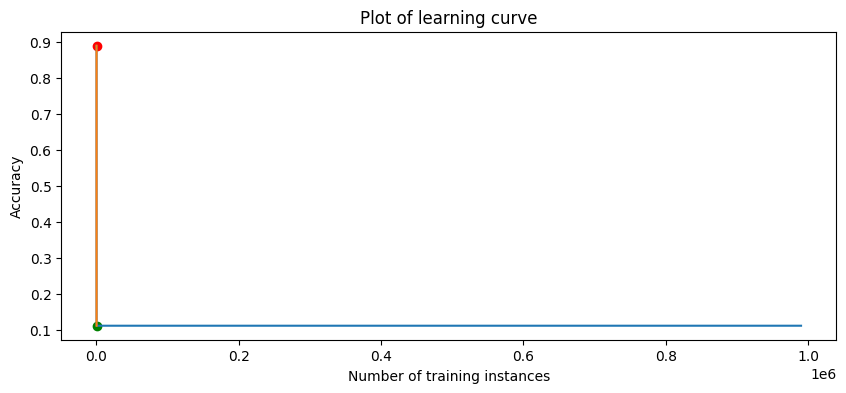

142it [05:39,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1441;non-monotonic:True


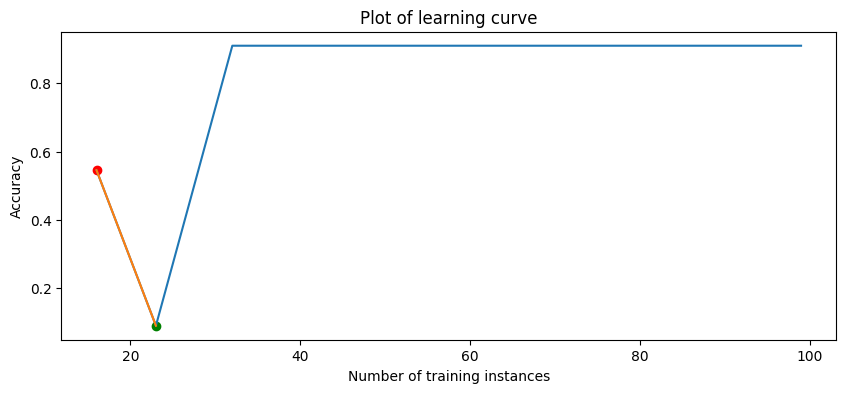

143it [05:41,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1448;non-monotonic:False


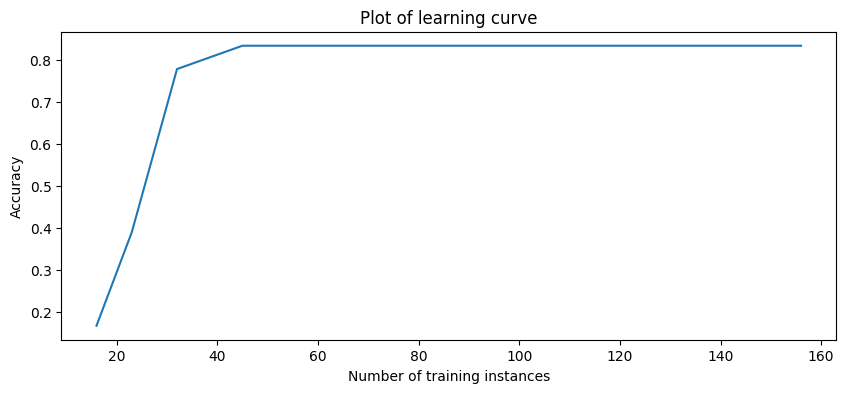

144it [05:43,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1450;non-monotonic:True


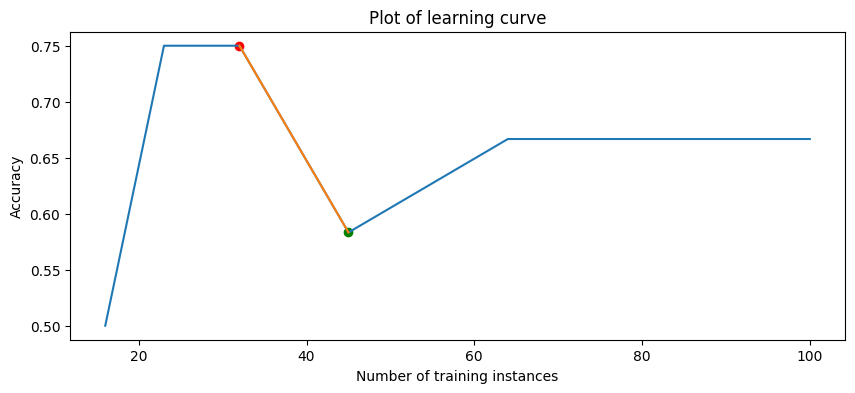

145it [05:46,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1457;non-monotonic:True


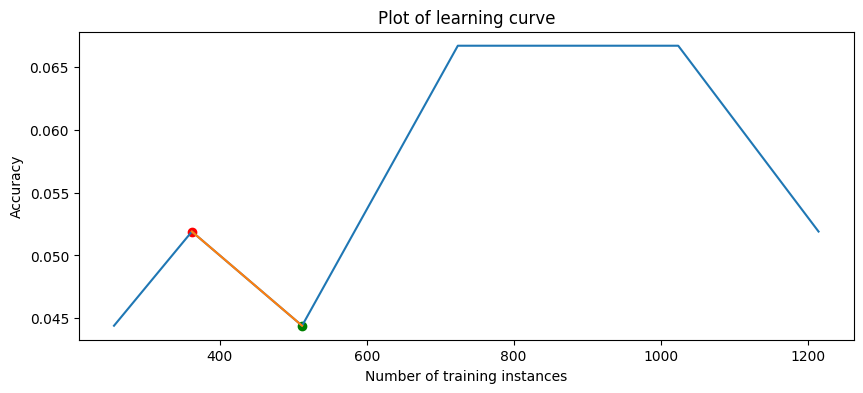

146it [05:48,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1464;non-monotonic:True


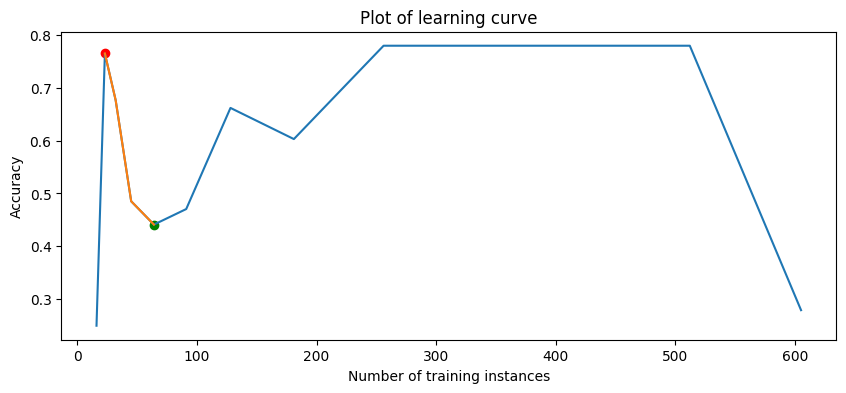

147it [05:51,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1465;non-monotonic:True


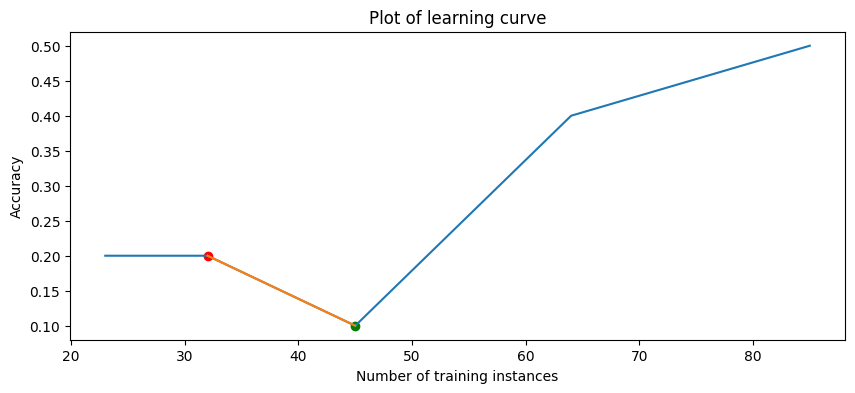

148it [05:53,  2.30s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1468;non-monotonic:True


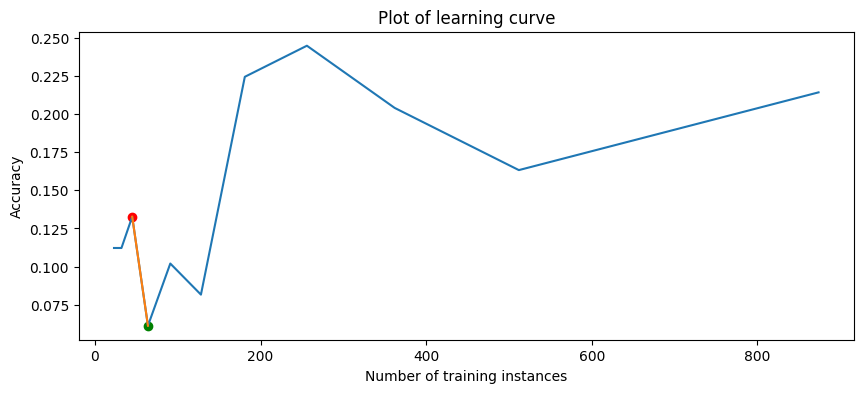

149it [05:55,  2.28s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1475;non-monotonic:True


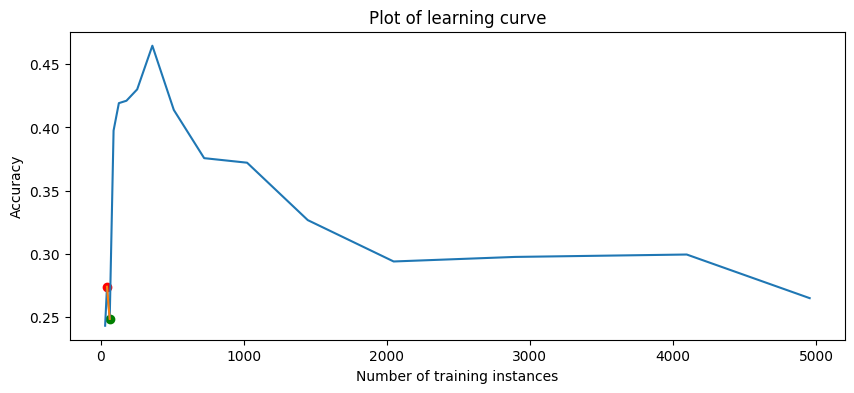

150it [05:57,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1477;non-monotonic:True


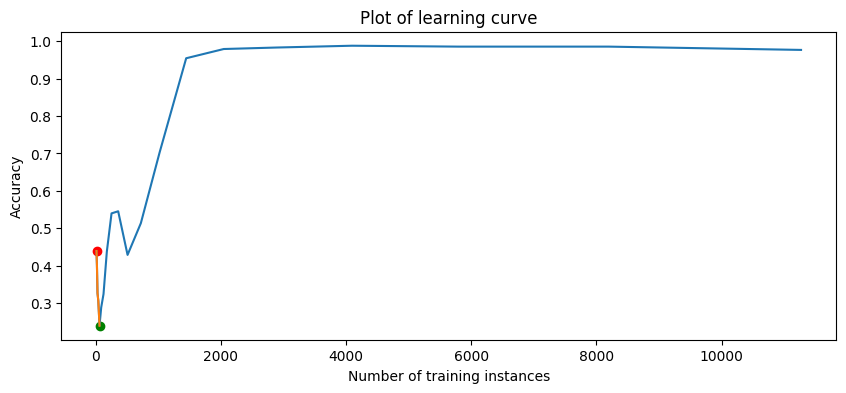

151it [06:00,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1479;non-monotonic:True


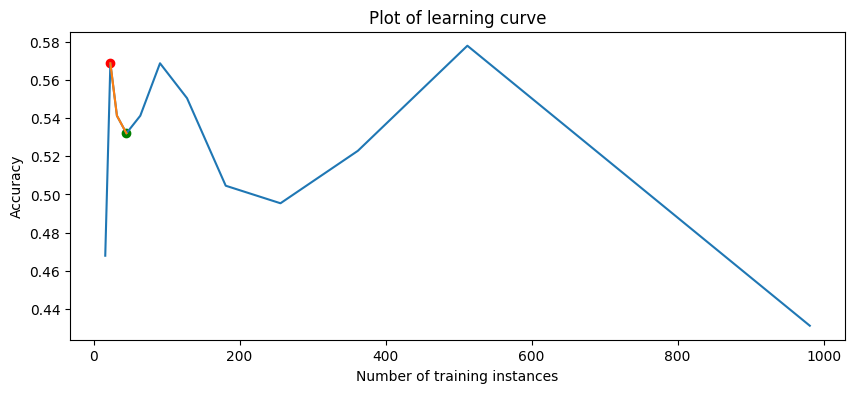

152it [06:02,  2.25s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1483;non-monotonic:True


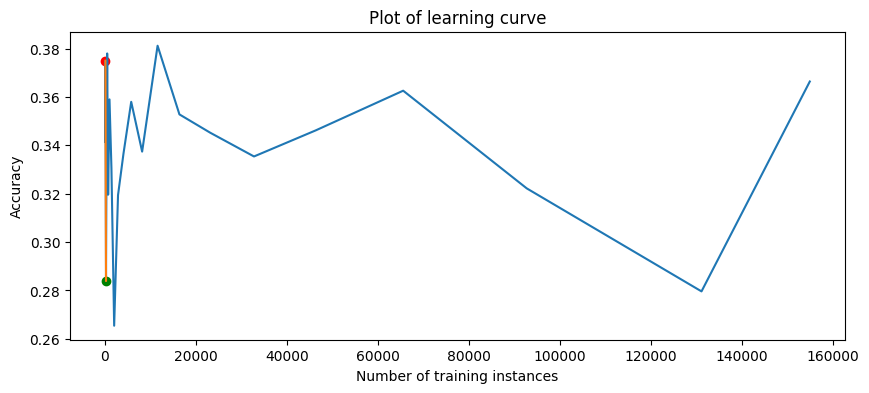

153it [06:04,  2.25s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1485;non-monotonic:True


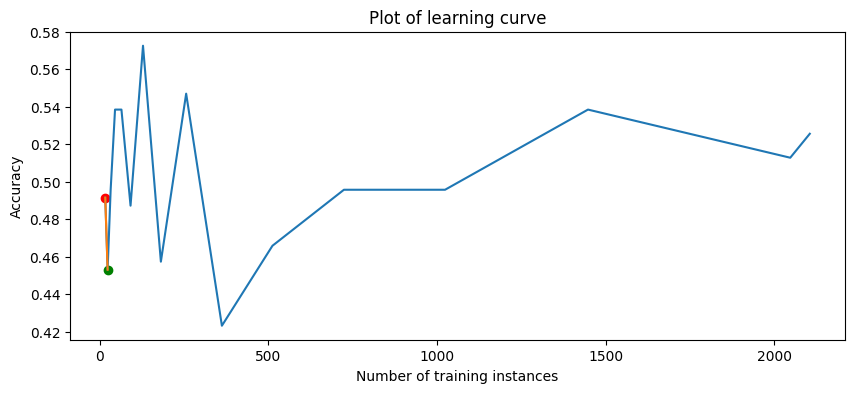

154it [06:06,  2.25s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1487;non-monotonic:True


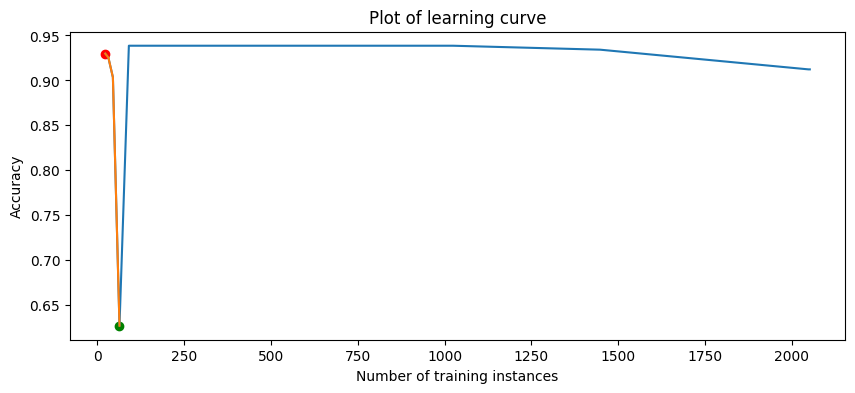

155it [06:09,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1488;non-monotonic:True


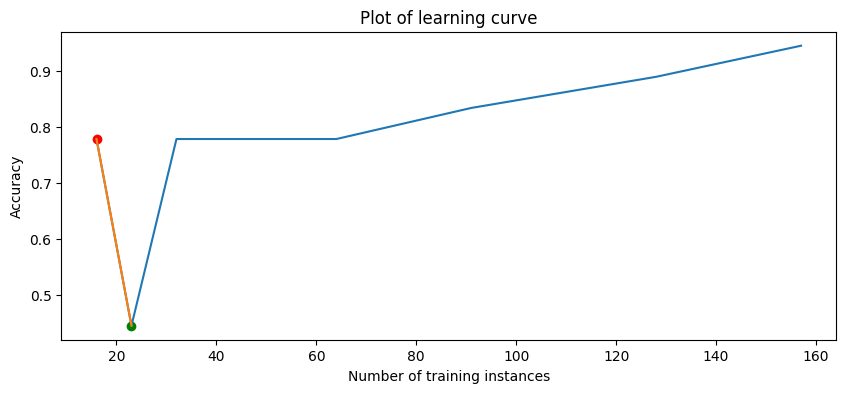

156it [06:12,  2.45s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1489;non-monotonic:True


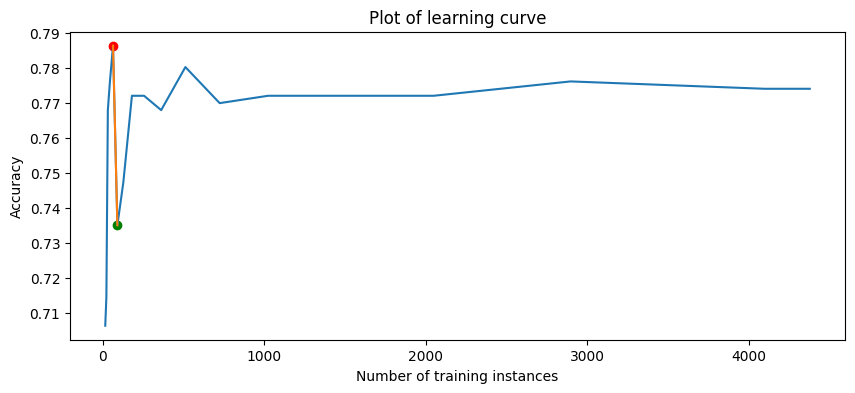

157it [06:14,  2.40s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1494;non-monotonic:True


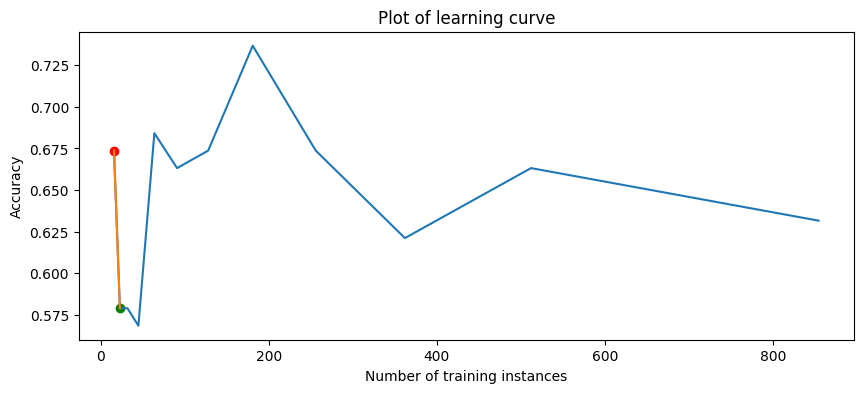

158it [06:16,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1499;non-monotonic:False


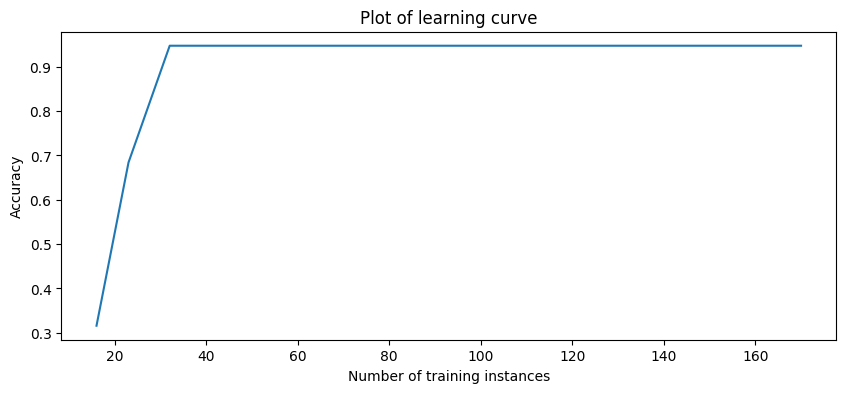

159it [06:18,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1503;non-monotonic:True


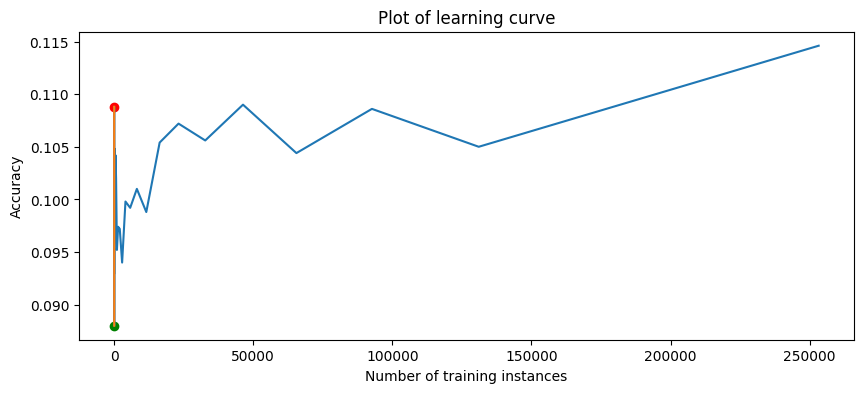

160it [06:20,  2.28s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1509;non-monotonic:True


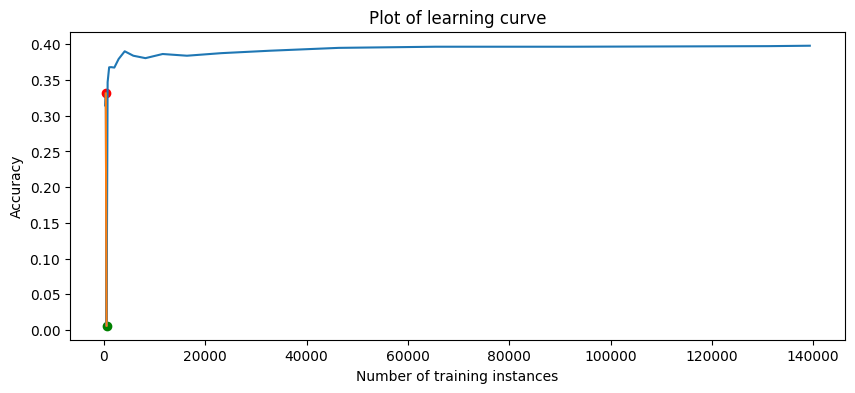

161it [06:23,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1515;non-monotonic:True


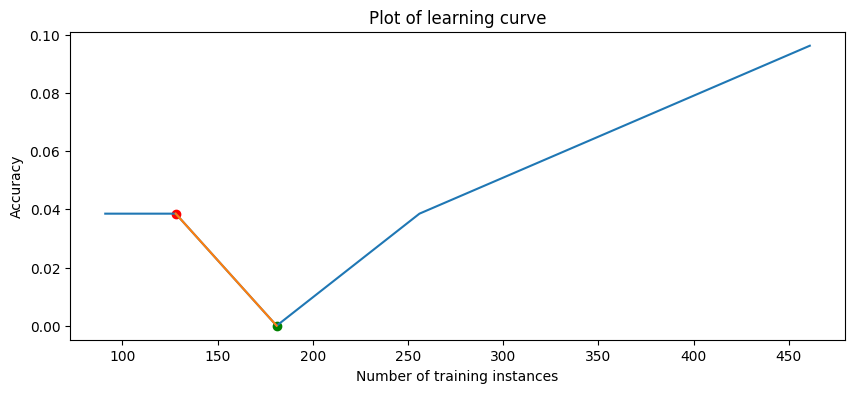

162it [06:25,  2.25s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1566;non-monotonic:True


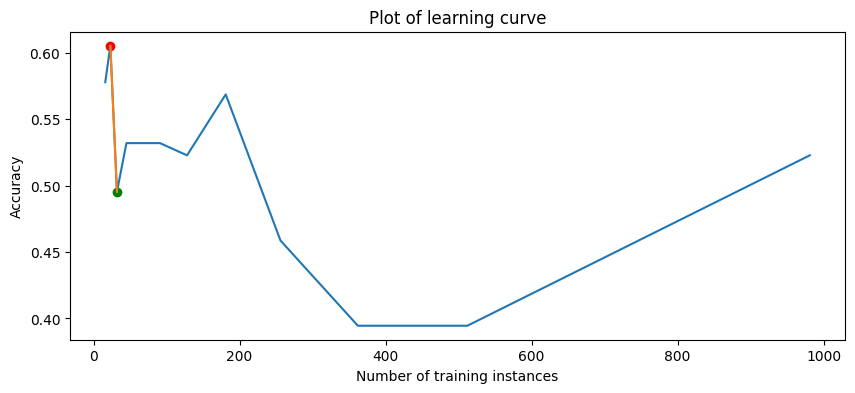

163it [06:27,  2.24s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1567;non-monotonic:True


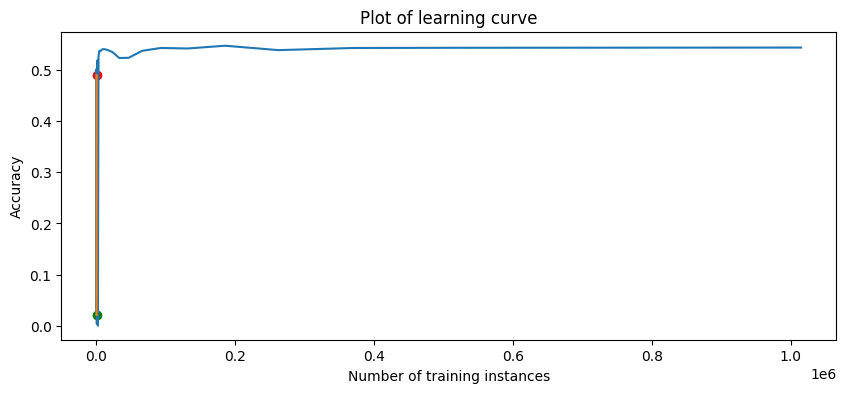

164it [06:29,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1575;non-monotonic:True


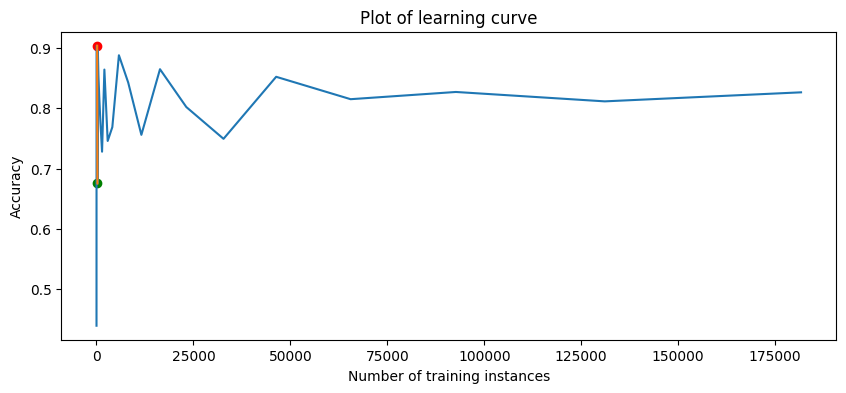

165it [06:32,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_1597;non-monotonic:True


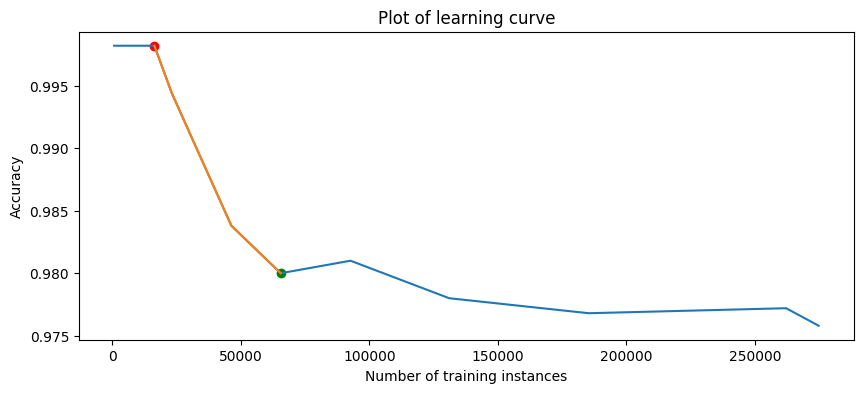

166it [06:34,  2.33s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_4134;non-monotonic:True


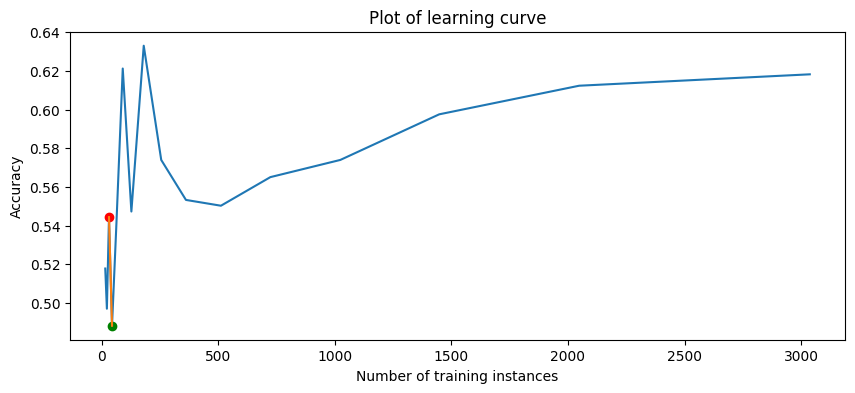

167it [06:36,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_4137;non-monotonic:True


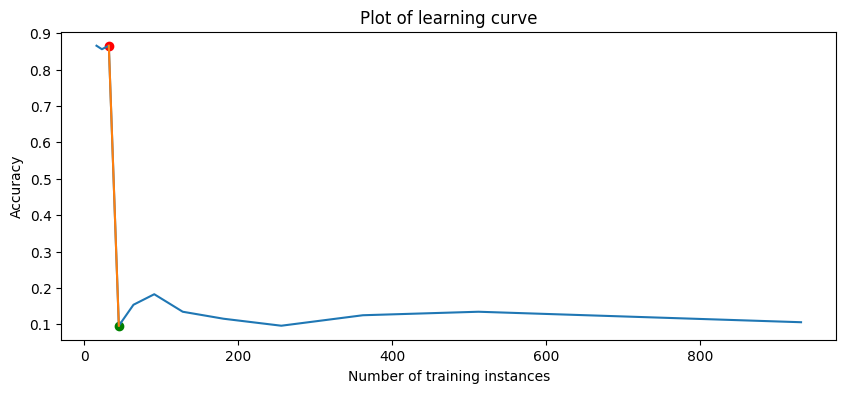

168it [06:39,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_4538;non-monotonic:True


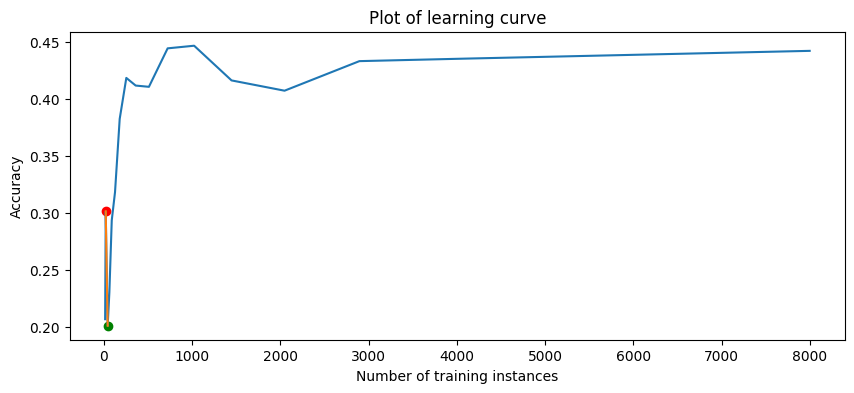

169it [06:41,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_23512;non-monotonic:True


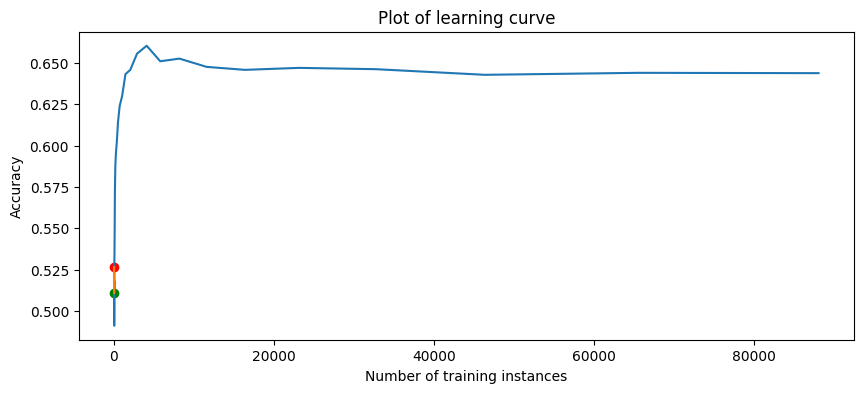

170it [06:43,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_23517;non-monotonic:True


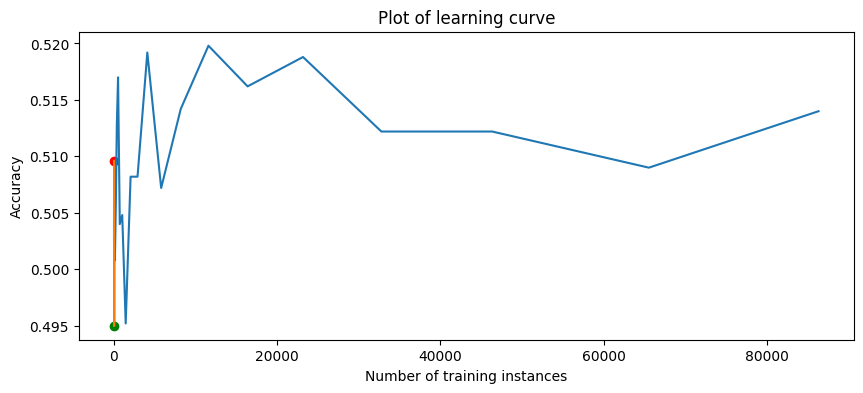

171it [06:45,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40498;non-monotonic:True


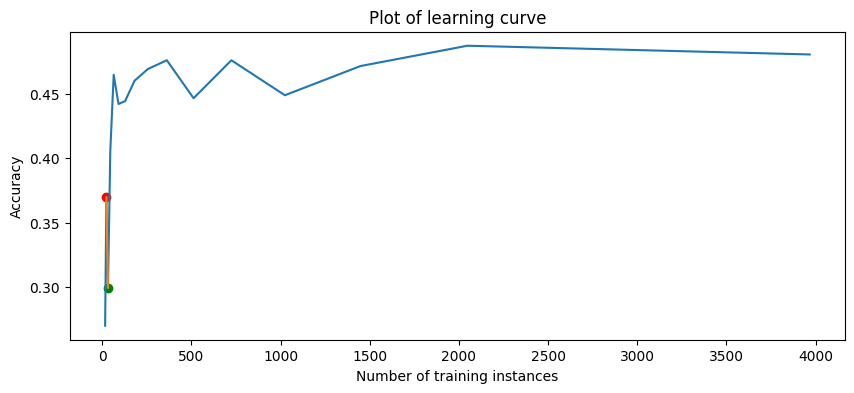

172it [06:48,  2.25s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40685;non-monotonic:True


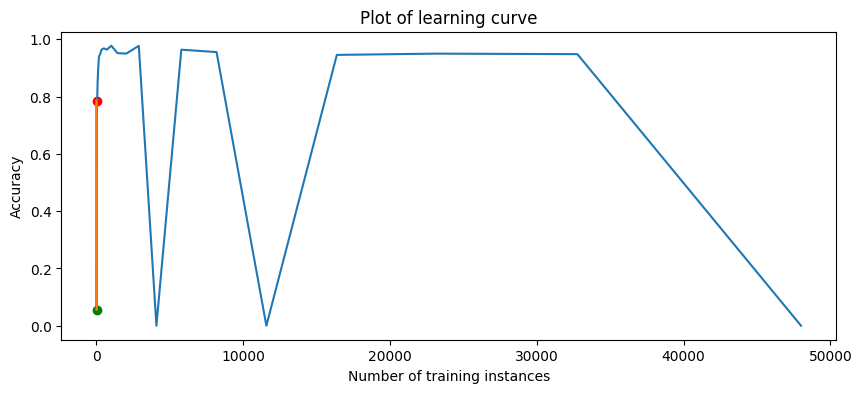

173it [06:50,  2.24s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40701;non-monotonic:True


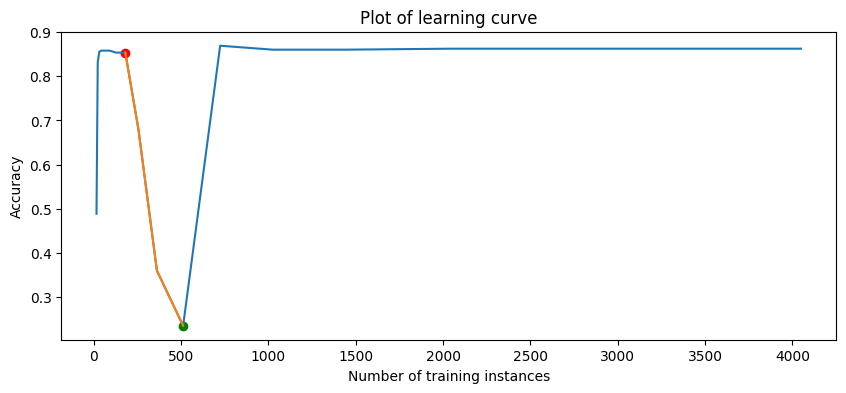

174it [06:52,  2.24s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40900;non-monotonic:True


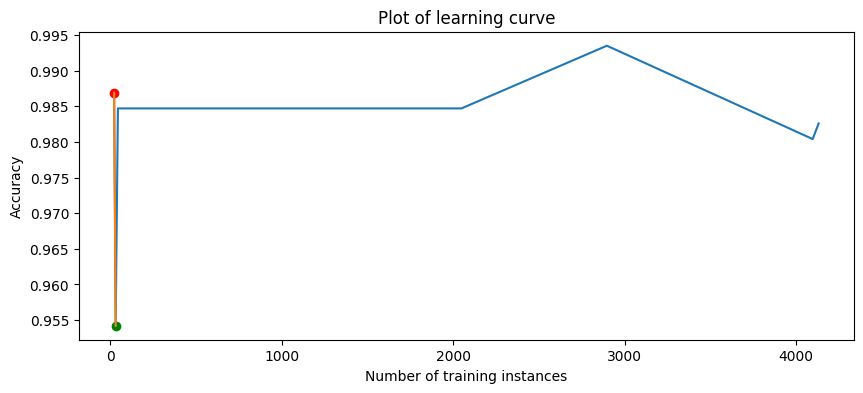

175it [06:54,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40910;non-monotonic:True


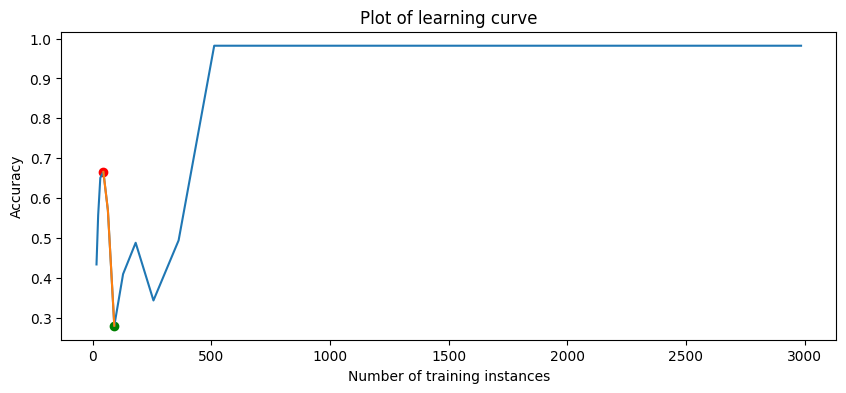

176it [06:57,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40971;non-monotonic:False


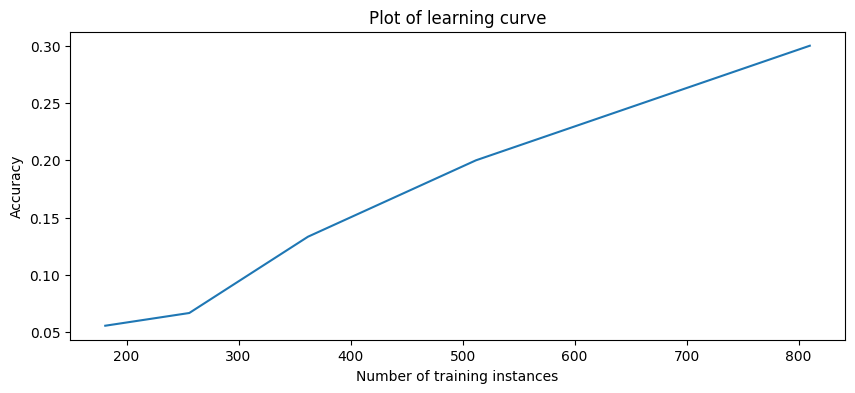

177it [06:59,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40975;non-monotonic:True


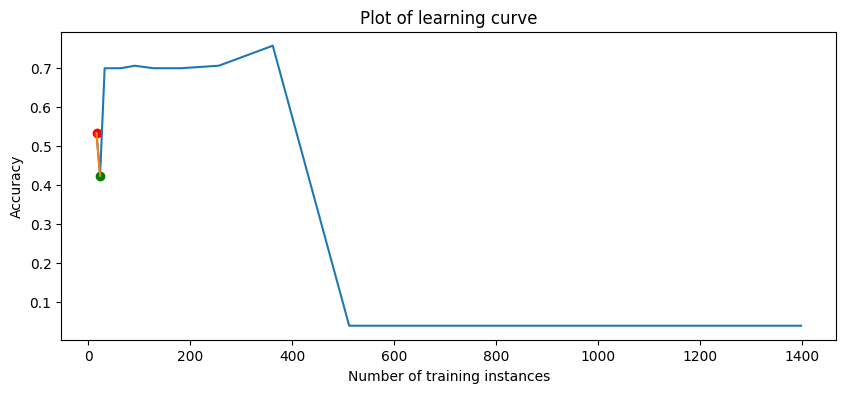

178it [07:01,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40981;non-monotonic:True


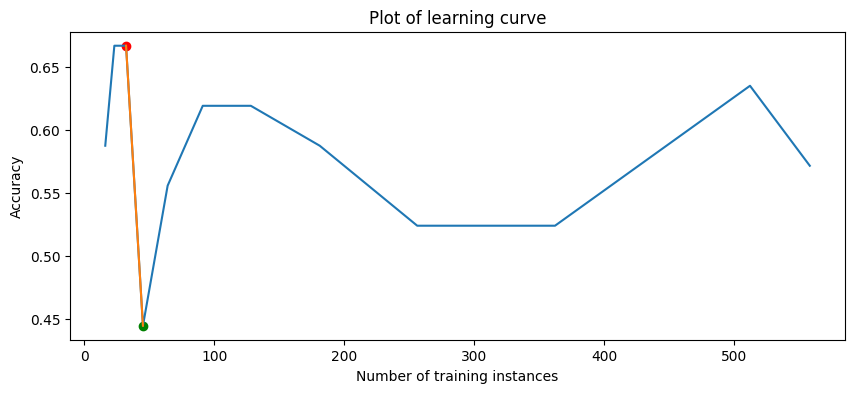

179it [07:04,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40982;non-monotonic:True


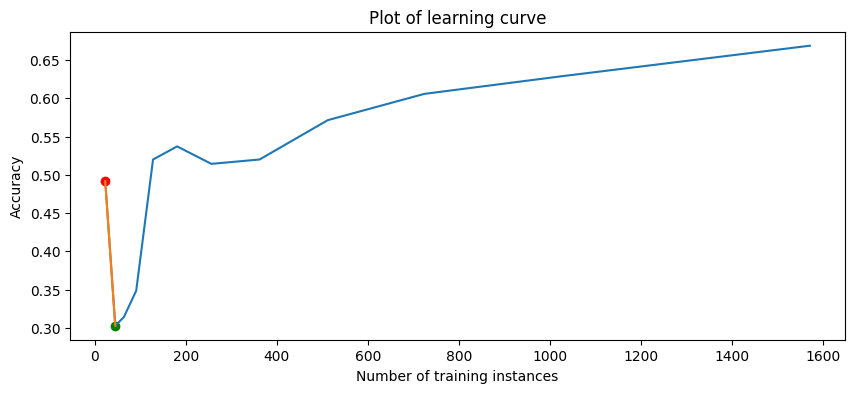

180it [07:06,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40983;non-monotonic:True


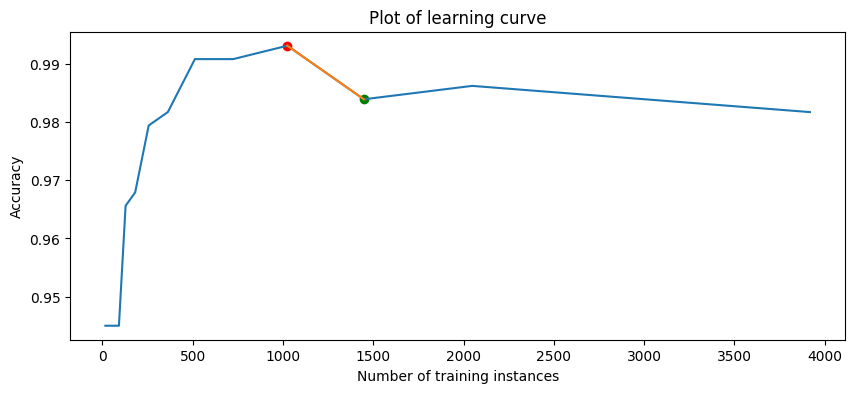

181it [07:08,  2.25s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40984;non-monotonic:True


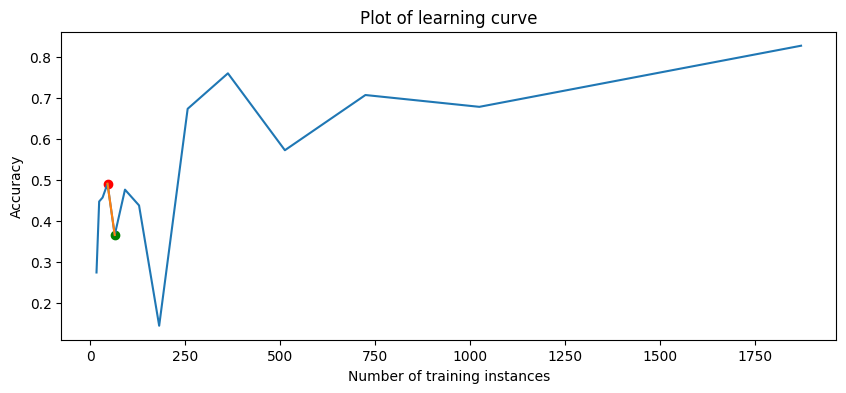

182it [07:10,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40994;non-monotonic:False


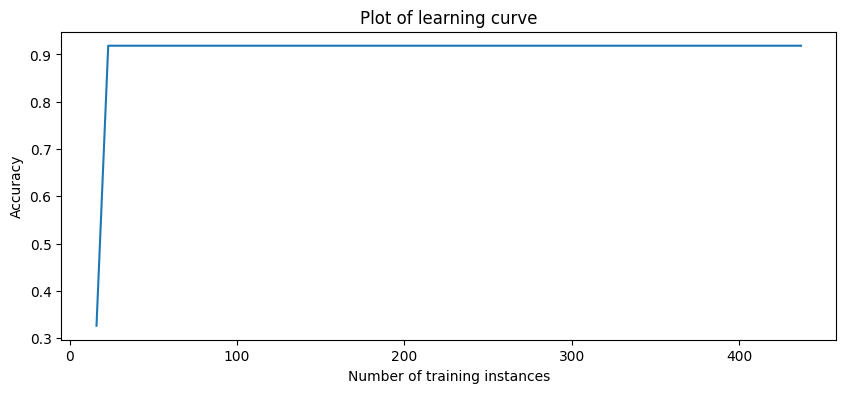

183it [07:13,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_40996;non-monotonic:True


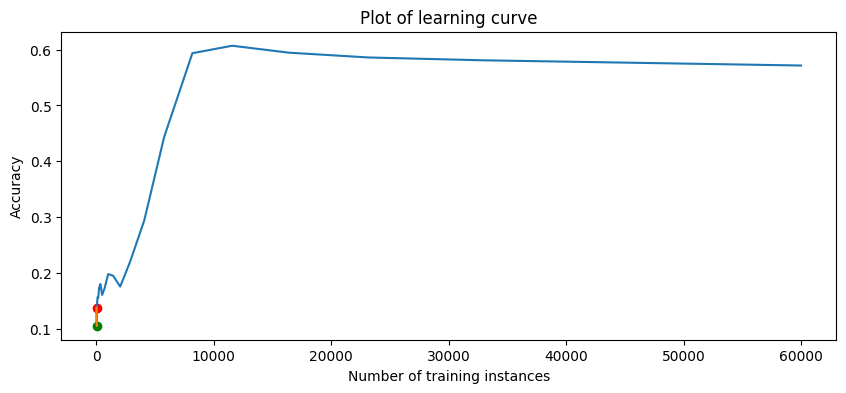

184it [07:15,  2.25s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41027;non-monotonic:True


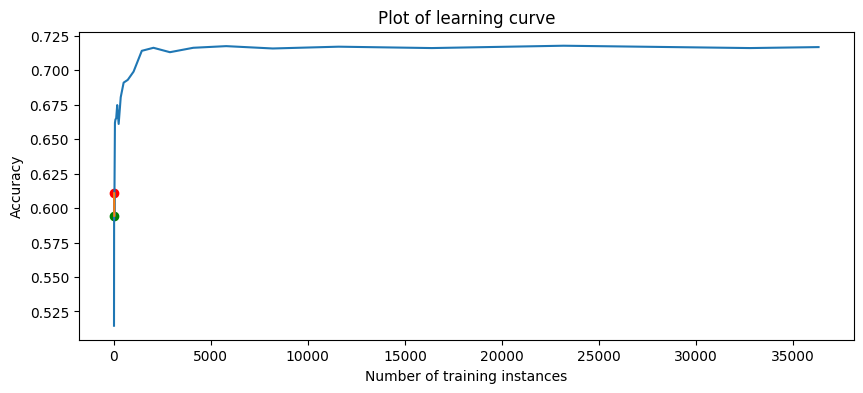

185it [07:17,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41142;non-monotonic:True


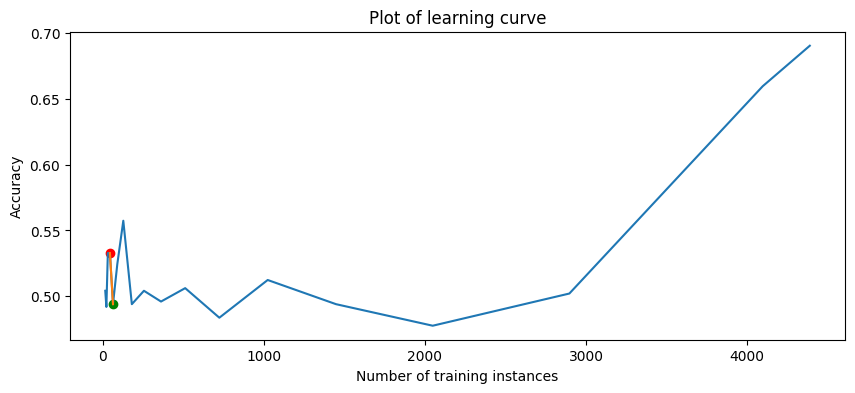

186it [07:20,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41144;non-monotonic:True


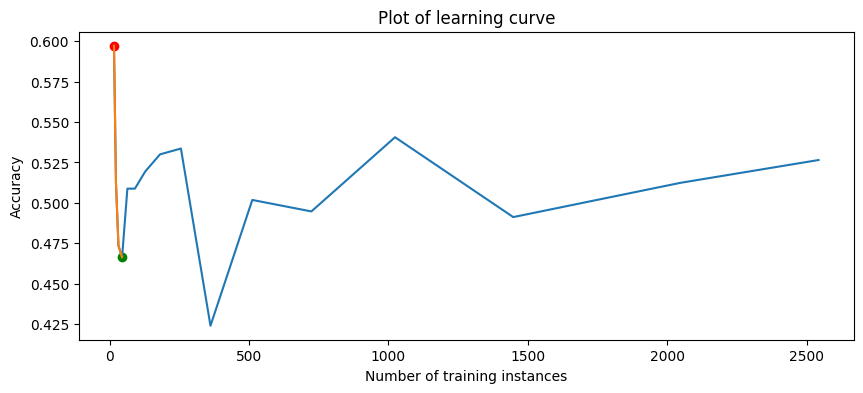

187it [07:22,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41145;non-monotonic:True


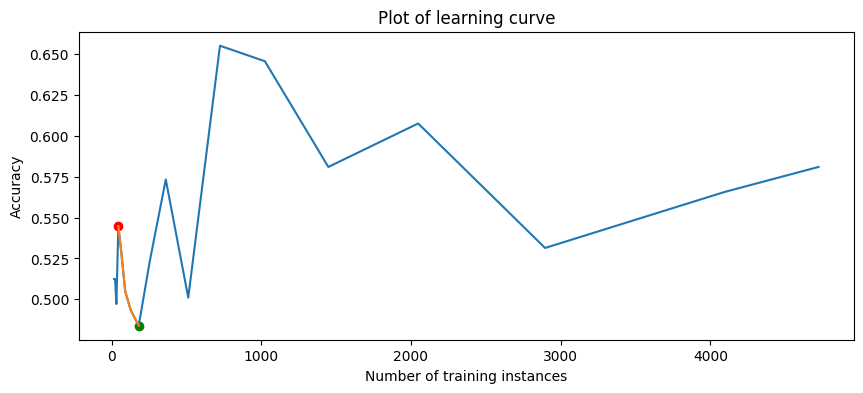

188it [07:24,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41146;non-monotonic:True


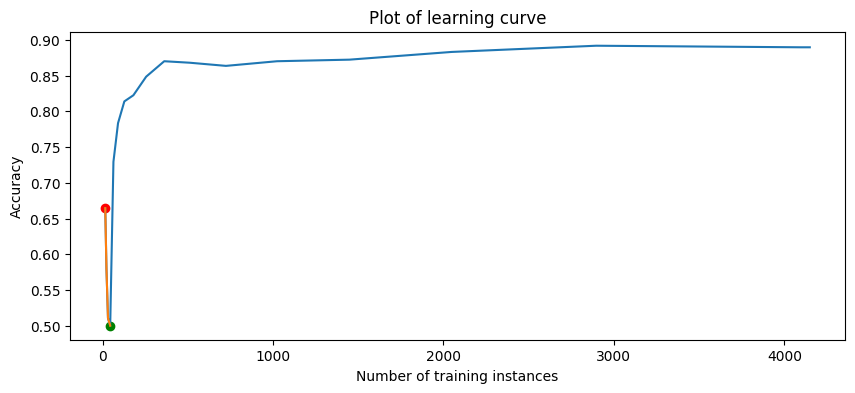

189it [07:26,  2.28s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41150;non-monotonic:True


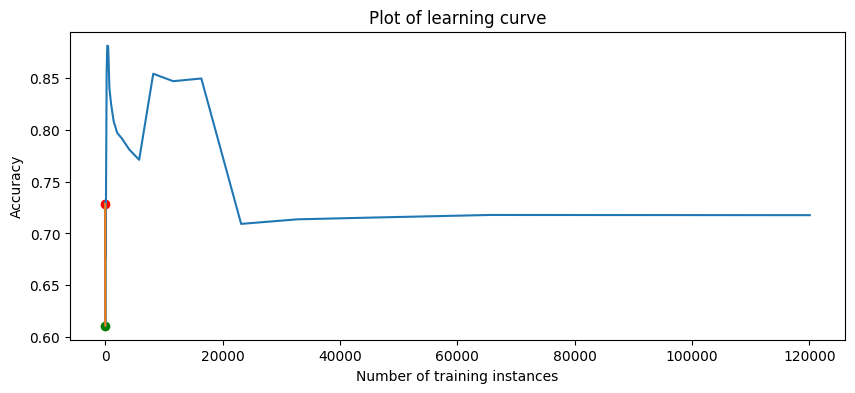

190it [07:29,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41156;non-monotonic:True


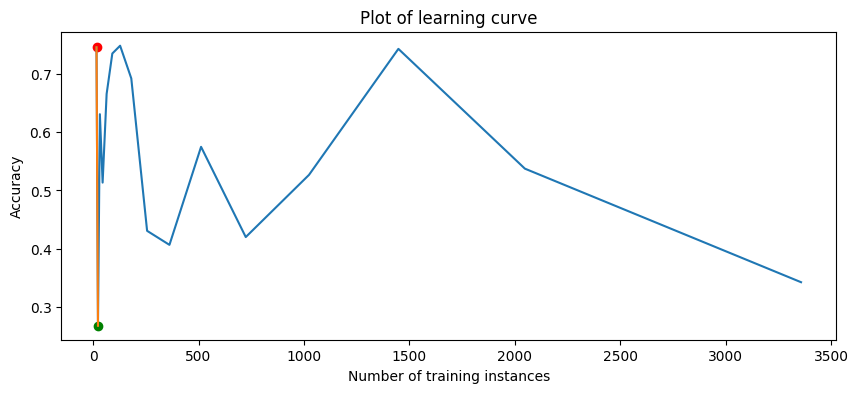

191it [07:31,  2.26s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41157;non-monotonic:True


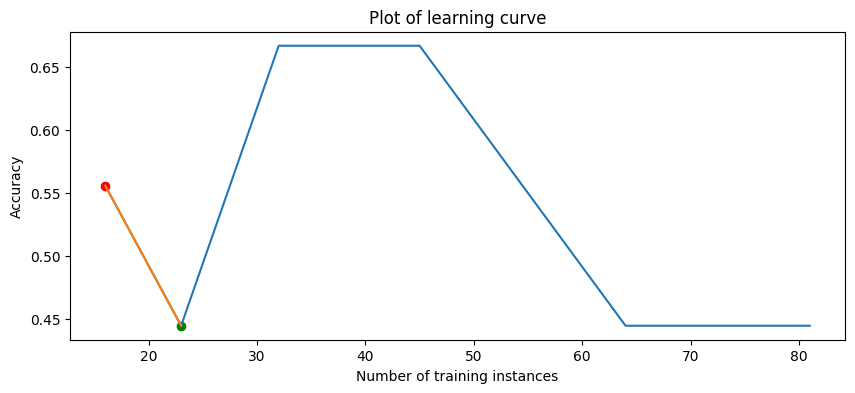

192it [07:33,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41158;non-monotonic:True


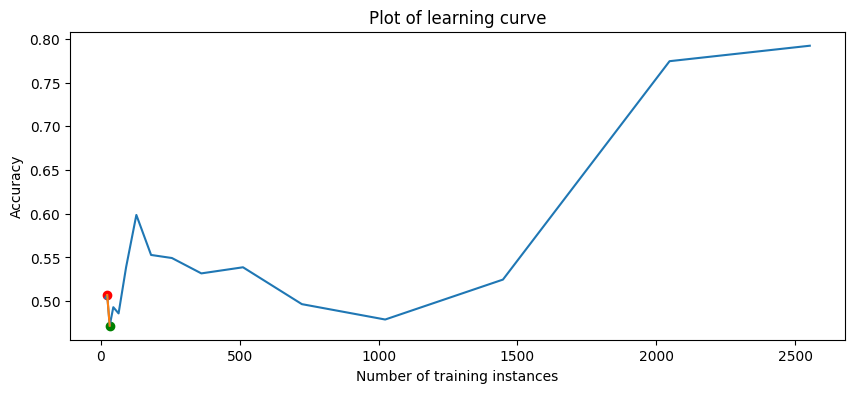

193it [07:36,  2.41s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41159;non-monotonic:True


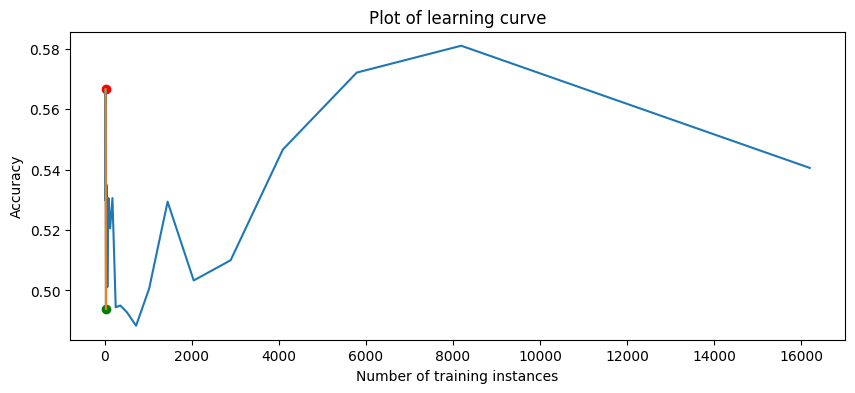

194it [07:38,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41161;non-monotonic:True


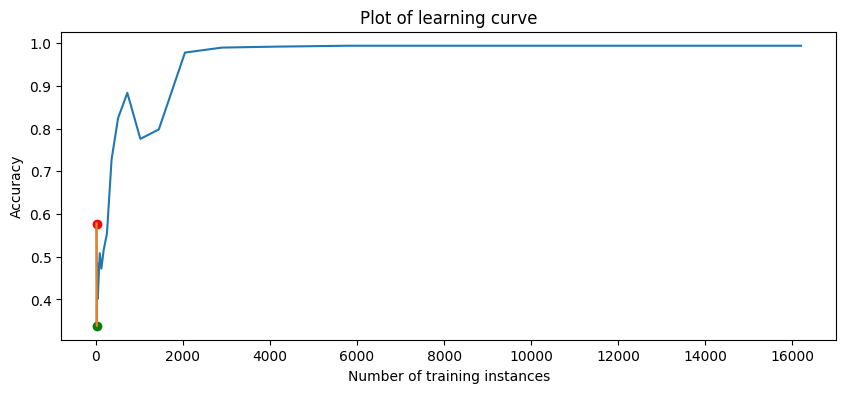

195it [07:41,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41163;non-monotonic:True


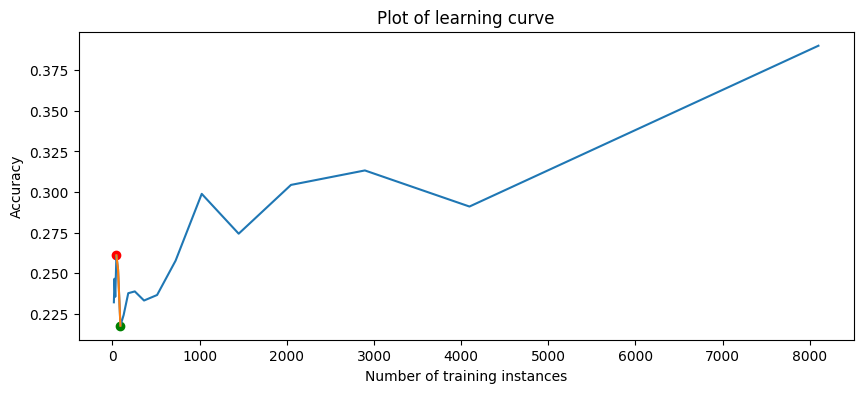

196it [07:43,  2.35s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41164;non-monotonic:True


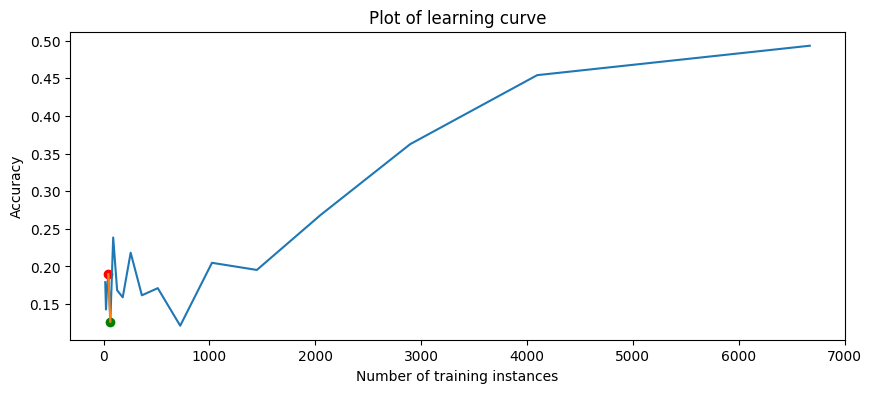

197it [07:45,  2.32s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41165;non-monotonic:True


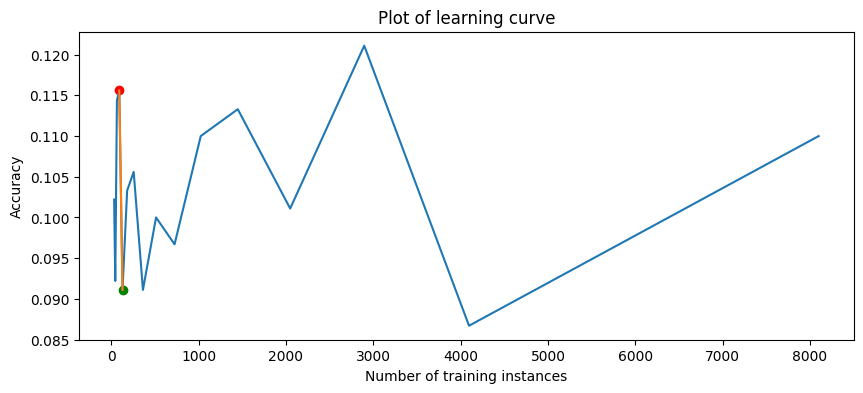

198it [07:47,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41166;non-monotonic:True


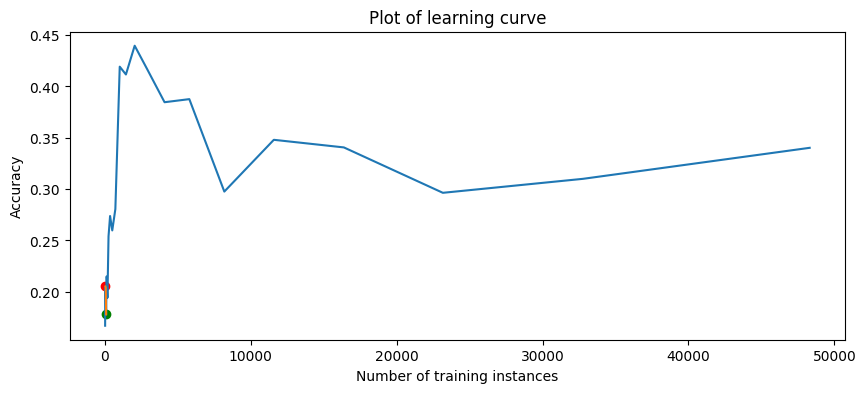

199it [07:50,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41168;non-monotonic:True


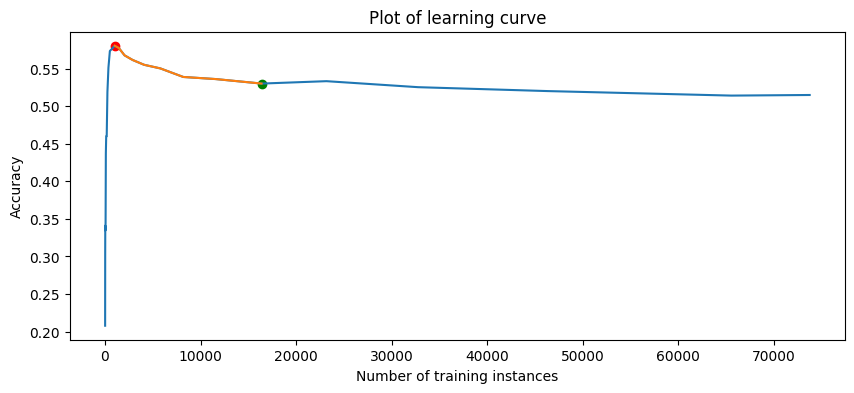

200it [07:52,  2.28s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41169;non-monotonic:False


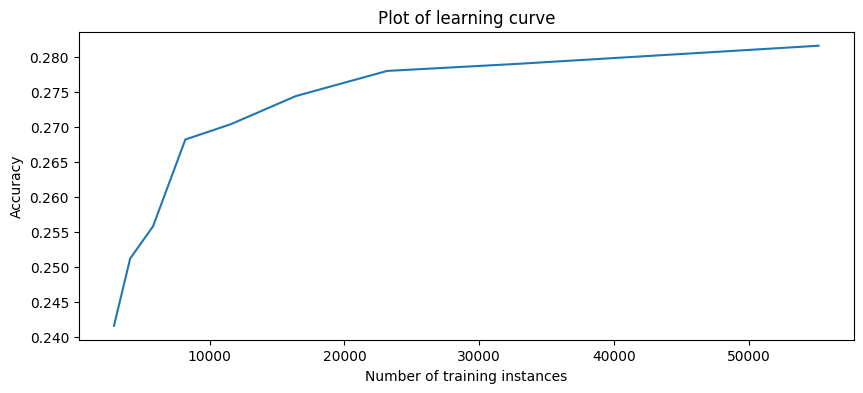

201it [07:54,  2.27s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41228;non-monotonic:True


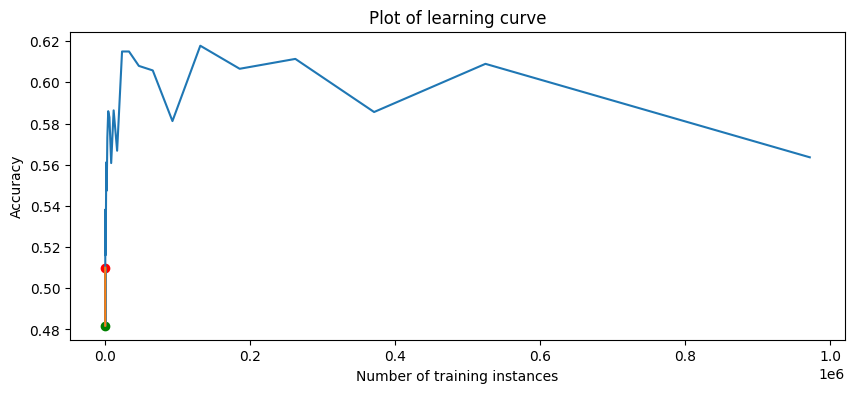

202it [07:57,  2.37s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_41972;non-monotonic:True


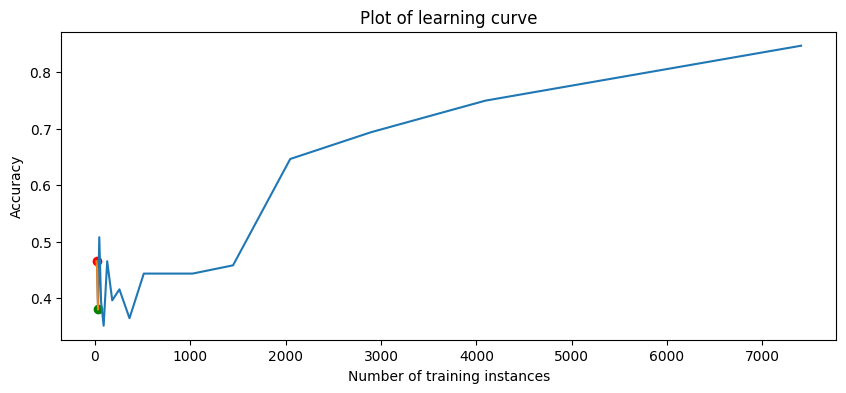

203it [07:59,  2.34s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_42769;non-monotonic:True


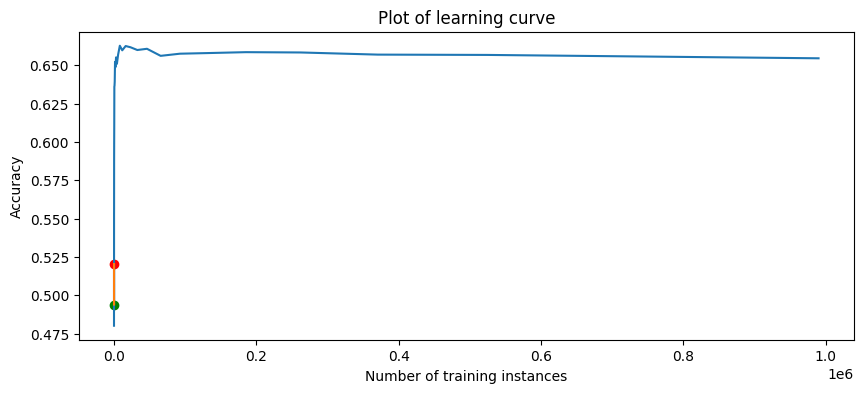

204it [08:01,  2.31s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_42809;non-monotonic:True


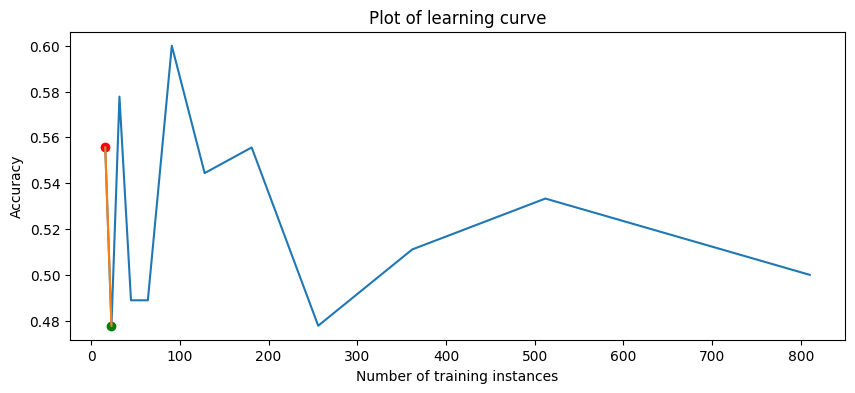

205it [08:04,  2.29s/it]

sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis_on_42810;non-monotonic:True


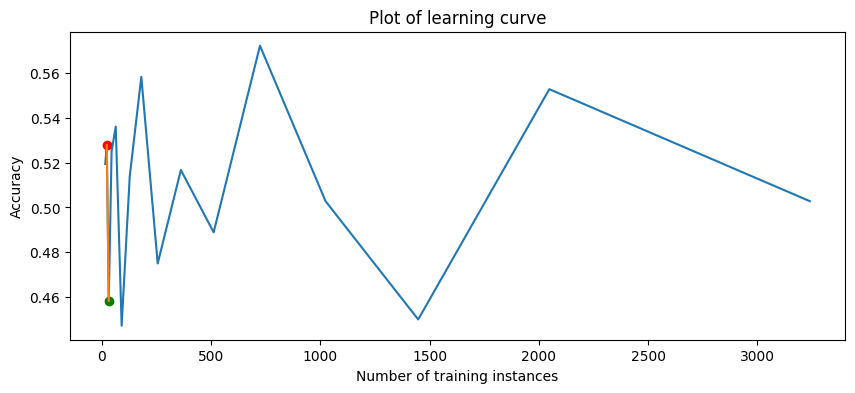

206it [08:06,  2.36s/it]
0it [00:00, ?it/s]

sklearn.linear_model.SGDClassifier_on_3;non-monotonic:True


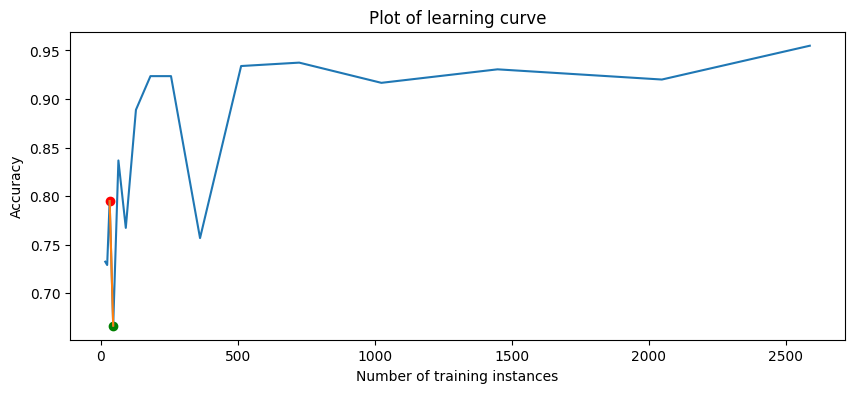

1it [00:02,  2.25s/it]

sklearn.linear_model.SGDClassifier_on_6;non-monotonic:True


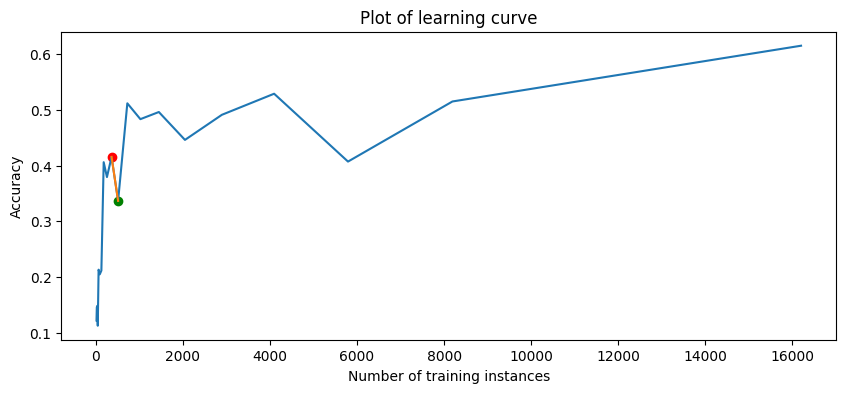

2it [00:04,  2.36s/it]

sklearn.linear_model.SGDClassifier_on_11;non-monotonic:True


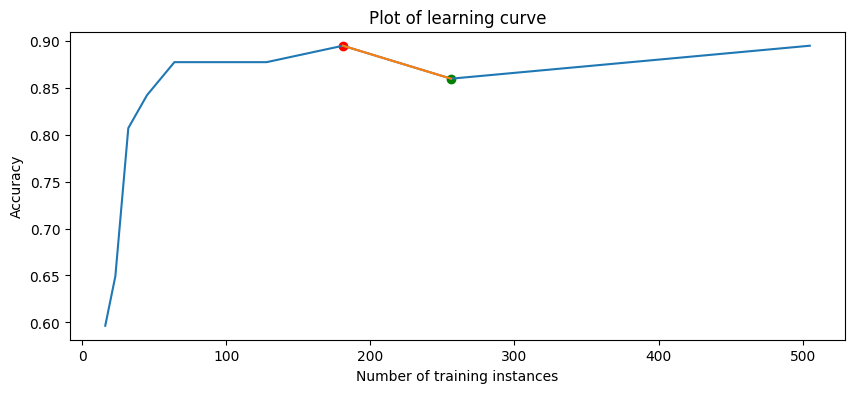

3it [00:06,  2.32s/it]

sklearn.linear_model.SGDClassifier_on_12;non-monotonic:True


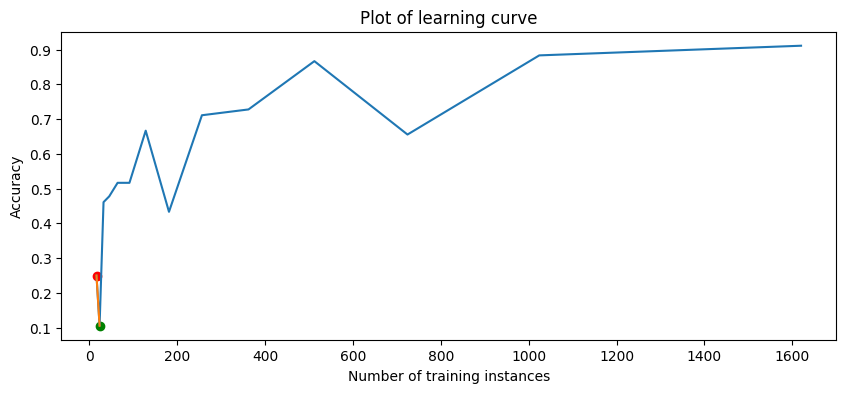

4it [00:09,  2.31s/it]

sklearn.linear_model.SGDClassifier_on_13;non-monotonic:True


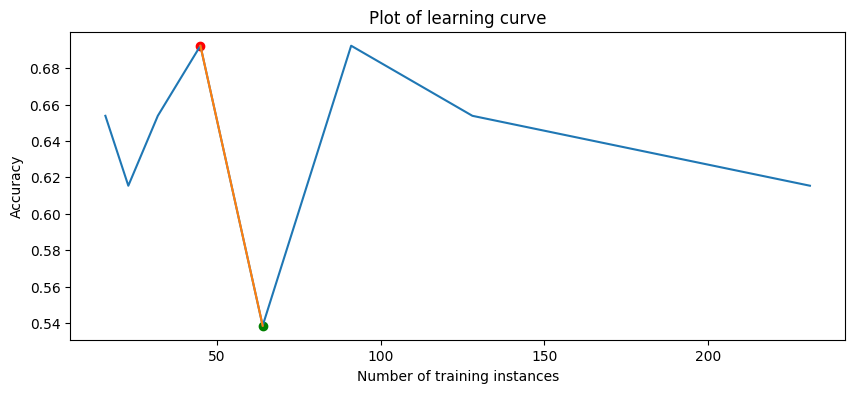

5it [00:11,  2.38s/it]

sklearn.linear_model.SGDClassifier_on_14;non-monotonic:True


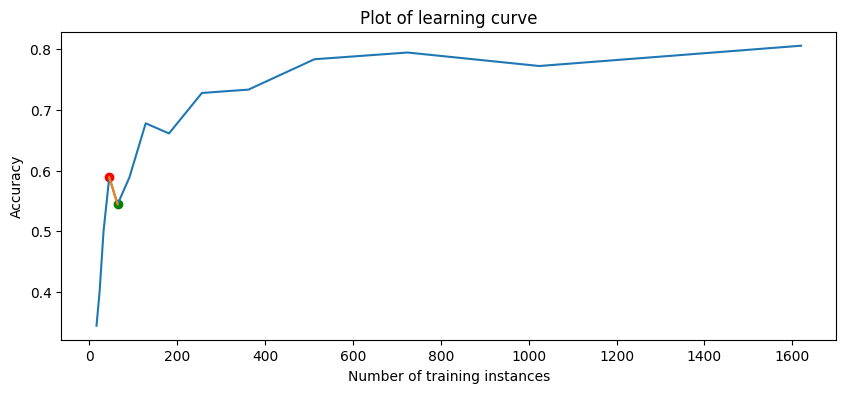

6it [00:14,  2.35s/it]

sklearn.linear_model.SGDClassifier_on_16;non-monotonic:False


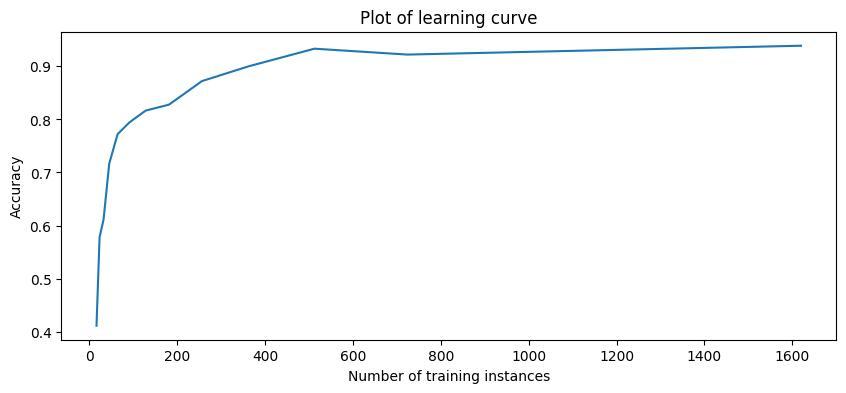

7it [00:16,  2.33s/it]

sklearn.linear_model.SGDClassifier_on_18;non-monotonic:True


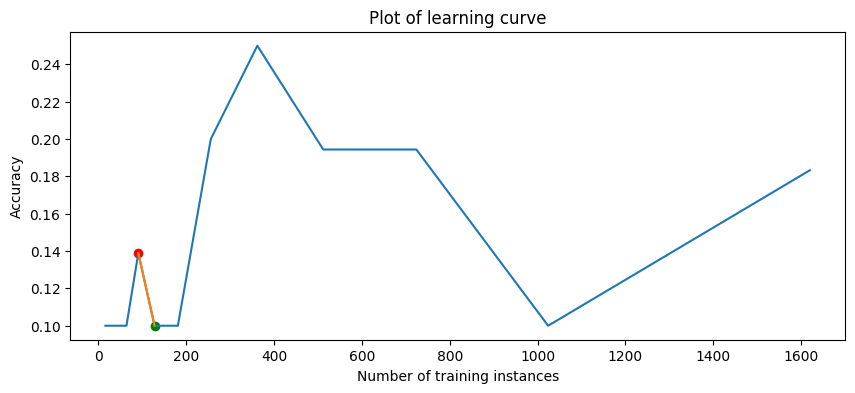

8it [00:18,  2.32s/it]

sklearn.linear_model.SGDClassifier_on_21;non-monotonic:True


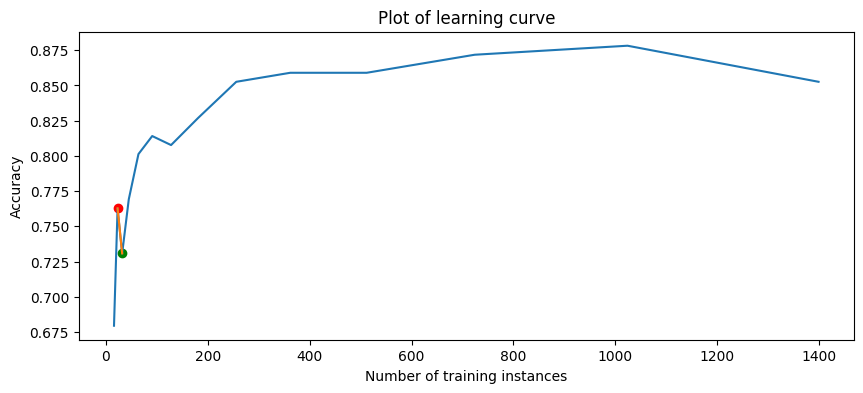

9it [00:20,  2.29s/it]

sklearn.linear_model.SGDClassifier_on_22;non-monotonic:True


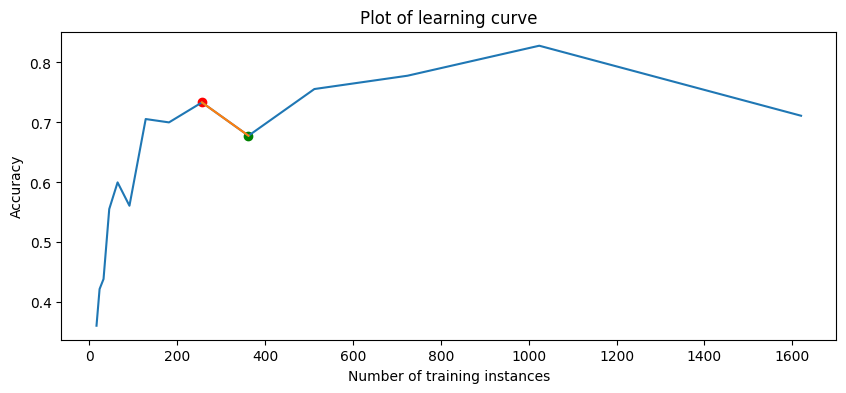

10it [00:23,  2.28s/it]

sklearn.linear_model.SGDClassifier_on_23;non-monotonic:True


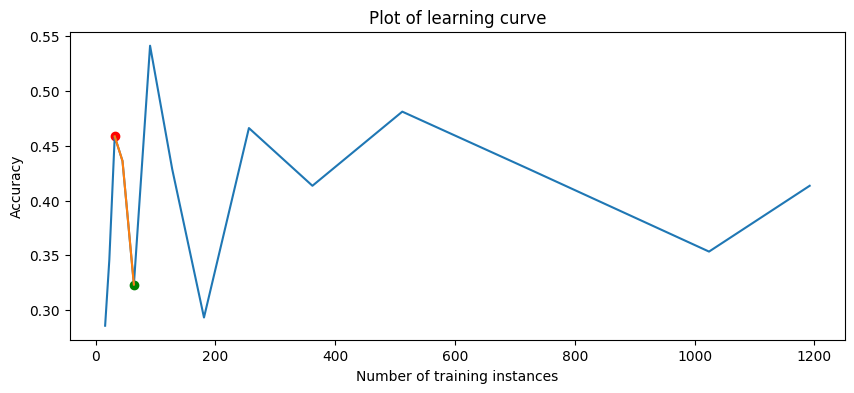

11it [00:25,  2.29s/it]

sklearn.linear_model.SGDClassifier_on_24;non-monotonic:True


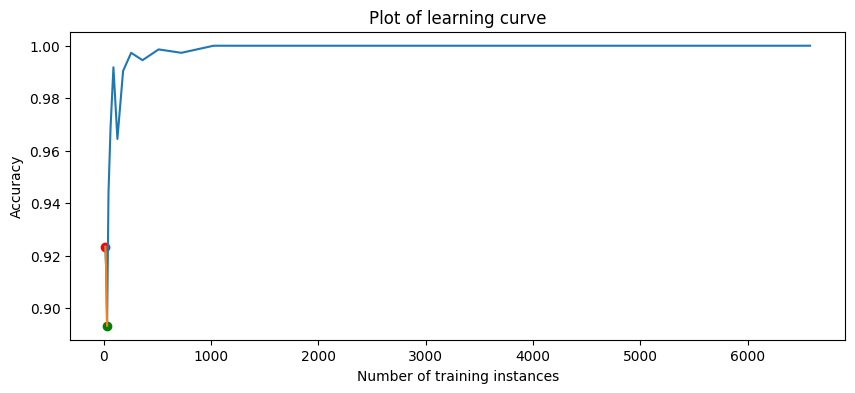

12it [00:27,  2.34s/it]

sklearn.linear_model.SGDClassifier_on_26;non-monotonic:True


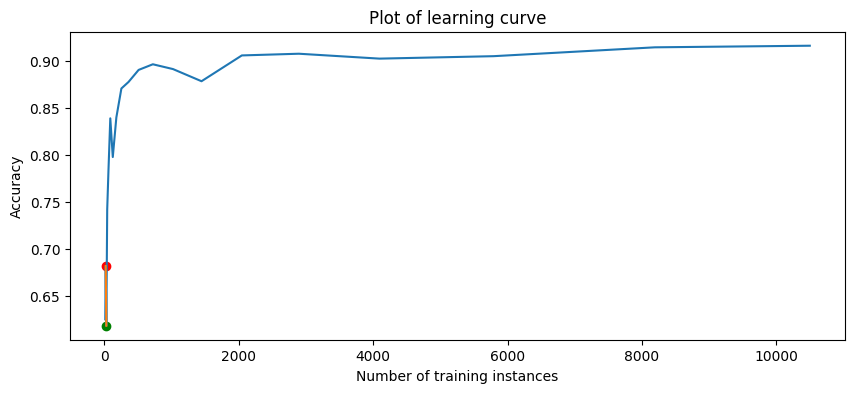

13it [00:30,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_28;non-monotonic:False


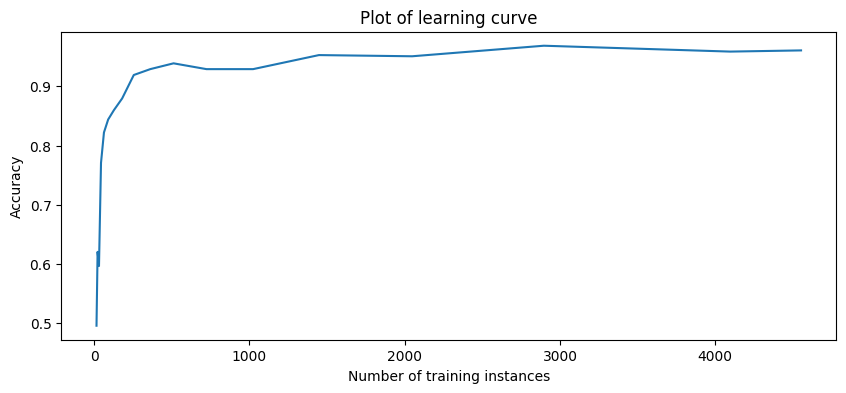

14it [00:32,  2.35s/it]

sklearn.linear_model.SGDClassifier_on_30;non-monotonic:True


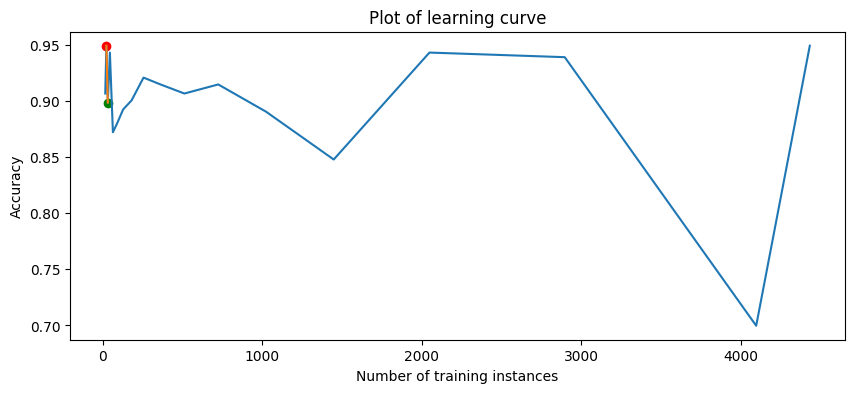

15it [00:34,  2.31s/it]

sklearn.linear_model.SGDClassifier_on_31;non-monotonic:True


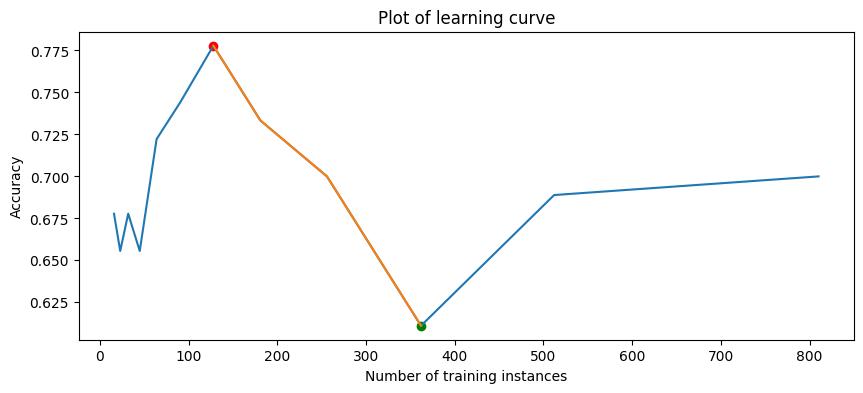

16it [00:37,  2.30s/it]

sklearn.linear_model.SGDClassifier_on_32;non-monotonic:True


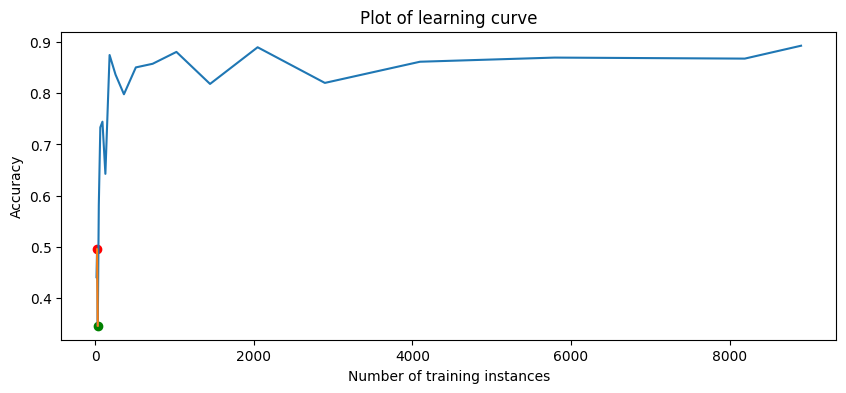

17it [00:39,  2.30s/it]

sklearn.linear_model.SGDClassifier_on_36;non-monotonic:True


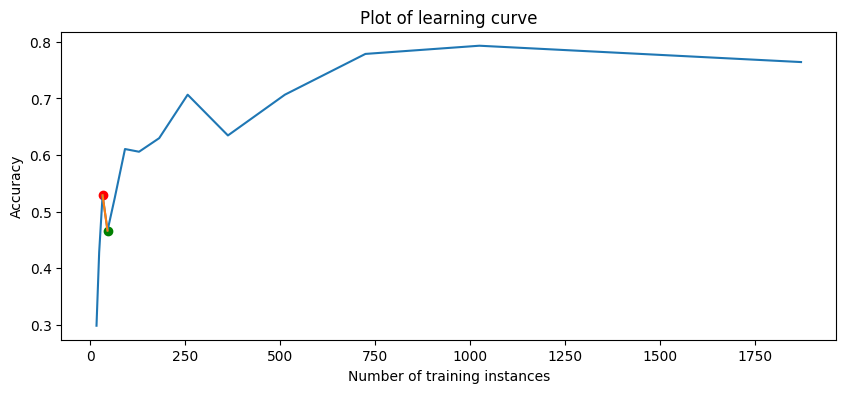

18it [00:41,  2.28s/it]

sklearn.linear_model.SGDClassifier_on_38;non-monotonic:True


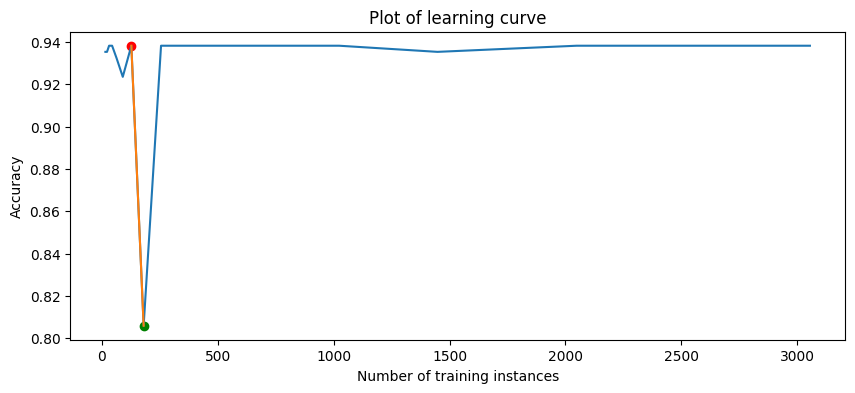

19it [00:43,  2.28s/it]

sklearn.linear_model.SGDClassifier_on_44;non-monotonic:True


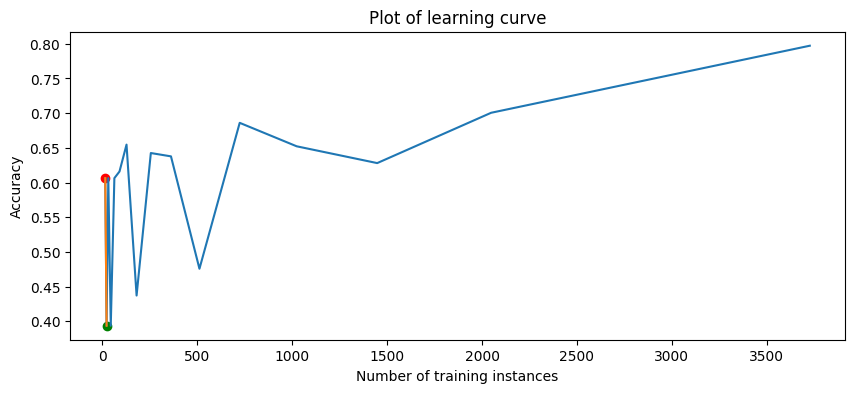

20it [00:46,  2.27s/it]

sklearn.linear_model.SGDClassifier_on_46;non-monotonic:True


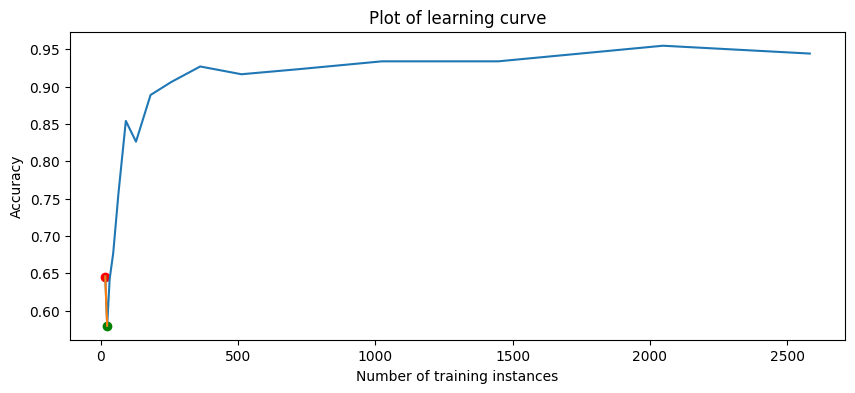

21it [00:49,  2.46s/it]

sklearn.linear_model.SGDClassifier_on_54;non-monotonic:True


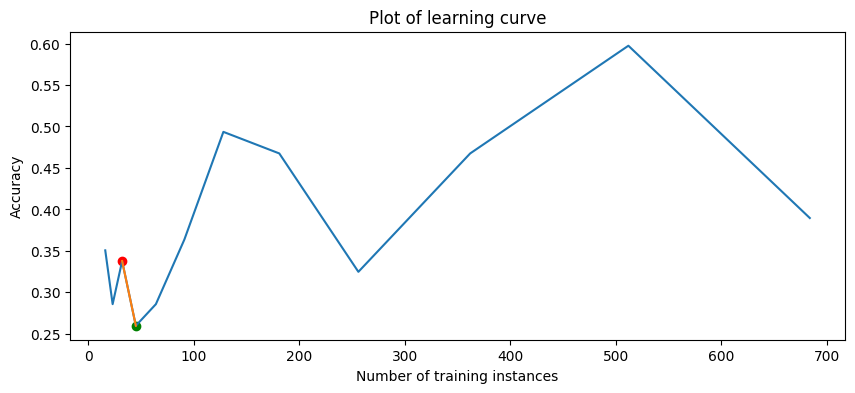

22it [00:52,  2.65s/it]

sklearn.linear_model.SGDClassifier_on_55;non-monotonic:True


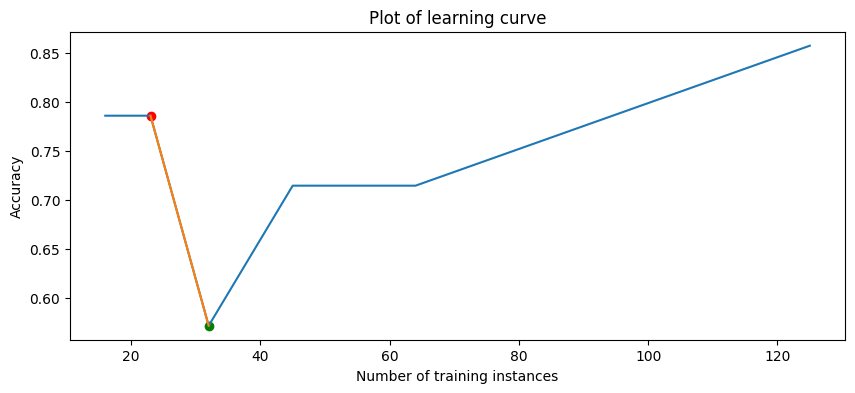

23it [00:55,  2.70s/it]

sklearn.linear_model.SGDClassifier_on_57;non-monotonic:True


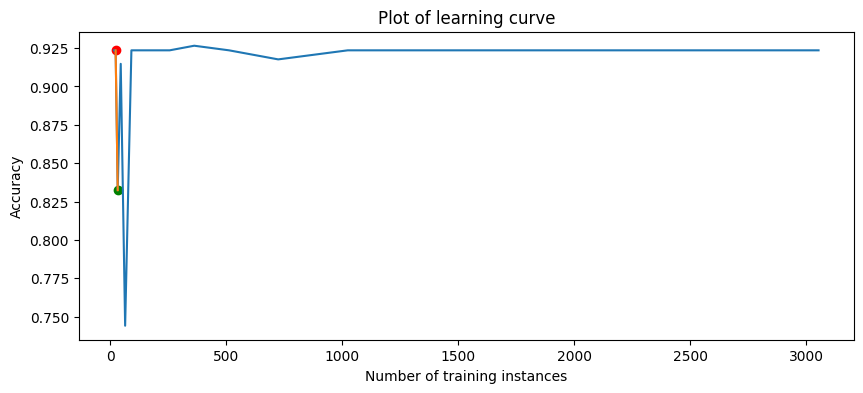

24it [00:57,  2.68s/it]

sklearn.linear_model.SGDClassifier_on_60;non-monotonic:True


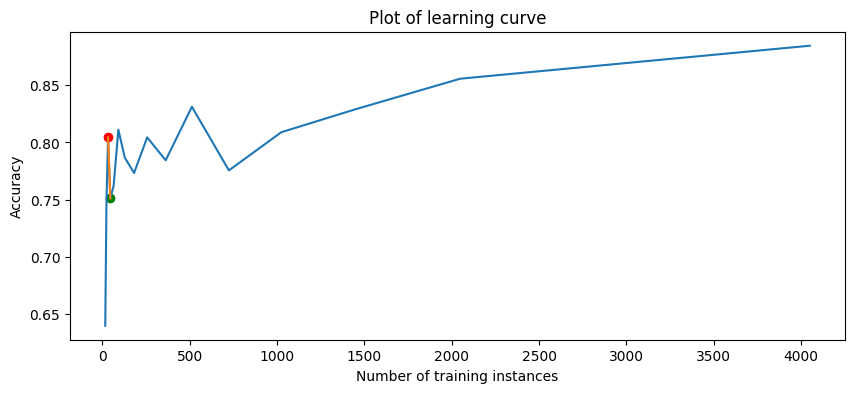

25it [01:00,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_61;non-monotonic:True


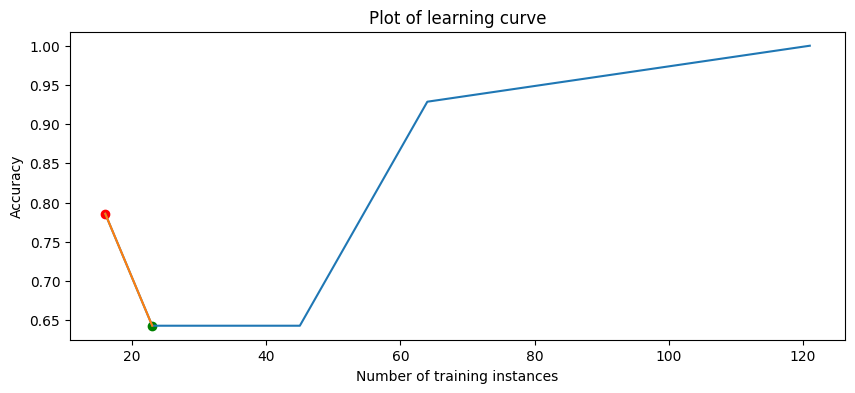

26it [01:03,  2.69s/it]

sklearn.linear_model.SGDClassifier_on_179;non-monotonic:True


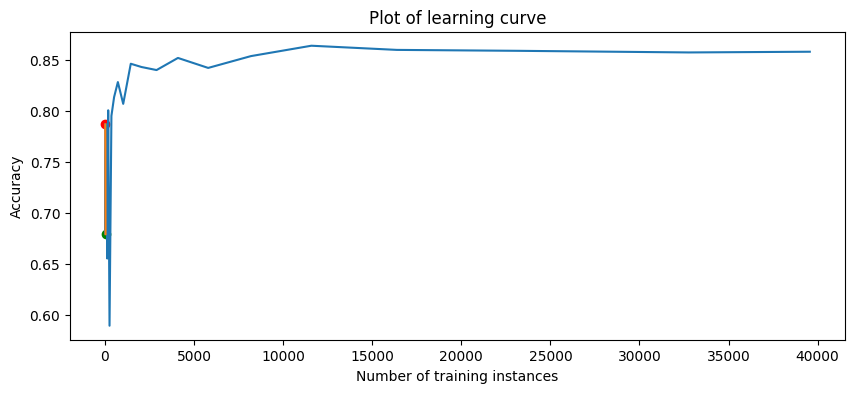

27it [01:05,  2.69s/it]

sklearn.linear_model.SGDClassifier_on_180;non-monotonic:True


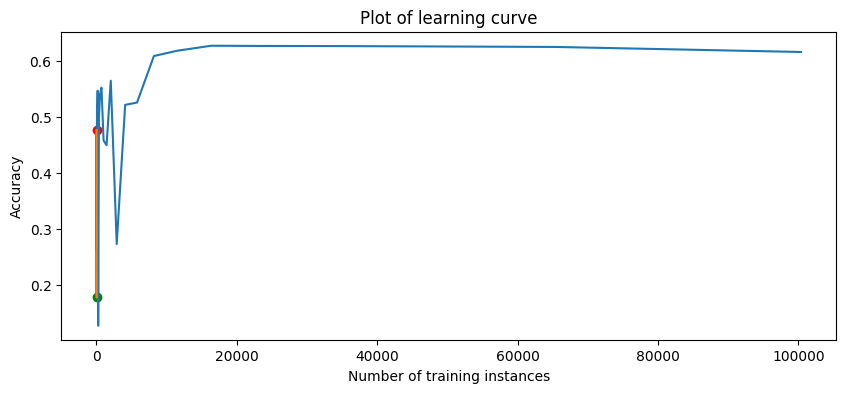

28it [01:08,  2.66s/it]

sklearn.linear_model.SGDClassifier_on_181;non-monotonic:True


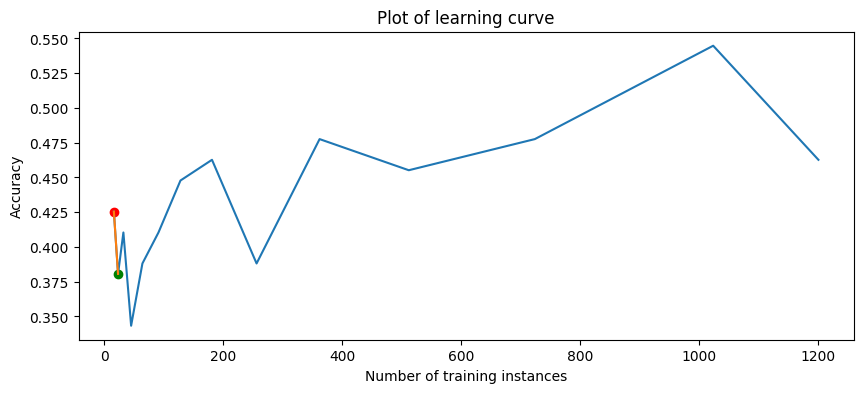

29it [01:11,  2.77s/it]

sklearn.linear_model.SGDClassifier_on_182;non-monotonic:True


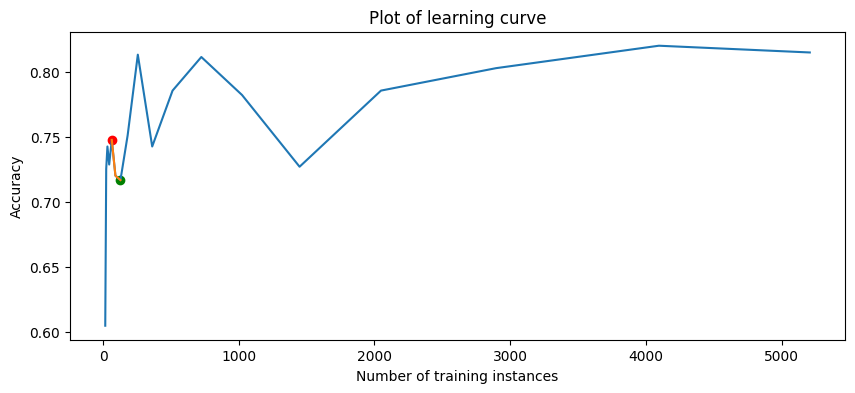

30it [01:14,  2.78s/it]

sklearn.linear_model.SGDClassifier_on_184;non-monotonic:True


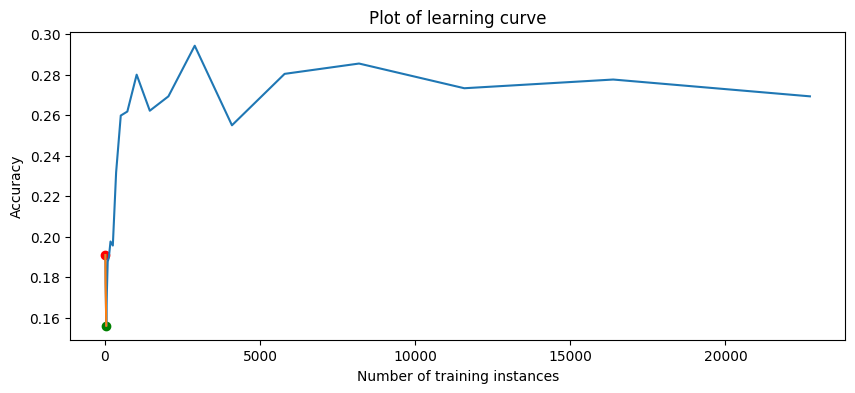

31it [01:16,  2.72s/it]

sklearn.linear_model.SGDClassifier_on_185;non-monotonic:True


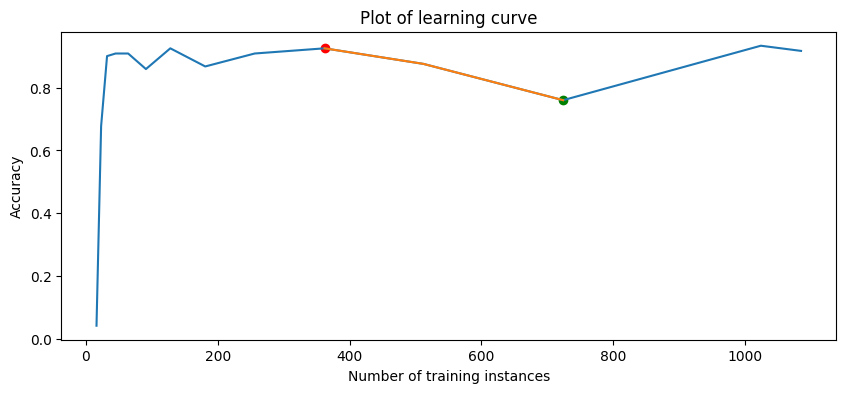

32it [01:19,  2.77s/it]

sklearn.linear_model.SGDClassifier_on_188;non-monotonic:True


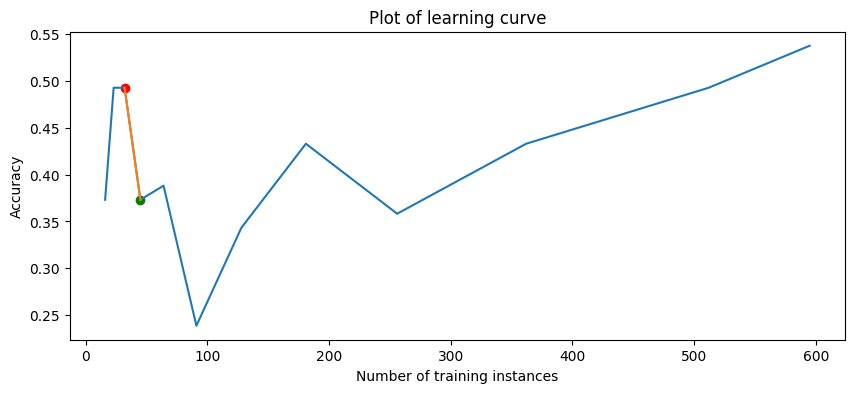

33it [01:22,  2.90s/it]

sklearn.linear_model.SGDClassifier_on_201;non-monotonic:True


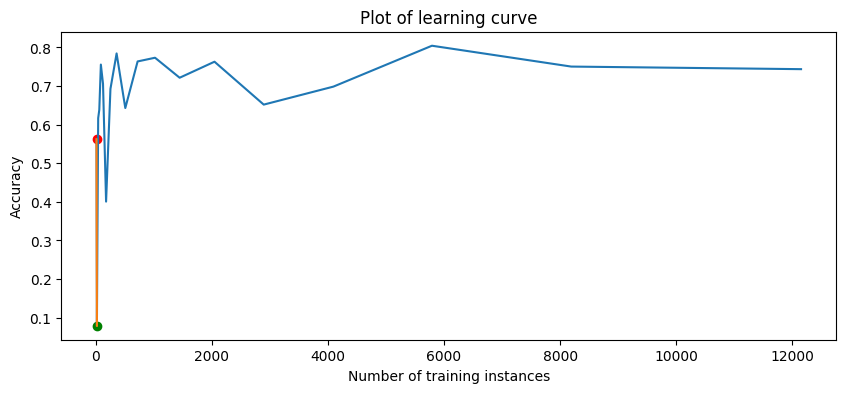

34it [01:25,  2.76s/it]

sklearn.linear_model.SGDClassifier_on_273;non-monotonic:True


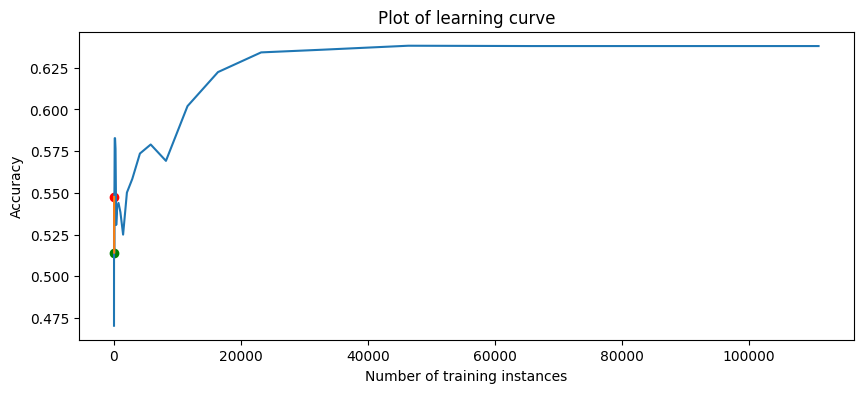

35it [01:27,  2.71s/it]

sklearn.linear_model.SGDClassifier_on_293;non-monotonic:True


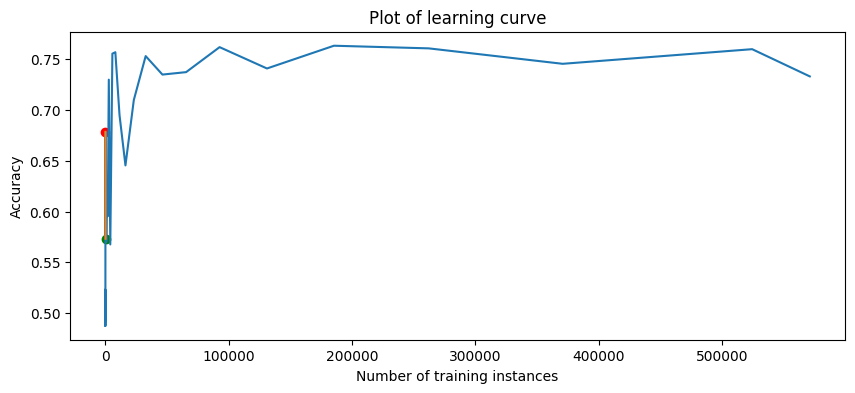

36it [01:30,  2.72s/it]

sklearn.linear_model.SGDClassifier_on_299;non-monotonic:True


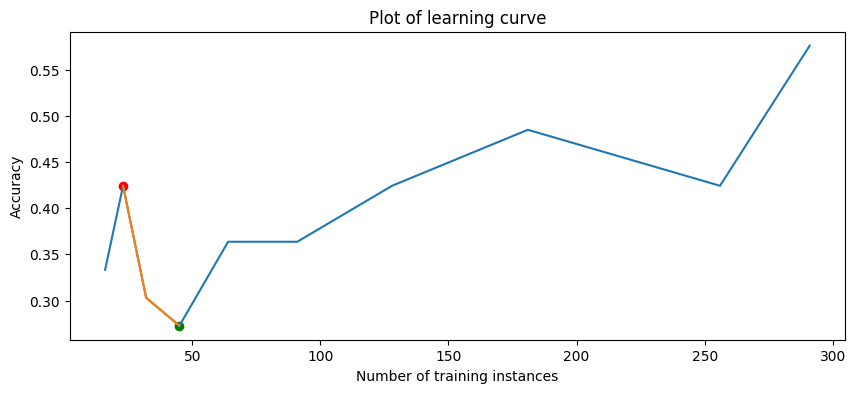

37it [01:33,  2.79s/it]

sklearn.linear_model.SGDClassifier_on_300;non-monotonic:False


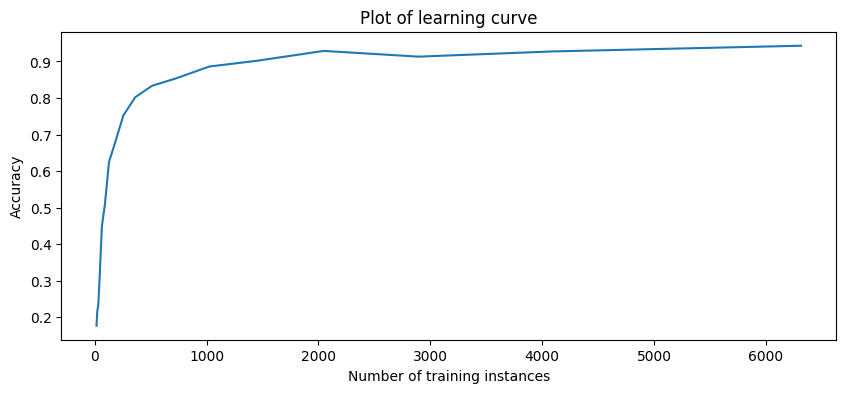

38it [01:36,  2.88s/it]

sklearn.linear_model.SGDClassifier_on_336;non-monotonic:True


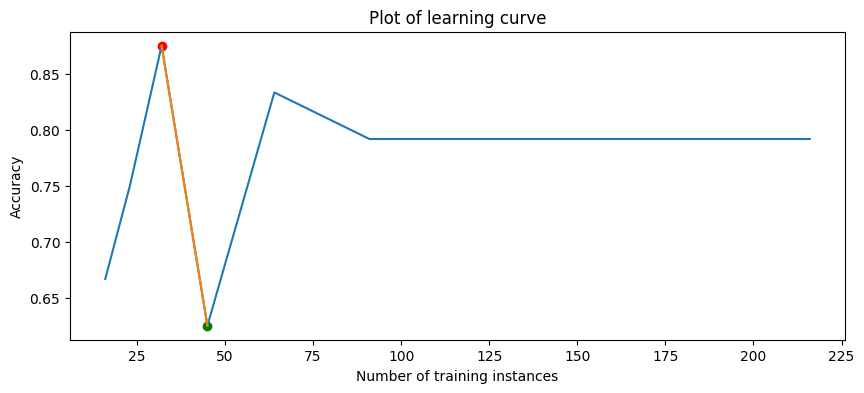

39it [01:39,  2.90s/it]

sklearn.linear_model.SGDClassifier_on_346;non-monotonic:False


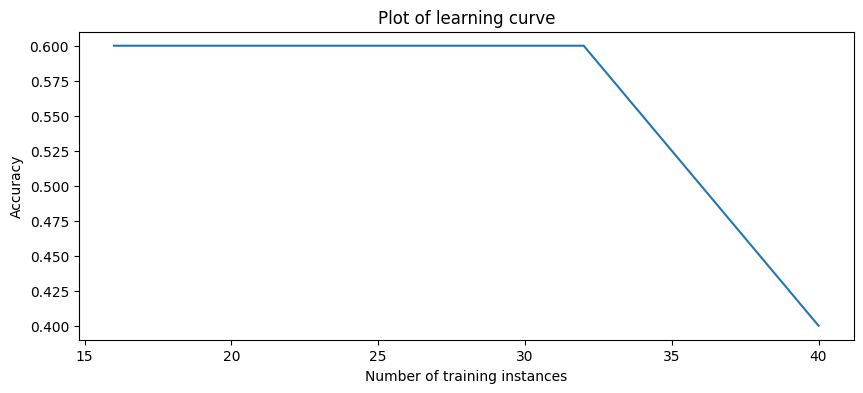

40it [01:42,  2.92s/it]

sklearn.linear_model.SGDClassifier_on_351;non-monotonic:True


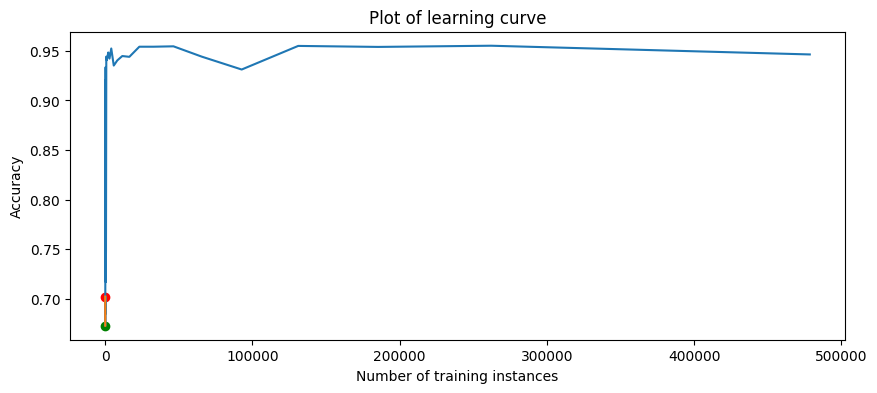

41it [01:45,  2.82s/it]

sklearn.linear_model.SGDClassifier_on_354;non-monotonic:True


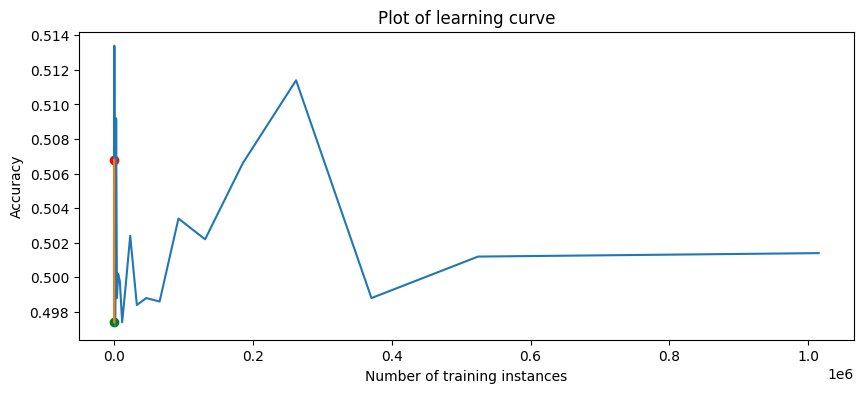

42it [01:47,  2.75s/it]

sklearn.linear_model.SGDClassifier_on_357;non-monotonic:True


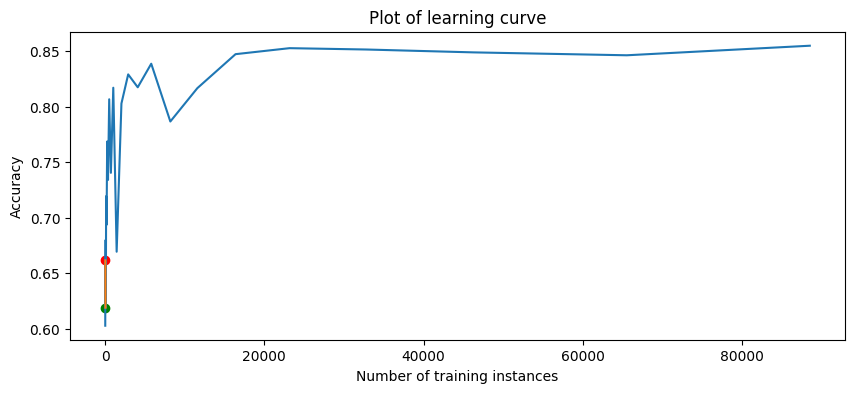

43it [01:49,  2.60s/it]

sklearn.linear_model.SGDClassifier_on_380;non-monotonic:False


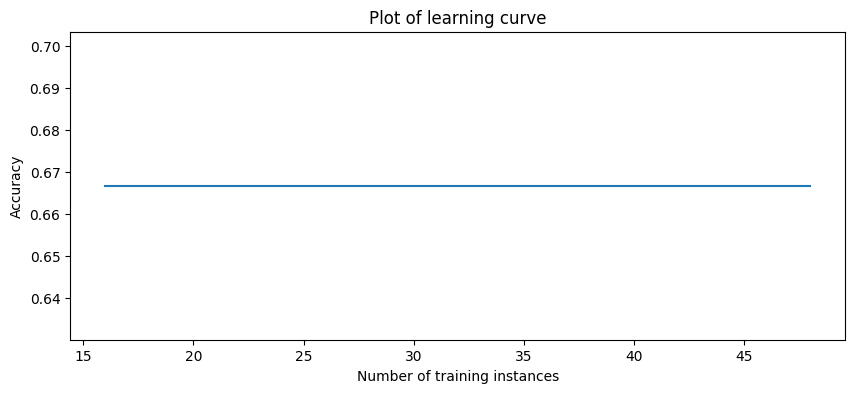

44it [01:52,  2.49s/it]

sklearn.linear_model.SGDClassifier_on_389;non-monotonic:True


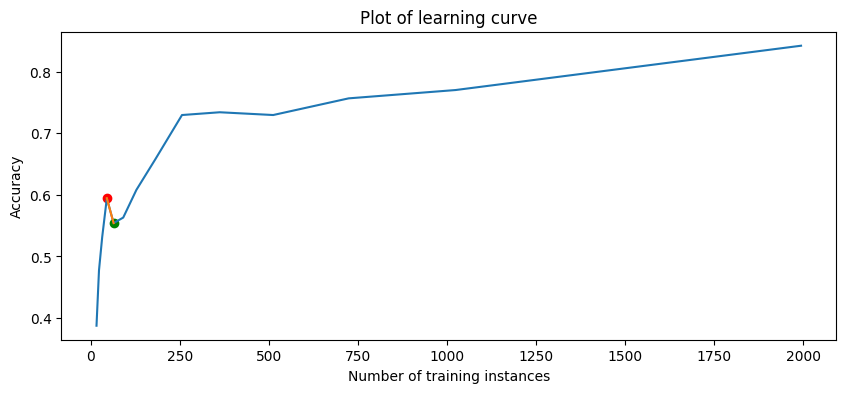

45it [01:54,  2.41s/it]

sklearn.linear_model.SGDClassifier_on_390;non-monotonic:False


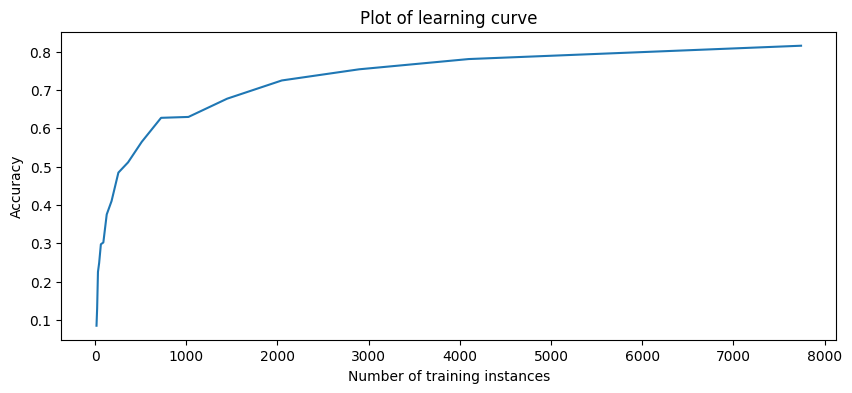

46it [01:56,  2.39s/it]

sklearn.linear_model.SGDClassifier_on_391;non-monotonic:False


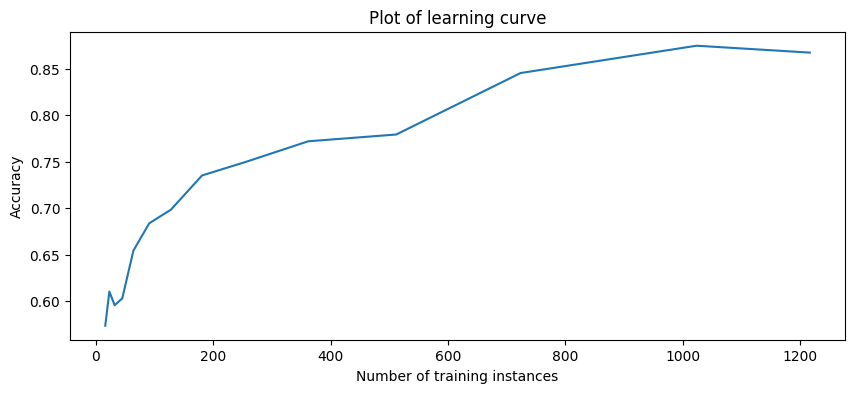

47it [01:58,  2.35s/it]

sklearn.linear_model.SGDClassifier_on_392;non-monotonic:True


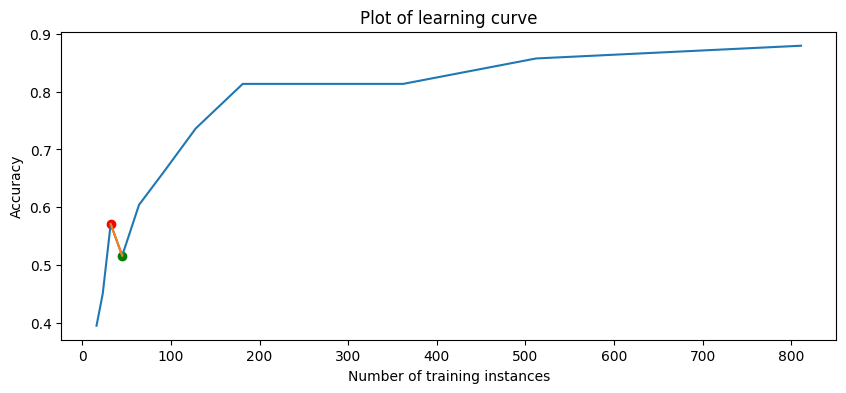

48it [02:01,  2.32s/it]

sklearn.linear_model.SGDClassifier_on_393;non-monotonic:False


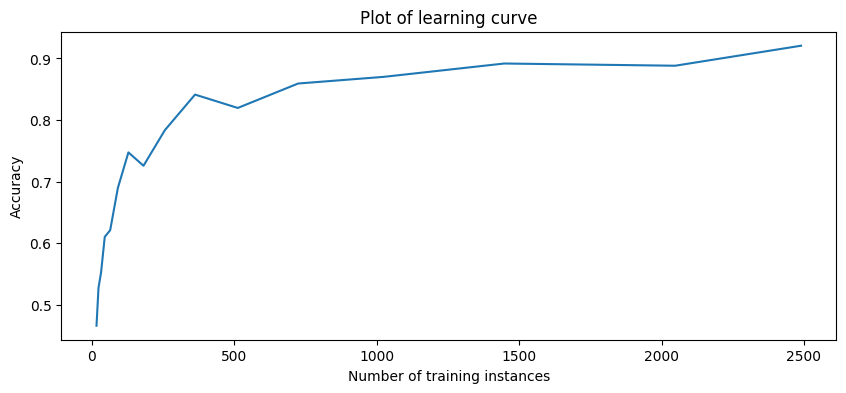

49it [02:03,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_395;non-monotonic:False


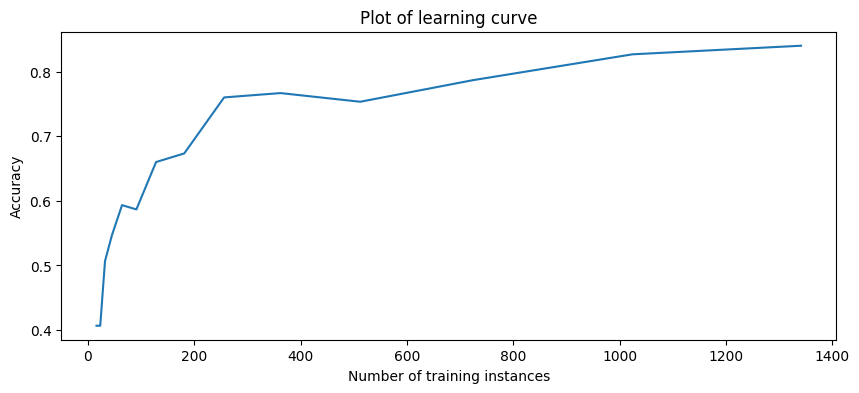

50it [02:06,  2.47s/it]

sklearn.linear_model.SGDClassifier_on_396;non-monotonic:True


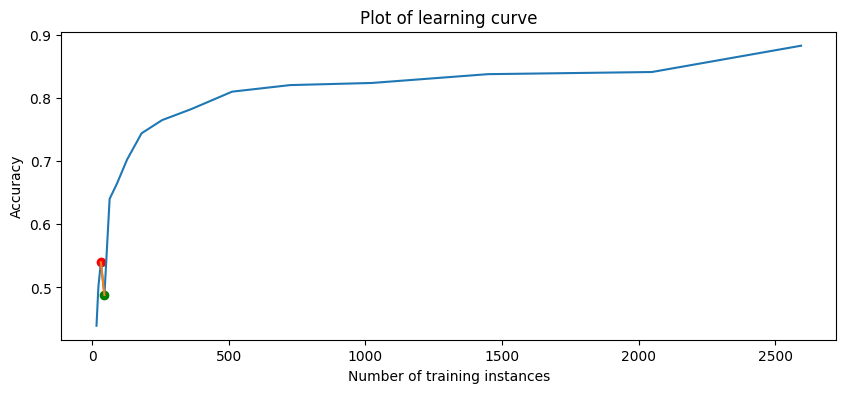

51it [02:09,  2.68s/it]

sklearn.linear_model.SGDClassifier_on_398;non-monotonic:False


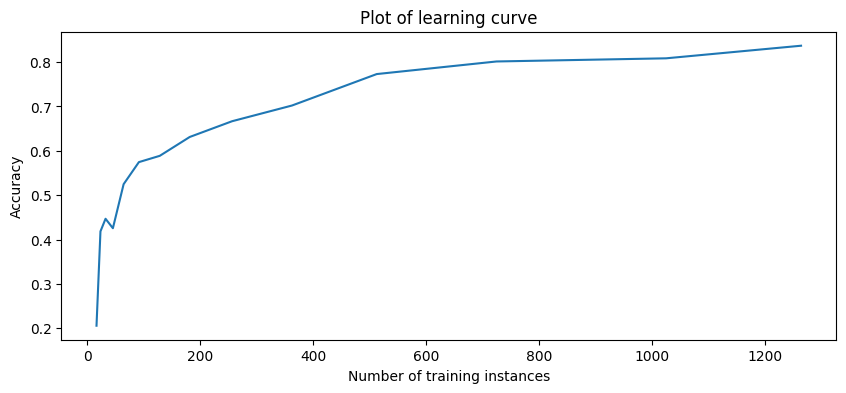

52it [02:12,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_399;non-monotonic:False


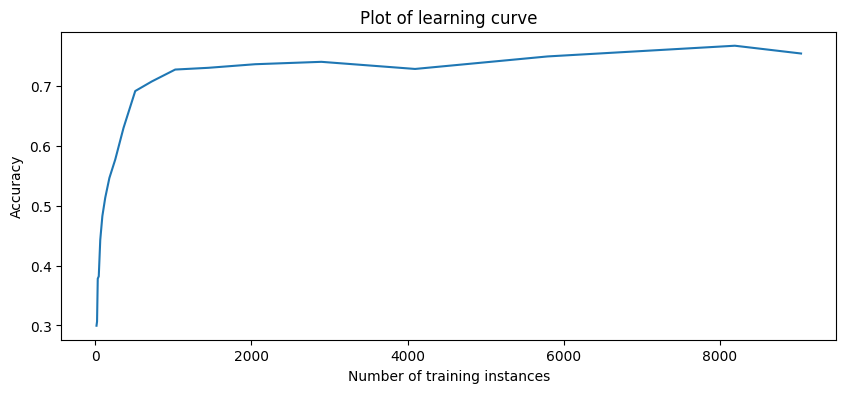

53it [02:14,  2.65s/it]

sklearn.linear_model.SGDClassifier_on_401;non-monotonic:False


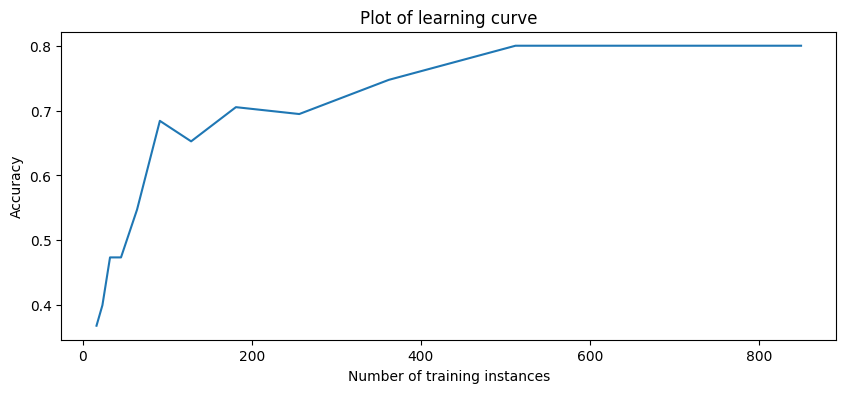

54it [02:17,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_446;non-monotonic:False


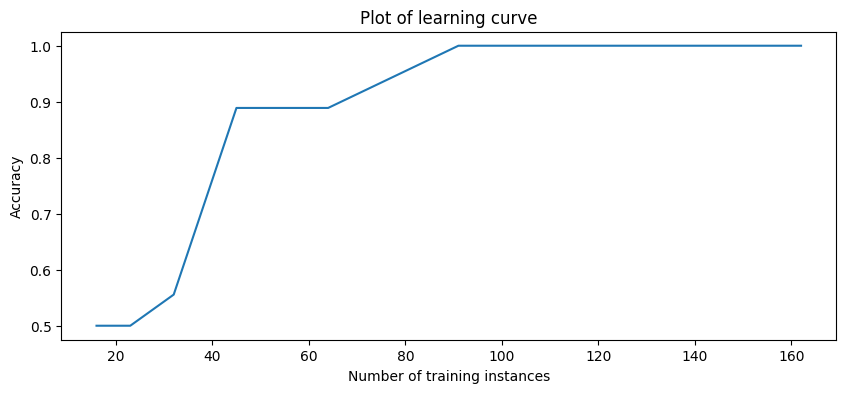

55it [02:19,  2.51s/it]

sklearn.linear_model.SGDClassifier_on_554;non-monotonic:True


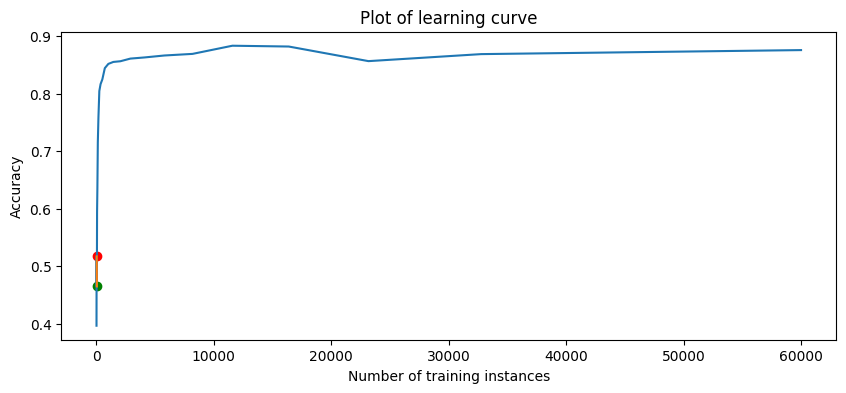

56it [02:21,  2.45s/it]

sklearn.linear_model.SGDClassifier_on_679;non-monotonic:True


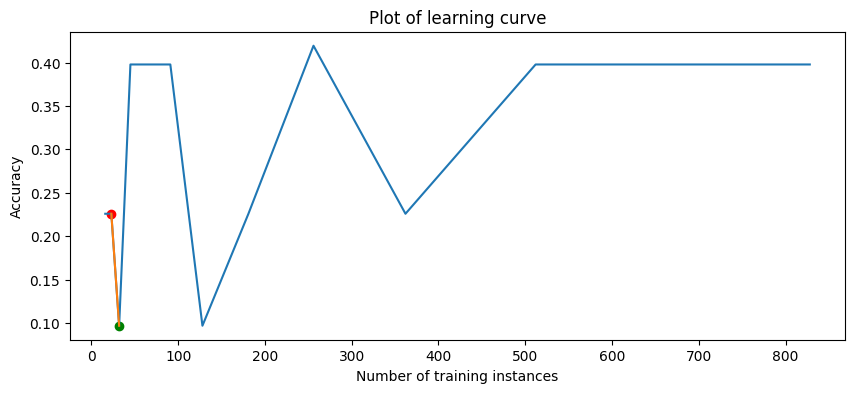

57it [02:24,  2.40s/it]

sklearn.linear_model.SGDClassifier_on_715;non-monotonic:True


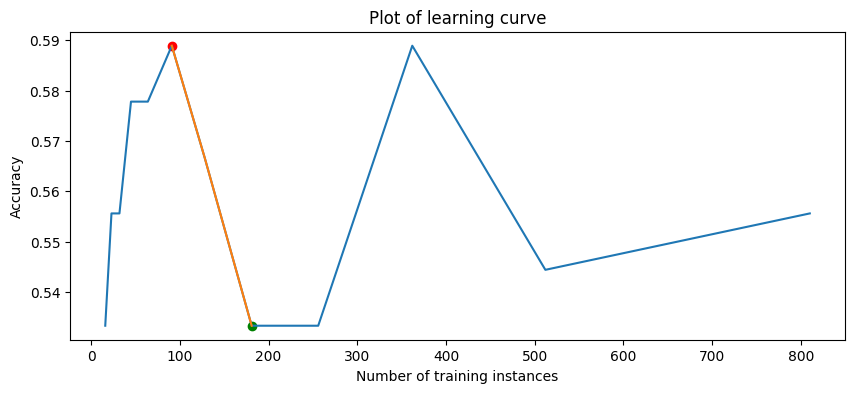

58it [02:26,  2.37s/it]

sklearn.linear_model.SGDClassifier_on_718;non-monotonic:True


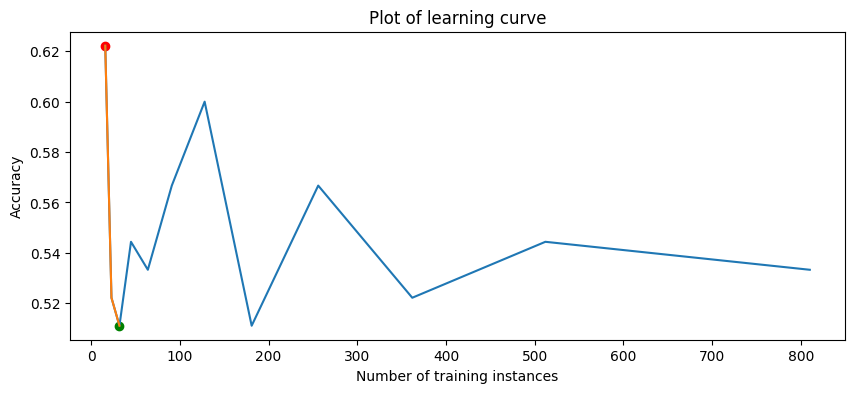

59it [02:29,  2.44s/it]

sklearn.linear_model.SGDClassifier_on_720;non-monotonic:True


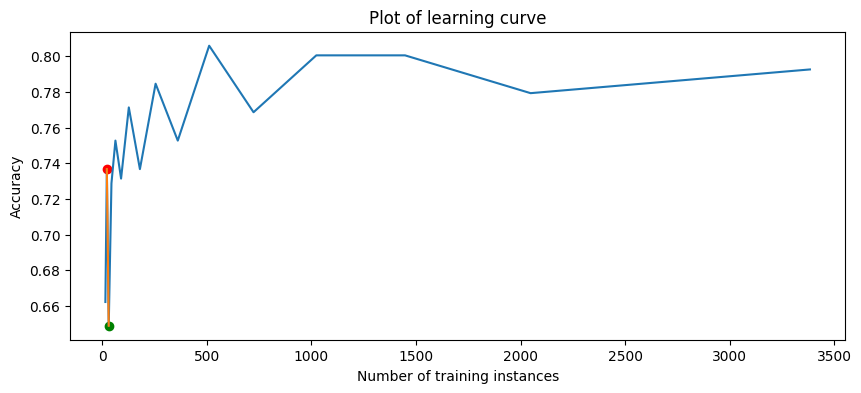

60it [02:31,  2.44s/it]

sklearn.linear_model.SGDClassifier_on_722;non-monotonic:True


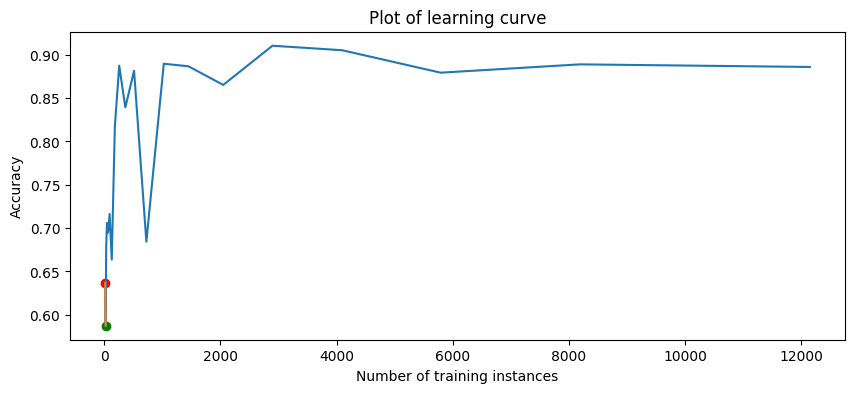

61it [02:33,  2.39s/it]

sklearn.linear_model.SGDClassifier_on_723;non-monotonic:True


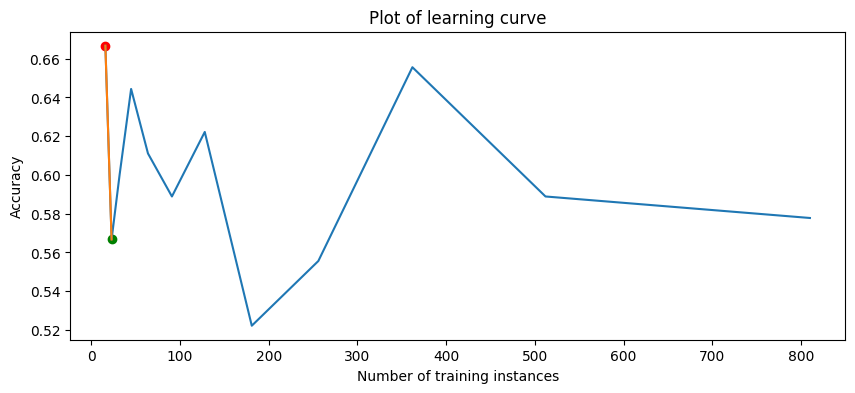

62it [02:36,  2.35s/it]

sklearn.linear_model.SGDClassifier_on_727;non-monotonic:True


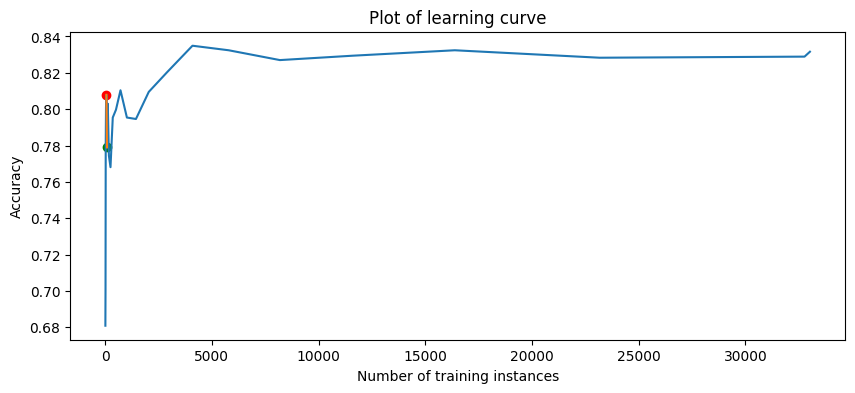

63it [02:38,  2.32s/it]

sklearn.linear_model.SGDClassifier_on_728;non-monotonic:True


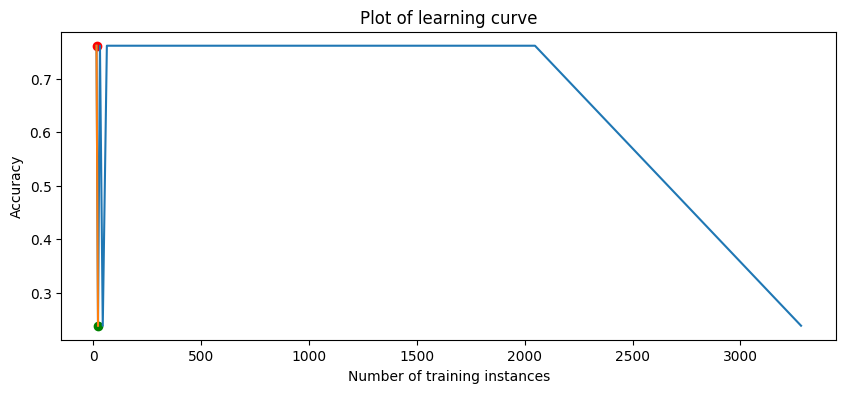

64it [02:40,  2.31s/it]

sklearn.linear_model.SGDClassifier_on_734;non-monotonic:True


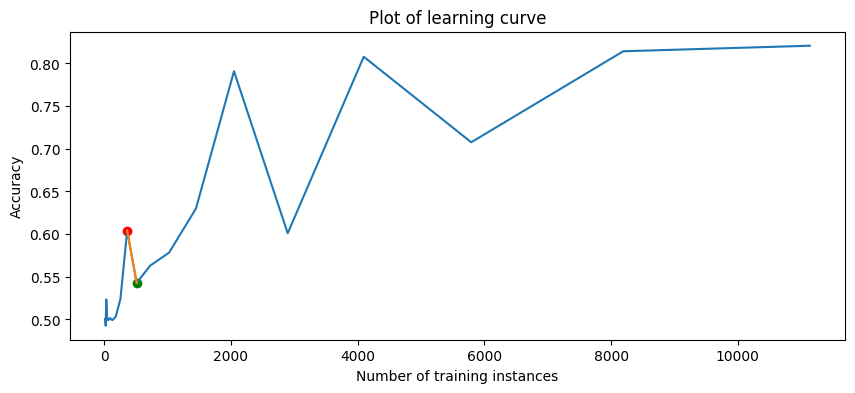

65it [02:43,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_735;non-monotonic:True


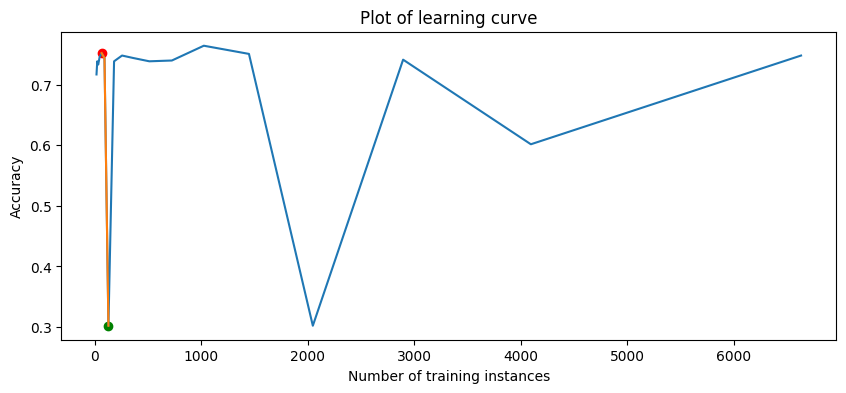

66it [02:45,  2.36s/it]

sklearn.linear_model.SGDClassifier_on_737;non-monotonic:True


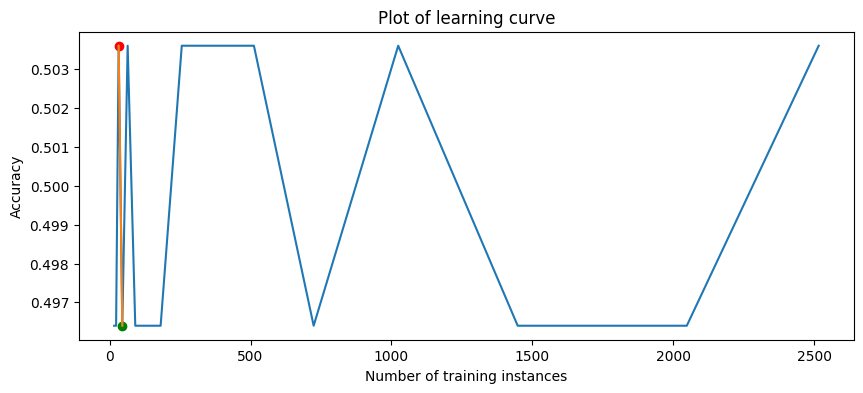

67it [02:47,  2.34s/it]

sklearn.linear_model.SGDClassifier_on_740;non-monotonic:True


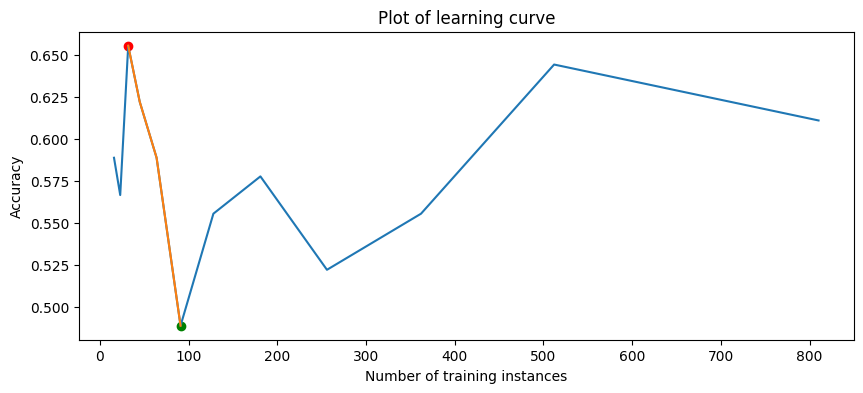

68it [02:50,  2.31s/it]

sklearn.linear_model.SGDClassifier_on_741;non-monotonic:True


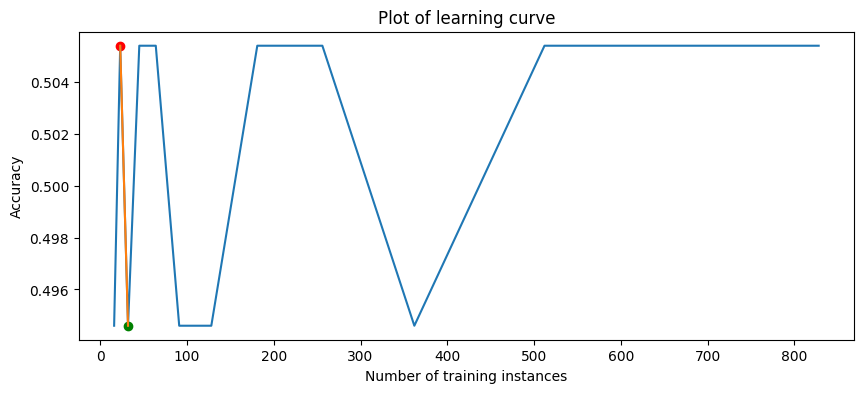

69it [02:52,  2.31s/it]

sklearn.linear_model.SGDClassifier_on_743;non-monotonic:True


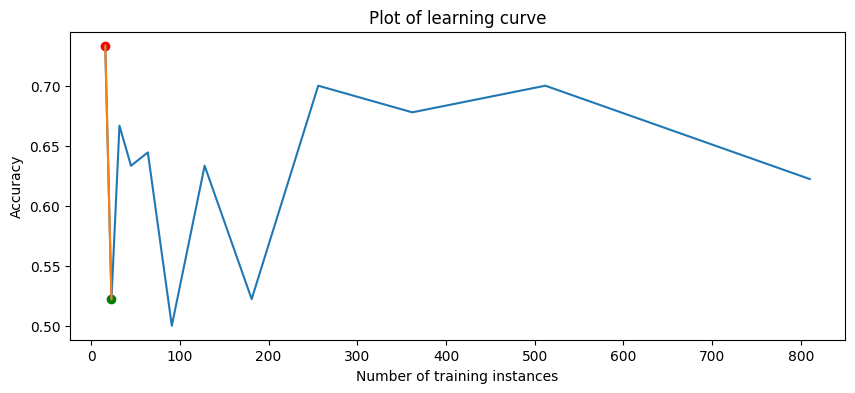

70it [02:54,  2.29s/it]

sklearn.linear_model.SGDClassifier_on_751;non-monotonic:True


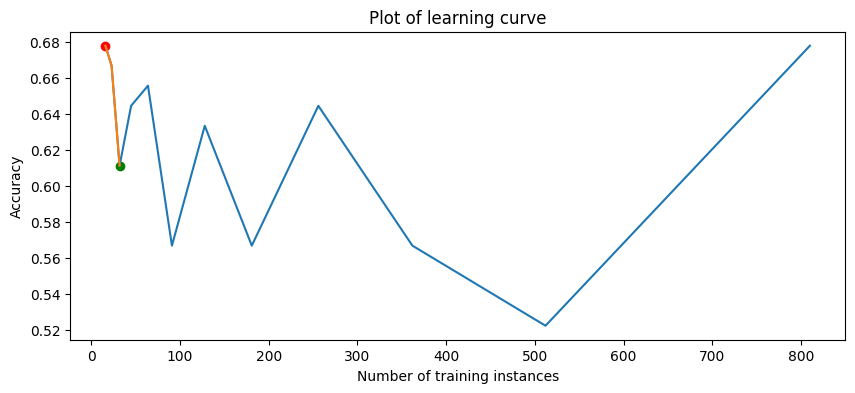

71it [02:57,  2.39s/it]

sklearn.linear_model.SGDClassifier_on_752;non-monotonic:True


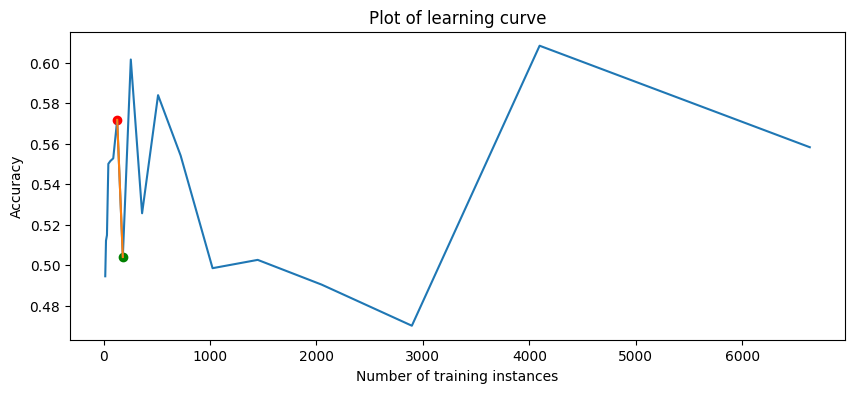

72it [02:59,  2.45s/it]

sklearn.linear_model.SGDClassifier_on_761;non-monotonic:True


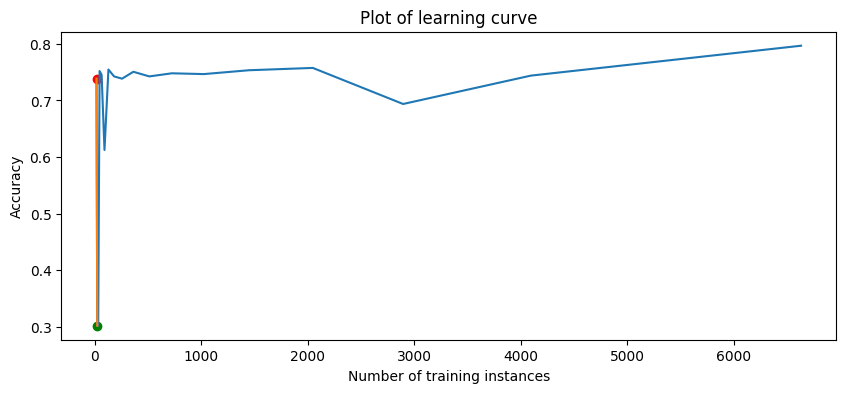

73it [03:02,  2.51s/it]

sklearn.linear_model.SGDClassifier_on_772;non-monotonic:True


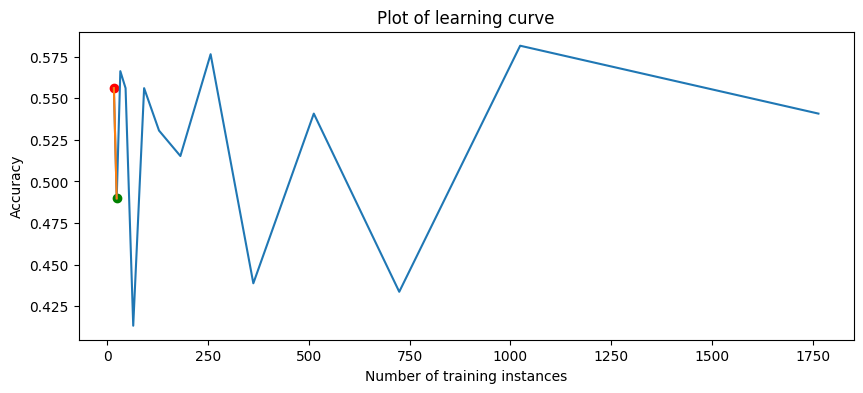

74it [03:05,  2.53s/it]

sklearn.linear_model.SGDClassifier_on_797;non-monotonic:True


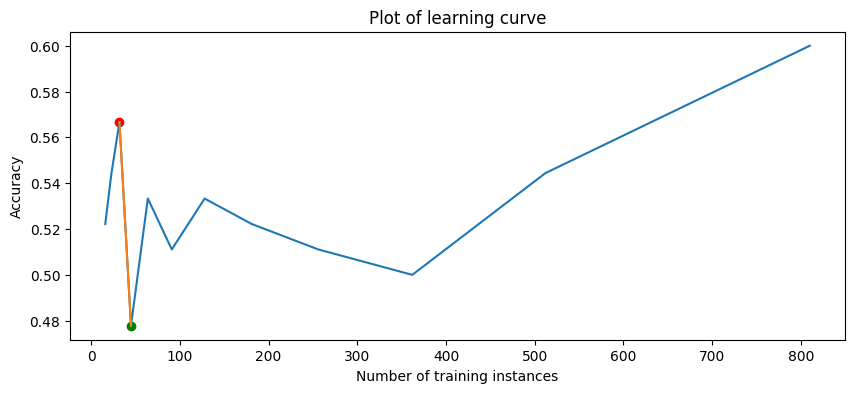

75it [03:07,  2.57s/it]

sklearn.linear_model.SGDClassifier_on_799;non-monotonic:True


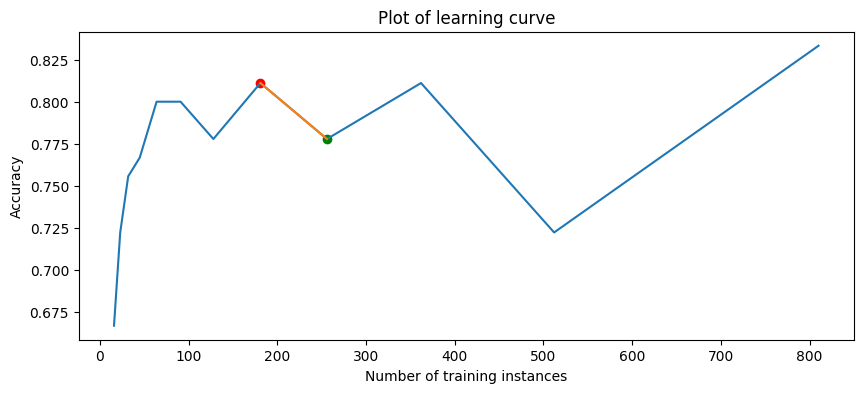

76it [03:10,  2.58s/it]

sklearn.linear_model.SGDClassifier_on_803;non-monotonic:True


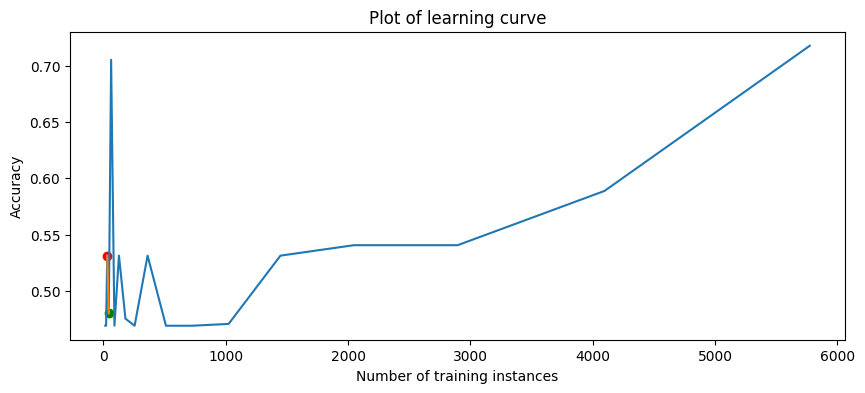

77it [03:12,  2.59s/it]

sklearn.linear_model.SGDClassifier_on_806;non-monotonic:True


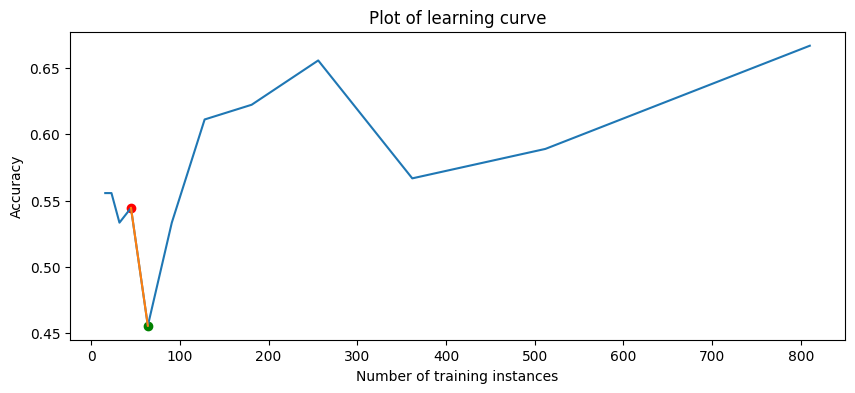

78it [03:15,  2.48s/it]

sklearn.linear_model.SGDClassifier_on_807;non-monotonic:True


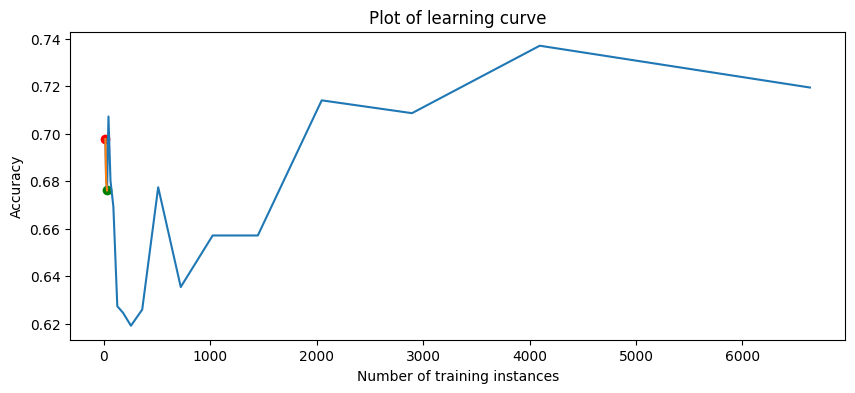

79it [03:17,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_813;non-monotonic:True


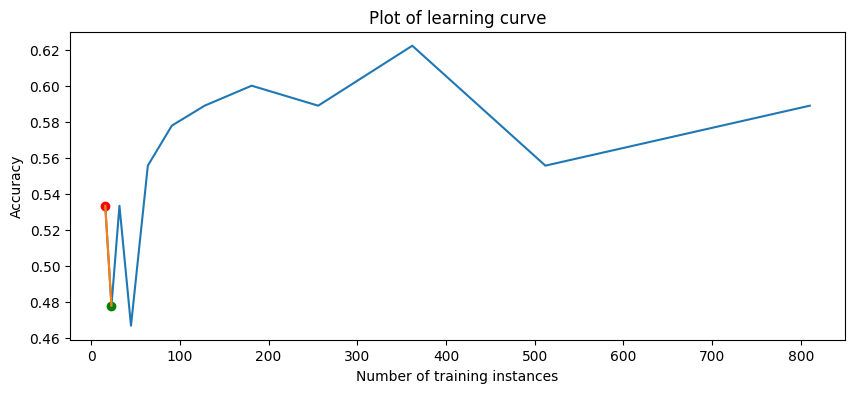

80it [03:19,  2.39s/it]

sklearn.linear_model.SGDClassifier_on_816;non-monotonic:True


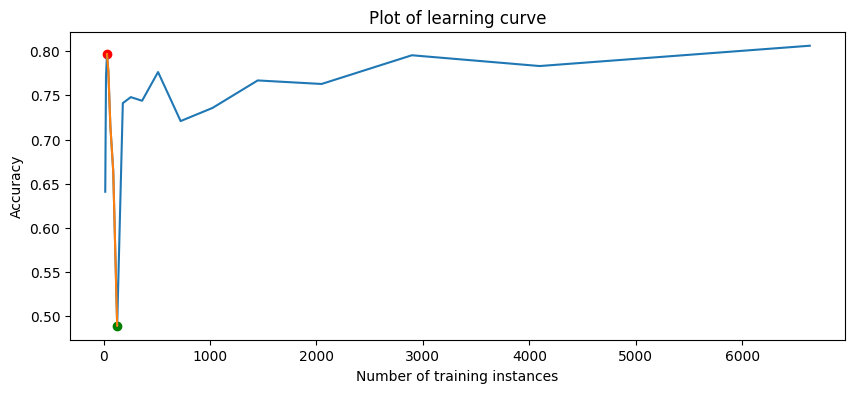

81it [03:22,  2.36s/it]

sklearn.linear_model.SGDClassifier_on_819;non-monotonic:True


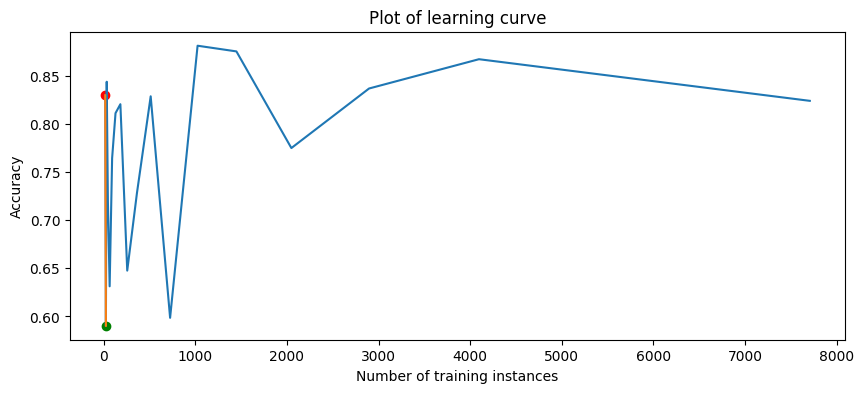

82it [03:24,  2.44s/it]

sklearn.linear_model.SGDClassifier_on_821;non-monotonic:True


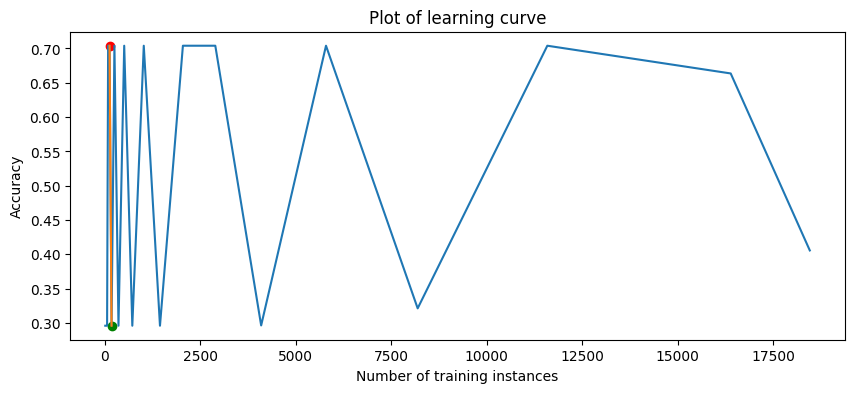

83it [03:27,  2.51s/it]

sklearn.linear_model.SGDClassifier_on_822;non-monotonic:True


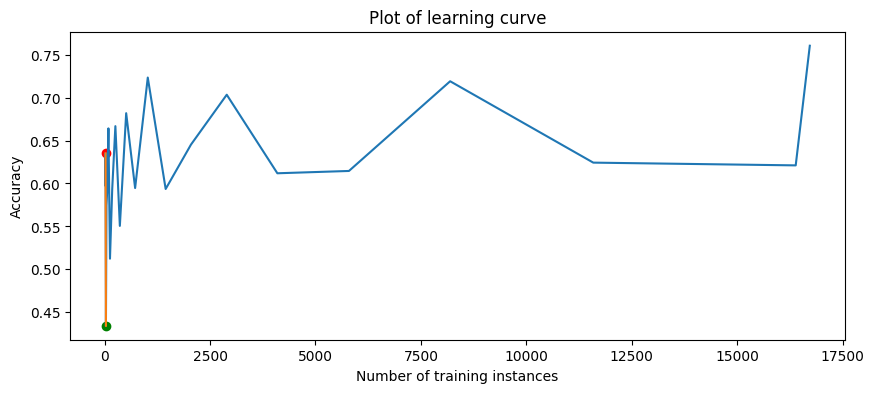

84it [03:30,  2.56s/it]

sklearn.linear_model.SGDClassifier_on_823;non-monotonic:True


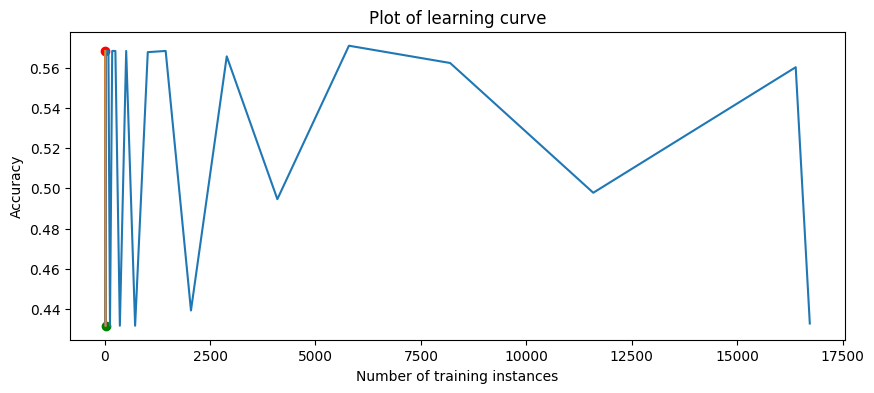

85it [03:32,  2.48s/it]

sklearn.linear_model.SGDClassifier_on_833;non-monotonic:True


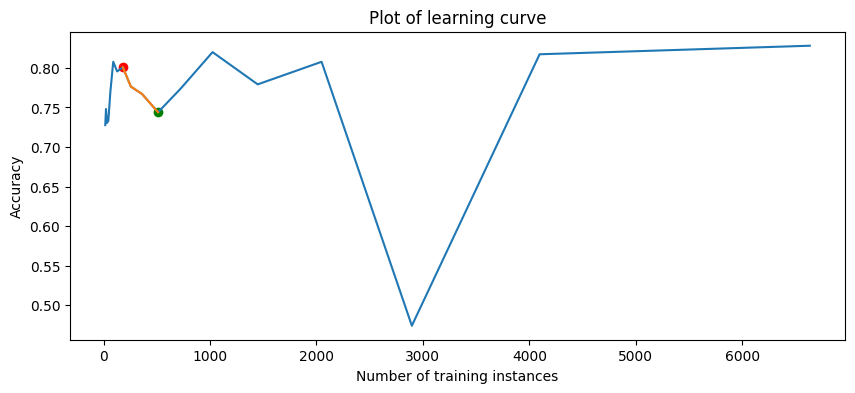

86it [03:34,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_837;non-monotonic:True


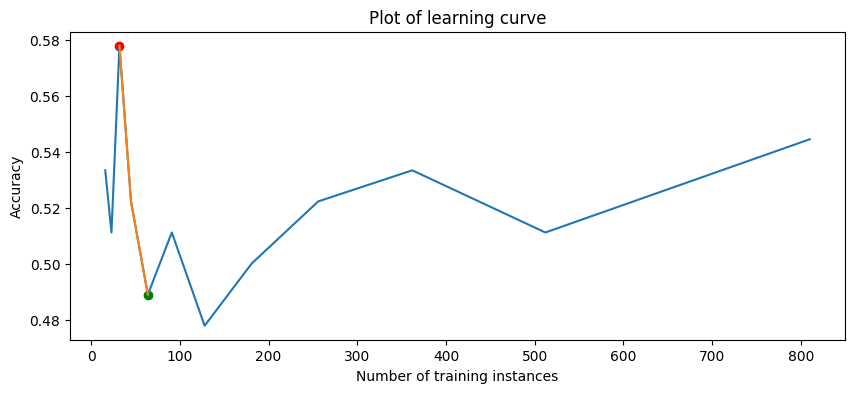

87it [03:36,  2.37s/it]

sklearn.linear_model.SGDClassifier_on_843;non-monotonic:True


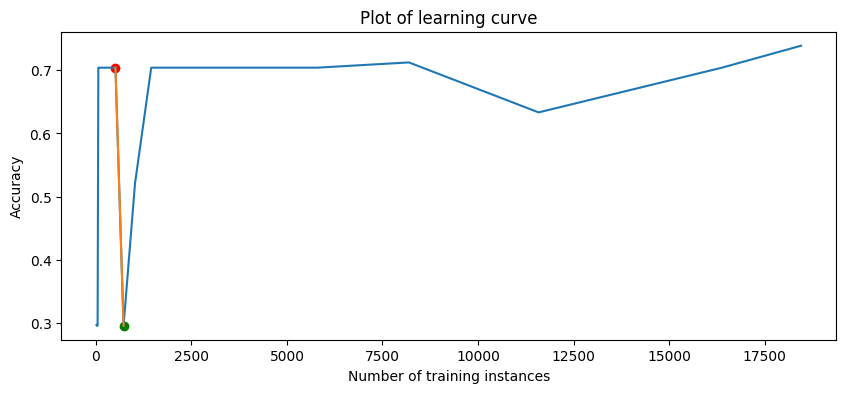

88it [03:39,  2.33s/it]

sklearn.linear_model.SGDClassifier_on_845;non-monotonic:True


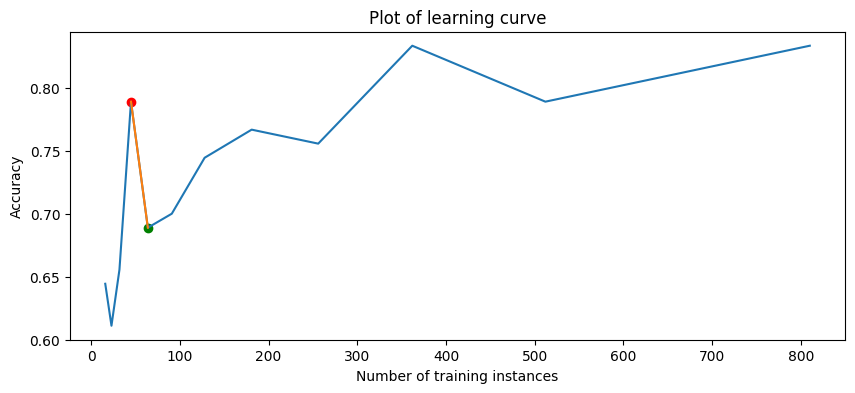

89it [03:41,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_846;non-monotonic:True


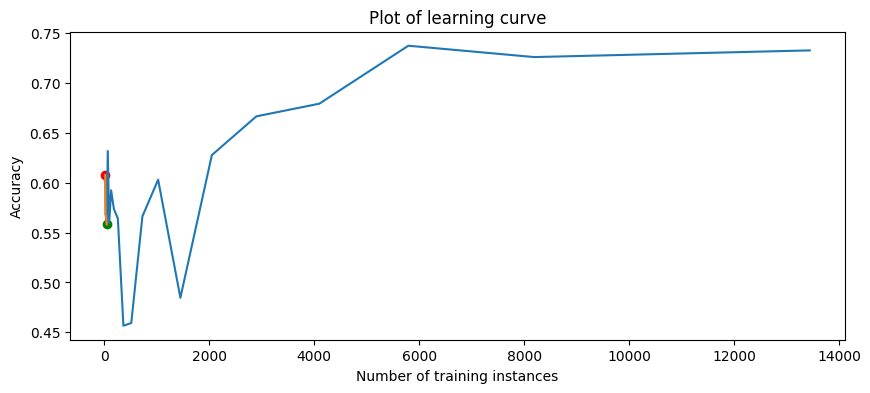

90it [03:44,  2.49s/it]

sklearn.linear_model.SGDClassifier_on_847;non-monotonic:True


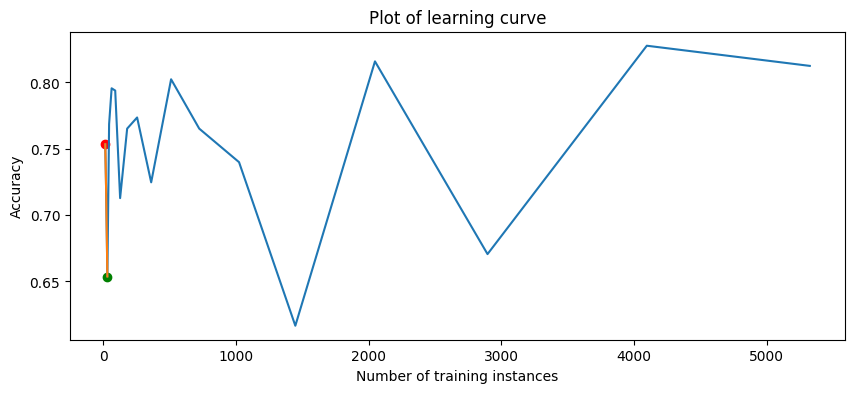

91it [03:47,  2.53s/it]

sklearn.linear_model.SGDClassifier_on_849;non-monotonic:True


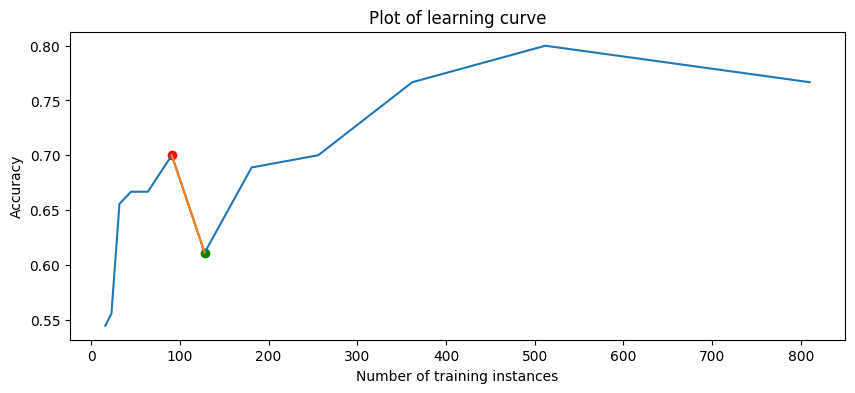

92it [03:49,  2.55s/it]

sklearn.linear_model.SGDClassifier_on_866;non-monotonic:True


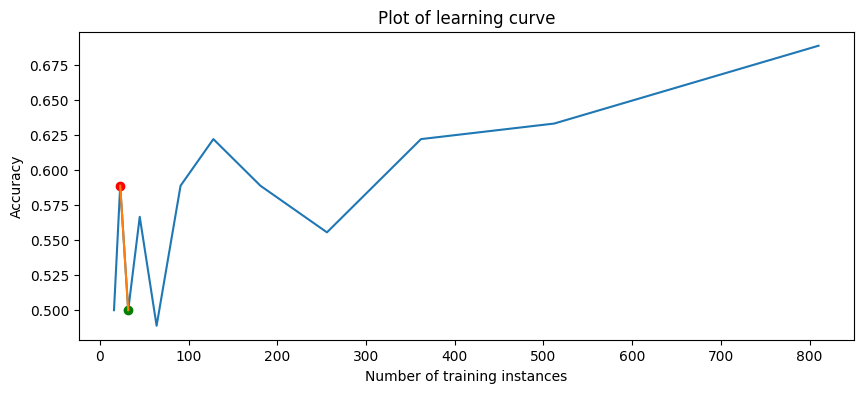

93it [03:52,  2.56s/it]

sklearn.linear_model.SGDClassifier_on_871;non-monotonic:True


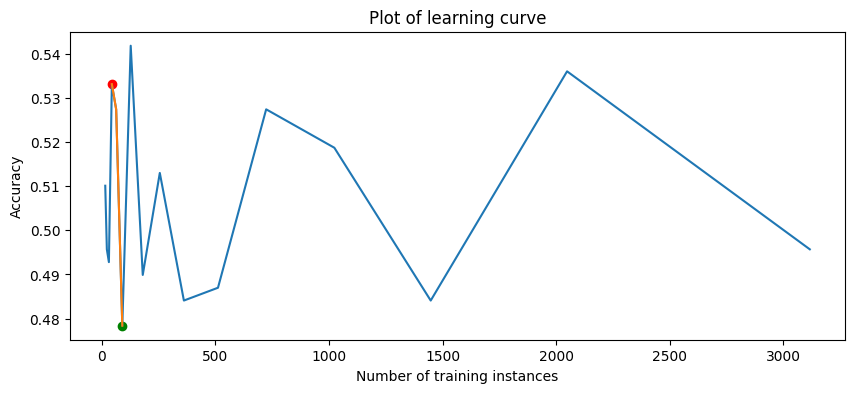

94it [03:54,  2.58s/it]

sklearn.linear_model.SGDClassifier_on_881;non-monotonic:True


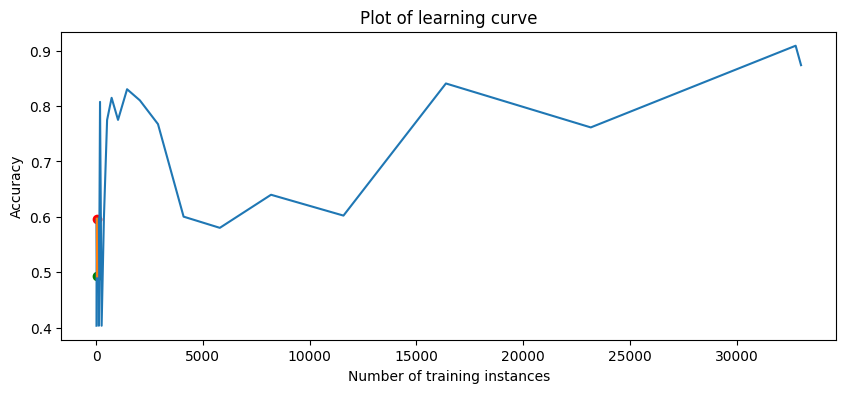

95it [03:57,  2.66s/it]

sklearn.linear_model.SGDClassifier_on_897;non-monotonic:True


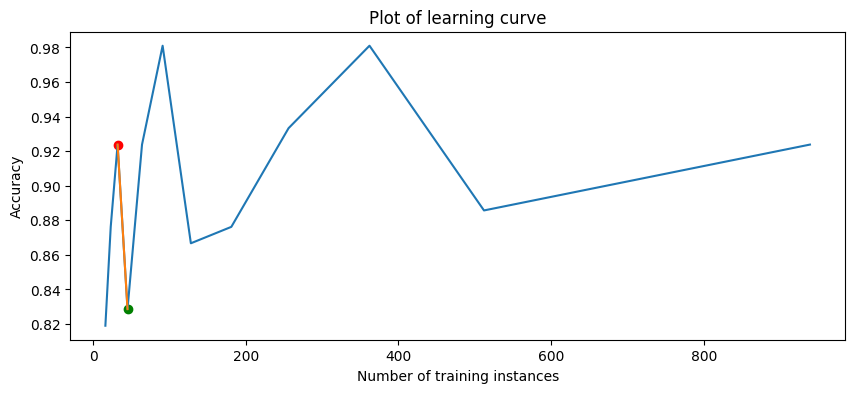

96it [04:00,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_901;non-monotonic:True


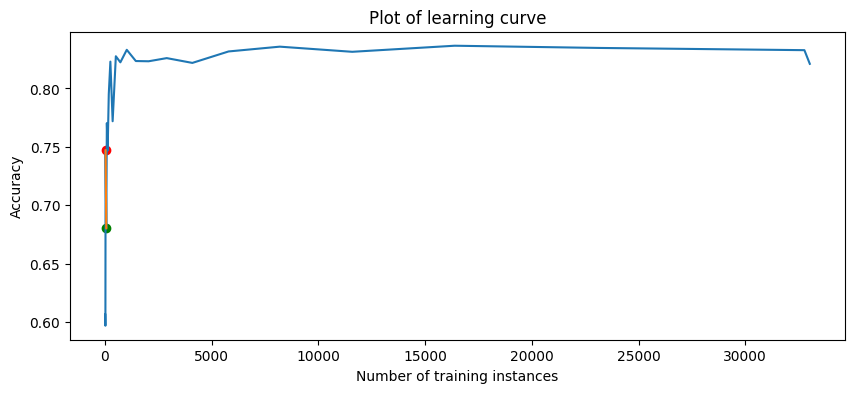

97it [04:03,  2.70s/it]

sklearn.linear_model.SGDClassifier_on_903;non-monotonic:True


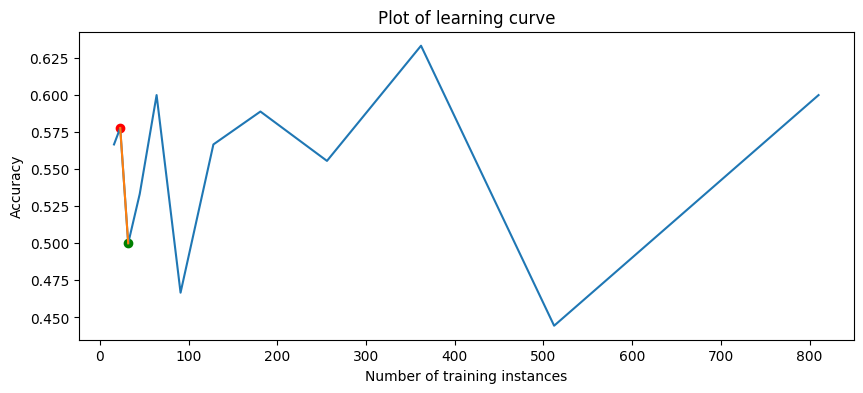

98it [04:05,  2.76s/it]

sklearn.linear_model.SGDClassifier_on_904;non-monotonic:True


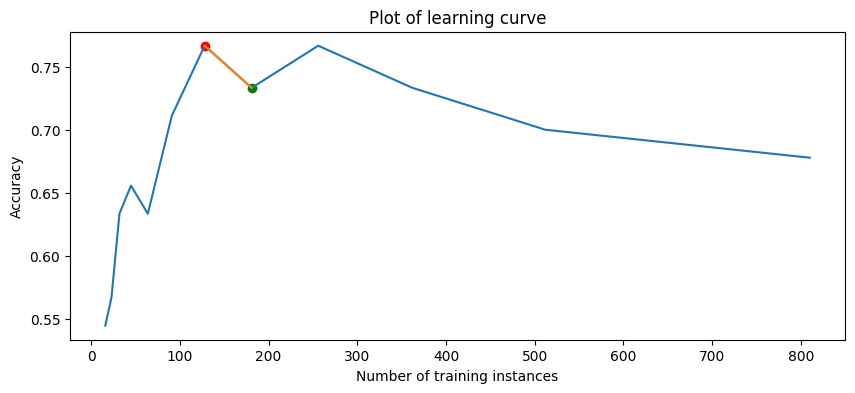

99it [04:08,  2.79s/it]

sklearn.linear_model.SGDClassifier_on_910;non-monotonic:True


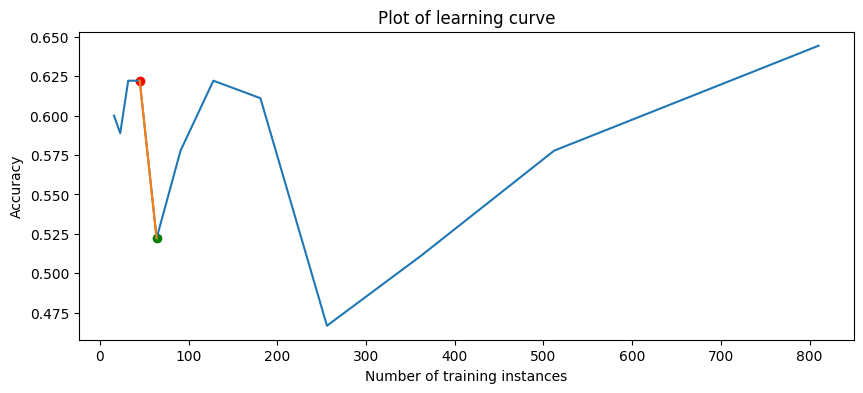

100it [04:11,  2.74s/it]

sklearn.linear_model.SGDClassifier_on_912;non-monotonic:True


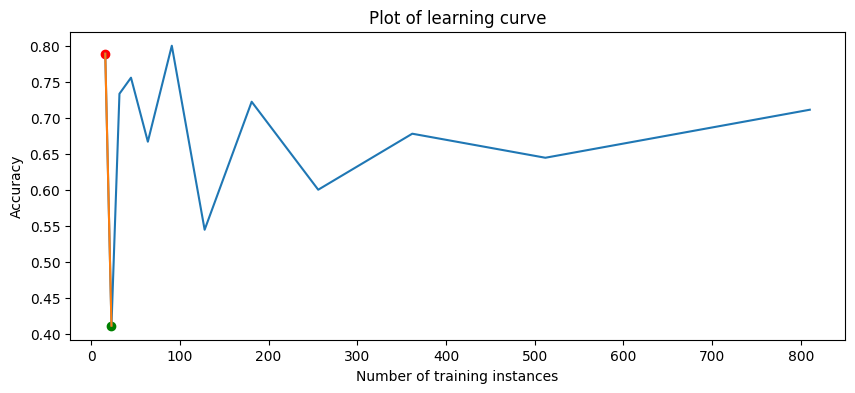

101it [04:14,  2.79s/it]

sklearn.linear_model.SGDClassifier_on_913;non-monotonic:True


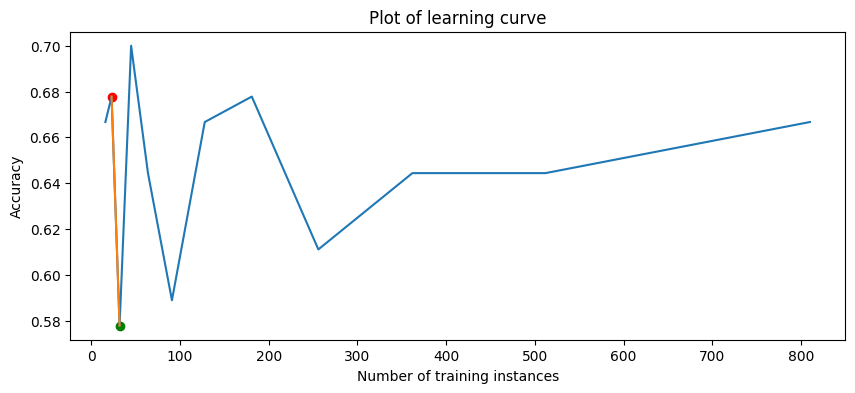

102it [04:17,  2.89s/it]

sklearn.linear_model.SGDClassifier_on_914;non-monotonic:True


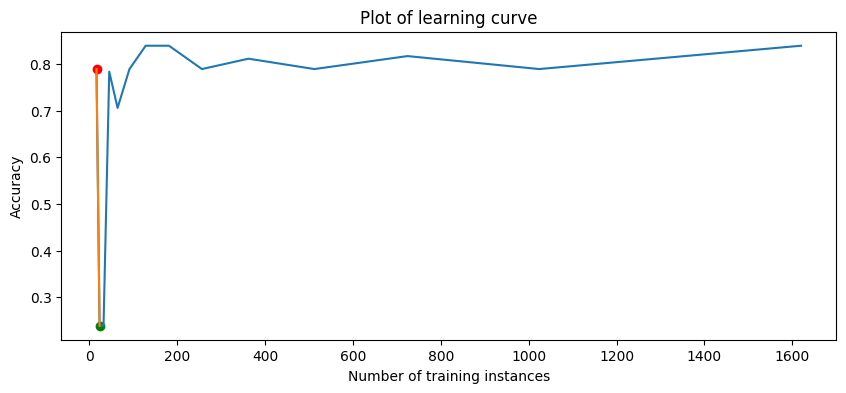

103it [04:20,  2.91s/it]

sklearn.linear_model.SGDClassifier_on_917;non-monotonic:True


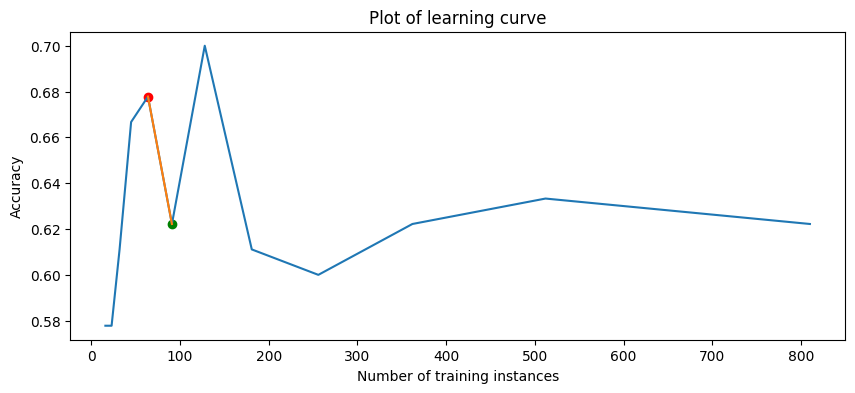

104it [04:23,  2.92s/it]

sklearn.linear_model.SGDClassifier_on_923;non-monotonic:True


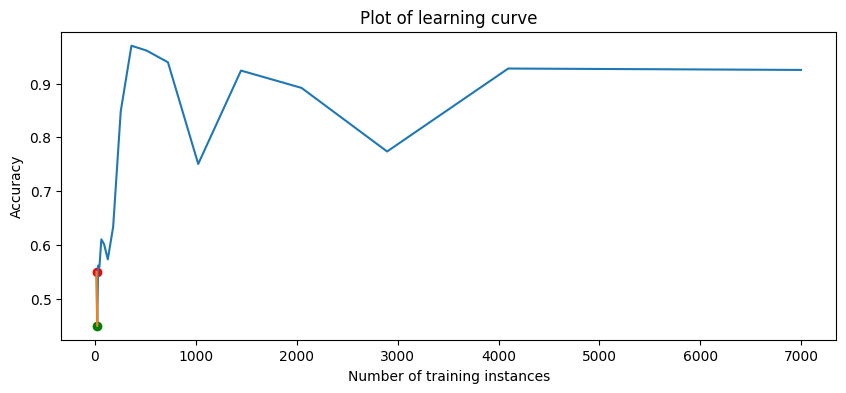

105it [04:26,  2.92s/it]

sklearn.linear_model.SGDClassifier_on_930;non-monotonic:True


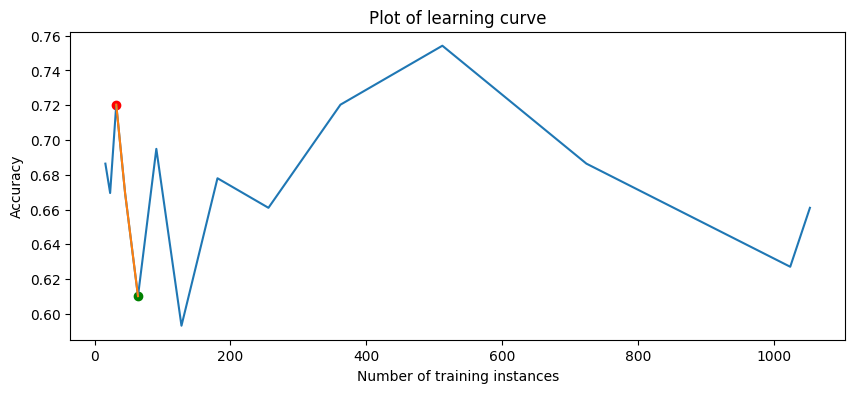

106it [04:28,  2.84s/it]

sklearn.linear_model.SGDClassifier_on_934;non-monotonic:True


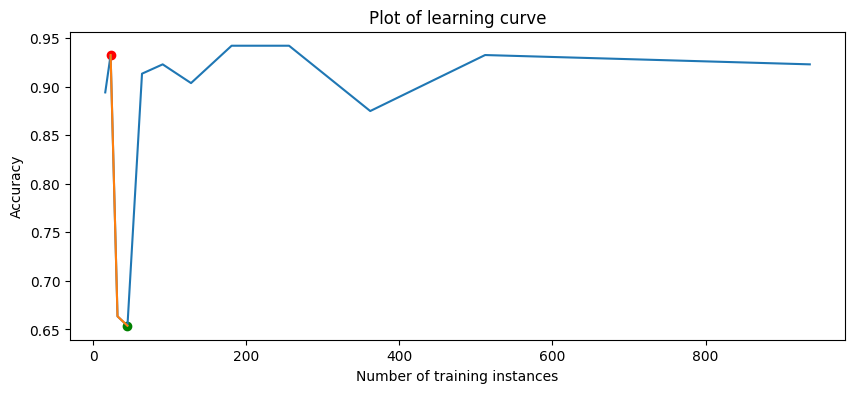

107it [04:31,  2.77s/it]

sklearn.linear_model.SGDClassifier_on_953;non-monotonic:True


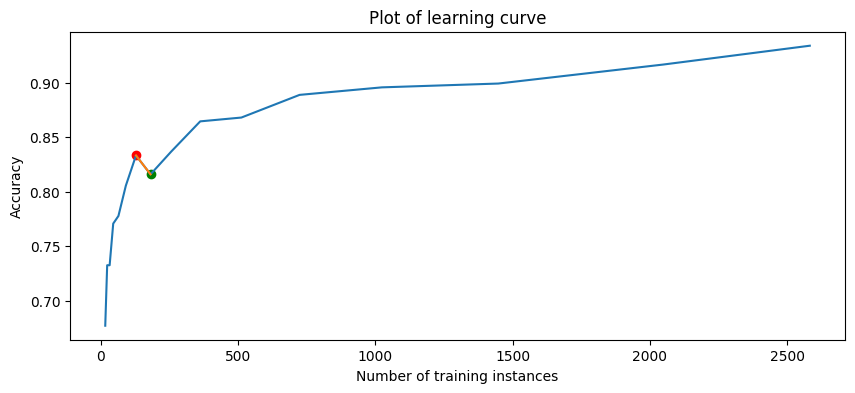

108it [04:34,  2.72s/it]

sklearn.linear_model.SGDClassifier_on_958;non-monotonic:True


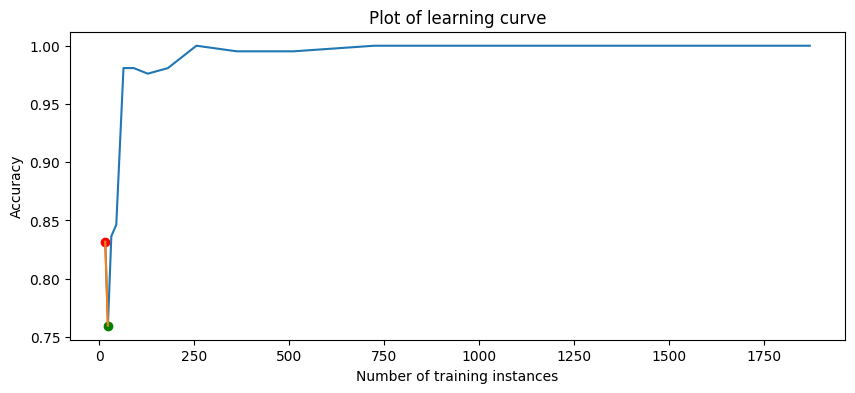

109it [04:36,  2.70s/it]

sklearn.linear_model.SGDClassifier_on_959;non-monotonic:True


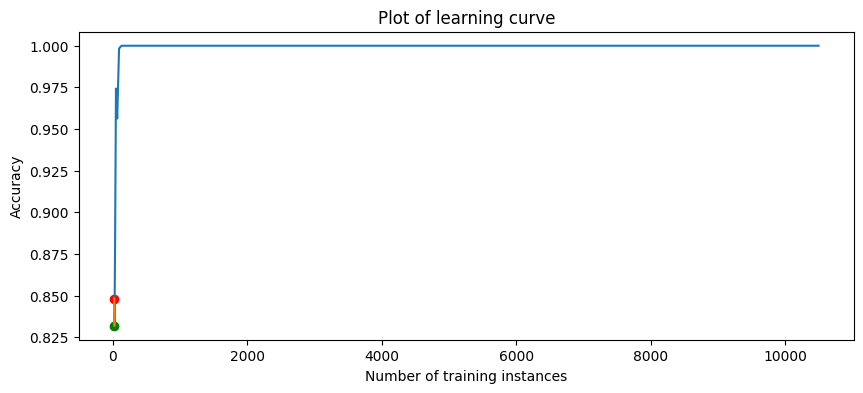

110it [04:39,  2.68s/it]

sklearn.linear_model.SGDClassifier_on_962;non-monotonic:True


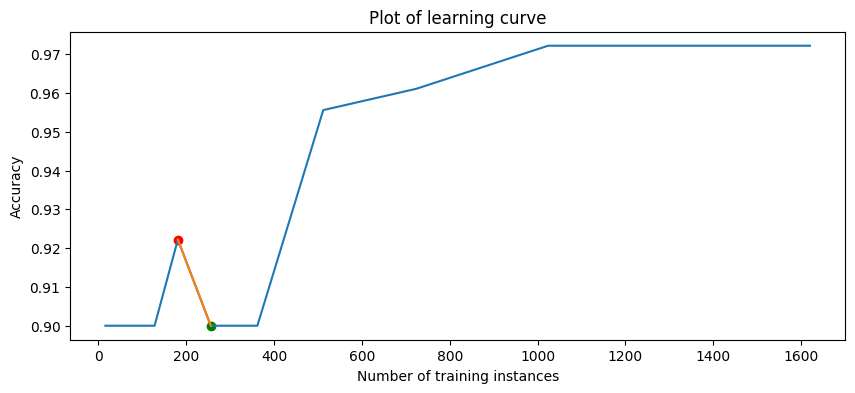

111it [04:42,  2.66s/it]

sklearn.linear_model.SGDClassifier_on_966;non-monotonic:True


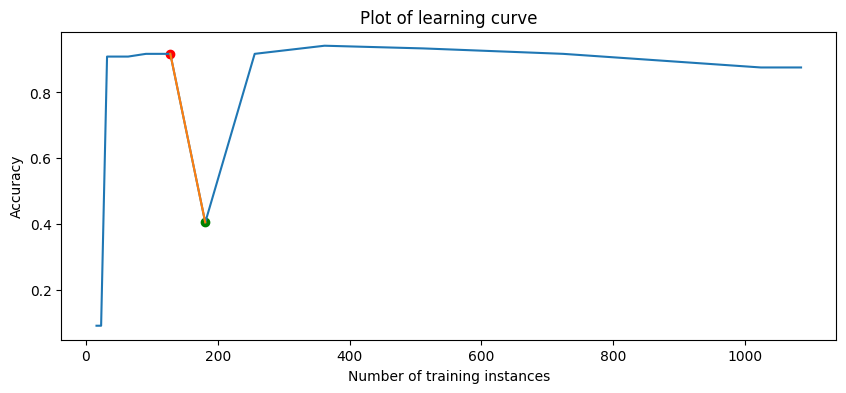

112it [04:44,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_971;non-monotonic:True


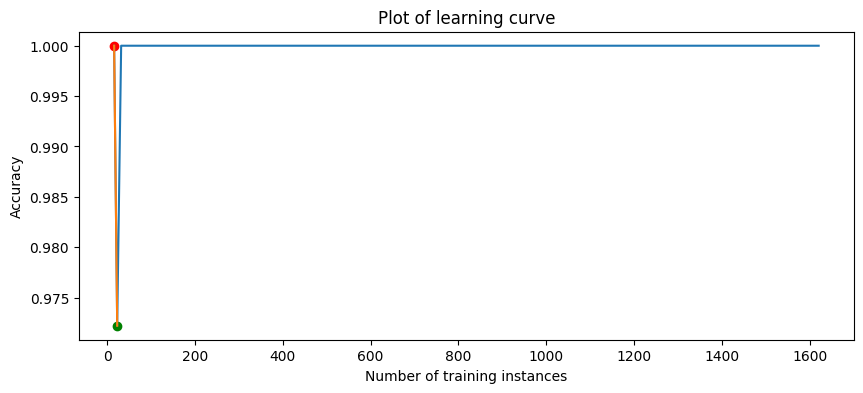

113it [04:47,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_976;non-monotonic:True


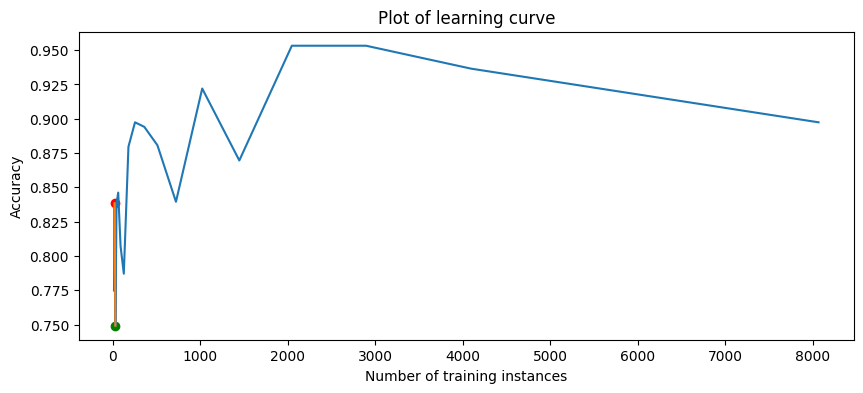

114it [04:49,  2.63s/it]

sklearn.linear_model.SGDClassifier_on_977;non-monotonic:True


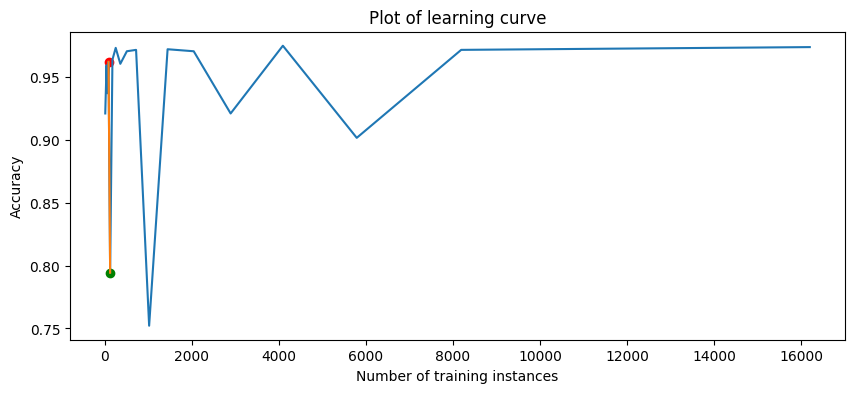

115it [04:52,  2.52s/it]

sklearn.linear_model.SGDClassifier_on_978;non-monotonic:True


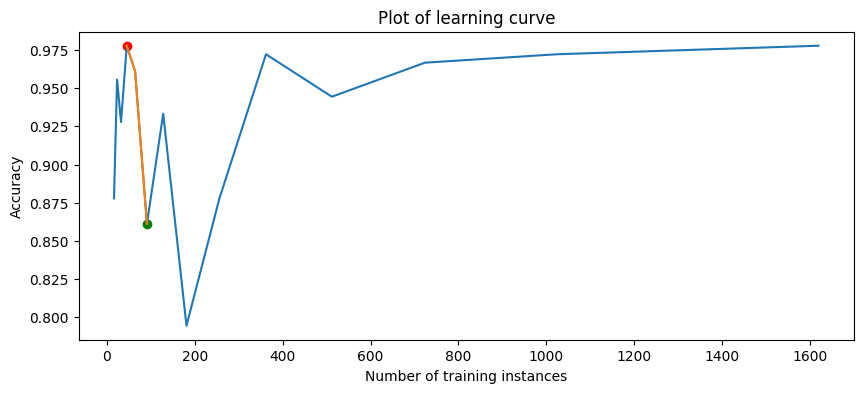

116it [04:54,  2.46s/it]

sklearn.linear_model.SGDClassifier_on_979;non-monotonic:True


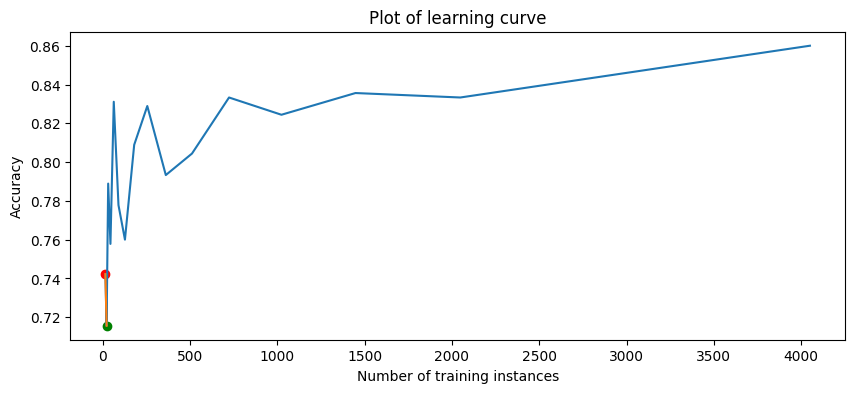

117it [04:56,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_980;non-monotonic:True


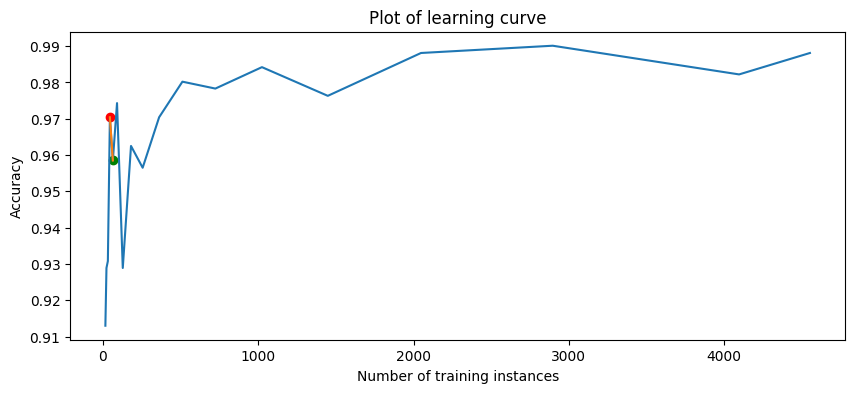

118it [04:59,  2.50s/it]

sklearn.linear_model.SGDClassifier_on_991;non-monotonic:True


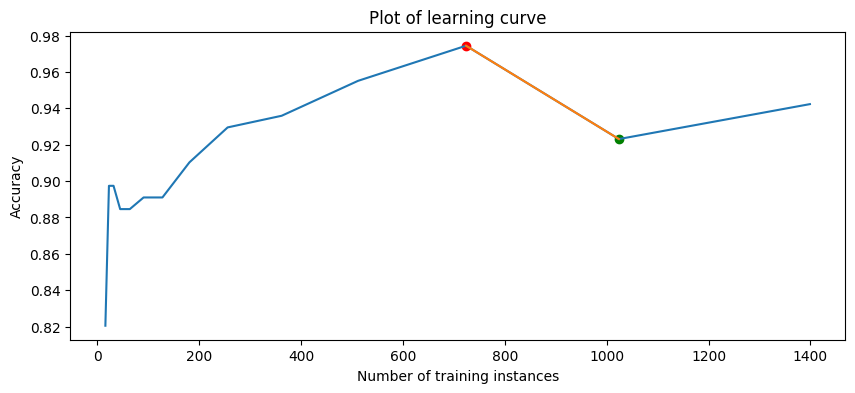

119it [05:01,  2.43s/it]

sklearn.linear_model.SGDClassifier_on_993;non-monotonic:True


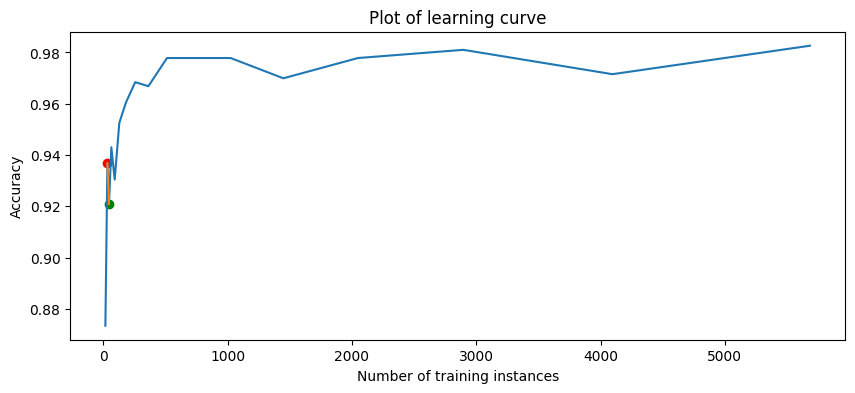

120it [05:04,  2.45s/it]

sklearn.linear_model.SGDClassifier_on_995;non-monotonic:True


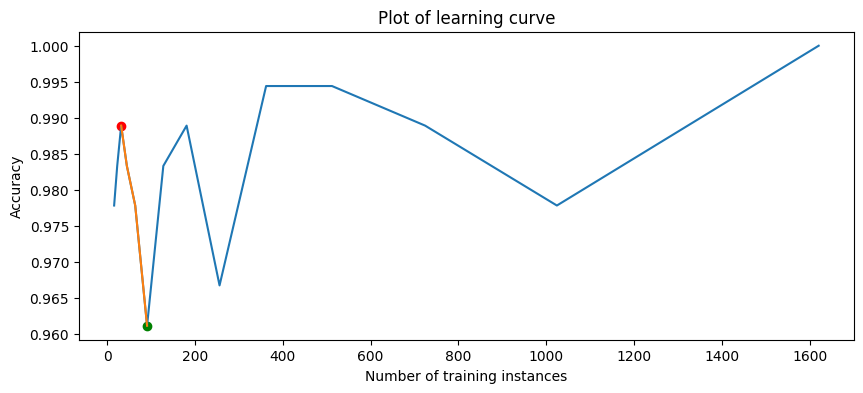

121it [05:06,  2.50s/it]

sklearn.linear_model.SGDClassifier_on_1000;non-monotonic:True


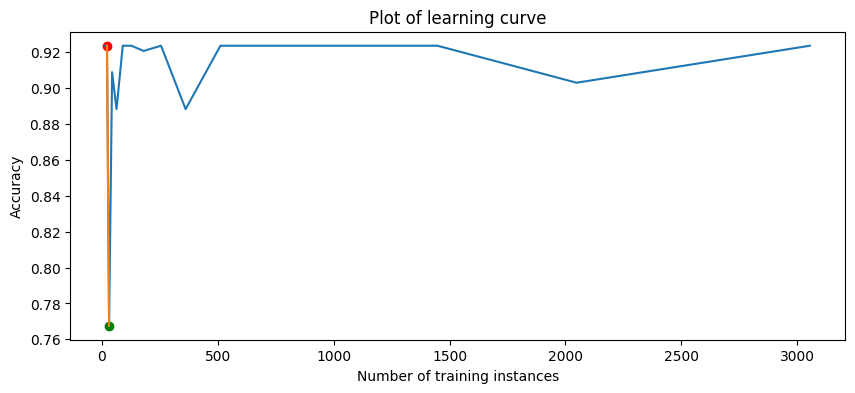

122it [05:09,  2.54s/it]

sklearn.linear_model.SGDClassifier_on_1002;non-monotonic:True


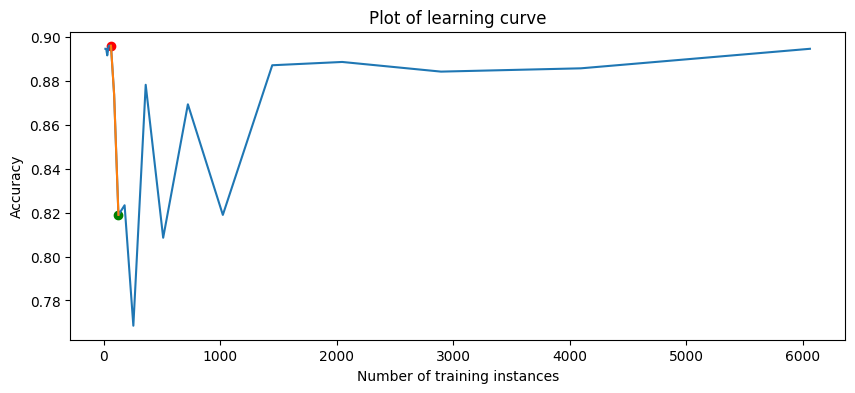

123it [05:12,  2.59s/it]

sklearn.linear_model.SGDClassifier_on_1018;non-monotonic:True


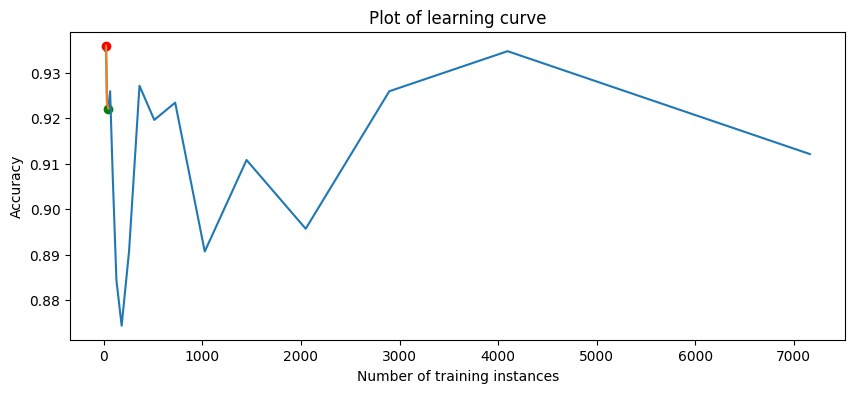

124it [05:14,  2.50s/it]

sklearn.linear_model.SGDClassifier_on_1019;non-monotonic:True


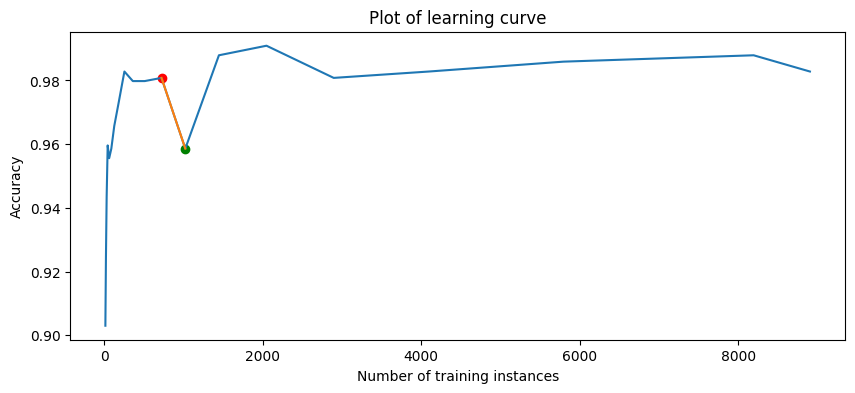

125it [05:16,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_1020;non-monotonic:True


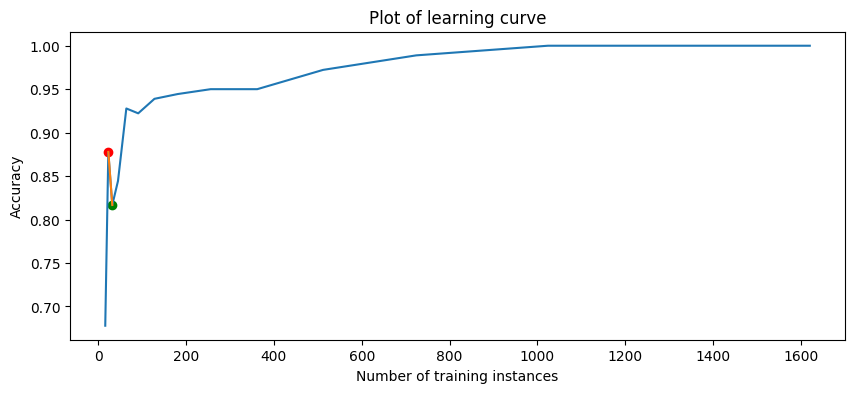

126it [05:19,  2.38s/it]

sklearn.linear_model.SGDClassifier_on_1021;non-monotonic:True


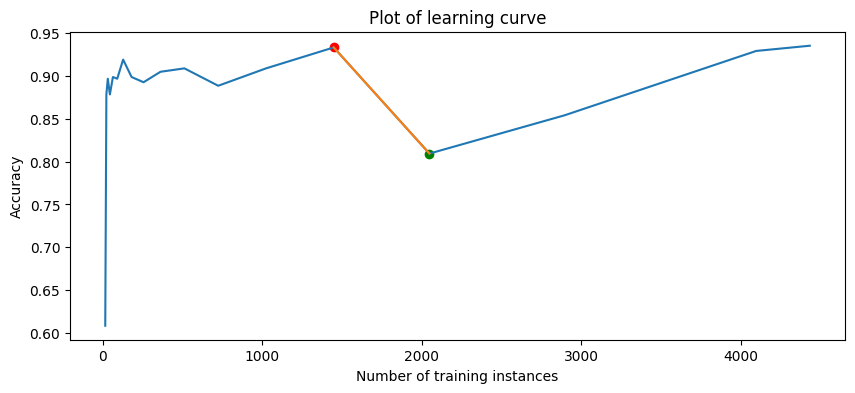

127it [05:21,  2.45s/it]

sklearn.linear_model.SGDClassifier_on_1036;non-monotonic:True


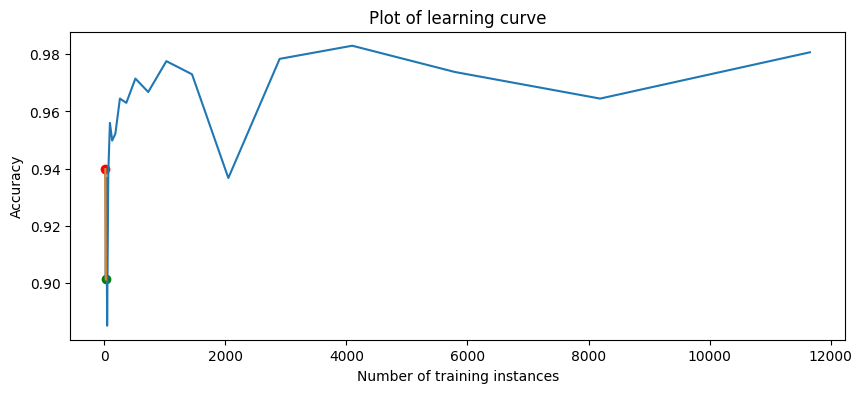

128it [05:24,  2.52s/it]

sklearn.linear_model.SGDClassifier_on_1040;non-monotonic:True


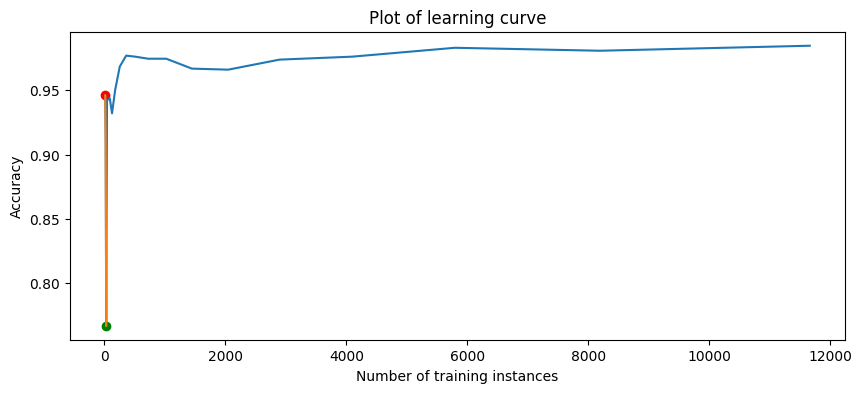

129it [05:26,  2.55s/it]

sklearn.linear_model.SGDClassifier_on_1041;non-monotonic:False


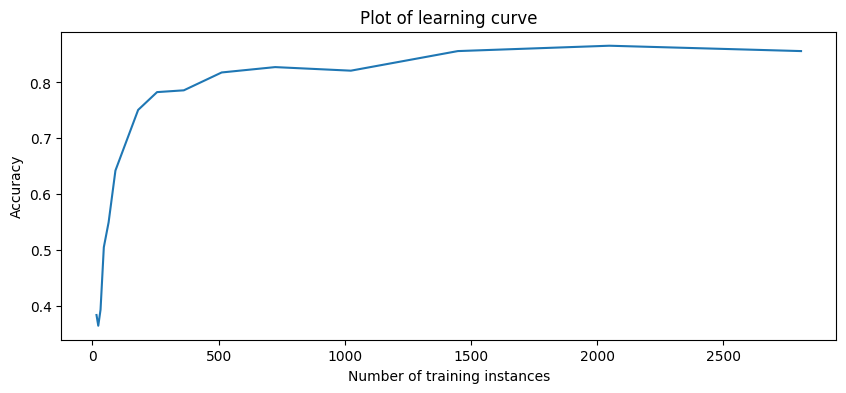

130it [05:29,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1042;non-monotonic:True


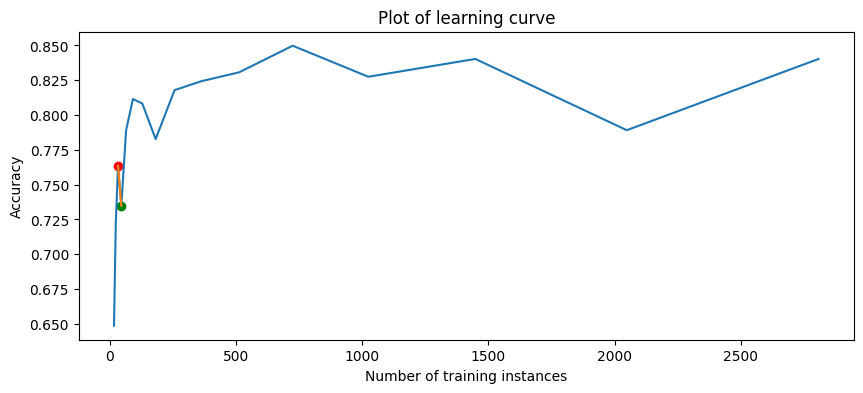

131it [05:32,  2.65s/it]

sklearn.linear_model.SGDClassifier_on_1049;non-monotonic:True


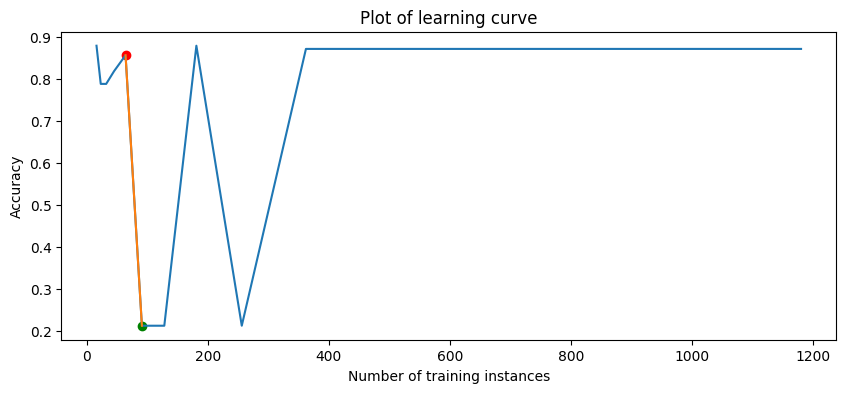

132it [05:35,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_1050;non-monotonic:True


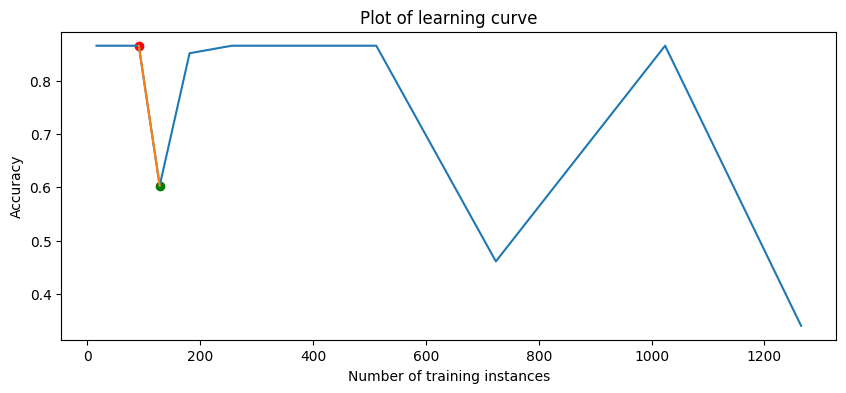

133it [05:37,  2.54s/it]

sklearn.linear_model.SGDClassifier_on_1053;non-monotonic:True


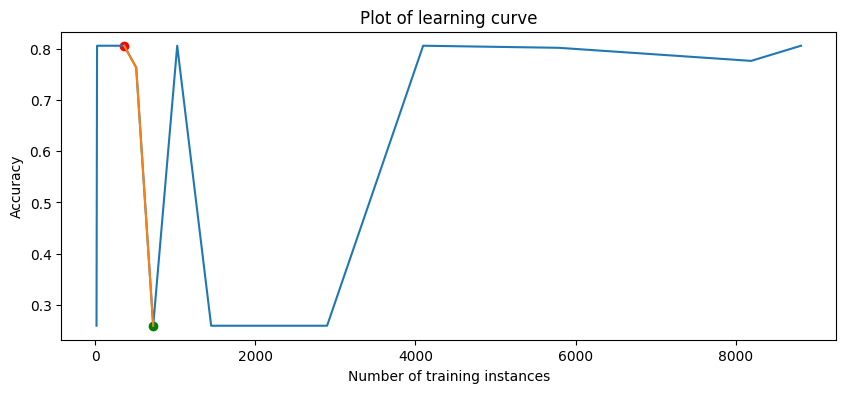

134it [05:39,  2.45s/it]

sklearn.linear_model.SGDClassifier_on_1056;non-monotonic:True


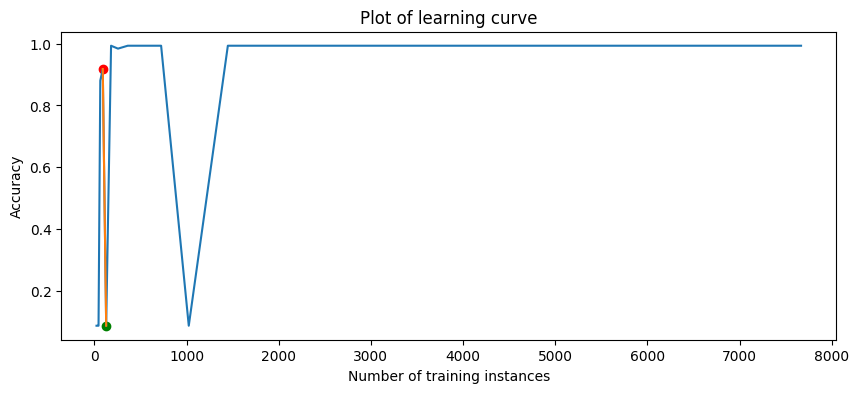

135it [05:42,  2.52s/it]

sklearn.linear_model.SGDClassifier_on_1067;non-monotonic:True


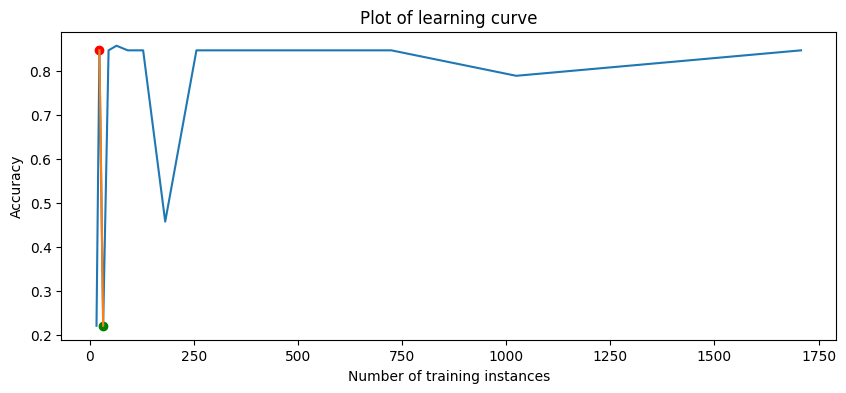

136it [05:44,  2.45s/it]

sklearn.linear_model.SGDClassifier_on_1068;non-monotonic:True


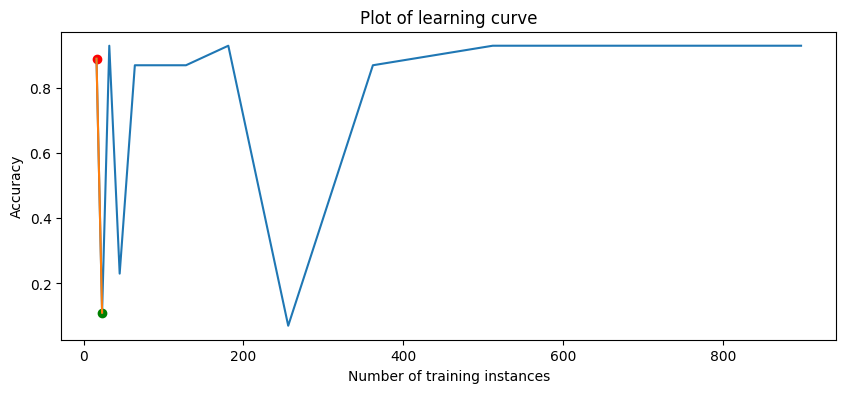

137it [05:46,  2.37s/it]

sklearn.linear_model.SGDClassifier_on_1069;non-monotonic:True


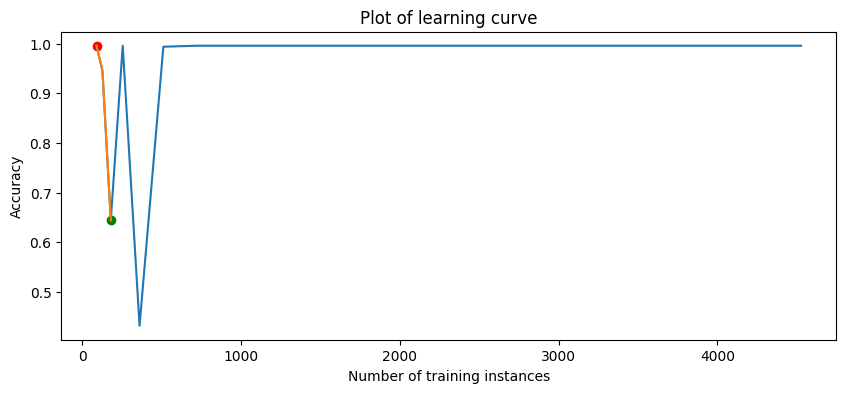

138it [05:49,  2.45s/it]

sklearn.linear_model.SGDClassifier_on_1083;non-monotonic:True


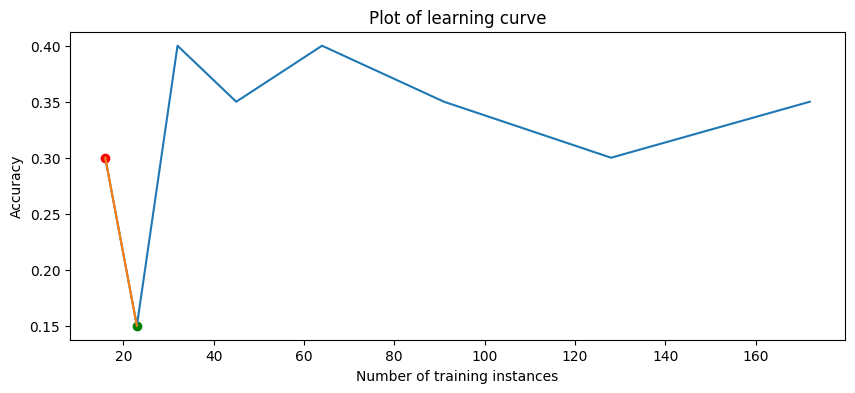

139it [05:51,  2.39s/it]

sklearn.linear_model.SGDClassifier_on_1084;non-monotonic:True


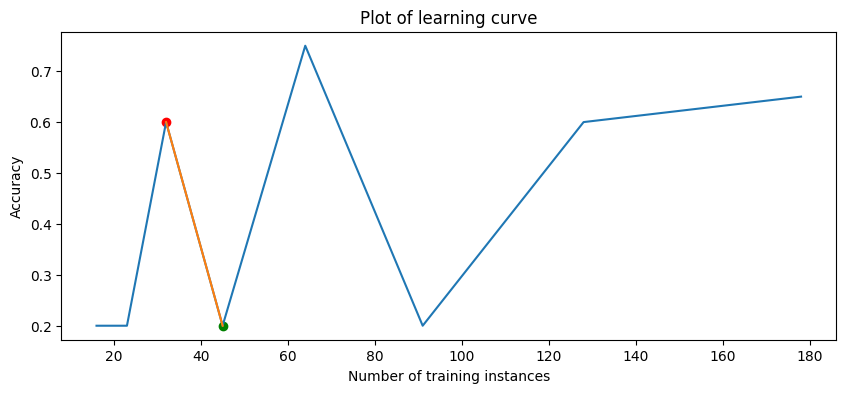

140it [05:53,  2.35s/it]

sklearn.linear_model.SGDClassifier_on_1085;non-monotonic:True


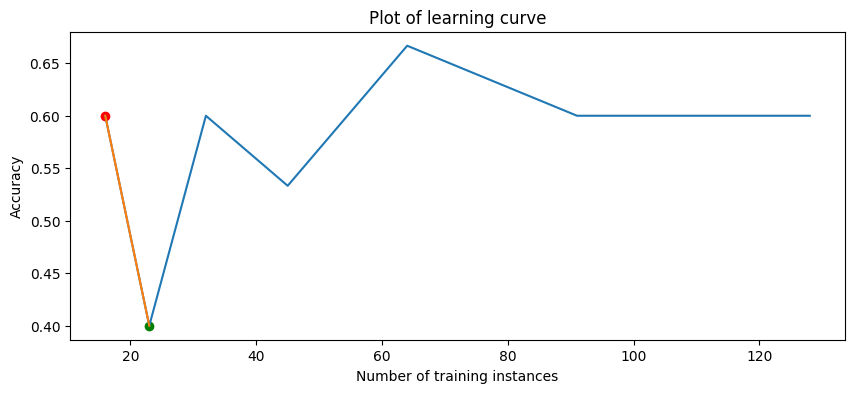

141it [05:56,  2.45s/it]

sklearn.linear_model.SGDClassifier_on_1086;non-monotonic:True


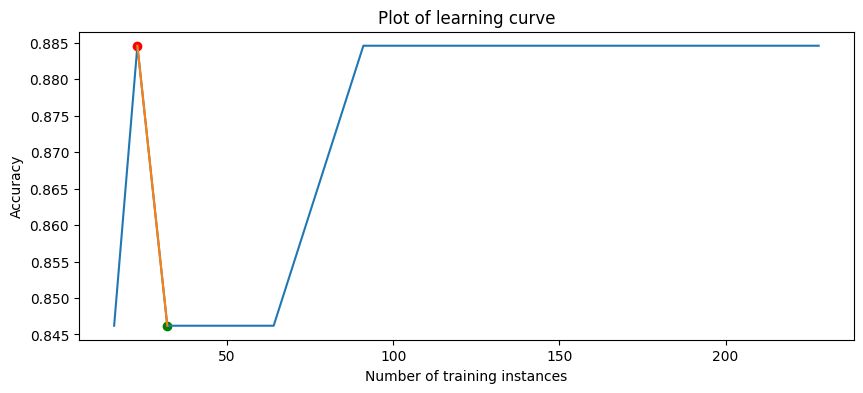

142it [05:59,  2.53s/it]

sklearn.linear_model.SGDClassifier_on_1087;non-monotonic:True


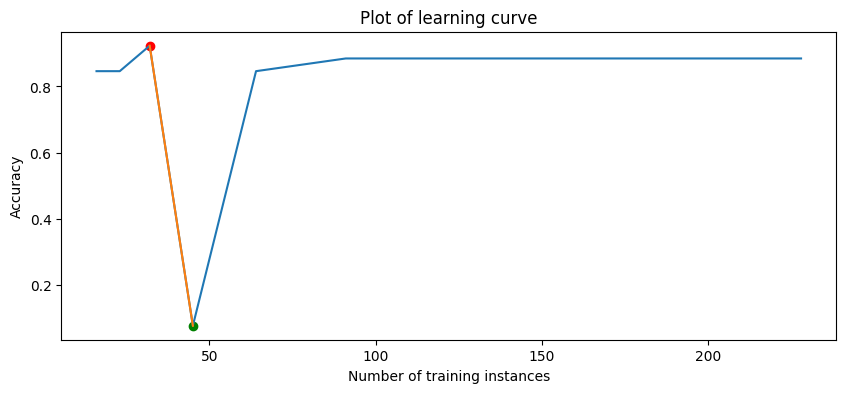

143it [06:01,  2.54s/it]

sklearn.linear_model.SGDClassifier_on_1088;non-monotonic:True


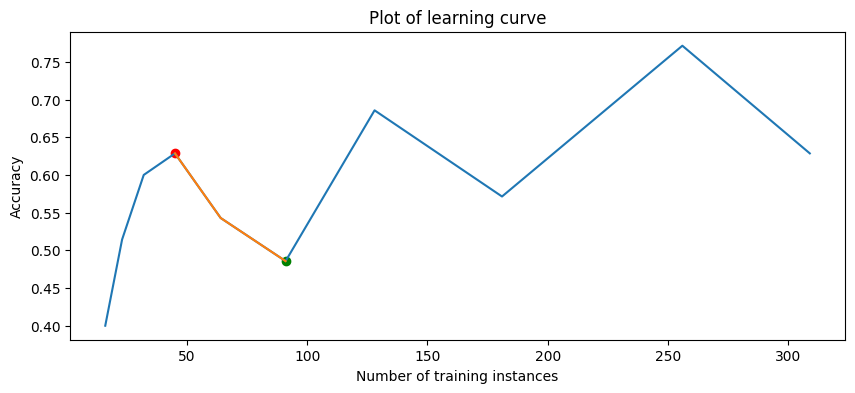

144it [06:04,  2.59s/it]

sklearn.linear_model.SGDClassifier_on_1111;non-monotonic:True


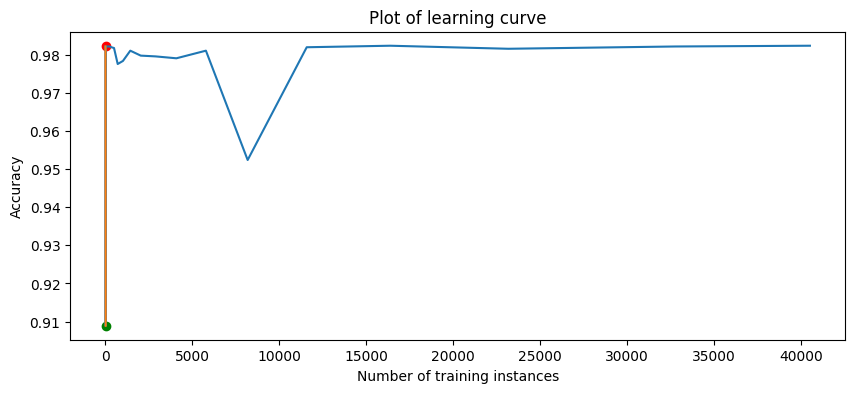

145it [06:07,  2.60s/it]

sklearn.linear_model.SGDClassifier_on_1112;non-monotonic:True


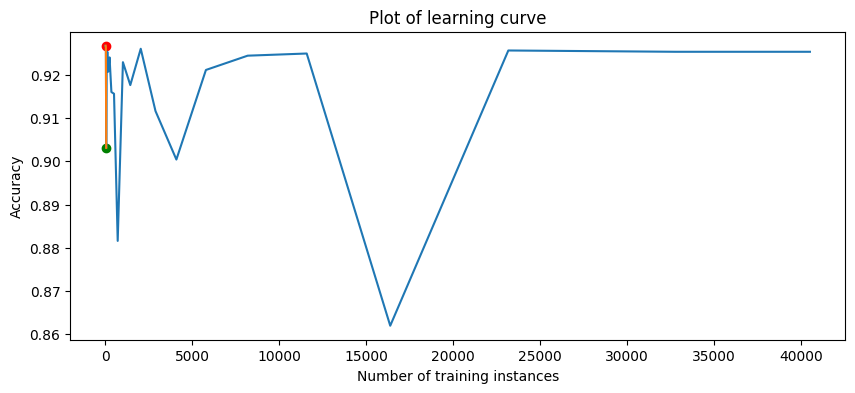

146it [06:09,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_1114;non-monotonic:True


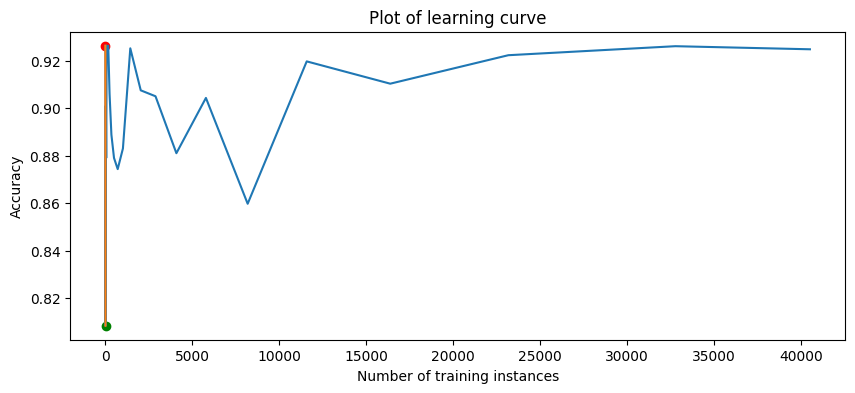

147it [06:12,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1116;non-monotonic:True


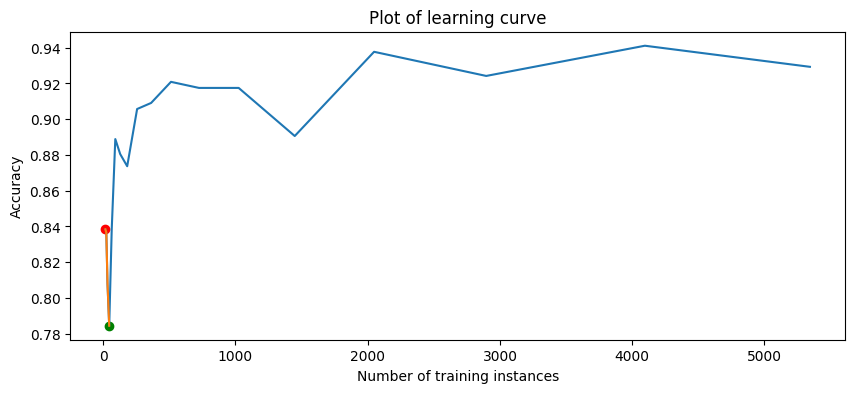

148it [06:15,  2.60s/it]

sklearn.linear_model.SGDClassifier_on_1119;non-monotonic:True


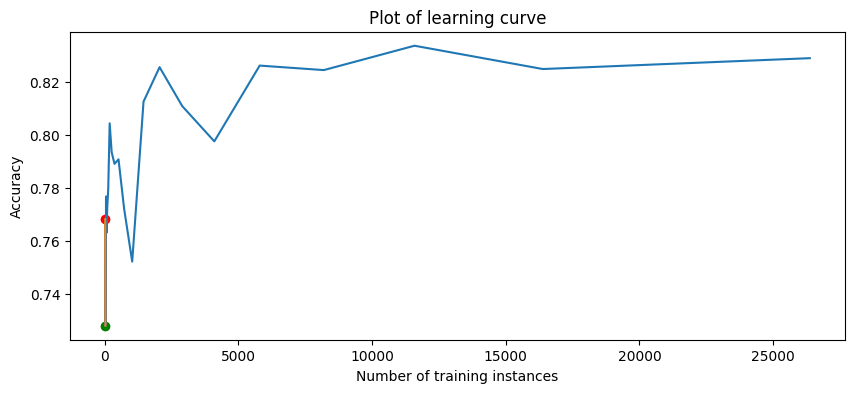

149it [06:17,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_1120;non-monotonic:True


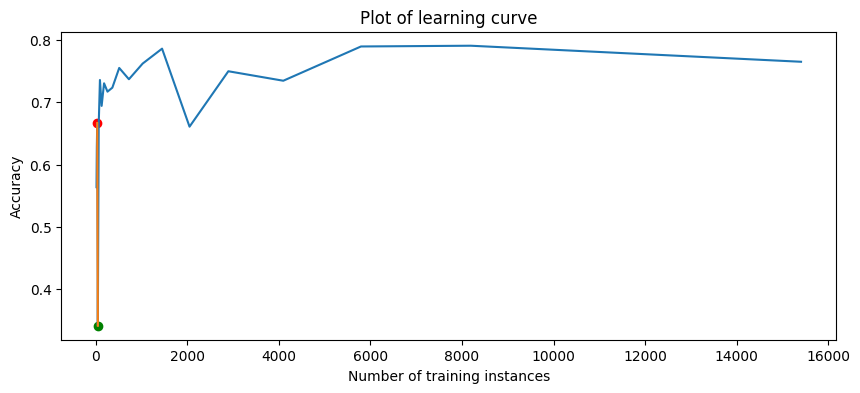

150it [06:20,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_1128;non-monotonic:True


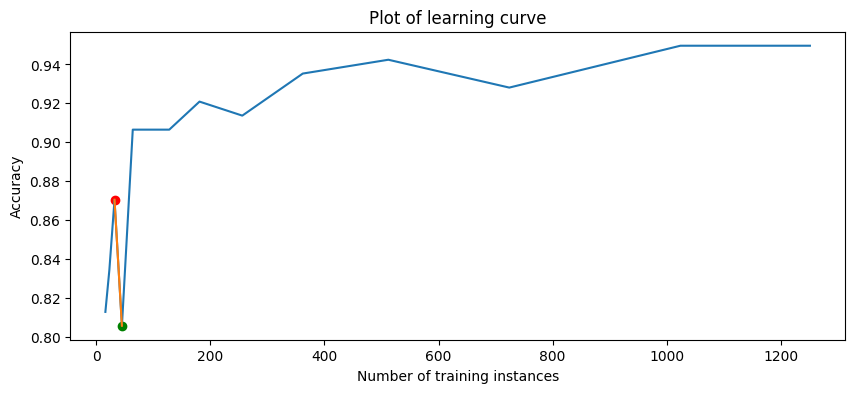

151it [06:22,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1130;non-monotonic:False


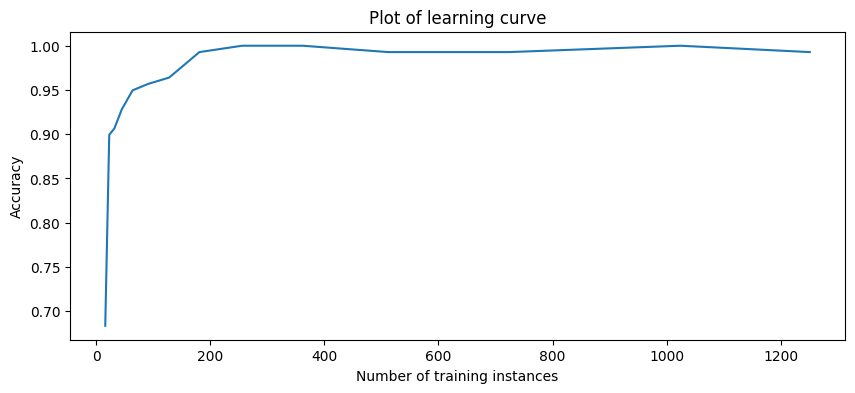

152it [06:25,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_1134;non-monotonic:True


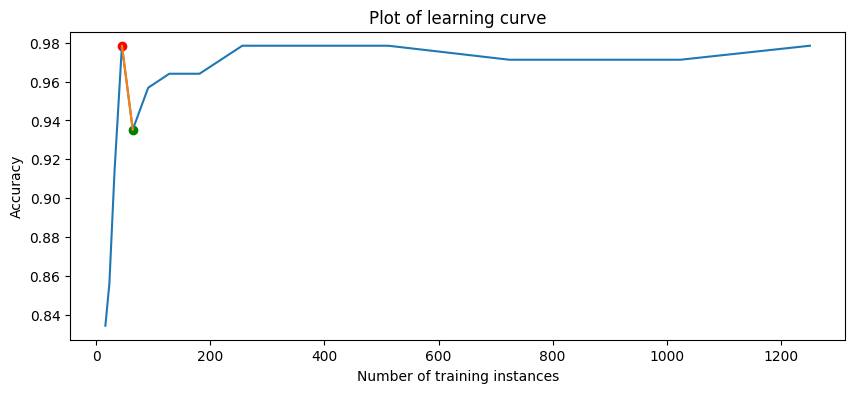

153it [06:28,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1138;non-monotonic:True


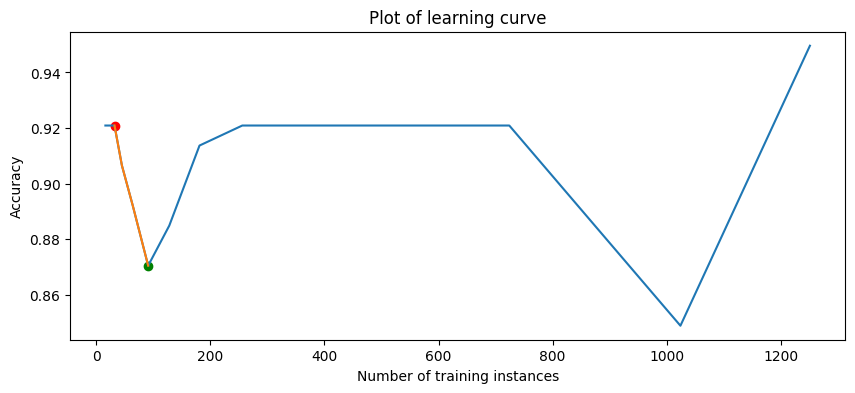

154it [06:30,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1139;non-monotonic:True


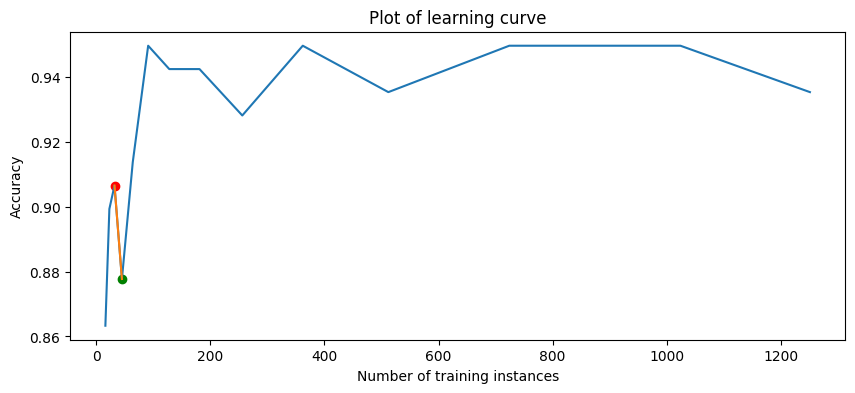

155it [06:33,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_1142;non-monotonic:True


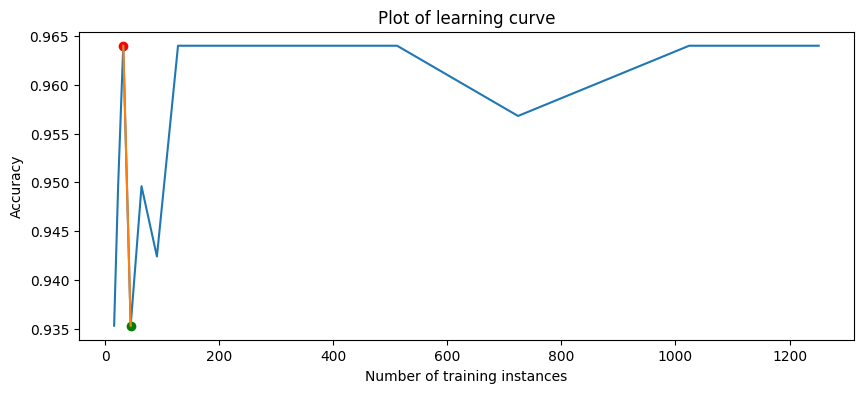

156it [06:36,  2.63s/it]

sklearn.linear_model.SGDClassifier_on_1146;non-monotonic:True


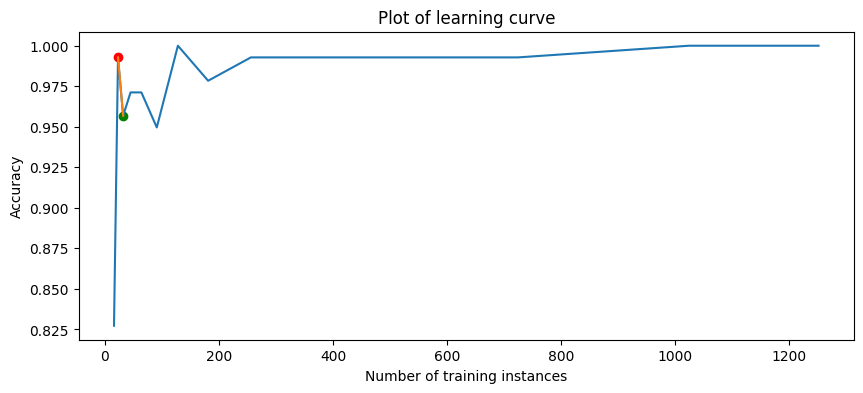

157it [06:39,  2.73s/it]

sklearn.linear_model.SGDClassifier_on_1161;non-monotonic:True


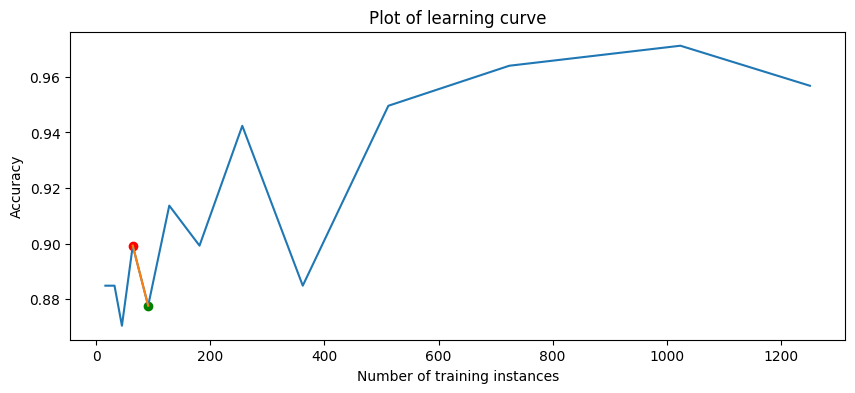

158it [06:41,  2.75s/it]

sklearn.linear_model.SGDClassifier_on_1166;non-monotonic:True


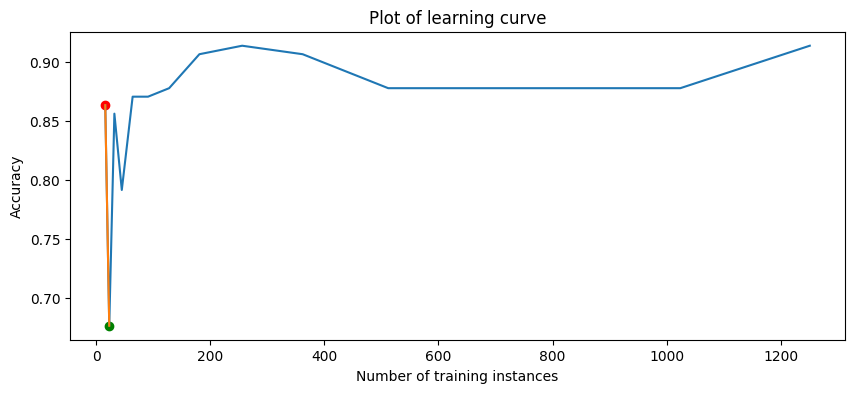

159it [06:44,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_1216;non-monotonic:True


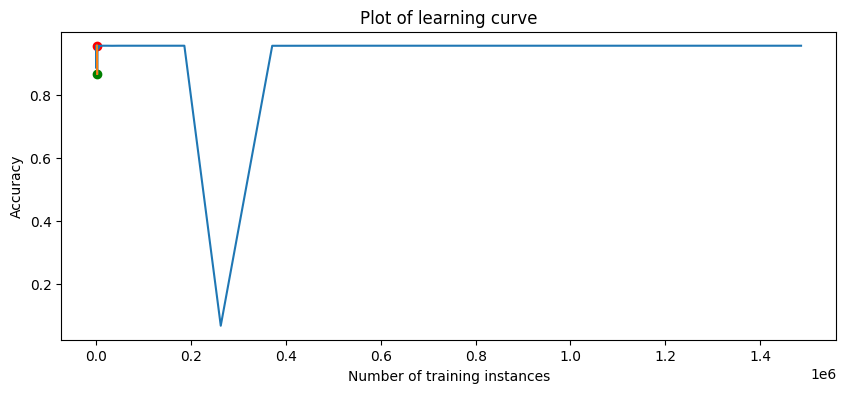

160it [06:46,  2.52s/it]

sklearn.linear_model.SGDClassifier_on_1233;non-monotonic:True


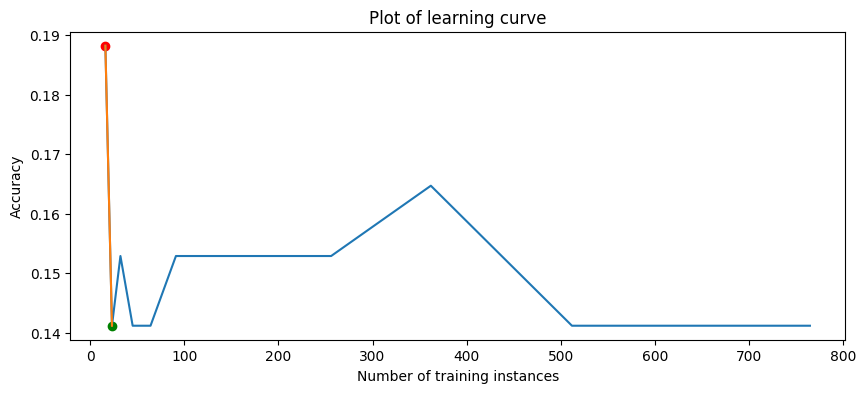

161it [06:49,  2.59s/it]

sklearn.linear_model.SGDClassifier_on_1235;non-monotonic:True


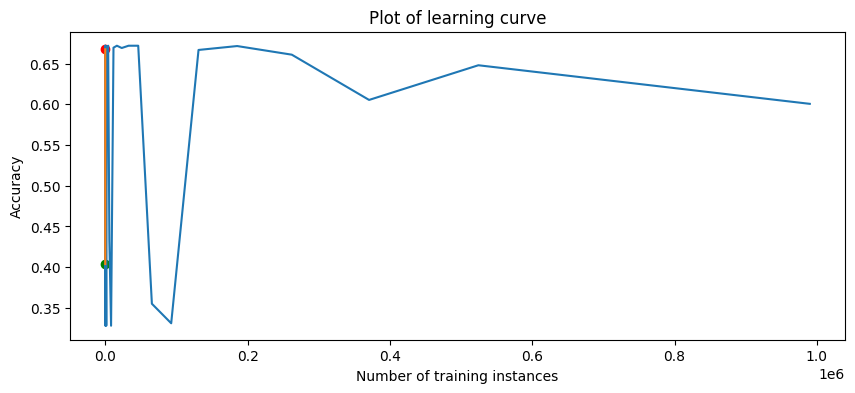

162it [06:51,  2.60s/it]

sklearn.linear_model.SGDClassifier_on_1236;non-monotonic:False


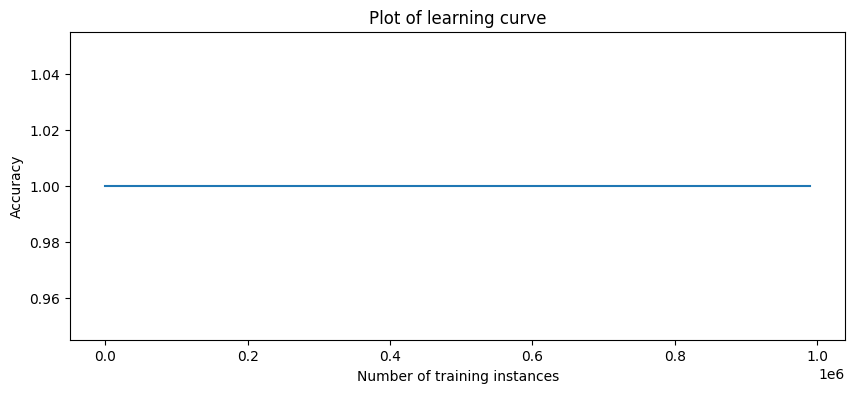

163it [06:54,  2.60s/it]

sklearn.linear_model.SGDClassifier_on_1441;non-monotonic:True


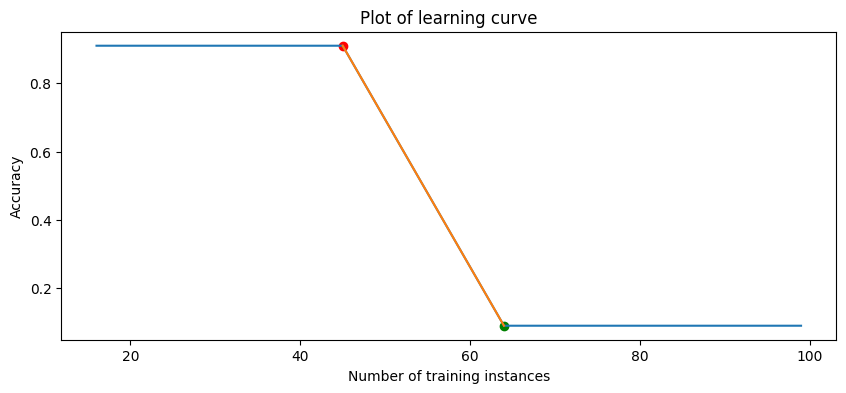

164it [06:57,  2.60s/it]

sklearn.linear_model.SGDClassifier_on_1448;non-monotonic:True


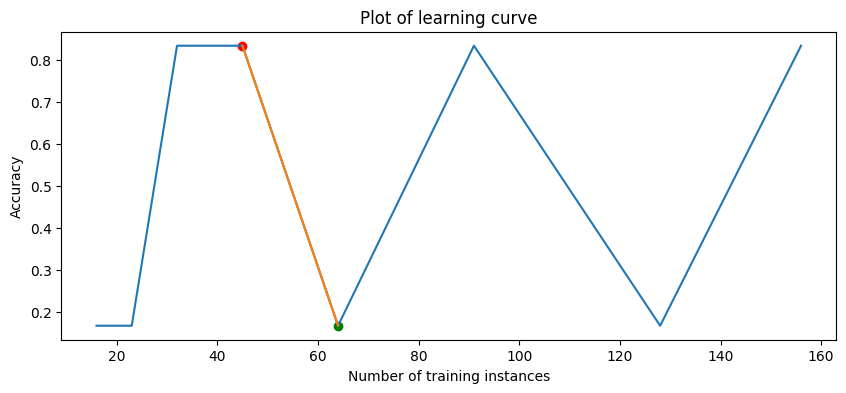

165it [06:59,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1450;non-monotonic:True


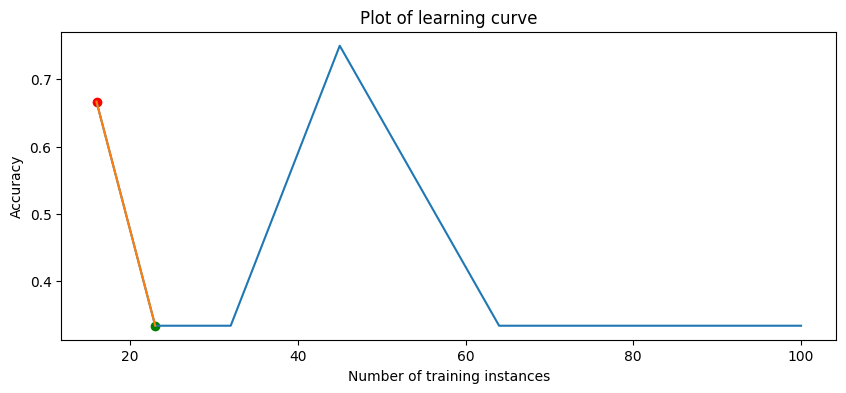

166it [07:01,  2.51s/it]

sklearn.linear_model.SGDClassifier_on_1457;non-monotonic:False


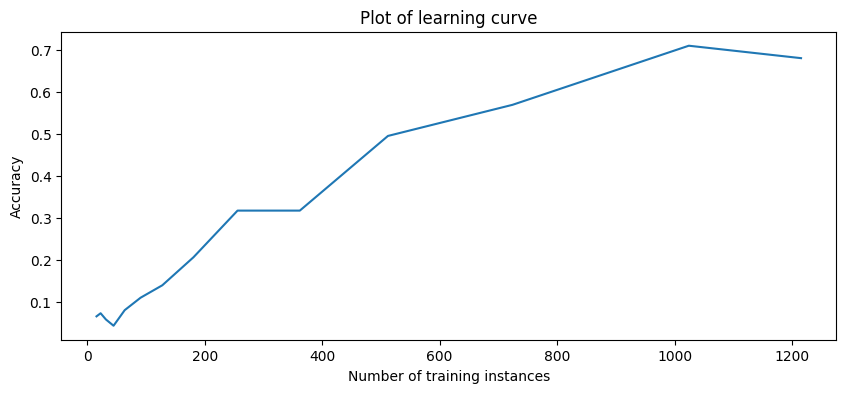

167it [07:04,  2.53s/it]

sklearn.linear_model.SGDClassifier_on_1461;non-monotonic:True


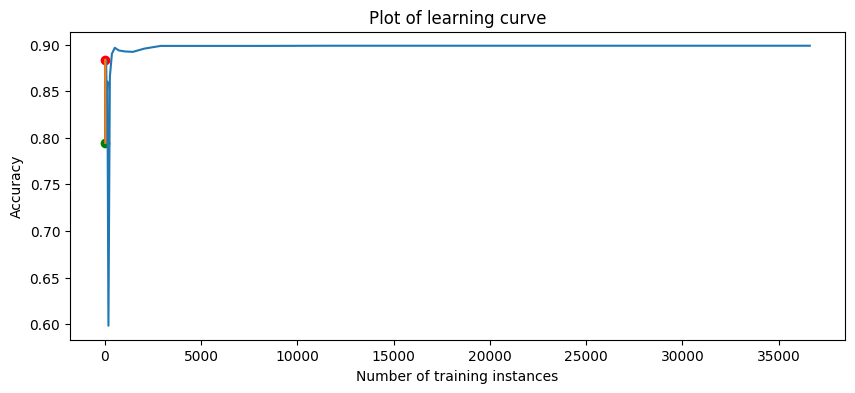

168it [07:07,  2.58s/it]

sklearn.linear_model.SGDClassifier_on_1464;non-monotonic:True


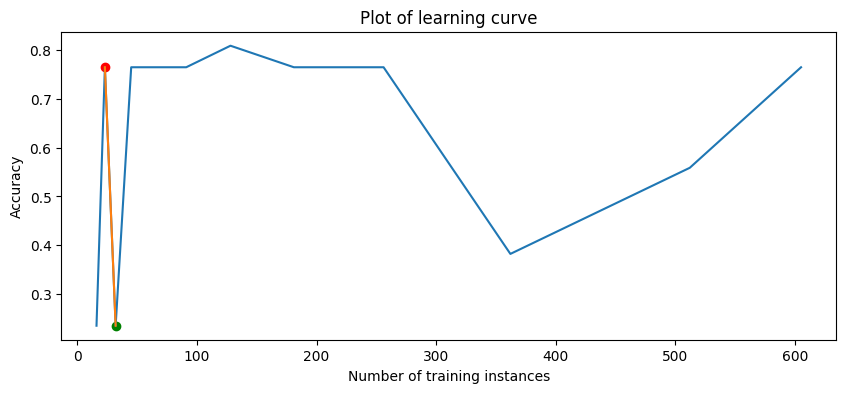

169it [07:09,  2.49s/it]

sklearn.linear_model.SGDClassifier_on_1465;non-monotonic:True


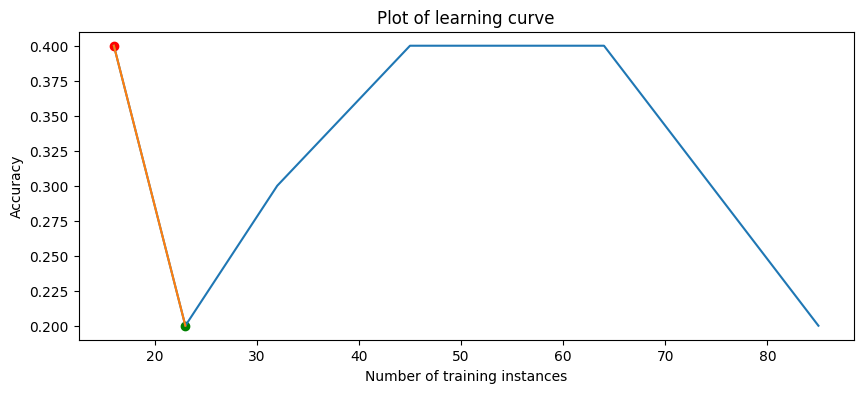

170it [07:11,  2.43s/it]

sklearn.linear_model.SGDClassifier_on_1468;non-monotonic:False


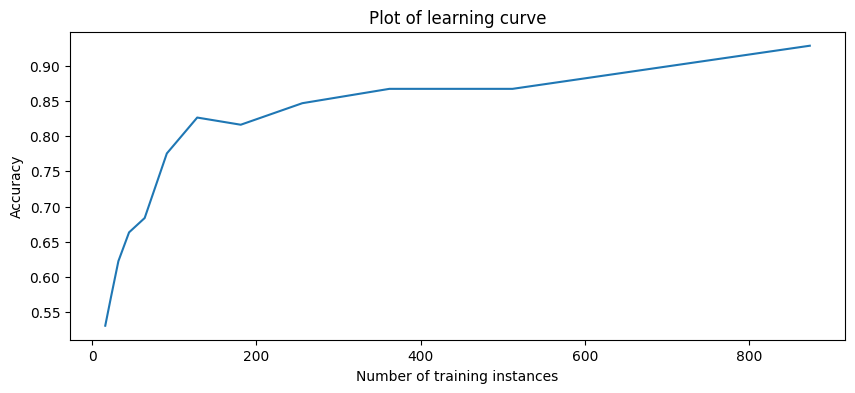

171it [07:14,  2.47s/it]

sklearn.linear_model.SGDClassifier_on_1475;non-monotonic:True


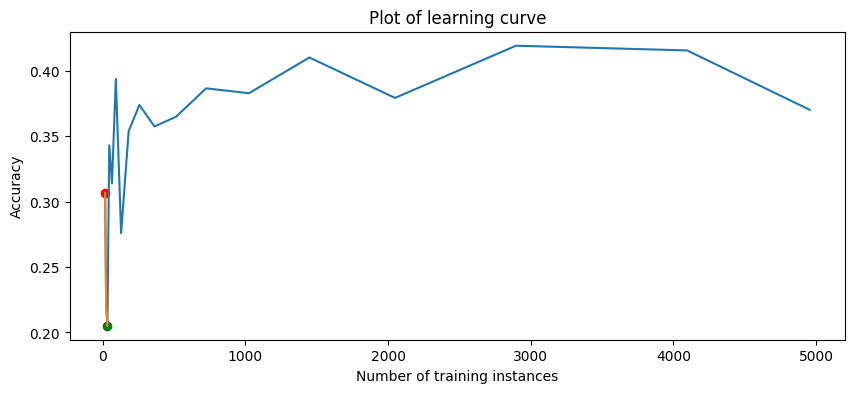

172it [07:16,  2.42s/it]

sklearn.linear_model.SGDClassifier_on_1477;non-monotonic:True


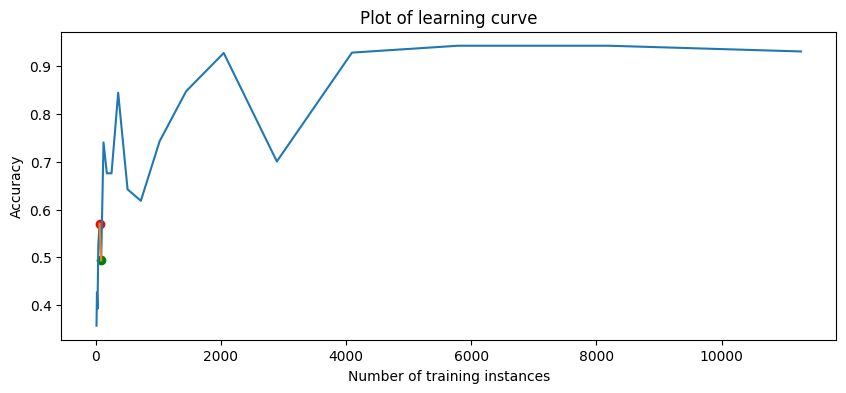

173it [07:18,  2.38s/it]

sklearn.linear_model.SGDClassifier_on_1479;non-monotonic:True


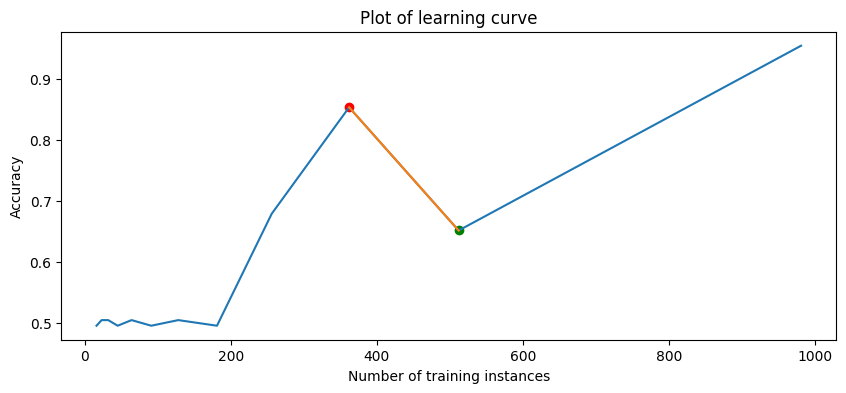

174it [07:21,  2.46s/it]

sklearn.linear_model.SGDClassifier_on_1483;non-monotonic:True


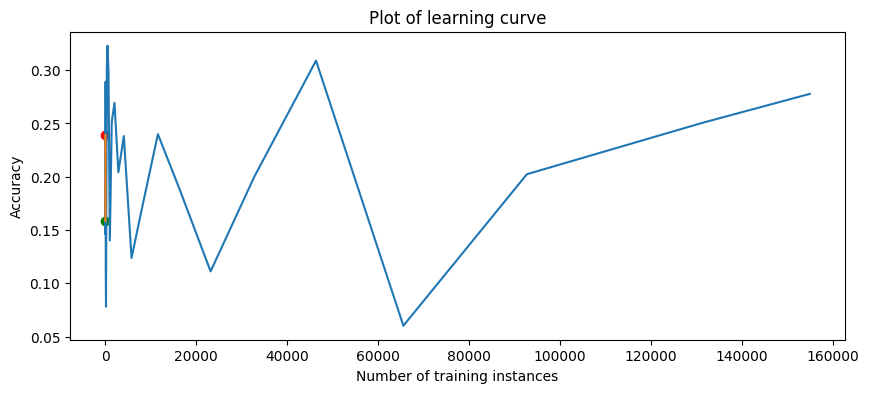

175it [07:24,  2.51s/it]

sklearn.linear_model.SGDClassifier_on_1485;non-monotonic:True


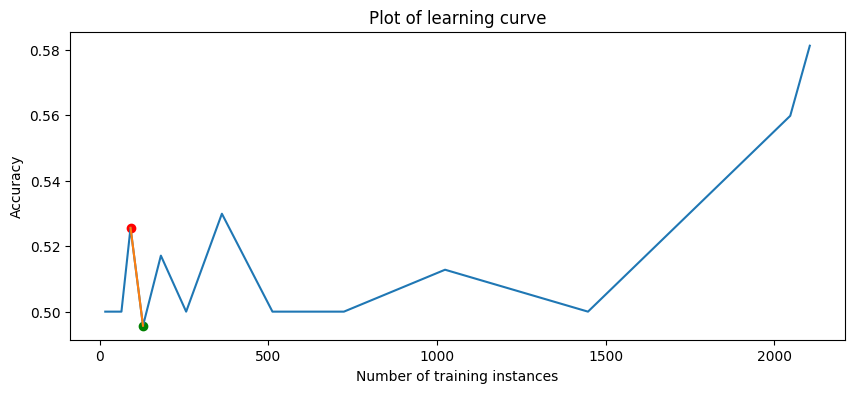

176it [07:26,  2.55s/it]

sklearn.linear_model.SGDClassifier_on_1486;non-monotonic:True


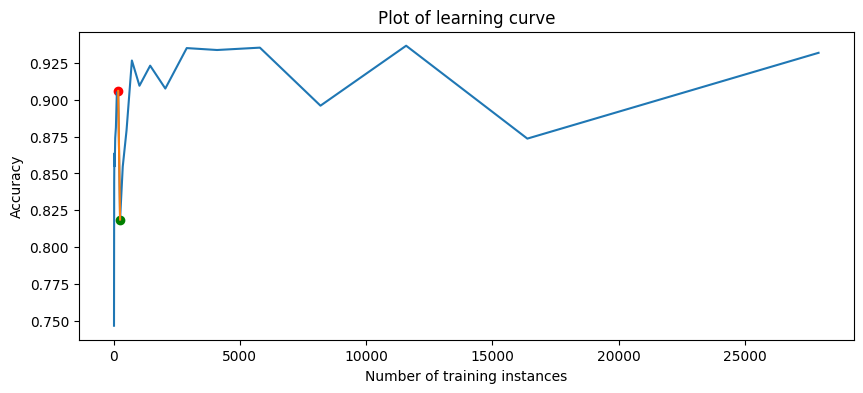

177it [07:29,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1487;non-monotonic:True


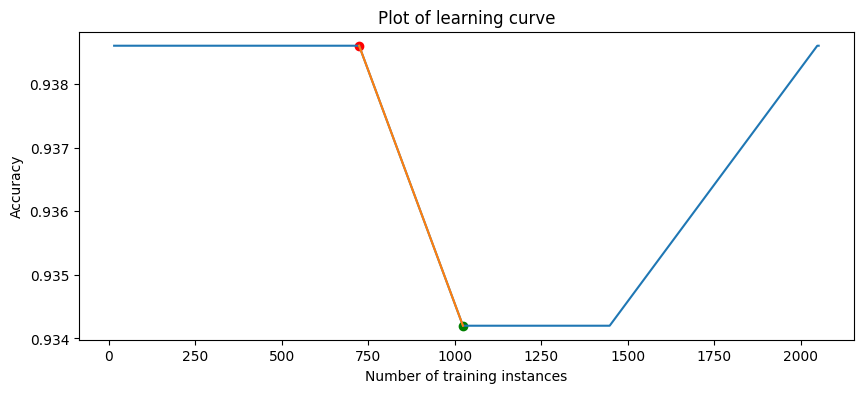

178it [07:32,  2.60s/it]

sklearn.linear_model.SGDClassifier_on_1488;non-monotonic:True


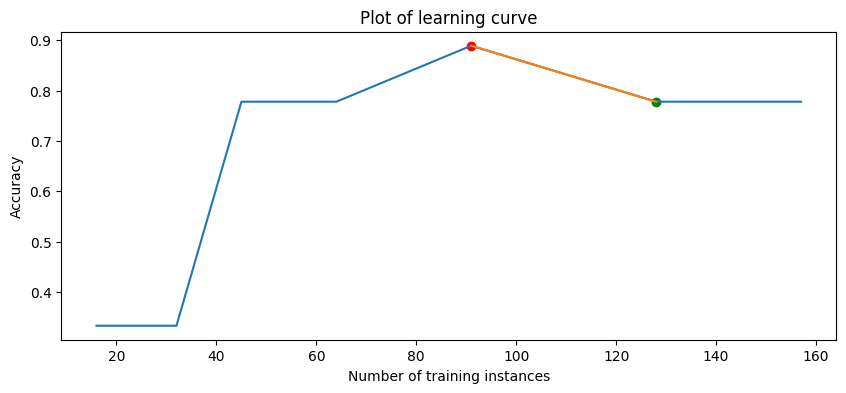

179it [07:34,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_1489;non-monotonic:True


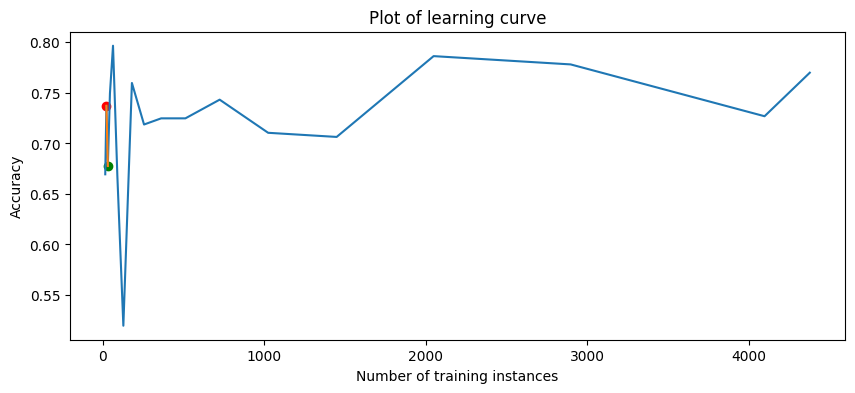

180it [07:37,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_1494;non-monotonic:True


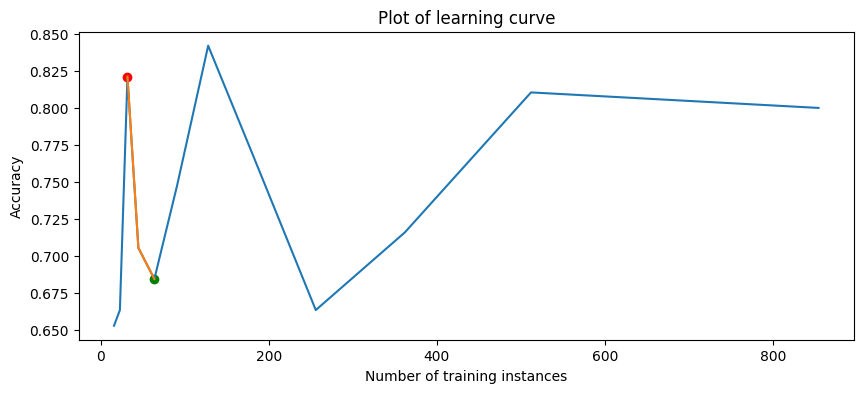

181it [07:40,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1499;non-monotonic:True


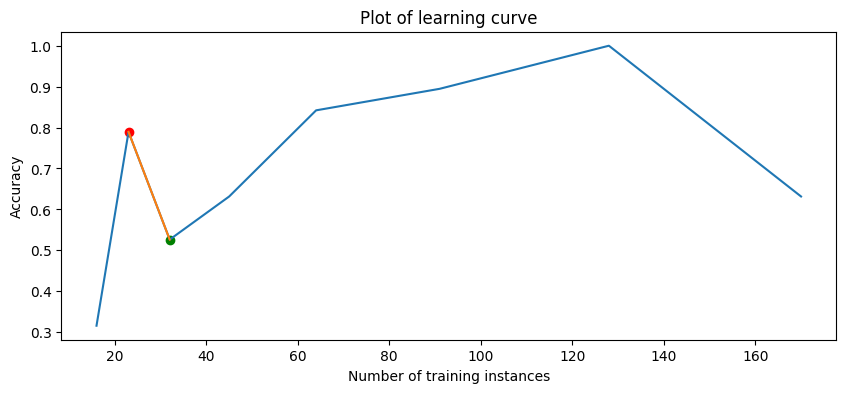

182it [07:42,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1503;non-monotonic:True


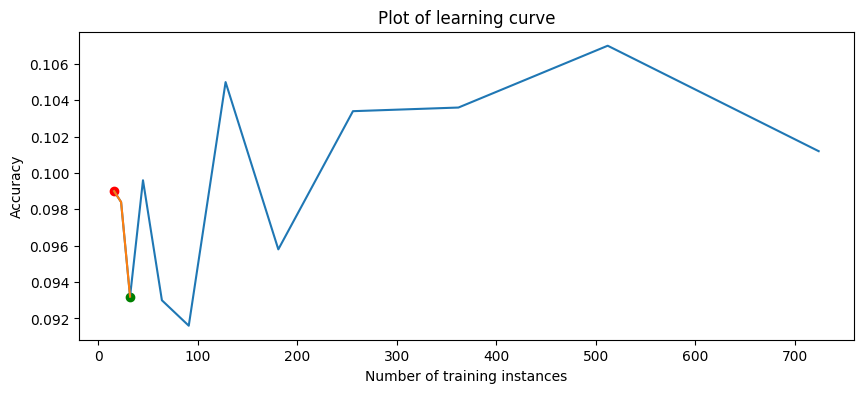

183it [07:45,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1509;non-monotonic:True


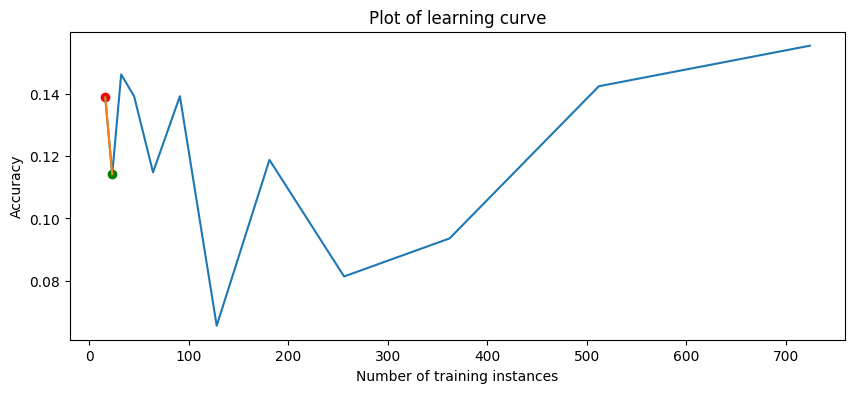

184it [07:47,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_1515;non-monotonic:False


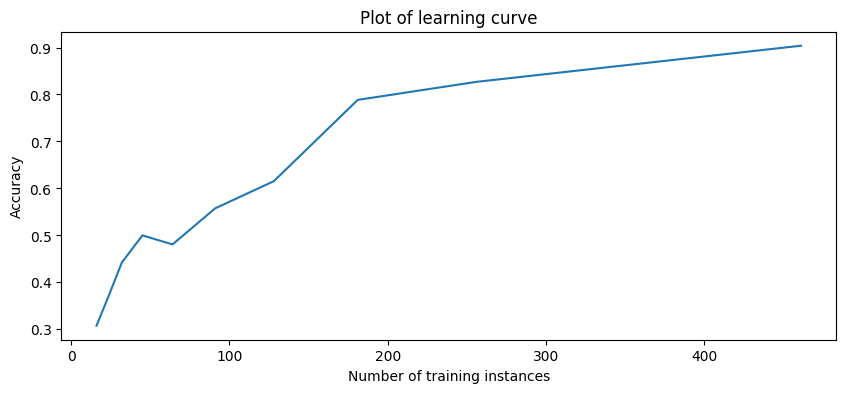

185it [07:50,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_1566;non-monotonic:True


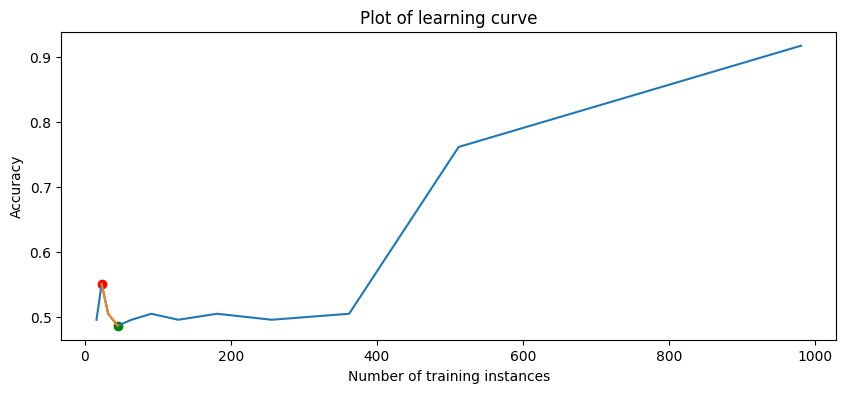

186it [07:53,  2.63s/it]

sklearn.linear_model.SGDClassifier_on_1567;non-monotonic:True


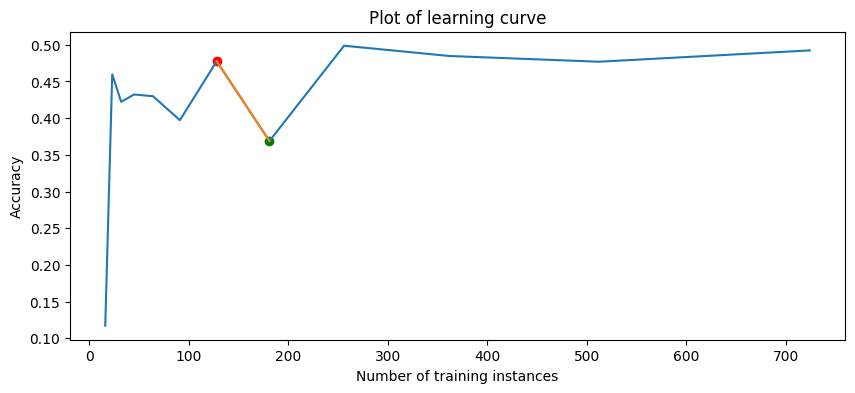

187it [07:55,  2.65s/it]

sklearn.linear_model.SGDClassifier_on_1575;non-monotonic:True


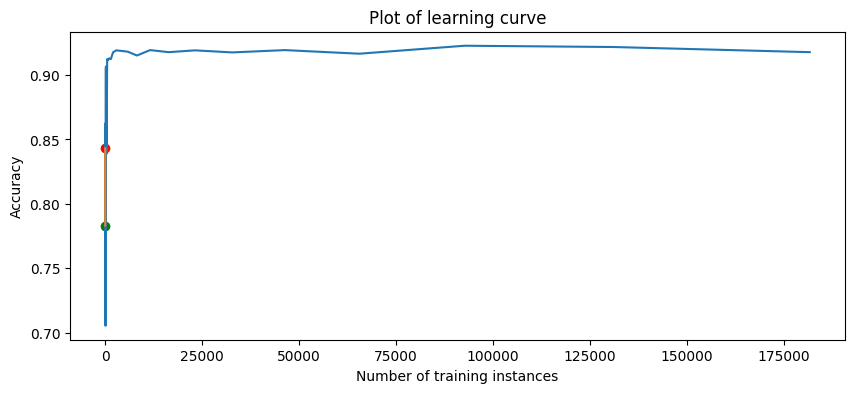

188it [07:58,  2.66s/it]

sklearn.linear_model.SGDClassifier_on_1590;non-monotonic:True


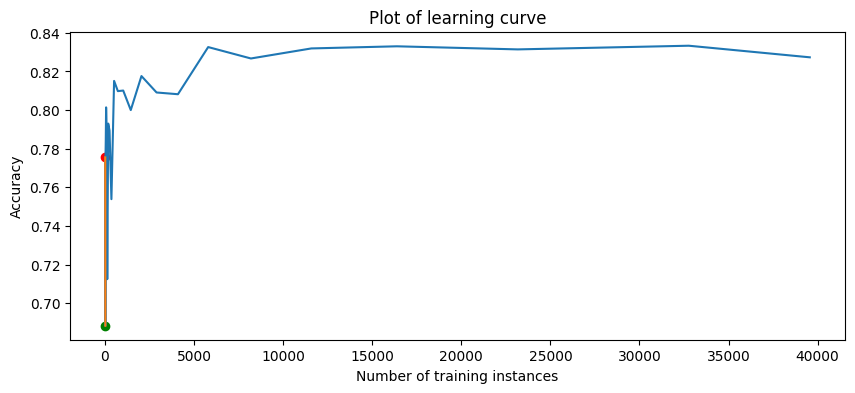

189it [08:01,  2.68s/it]

sklearn.linear_model.SGDClassifier_on_1592;non-monotonic:False


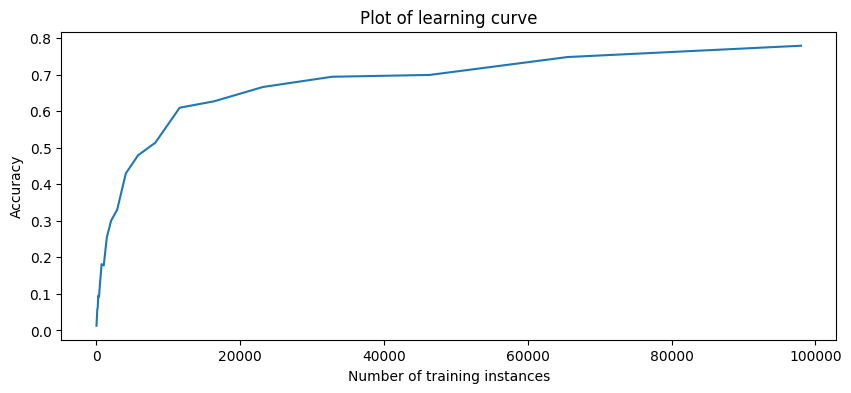

190it [08:04,  2.69s/it]

sklearn.linear_model.SGDClassifier_on_1597;non-monotonic:True


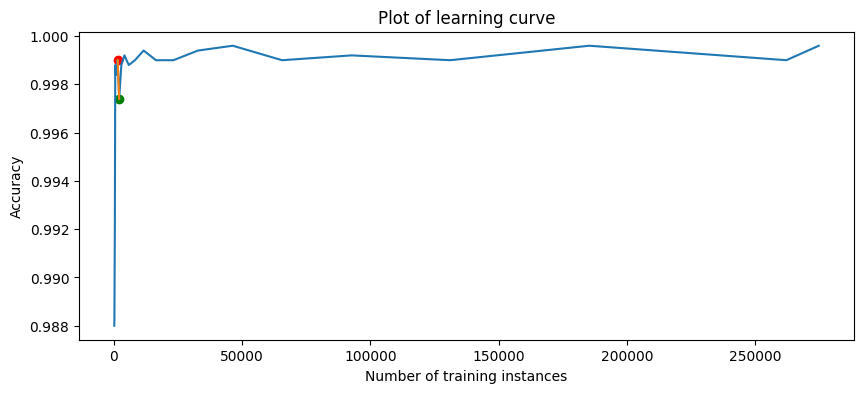

191it [08:06,  2.66s/it]

sklearn.linear_model.SGDClassifier_on_4134;non-monotonic:True


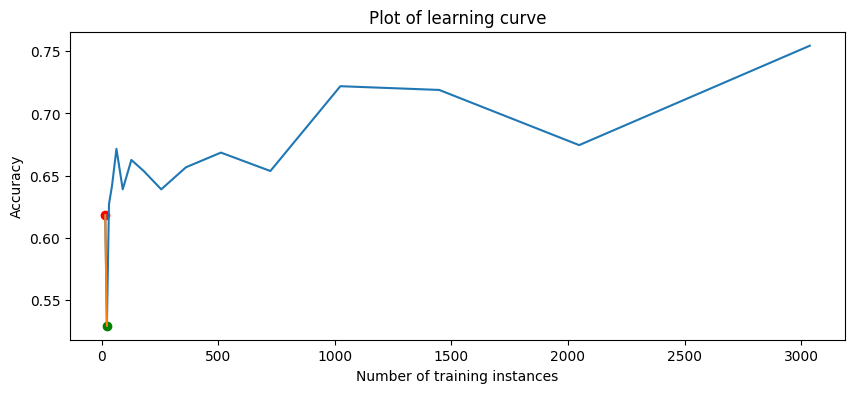

192it [08:09,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_4135;non-monotonic:True


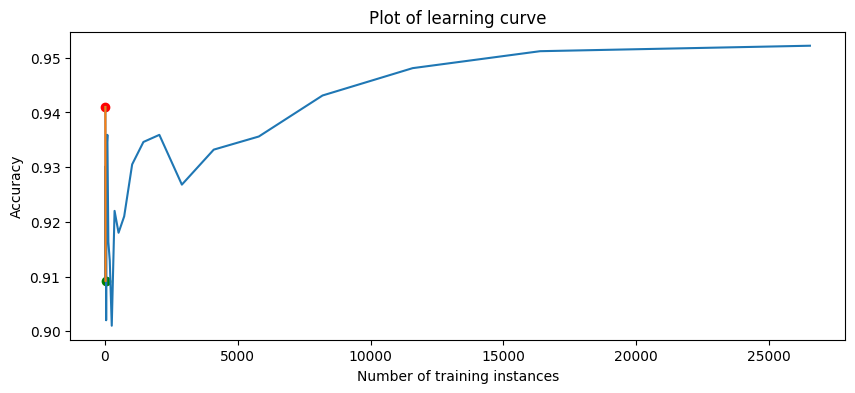

193it [08:11,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_4137;non-monotonic:True


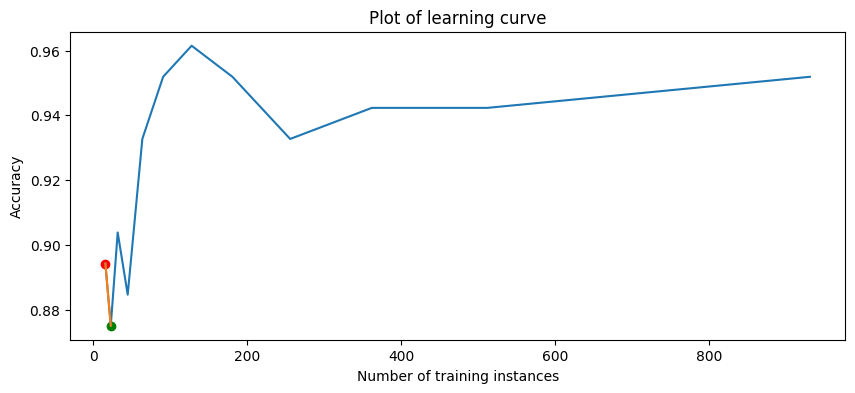

194it [08:14,  2.63s/it]

sklearn.linear_model.SGDClassifier_on_4534;non-monotonic:True


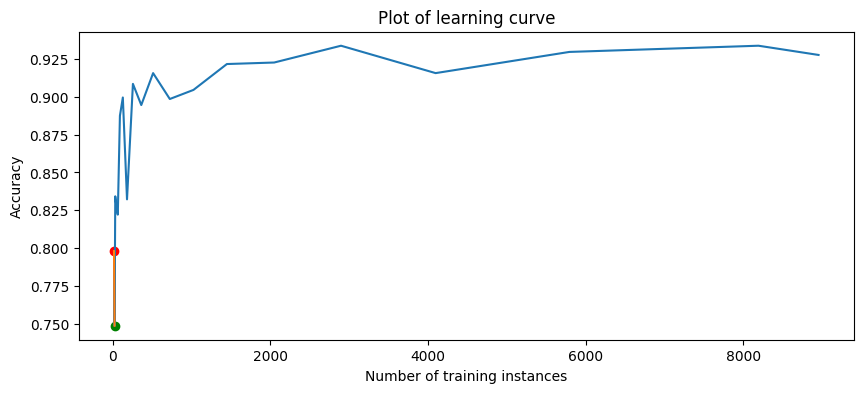

195it [08:17,  2.65s/it]

sklearn.linear_model.SGDClassifier_on_4538;non-monotonic:True


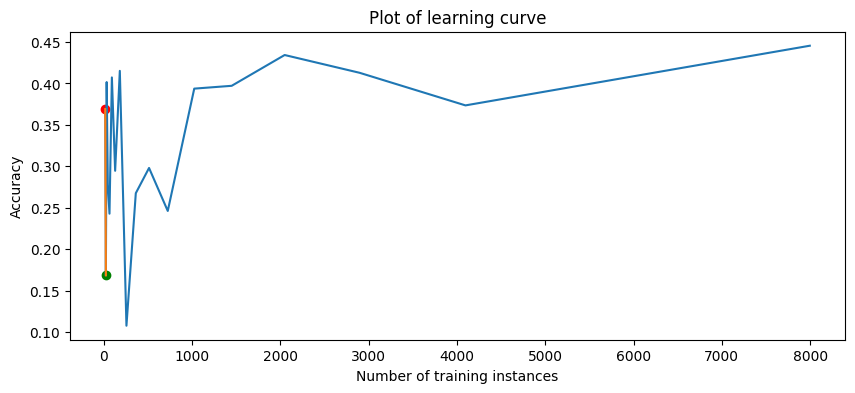

196it [08:19,  2.66s/it]

sklearn.linear_model.SGDClassifier_on_4541;non-monotonic:True


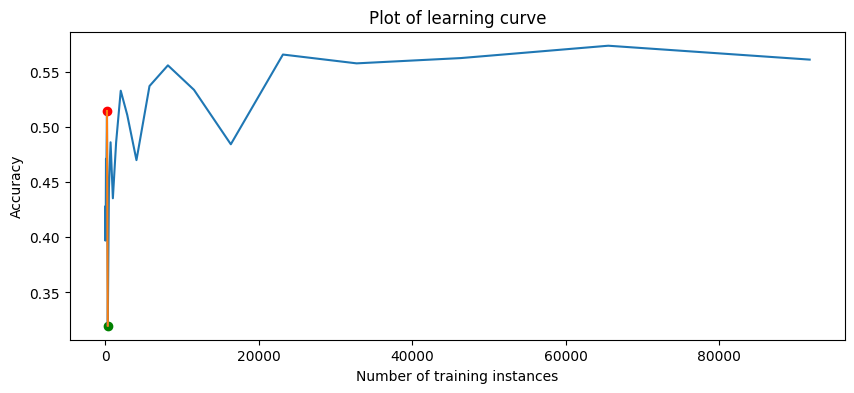

197it [08:22,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_23512;non-monotonic:True


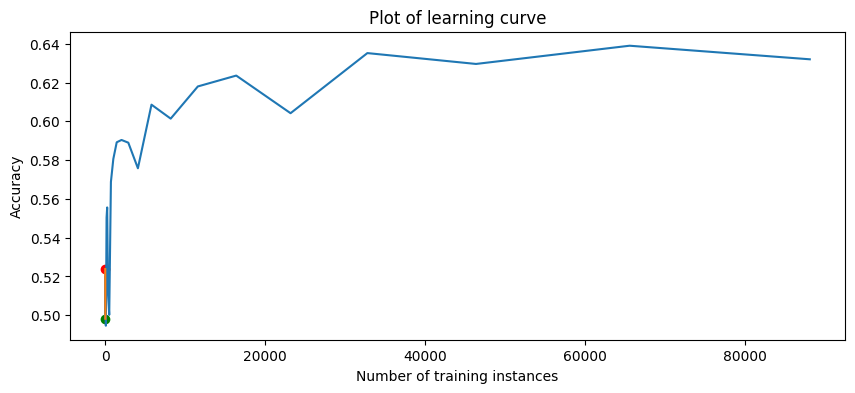

198it [08:25,  2.63s/it]

sklearn.linear_model.SGDClassifier_on_23517;non-monotonic:True


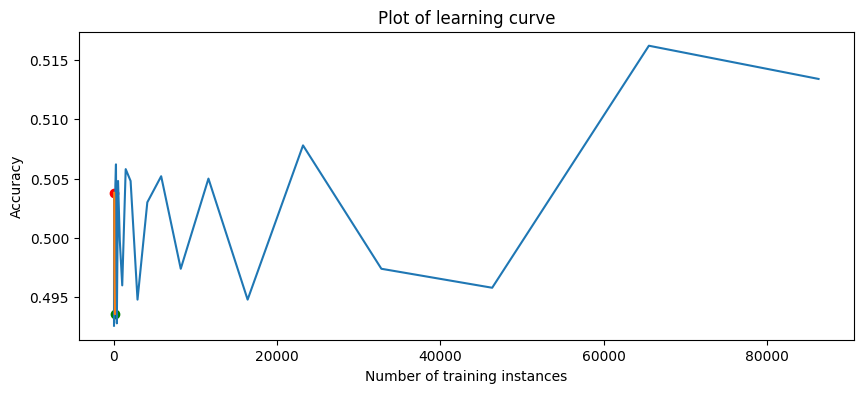

199it [08:27,  2.57s/it]

sklearn.linear_model.SGDClassifier_on_40498;non-monotonic:True


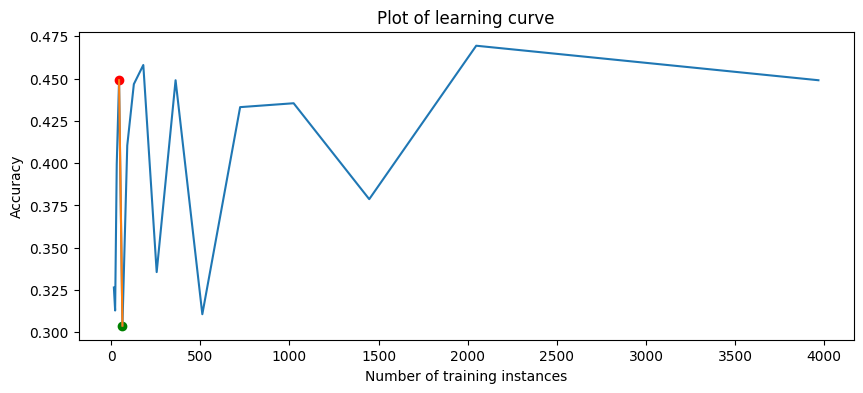

200it [08:29,  2.51s/it]

sklearn.linear_model.SGDClassifier_on_40664;non-monotonic:True


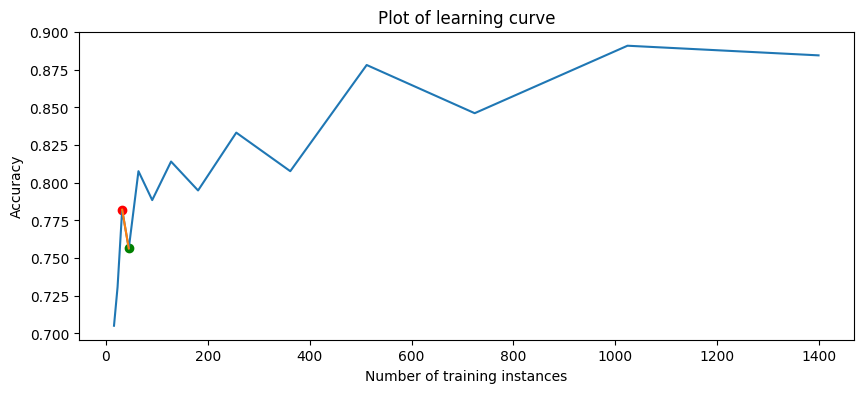

201it [08:32,  2.55s/it]

sklearn.linear_model.SGDClassifier_on_40668;non-monotonic:True


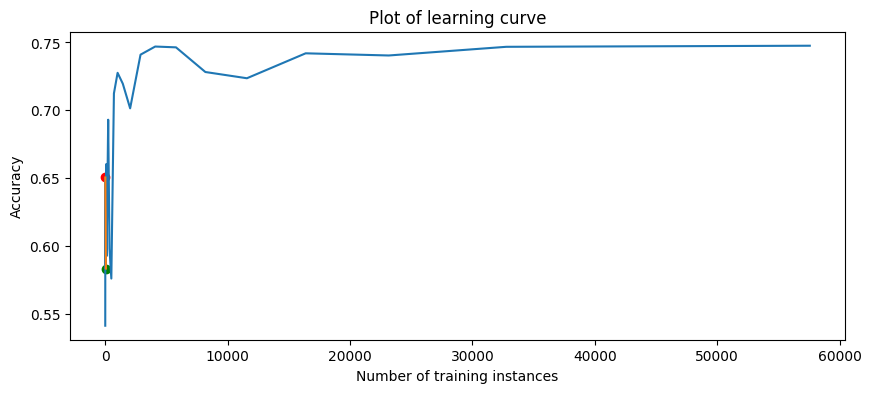

202it [08:35,  2.57s/it]

sklearn.linear_model.SGDClassifier_on_40670;non-monotonic:False


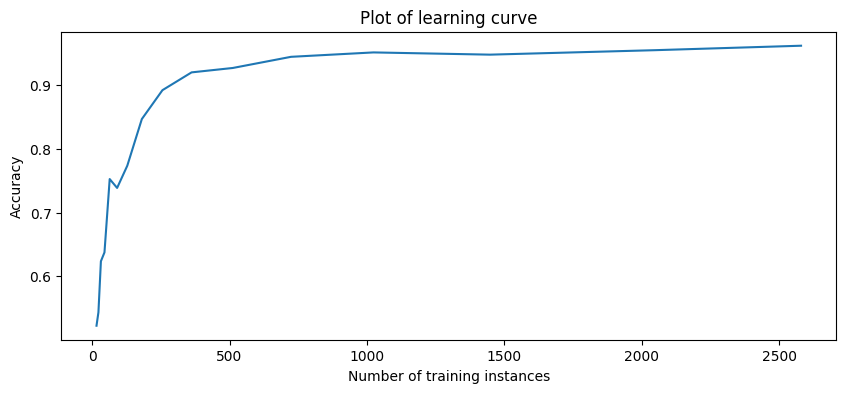

203it [08:37,  2.58s/it]

sklearn.linear_model.SGDClassifier_on_40672;non-monotonic:True


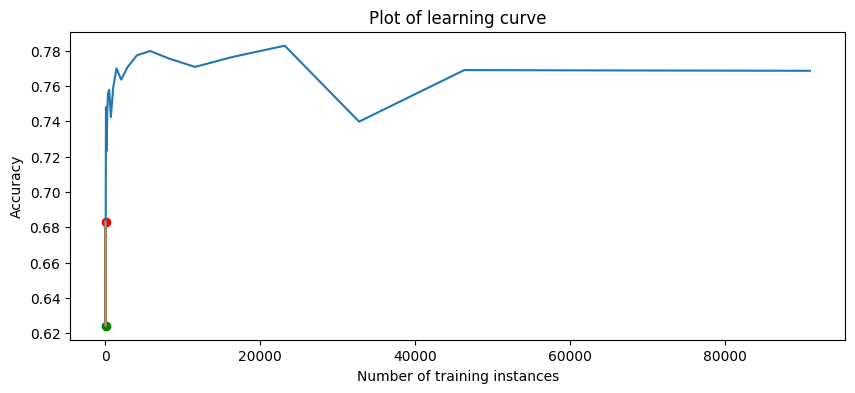

204it [08:40,  2.65s/it]

sklearn.linear_model.SGDClassifier_on_40677;non-monotonic:True


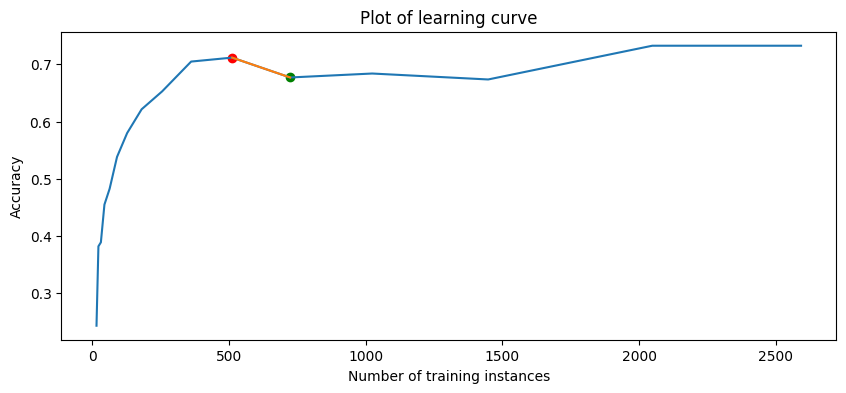

205it [08:43,  2.69s/it]

sklearn.linear_model.SGDClassifier_on_40685;non-monotonic:True


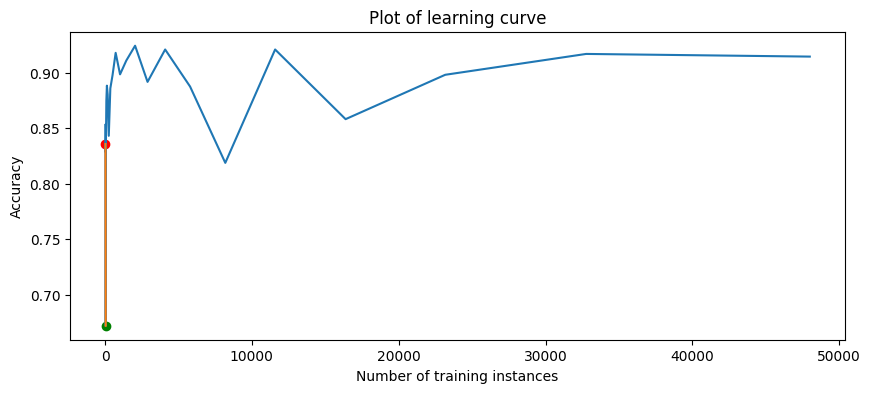

206it [08:45,  2.68s/it]

sklearn.linear_model.SGDClassifier_on_40687;non-monotonic:True


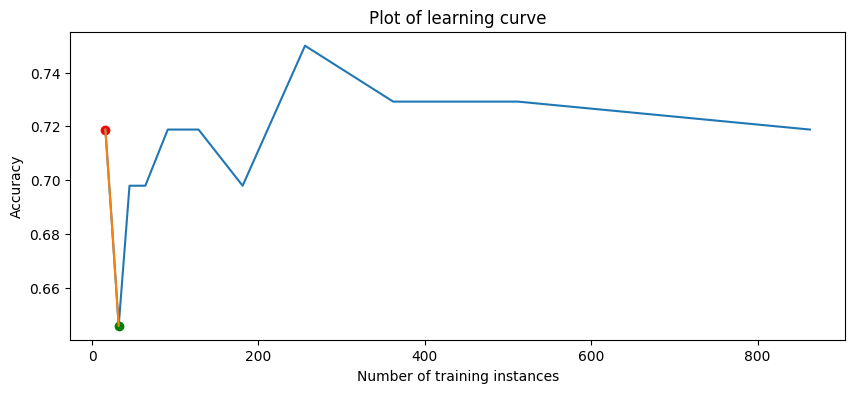

207it [08:48,  2.67s/it]

sklearn.linear_model.SGDClassifier_on_40701;non-monotonic:True


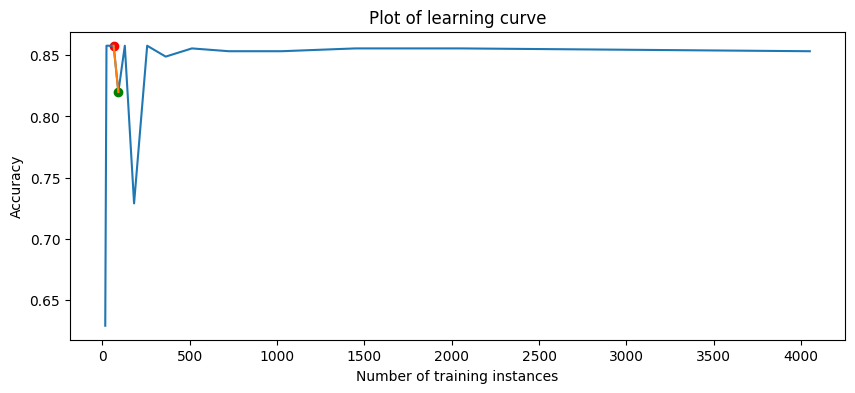

208it [08:50,  2.54s/it]

sklearn.linear_model.SGDClassifier_on_40713;non-monotonic:False


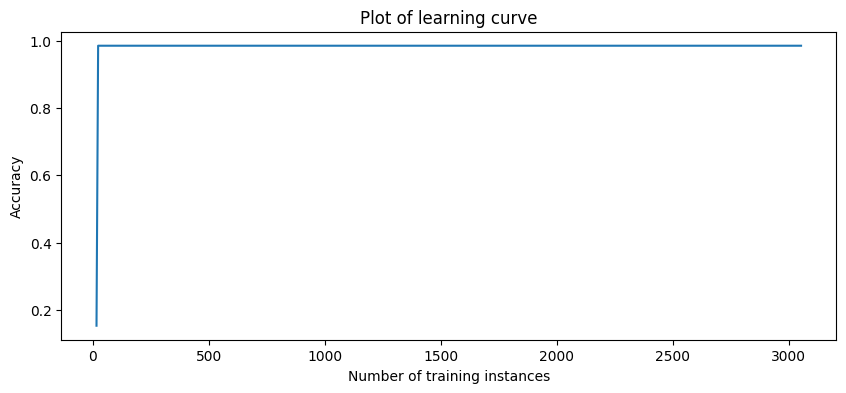

209it [08:53,  2.46s/it]

sklearn.linear_model.SGDClassifier_on_40900;non-monotonic:True


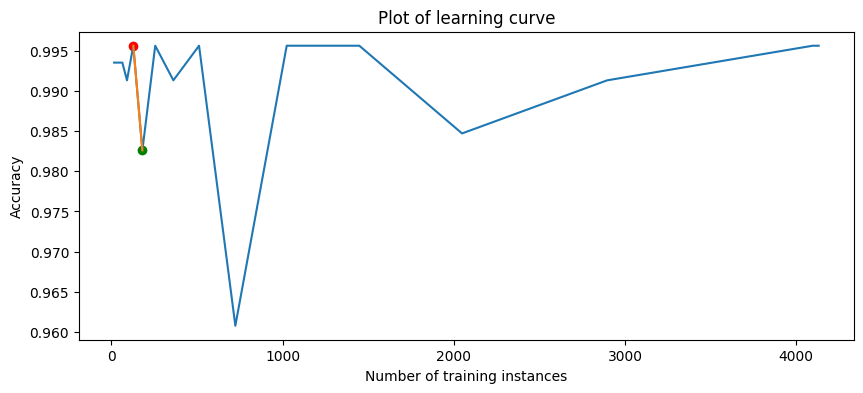

210it [08:55,  2.51s/it]

sklearn.linear_model.SGDClassifier_on_40910;non-monotonic:True


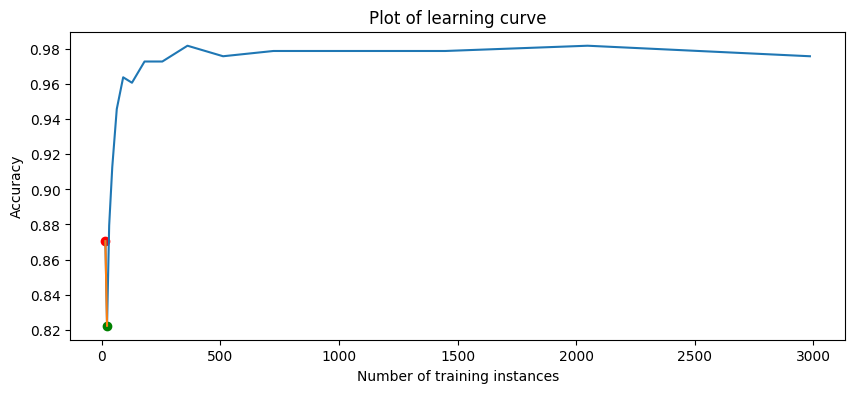

211it [08:58,  2.57s/it]

sklearn.linear_model.SGDClassifier_on_40971;non-monotonic:True


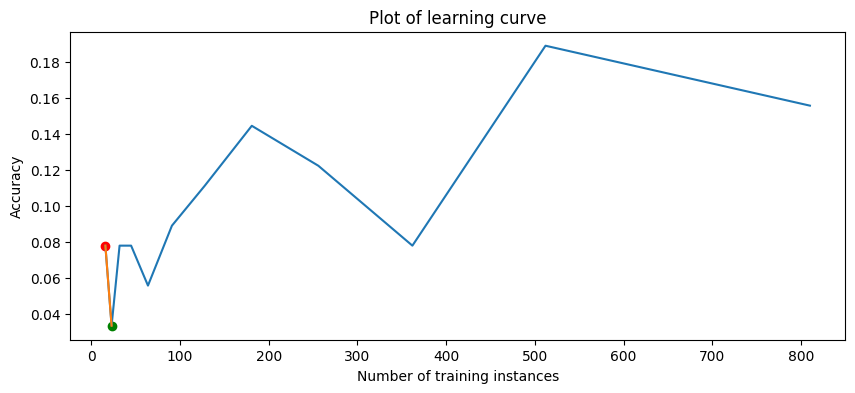

212it [09:01,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_40975;non-monotonic:True


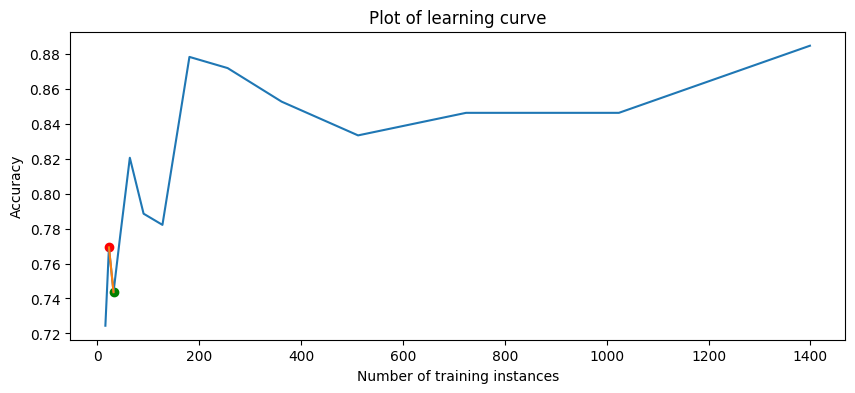

213it [09:03,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_40978;non-monotonic:True


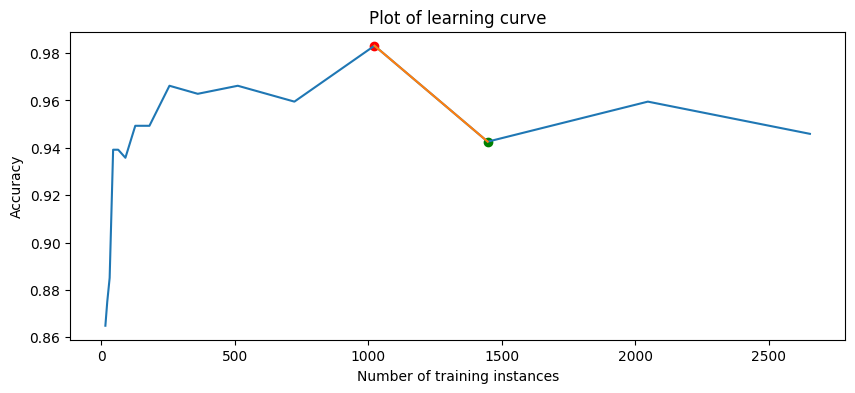

214it [09:06,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_40981;non-monotonic:True


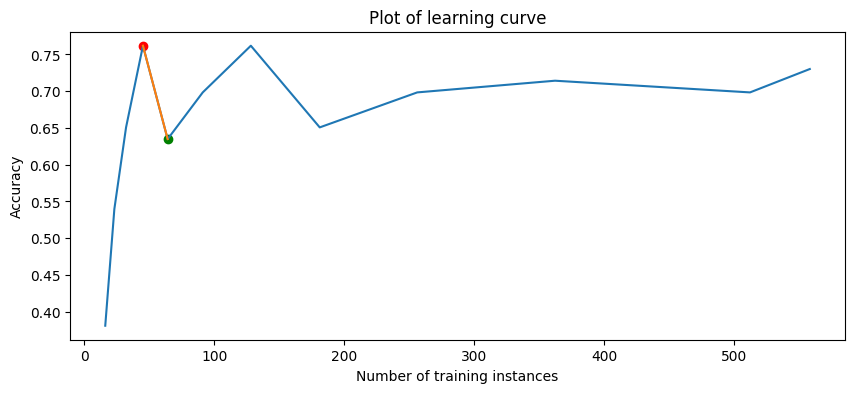

215it [09:09,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_40982;non-monotonic:True


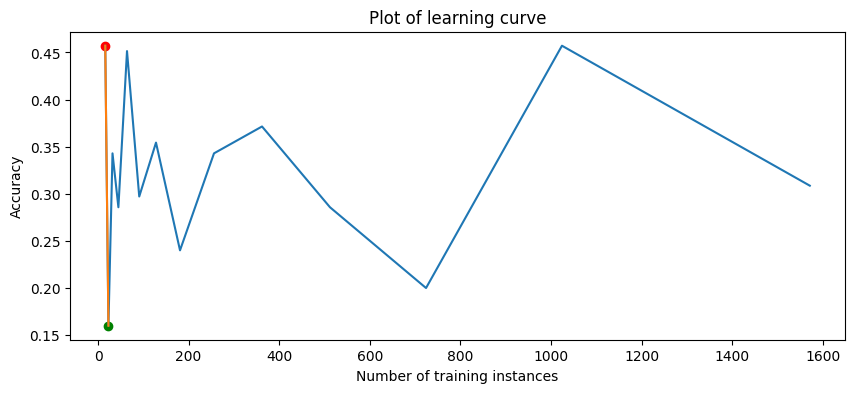

216it [09:11,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_40983;non-monotonic:True


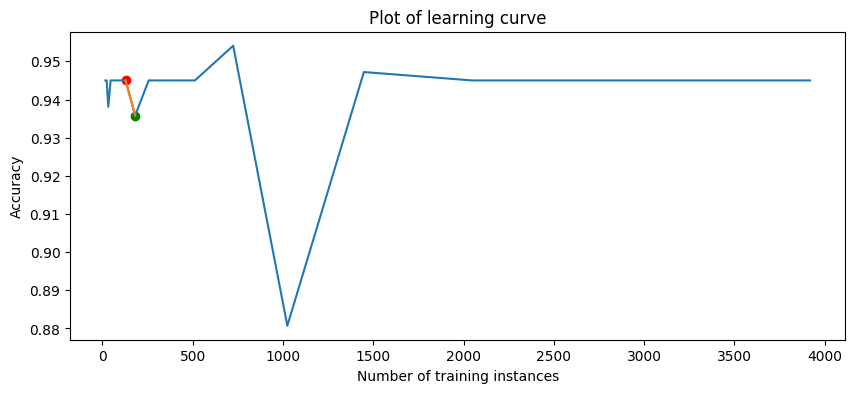

217it [09:14,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_40984;non-monotonic:True


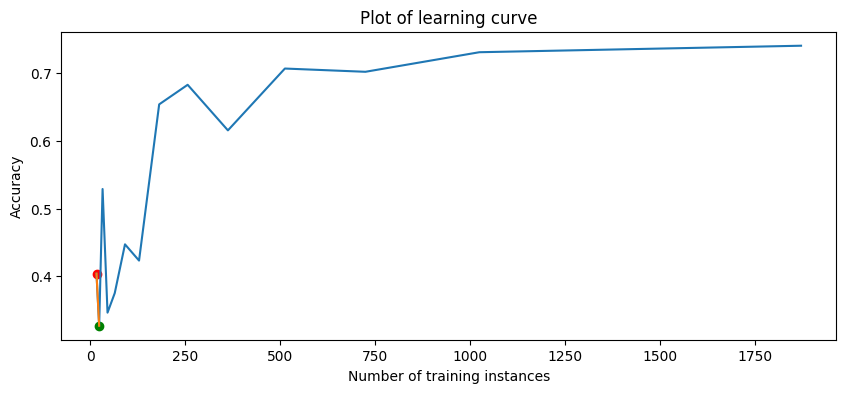

218it [09:17,  2.64s/it]

sklearn.linear_model.SGDClassifier_on_40994;non-monotonic:True


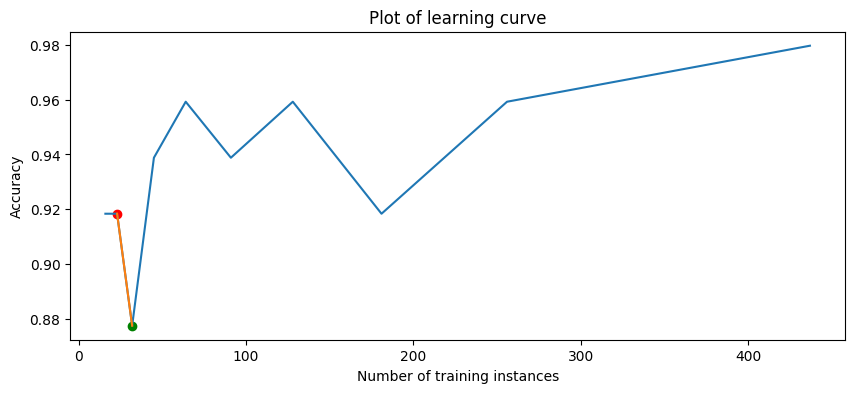

219it [09:19,  2.56s/it]

sklearn.linear_model.SGDClassifier_on_40996;non-monotonic:True


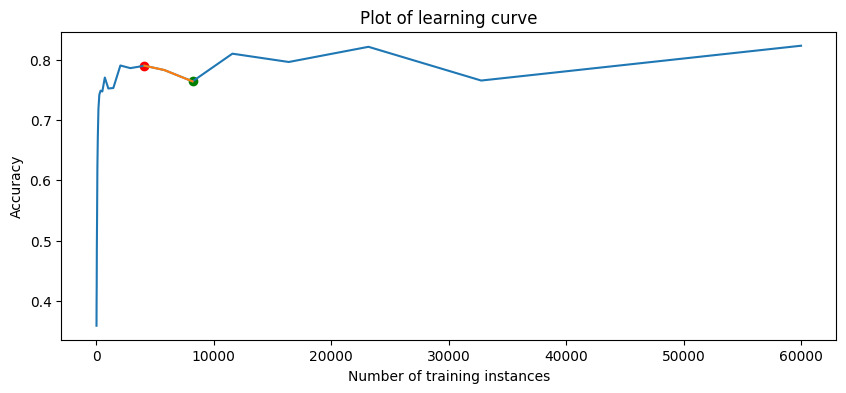

220it [09:21,  2.47s/it]

sklearn.linear_model.SGDClassifier_on_41027;non-monotonic:True


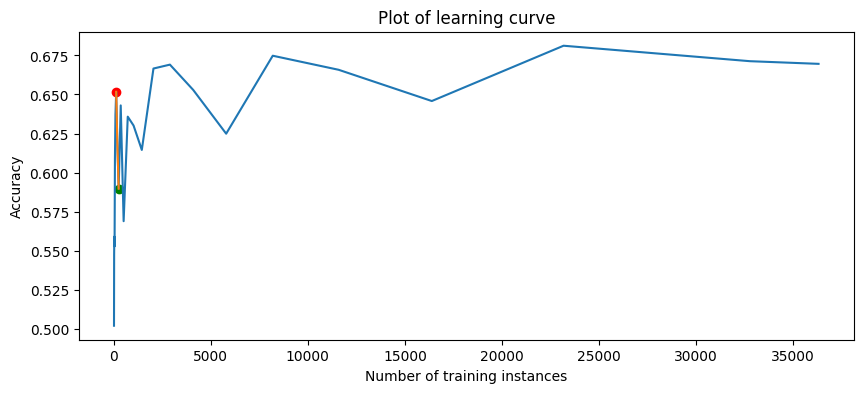

221it [09:24,  2.53s/it]

sklearn.linear_model.SGDClassifier_on_41142;non-monotonic:True


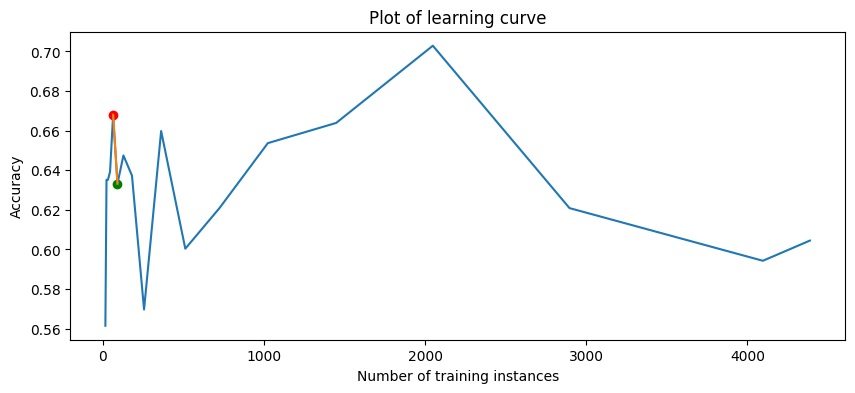

222it [09:26,  2.46s/it]

sklearn.linear_model.SGDClassifier_on_41143;non-monotonic:True


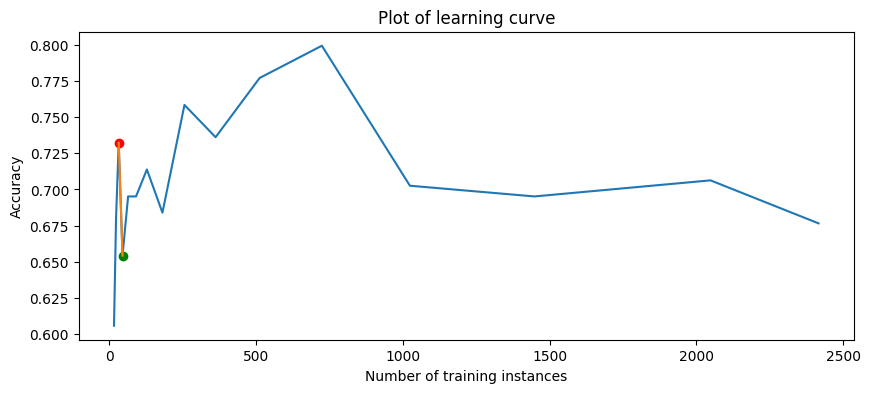

223it [09:29,  2.51s/it]

sklearn.linear_model.SGDClassifier_on_41144;non-monotonic:True


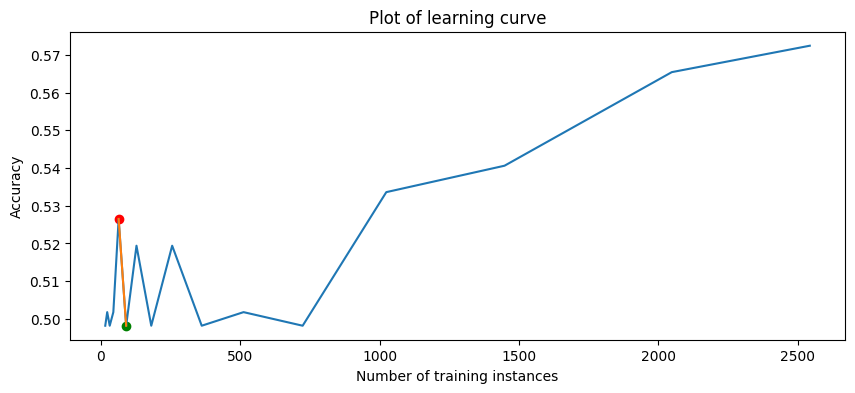

224it [09:31,  2.56s/it]

sklearn.linear_model.SGDClassifier_on_41145;non-monotonic:True


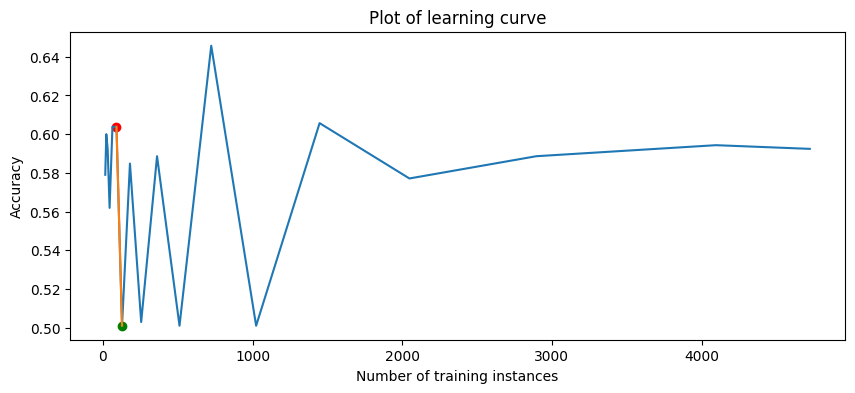

225it [09:34,  2.57s/it]

sklearn.linear_model.SGDClassifier_on_41146;non-monotonic:True


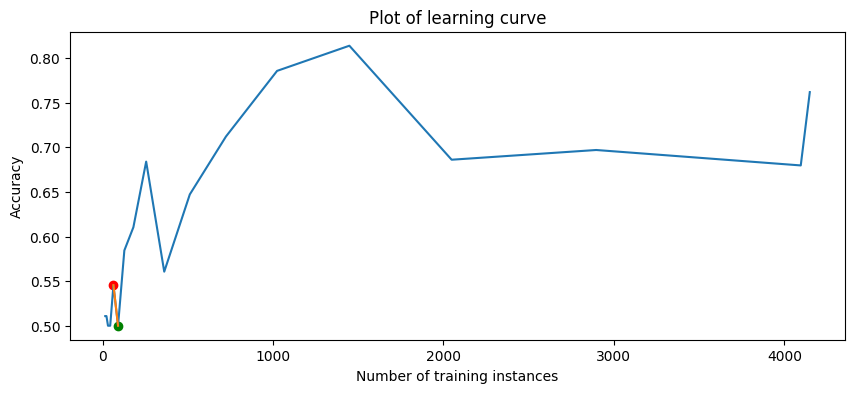

226it [09:37,  2.61s/it]

sklearn.linear_model.SGDClassifier_on_41150;non-monotonic:True


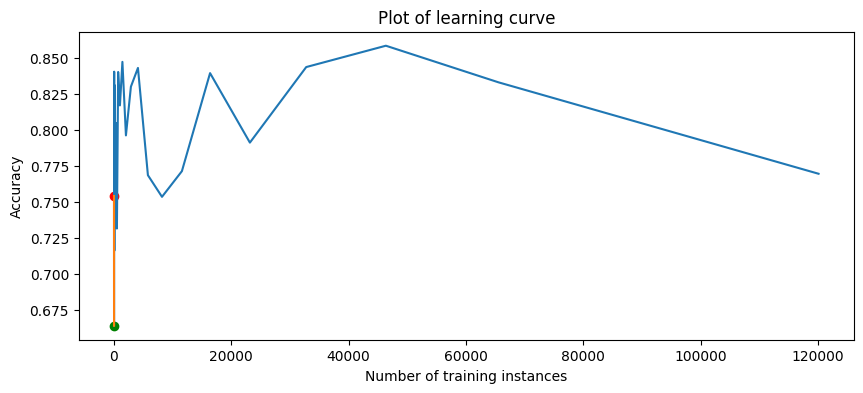

227it [09:39,  2.63s/it]

sklearn.linear_model.SGDClassifier_on_41156;non-monotonic:True


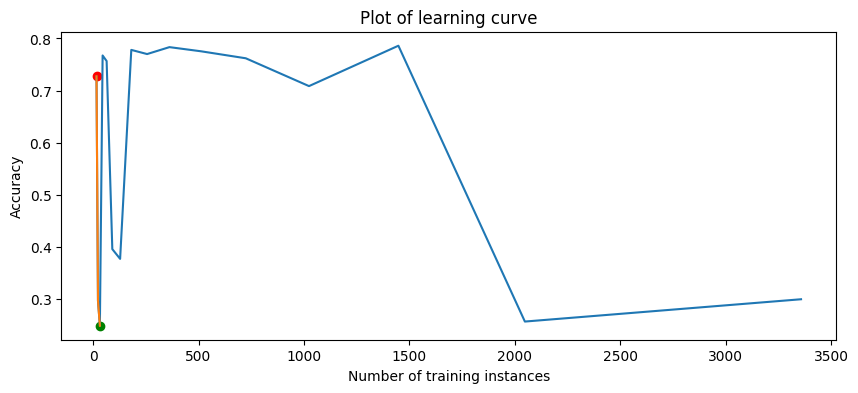

228it [09:42,  2.62s/it]

sklearn.linear_model.SGDClassifier_on_41157;non-monotonic:True


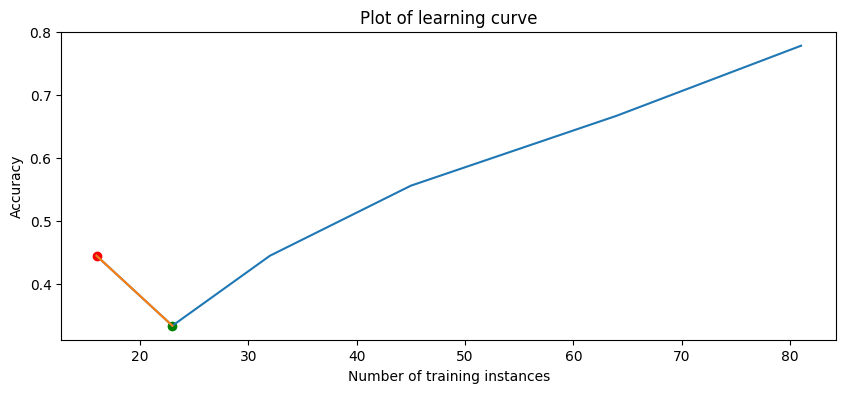

229it [09:45,  2.86s/it]

sklearn.linear_model.SGDClassifier_on_41158;non-monotonic:True


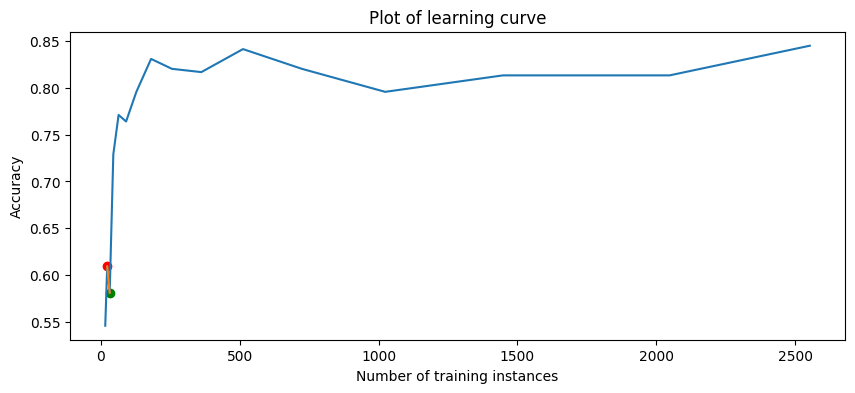

230it [09:48,  2.86s/it]

sklearn.linear_model.SGDClassifier_on_41159;non-monotonic:True


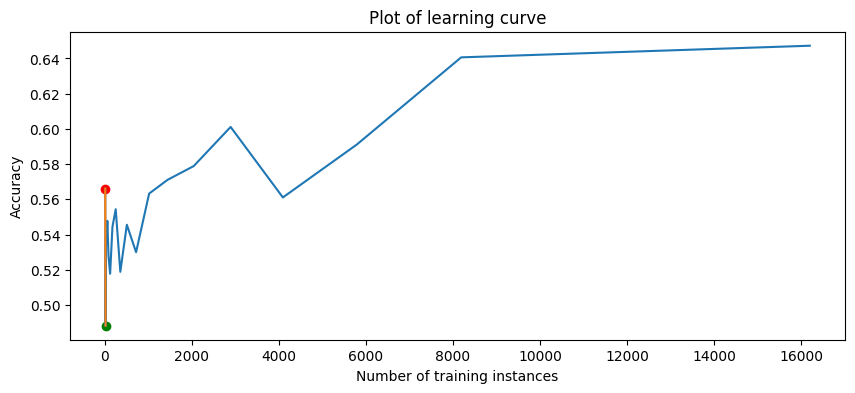

231it [09:51,  2.82s/it]

sklearn.linear_model.SGDClassifier_on_41161;non-monotonic:True


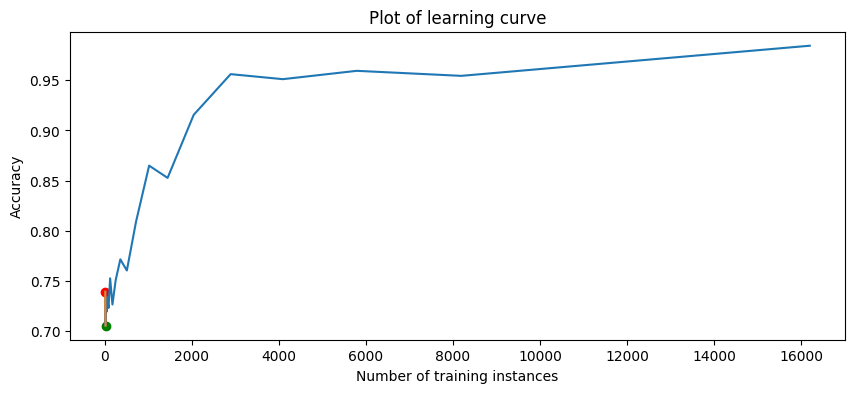

232it [09:53,  2.66s/it]

sklearn.linear_model.SGDClassifier_on_41163;non-monotonic:True


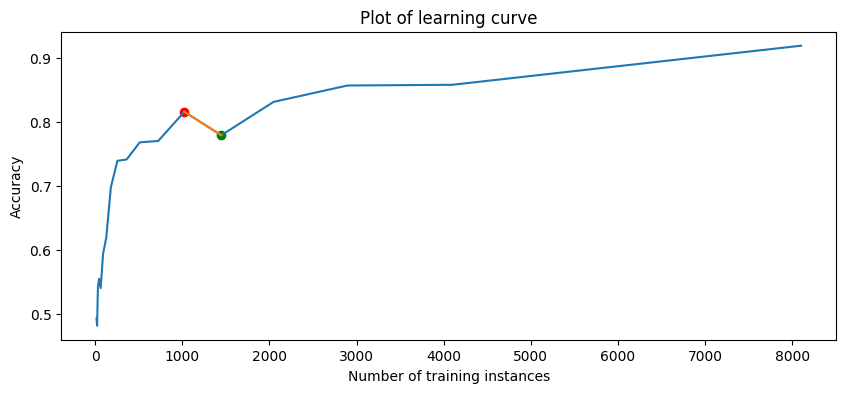

233it [09:56,  2.67s/it]

sklearn.linear_model.SGDClassifier_on_41164;non-monotonic:True


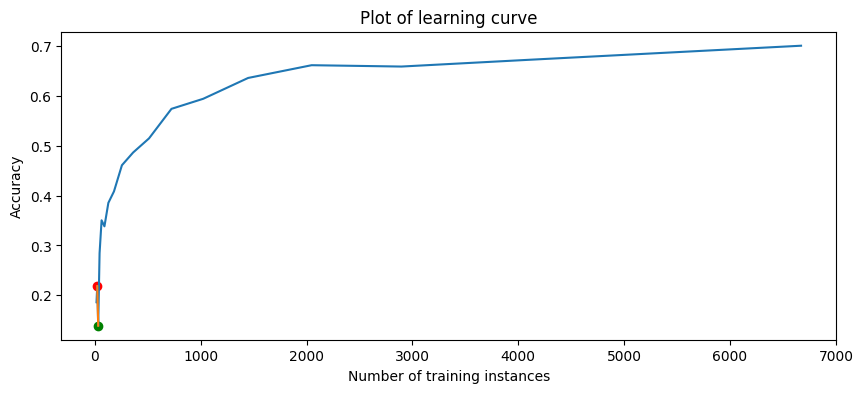

234it [09:58,  2.56s/it]

sklearn.linear_model.SGDClassifier_on_41165;non-monotonic:True


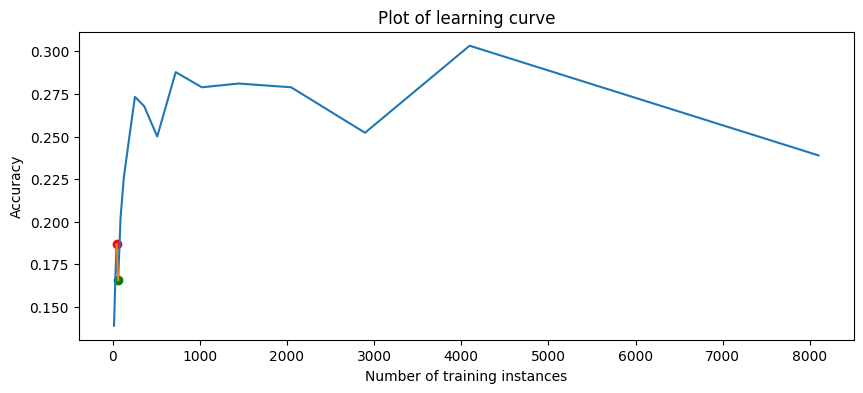

235it [10:01,  2.49s/it]

sklearn.linear_model.SGDClassifier_on_41166;non-monotonic:True


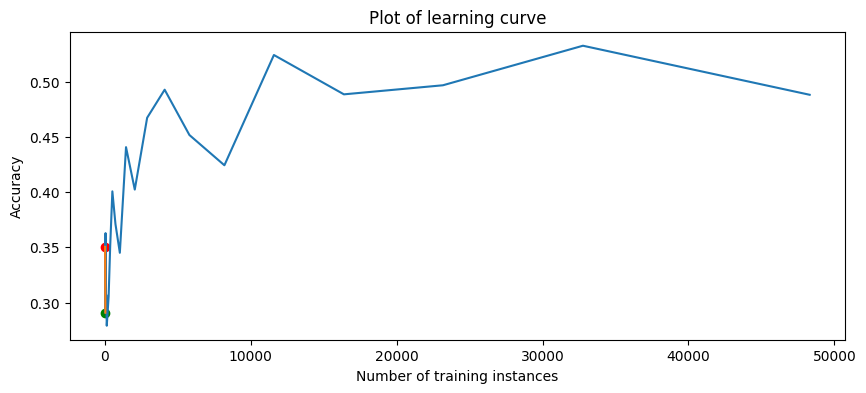

236it [10:03,  2.59s/it]

sklearn.linear_model.SGDClassifier_on_41167;non-monotonic:True


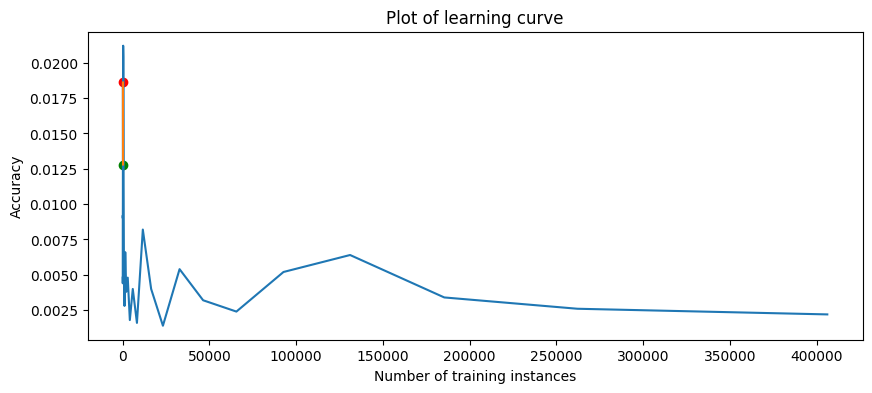

237it [10:06,  2.53s/it]

sklearn.linear_model.SGDClassifier_on_41168;non-monotonic:True


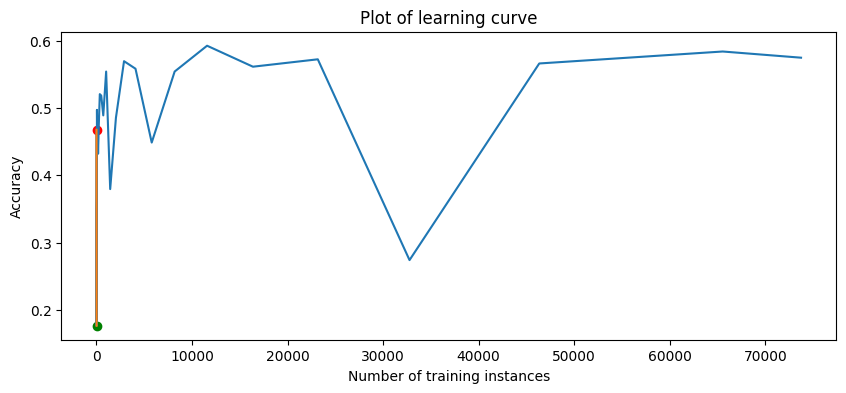

238it [10:08,  2.47s/it]

sklearn.linear_model.SGDClassifier_on_41169;non-monotonic:True


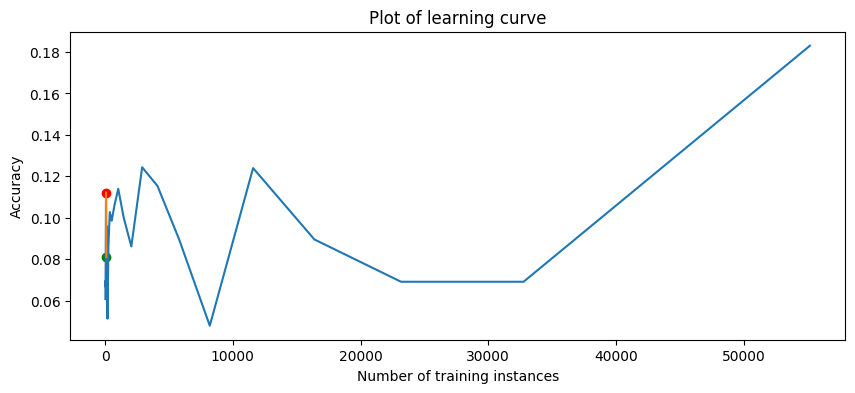

239it [10:11,  2.53s/it]

sklearn.linear_model.SGDClassifier_on_41228;non-monotonic:True


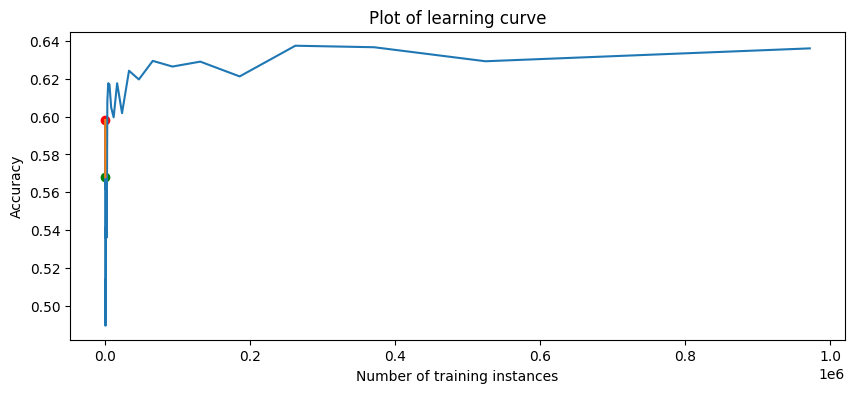

240it [10:13,  2.47s/it]

sklearn.linear_model.SGDClassifier_on_41972;non-monotonic:True


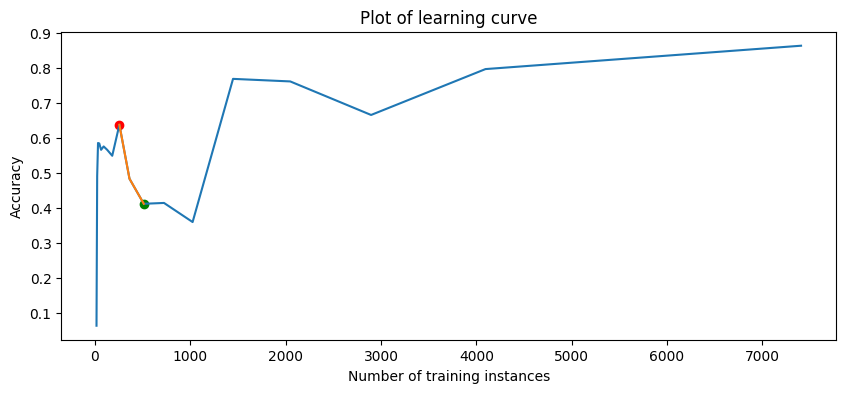

241it [10:16,  2.52s/it]

sklearn.linear_model.SGDClassifier_on_42732;non-monotonic:True


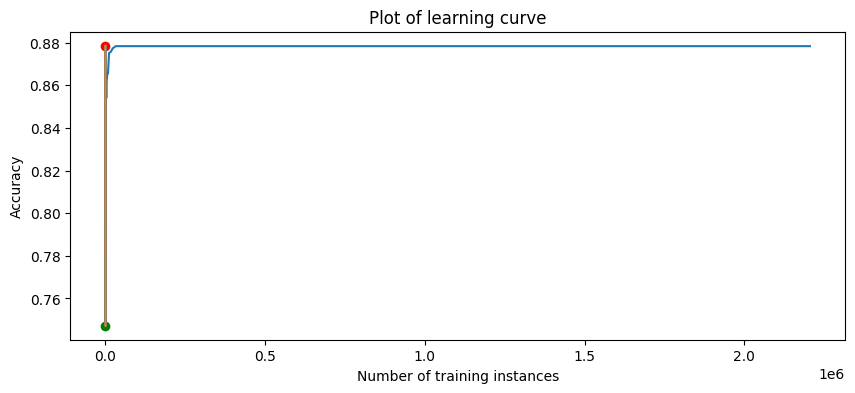

242it [10:18,  2.52s/it]

sklearn.linear_model.SGDClassifier_on_42733;non-monotonic:True


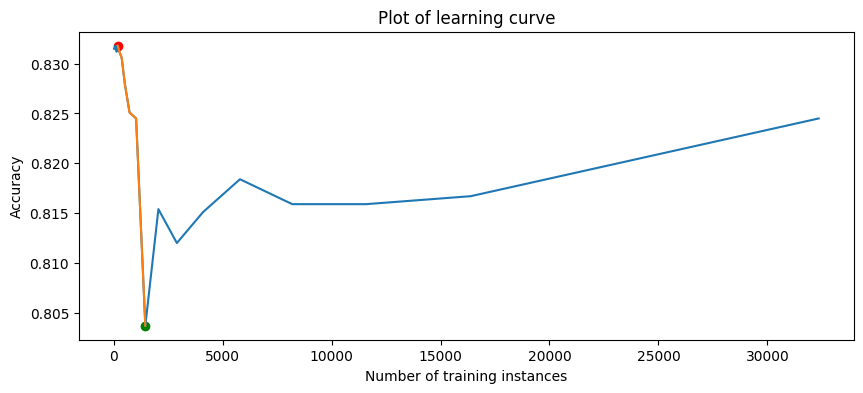

243it [10:21,  2.46s/it]

sklearn.linear_model.SGDClassifier_on_42734;non-monotonic:True


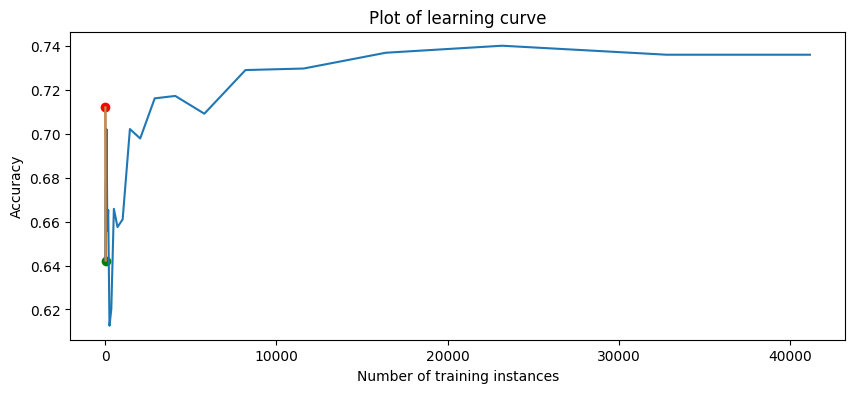

244it [10:23,  2.53s/it]

sklearn.linear_model.SGDClassifier_on_42742;non-monotonic:True


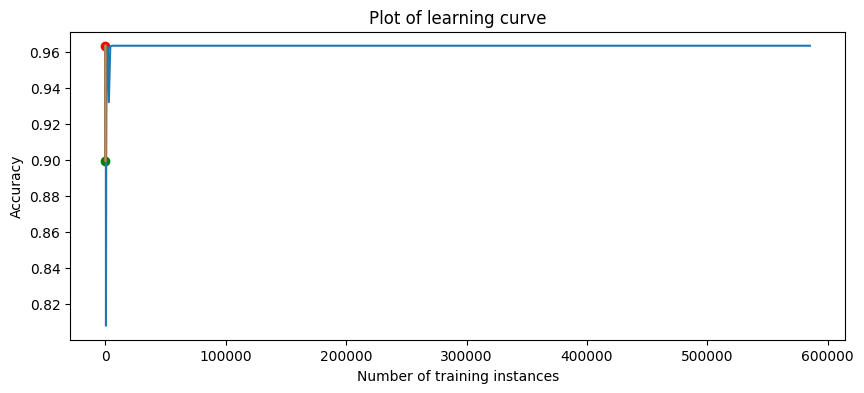

245it [10:26,  2.46s/it]

sklearn.linear_model.SGDClassifier_on_42769;non-monotonic:True


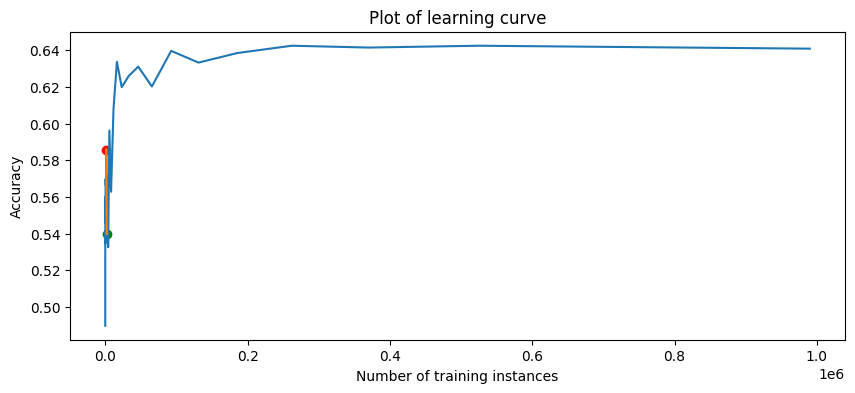

246it [10:28,  2.55s/it]

sklearn.linear_model.SGDClassifier_on_42809;non-monotonic:True


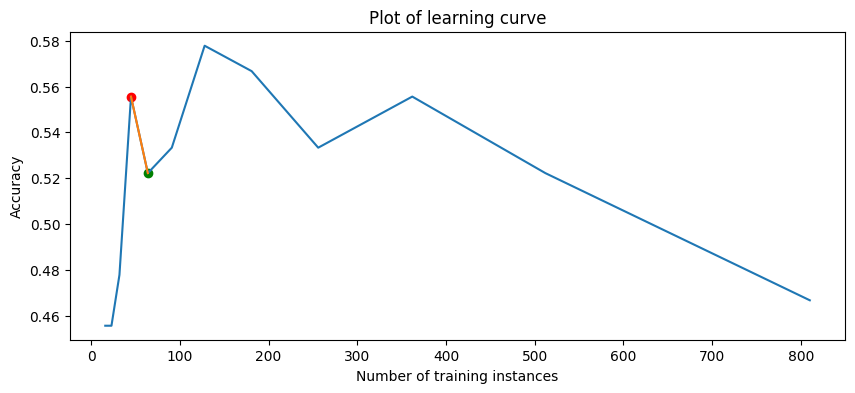

247it [10:31,  2.52s/it]

sklearn.linear_model.SGDClassifier_on_42810;non-monotonic:True


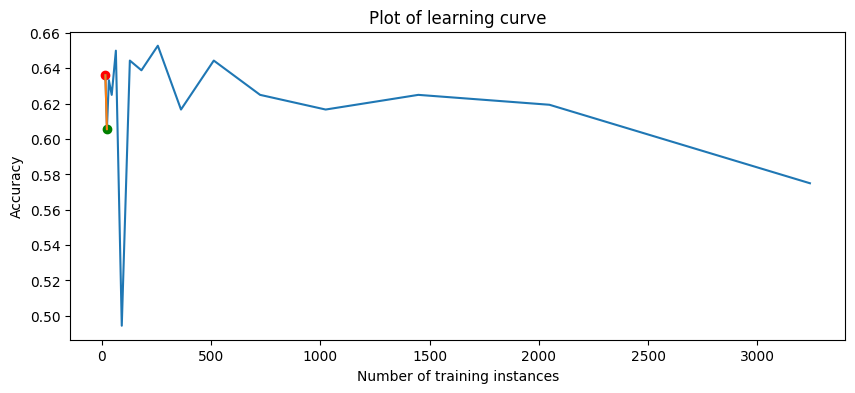

248it [10:34,  2.56s/it]

Class 0: (Monotone) 77
Class 1: (Non-Monotone) 549
Start non-monotone: 172
End non-monotone: 83


In [6]:
to_consider = ['sklearn.discriminant_analysis.LinearDiscriminantAnalysis', 'sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis', 'sklearn.linear_model.SGDClassifier']
exp_df = lcdb.get_all_curves('accuracy')
exp_df = exp_df.loc[exp_df.groupby(['openmlid', 'learner'])['size_train'].idxmax()]

lda = exp_df[exp_df['learner'] == to_consider[0]]


class_1 = 0  # monotonic
class_0 = 0  # non-monotonic
trueLD = 0
trueQD = 0
trueSGD = 0
falseLD = 0
falseQD = 0
falseSGD = 0
count_start = 0
count_end = 0
rows = []

for el in to_consider:
    lda = exp_df[exp_df['learner'] == el]
    for idx, row in tqdm(lda.iterrows()):
        curve = lcdb.get_curve(row['openmlid'], row['learner'])
        anchors, scores_train, scores_valid, scores_test = curve
        #actual_curve = [np.mean(sublist) for sublist in scores_valid]
        actual_curve = [sub[1] for sub in scores_valid]
        flag, starting_point, ending_point, count_flag, end_flag = evaluate_learningcurve(actual_curve, 0.8)
        rows.append([row['learner'], row['openmlid'], flag])
        learner_name = str(row['learner'])
        plot_name = learner_name + f"_on_{row['openmlid']};non-monotonic:" + str(flag)
        if flag:
            print(plot_name)
            plot_learningcurve(anchors, actual_curve, starting_point, ending_point, flag)
            class_1 += 1

            if count_flag:
                count_start += 1

            if end_flag:
                count_end += 1

            match row['learner']:
                case 'sklearn.discriminant_analysis.LinearDiscriminantAnalysis':
                     trueLD += 1
                case 'sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis':
                     trueQD += 1
                case 'sklearn.linear_model.SGDClassifier':
                     trueSGD += 1
        else:
            print(plot_name)
            plot_learningcurve(anchors, actual_curve, starting_point, ending_point, flag)
            class_0 += 1

            match row['learner']:
                case 'sklearn.discriminant_analysis.LinearDiscriminantAnalysis':
                     falseLD += 1
                case 'sklearn.discriminant_analysis.QuadraticDiscriminantAnalysis':
                     falseQD += 1
                case 'sklearn.linear_model.SGDClassifier':
                     falseSGD += 1

print("Class 0: (Monotone)", class_0)
print("Class 1: (Non-Monotone)", class_1)
print("Start non-monotone:", count_start)
print("End non-monotone:", count_end)

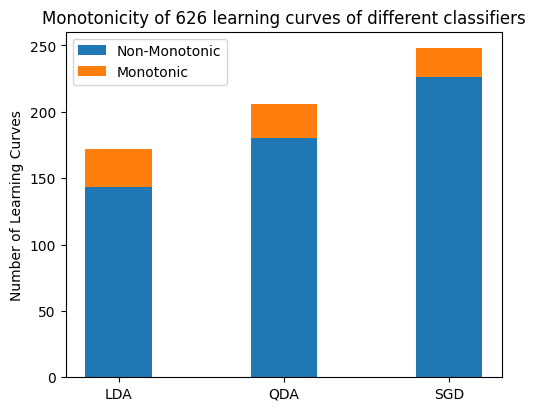

In [7]:


fig, ax = plt.subplots(layout='constrained',figsize=(5,4))
columns = ['LDA', 'QDA', 'SGD']
plt.bar(columns, [trueLD, trueQD, trueSGD], label='Non-Monotonic', width=0.4)
plt.bar(columns, [falseLD, falseQD, falseSGD], bottom=[trueLD, trueQD, trueSGD], label='Monotonic', width=0.4)

# Set labels and title
# plt.xlabel('Monotonicity ')
plt.ylabel('Number of Learning Curves')
plt.title('Monotonicity of 626 learning curves of different classifiers')

# Show the legend
plt.legend()

# Show the plot
plt.show()

In [8]:
experiment1_results = pd.DataFrame(rows, columns=['learner', 'dataset_id', 'non-monotone'])
experiment1_results

,learner,dataset_id,non-monotone
0,sklearn.discriminant_analysis.LinearDiscrimina...,6,False
1,sklearn.discriminant_analysis.LinearDiscrimina...,11,False
2,sklearn.discriminant_analysis.LinearDiscrimina...,12,True
3,sklearn.discriminant_analysis.LinearDiscrimina...,14,True
4,sklearn.discriminant_analysis.LinearDiscrimina...,16,False
...,...,...,...
621,sklearn.linear_model.SGDClassifier,42734,True
622,sklearn.linear_model.SGDClassifier,42742,True
623,sklearn.linear_model.SGDClassifier,42769,True
624,sklearn.linear_model.SGDClassifier,42809,True


In [9]:
experiment1_results.to_csv('experiment1_results.csv')